# Introduction

In the EDA Notebook, I verified that the drug N02BE have the highest sales volume, so now, in this notebook, I'll try to predict the 5 days of future sales from this specific drug.



# Libraries

In [1]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout
from tensorflow.keras.callbacks import EarlyStopping
from sklearn import preprocessing

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


# One Feature

## Importing

In [2]:
df_daily = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesdaily.csv')
# df_daily = df_daily[['datum','Weekday Name','N02BE']]
# df_daily.columns = ['data','weekday','N02BE']

df_daily = df_daily['N02BE']


# df_houly = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/saleshourly.csv')
# df_monthly = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesmonthly.csv')
# df_weekly = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesweekly.csv')

## Spliting Data

In [2]:
def dataSplit(df,train_percent,val_percent):
  train_limit = int(round((df.shape[0])*train_percent,0))
  val_limit = int(round((df.shape[0])*(train_percent+val_percent),0))
  
  df_train = df[:train_limit]
  df_val = df[train_limit:val_limit]
  df_test = df[val_limit:]

  print(df_train.shape)
  print(df_val.shape)
  print(df_test.shape)

  return df_train,df_val,df_test

In [4]:
df_train,df_val,df_test = dataSplit(df = df_daily,train_percent = 0.7,val_percent = 0.15)

(1474,)
(316,)
(316,)


## Normalizing Data

In [3]:
def normalizing_data(df_train,df_val,df_test,frange):
  sc = MinMaxScaler(feature_range = frange)
  try:
    aux = df_train.shape[1]
    df_train_norm = sc.fit_transform(df_train)
    df_val_norm = sc.transform(df_val)
    df_test_norm = sc.transform(df_test)

  except:
    df_train = df_train.values.reshape(-1,1)
    df_val = df_val.values.reshape(-1,1)
    df_test = df_test.values.reshape(-1,1)

    
    df_train_norm = sc.fit_transform(df_train)
    df_val_norm = sc.transform(df_val)
    df_test_norm = sc.transform(df_test)

  print(df_train_norm.max(axis=0))
  print(df_train_norm.min(axis=0))
  print('\n')

  print(df_val_norm.max(axis=0))
  print(df_val_norm.min(axis=0))
  print('\n')

  print(df_test_norm.max(axis=0))
  print(df_test_norm.min(axis=0))

  print('-------------------------')

  print(df_train_norm.shape)
  print(df_val_norm.shape)
  print(df_test_norm.shape)
  return df_train_norm,df_val_norm,df_test_norm

In [6]:
df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange=(0,1))

[1.]
[0.]


[0.46335404]
[0.]


[0.62173913]
[0.]
-------------------------
(1474, 1)
(316, 1)
(316, 1)


## Preprocessing

In [4]:
def Regressor(future_steps,time_steps,n_features,df_train,df_val,df_test):
  # future_steps: how many days in the furure to predict 
  # time_steps: number of samples the LSTM model will use for predict 28 days in the future
  # n_features: number of features (LSTM input) 

  #################### TRAIN #################################################
  # Defining the number of samples for the train data
  n_samples = df_train.shape[0]
  x_train = []
  y_train = []

  # shaping data to have the number of time_steps in the x_train ans the 28 future values in the y_train 
  for i in range(time_steps,n_samples - future_steps): 
    x_train.append(df_train[i - time_steps : i, :]) 
    y_train.append(df_train[i : i + future_steps, -1 ]) 

  x_train,y_train = np.array(x_train),np.array(y_train) # transforming in array
  # LSTM need 3D tensor as input 
  x_train = np.reshape(x_train,(x_train.shape[0],x_train.shape[1],n_features))  

  ##################### VALIDATION ###############################################

  df_val = np.concatenate((df_train[-time_steps:],df_val))

  n_samples = df_val.shape[0]
  x_val = []
  y_val = []

  for i in range(time_steps,n_samples - future_steps):
    x_val.append(df_val[i - time_steps : i, :]) 
    y_val.append(df_val[i : i + future_steps,-1]) 

  x_val,y_val = np.array(x_val),np.array(y_val)
  x_val = np.reshape(x_val,(x_val.shape[0],x_val.shape[1],n_features))

  ####################### TEST ################################################

  df_test = np.concatenate((df_val[-time_steps:],df_test))
  n_samples = df_test.shape[0]
  x_test = []
  y_test = []

  for i in range(time_steps,n_samples - future_steps):
    x_test.append(df_test[i - time_steps : i, :]) 
    y_test.append(df_test[i : i + future_steps,-1]) 

  x_test,y_test = np.array(x_test),np.array(y_test)
  x_test = np.reshape(x_test,(x_test.shape[0],x_test.shape[1],n_features))

  x_train = x_train.astype(np.float32)
  y_train = y_train.astype(np.float32)

  x_val = x_val.astype(np.float32)
  y_val = y_val.astype(np.float32)

  x_test = x_test.astype(np.float32)
  y_test = y_test.astype(np.float32)
  
  return x_train,x_test,x_val,y_train,y_val,y_test

In [ ]:
time_steps = 60
future_steps = 5
n_features = df_train_norm.shape[1]
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

## LSTM

### Frist Try

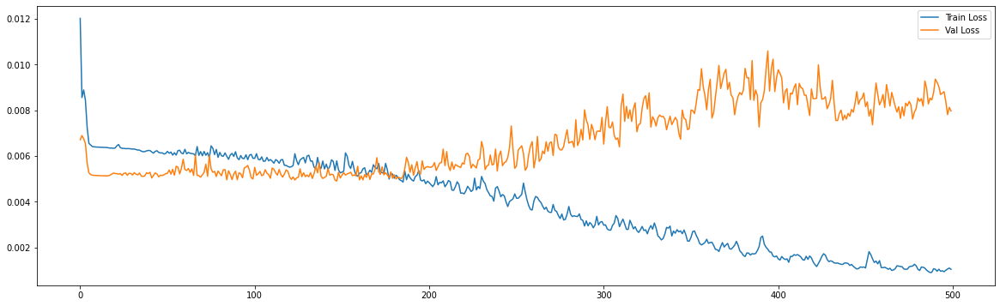

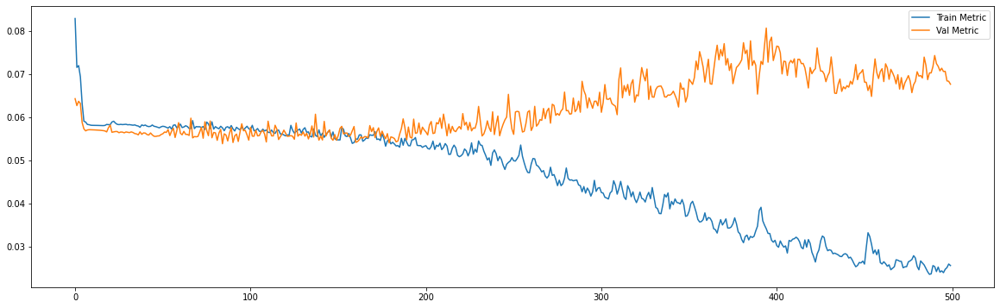



45/45 [==============================] - 0s 3ms/step - loss: 0.0013 - mae: 0.0276
loss and metric train data [0.0012694646138697863, 0.02760928124189377]
10/10 [==============================] - 0s 2ms/step - loss: 0.0080 - mae: 0.0676
loss and metric val data [0.007965357042849064, 0.06760048866271973]
10/10 [==============================] - 0s 2ms/step - loss: 0.0087 - mae: 0.0702
loss and metric test data [0.008689641952514648, 0.07020676136016846]


In [ ]:
regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dense(units=future_steps))

#Compiling the LSTM
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 500, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

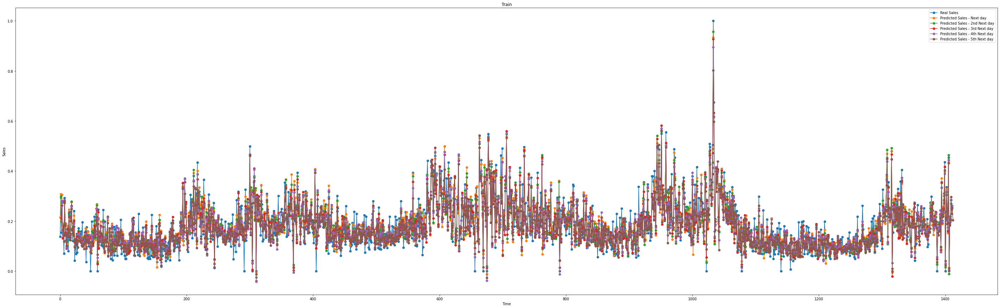

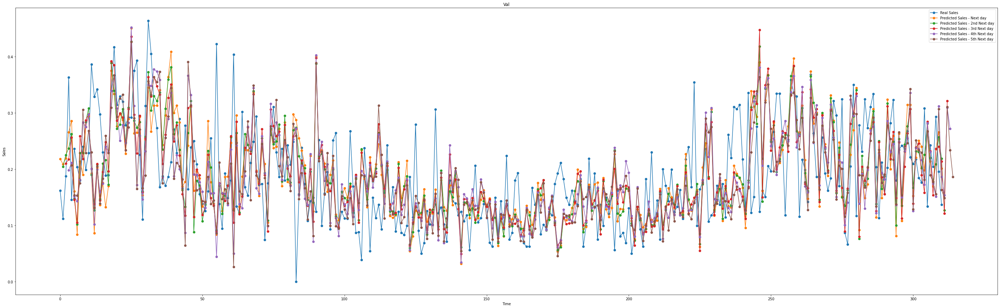

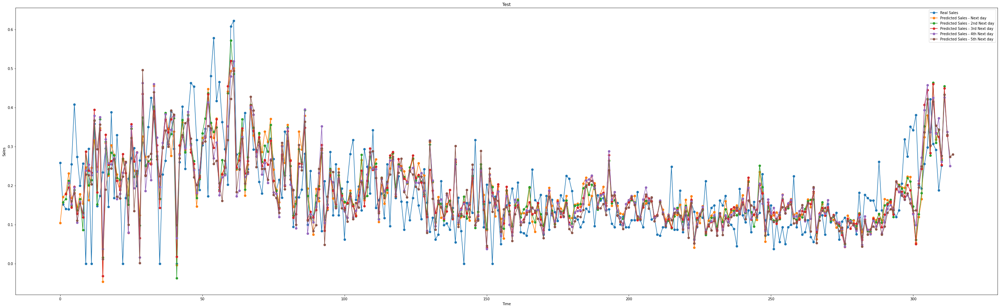

In [ ]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

### Decreasing Learning Rate

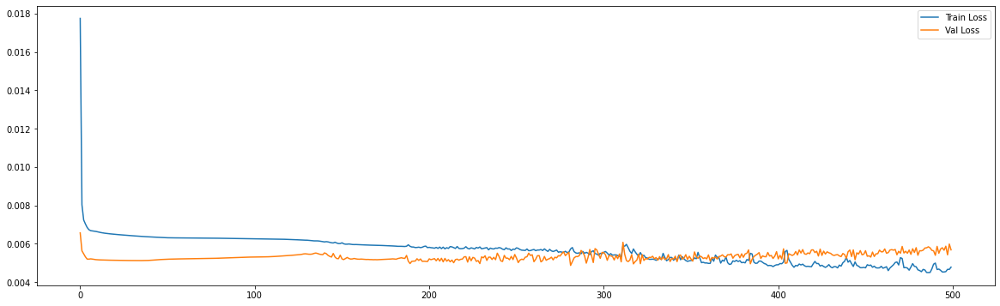

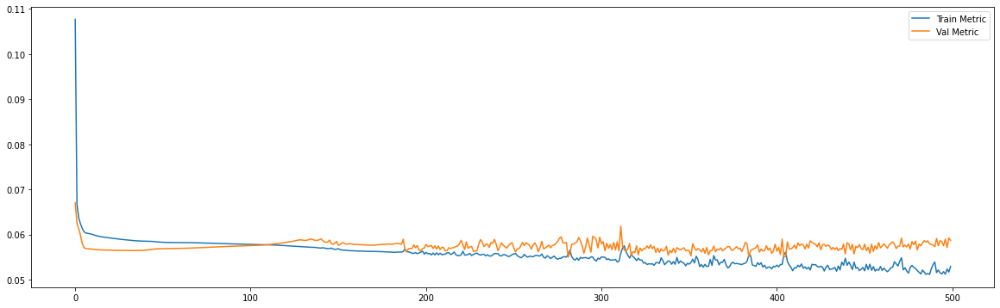



45/45 [==============================] - 0s 3ms/step - loss: 0.0047 - mae: 0.0521
loss and metric train data [0.004738555755466223, 0.052112750709056854]
10/10 [==============================] - 0s 2ms/step - loss: 0.0057 - mae: 0.0587
loss and metric val data [0.005681145470589399, 0.05867740511894226]
10/10 [==============================] - 0s 2ms/step - loss: 0.0095 - mae: 0.0663
loss and metric test data [0.0095036206766963, 0.06633426994085312]


In [ ]:
del regressor
regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dense(units=future_steps))

#Compiling the LSTM
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 500, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

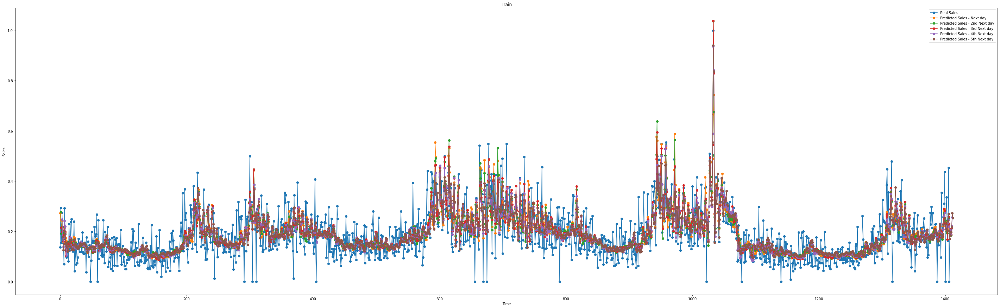

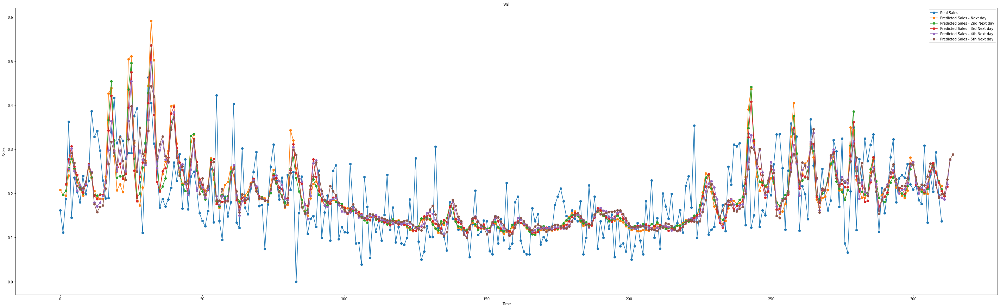

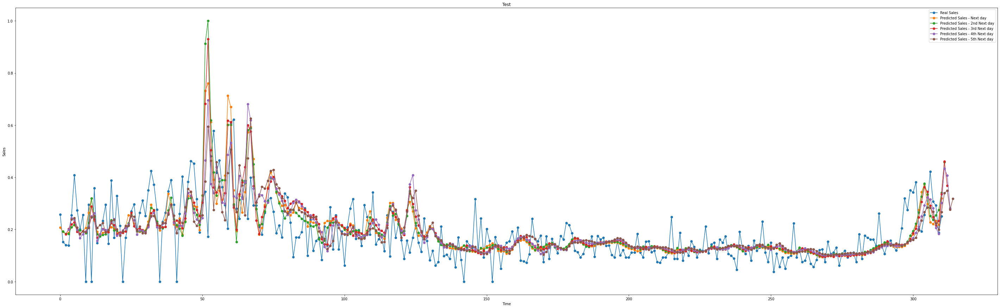

In [ ]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

### Increasing Model Complexity

---

- 1 LSTM layer, 70 neurons.
- 2 LSTM layer, 70 neurons.


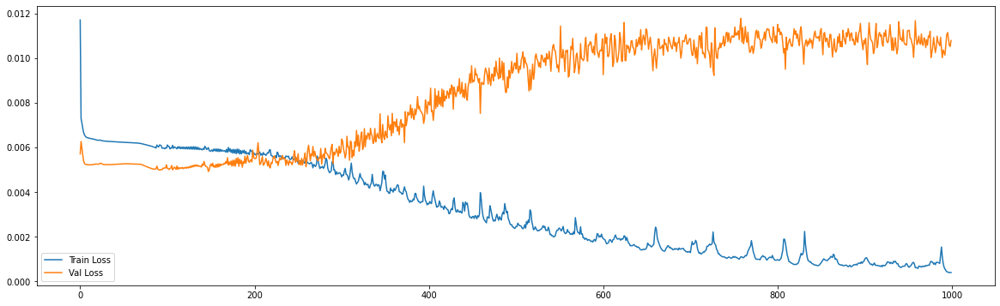

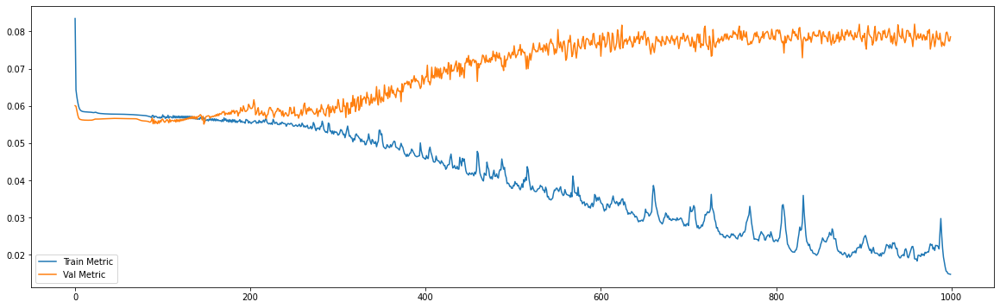



45/45 [==============================] - 0s 4ms/step - loss: 3.9206e-04 - mae: 0.0150
loss and metric train data [0.00039205708890222013, 0.015000595711171627]
10/10 [==============================] - 0s 3ms/step - loss: 0.0108 - mae: 0.0785
loss and metric val data [0.010785216465592384, 0.07854100316762924]
10/10 [==============================] - 0s 3ms/step - loss: 0.0102 - mae: 0.0744
loss and metric test data [0.010169172659516335, 0.07442604750394821]


In [ ]:
# del regressor
regressor = Sequential()
regressor.add(LSTM(units=70, return_sequences=True, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(LSTM(units=70, return_sequences=False))
regressor.add(Dense(units=future_steps))

#Compiling the LSTM
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

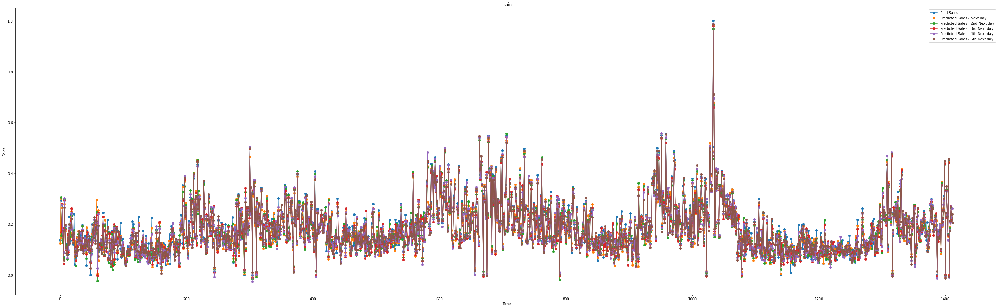

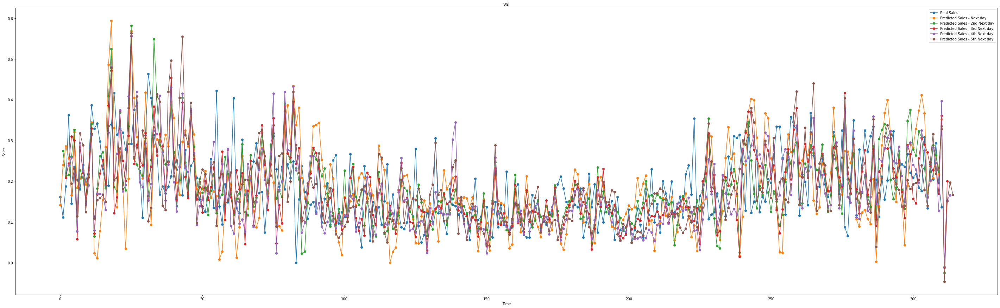

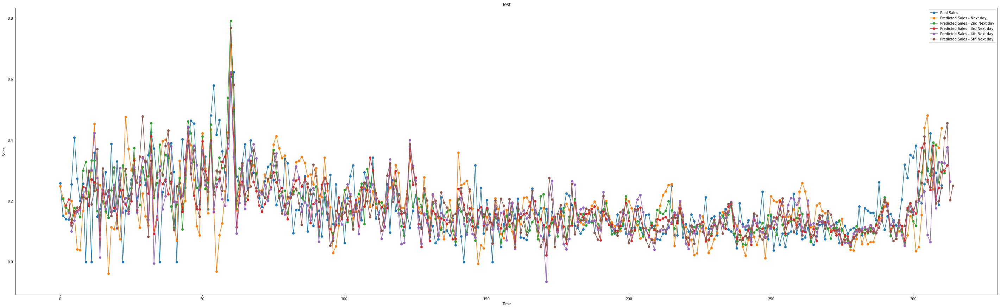

In [ ]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

#### Dropout

---

- Dropout = 0.2
- Dropout = 0.4 (MELHOR)

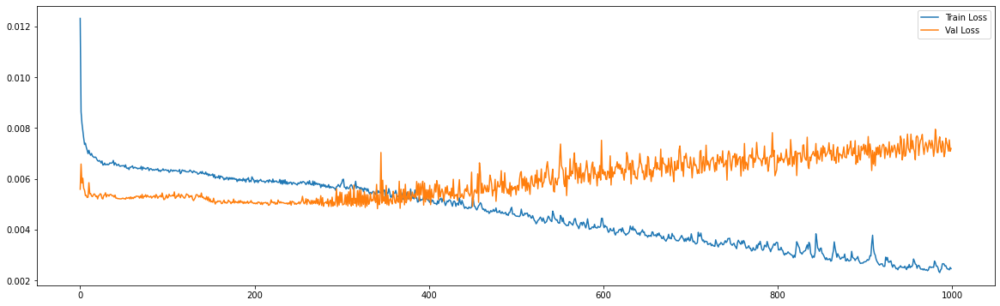

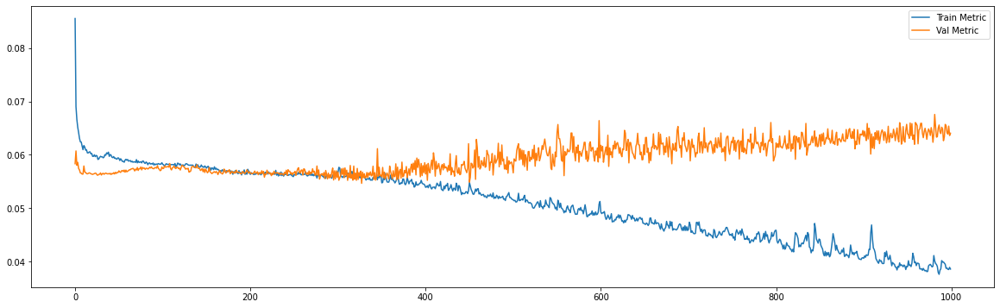



45/45 [==============================] - 0s 4ms/step - loss: 0.0018 - mae: 0.0332
loss and metric train data [0.0018112468533217907, 0.033221714198589325]
10/10 [==============================] - 0s 3ms/step - loss: 0.0072 - mae: 0.0640
loss and metric val data [0.007193438243120909, 0.06403858214616776]
10/10 [==============================] - 0s 3ms/step - loss: 0.0084 - mae: 0.0668
loss and metric test data [0.008432162925601006, 0.06677934527397156]


In [ ]:
# del regressor
regressor = Sequential()
regressor.add(LSTM(units=70, return_sequences=True, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dropout(0.4))
regressor.add(LSTM(units=70, return_sequences=False))
regressor.add(Dropout(0.4))
regressor.add(Dense(units=future_steps))

#Compiling the LSTM
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

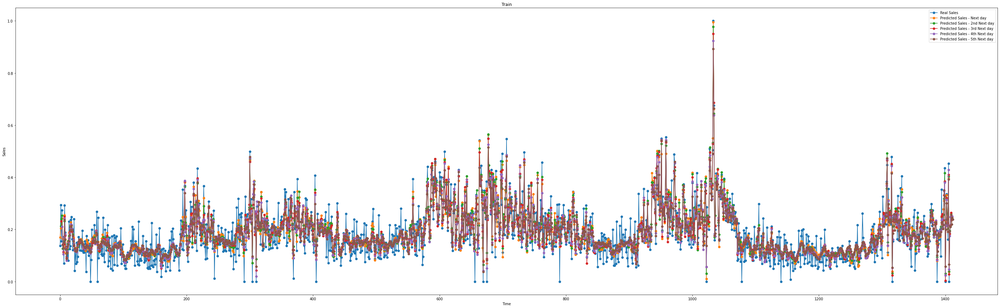

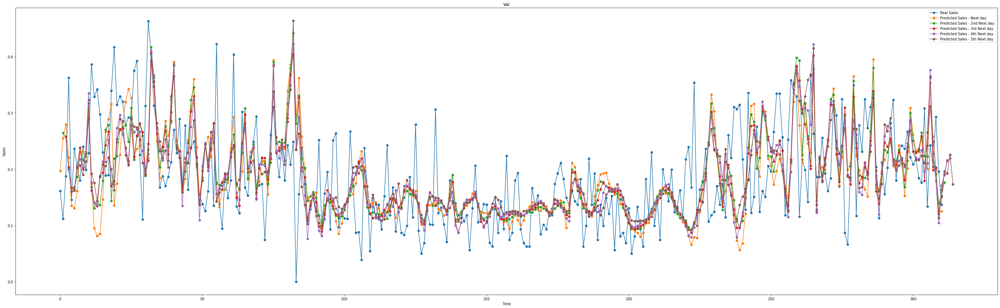

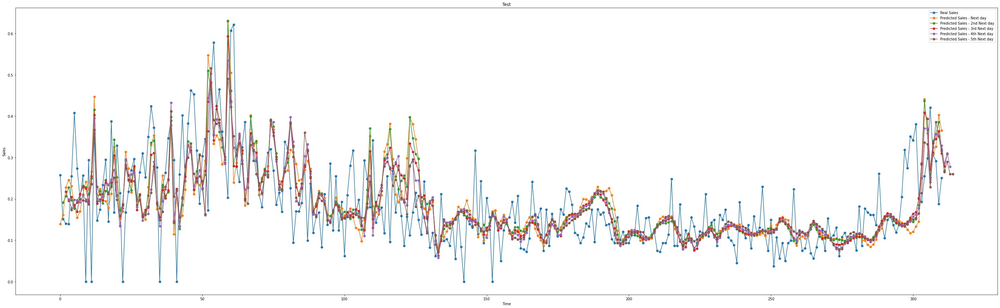

In [ ]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

#### L2 + Dropout

---

- Dropout = 0.4  + l2 = 0.001

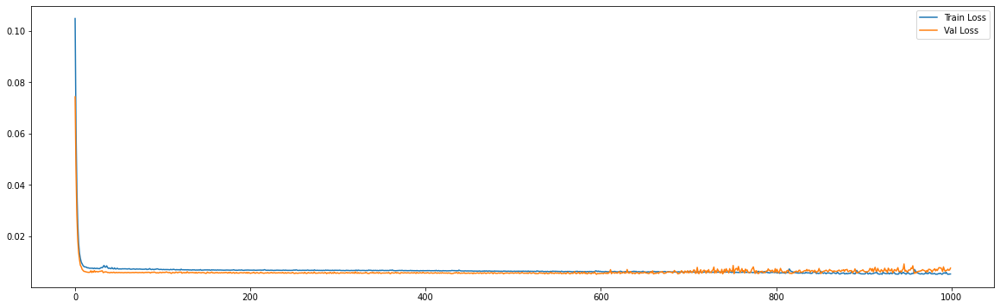

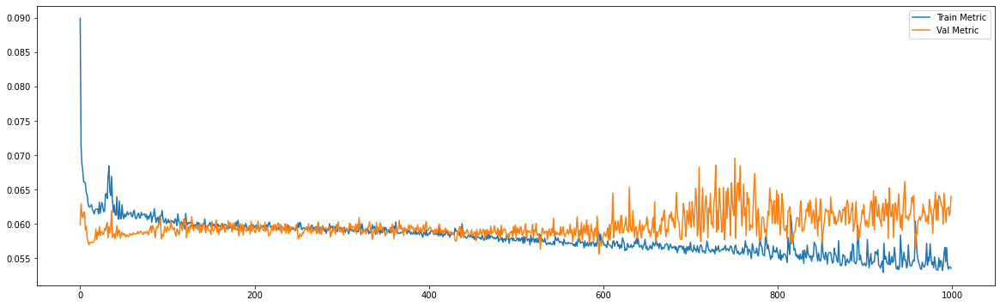



45/45 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0517
loss and metric train data [0.005033175460994244, 0.05170132592320442]
10/10 [==============================] - 0s 3ms/step - loss: 0.0076 - mae: 0.0640
loss and metric val data [0.007595821283757687, 0.06400824338197708]
10/10 [==============================] - 0s 3ms/step - loss: 0.0073 - mae: 0.0622
loss and metric test data [0.007327775005251169, 0.06224342808127403]


In [ ]:
# del regressor
regressor = Sequential()
regressor.add(LSTM(units=70, return_sequences=True, kernel_regularizer=regularizers.l2(0.001),input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dropout(0.4))
regressor.add(LSTM(units=70, return_sequences=False,kernel_regularizer=regularizers.l2(0.001)))
regressor.add(Dropout(0.4))
regressor.add(Dense(units=future_steps))

#Compiling the LSTM
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

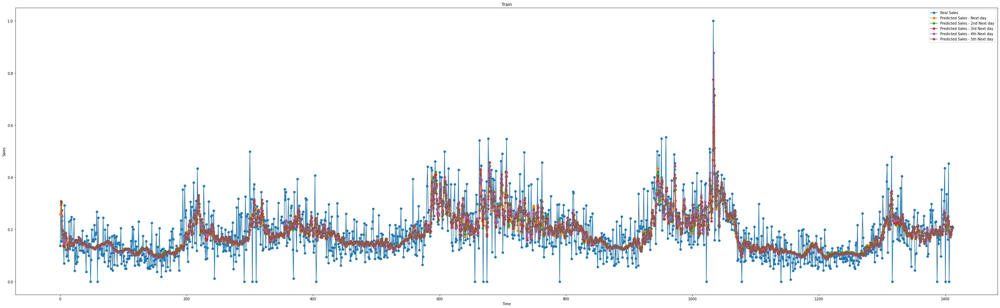

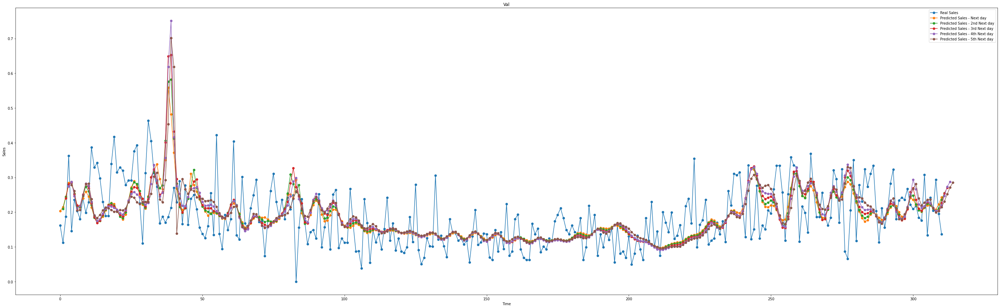

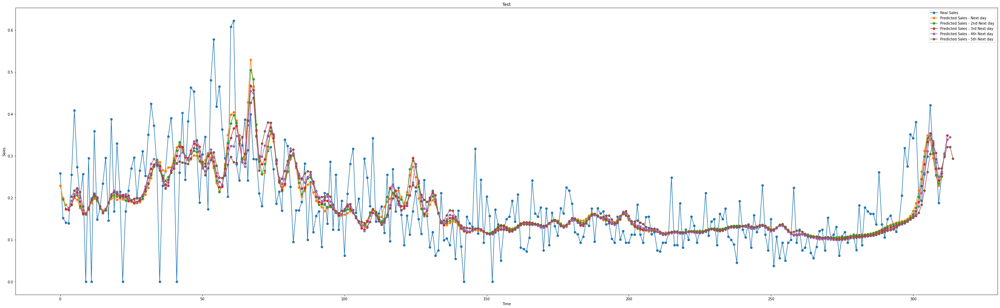

In [ ]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

### Decreasing model complexity

#### 50 neurons + Dropout

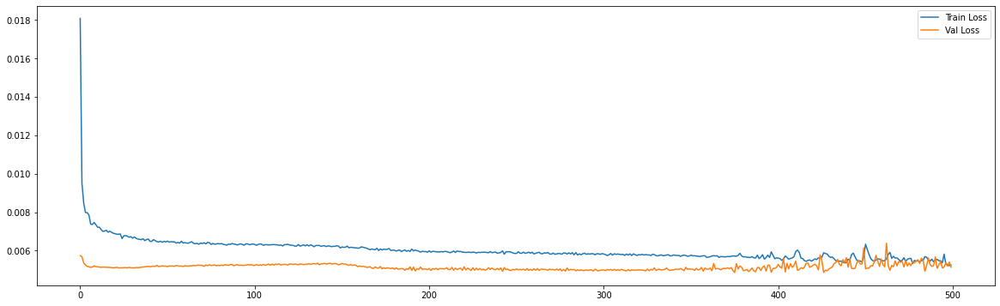

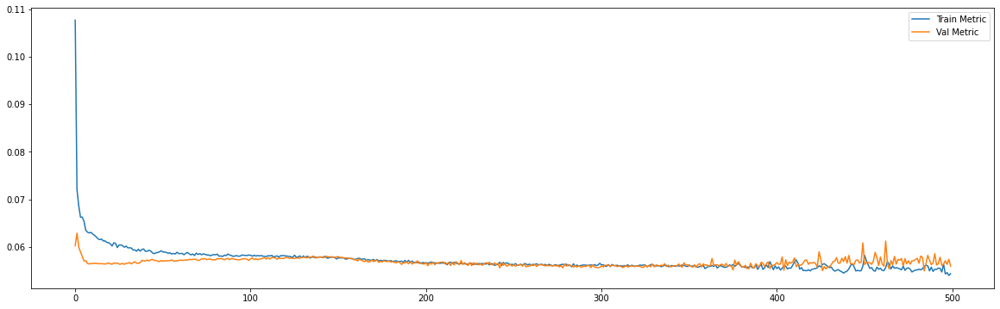



45/45 [==============================] - 0s 2ms/step - loss: 0.0051 - mae: 0.0532
loss and metric train data [0.005138068459928036, 0.05316896736621857]
10/10 [==============================] - 0s 2ms/step - loss: 0.0051 - mae: 0.0559
loss and metric val data [0.0051416559144854546, 0.055914558470249176]
10/10 [==============================] - 0s 3ms/step - loss: 0.0072 - mae: 0.0622
loss and metric test data [0.0072401948273181915, 0.06215088814496994]


In [ ]:
del regressor
regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dropout(0.3))
regressor.add(Dense(units=future_steps))

#Compiling the LSTM
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 500, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

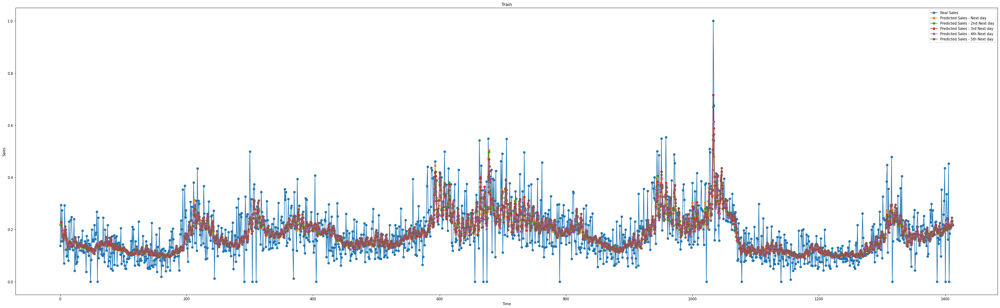

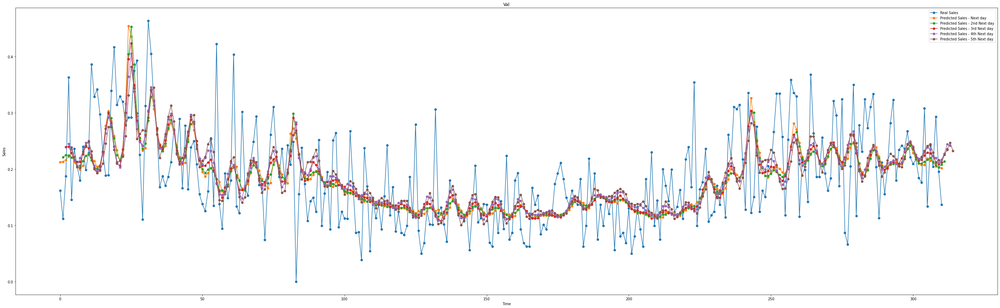

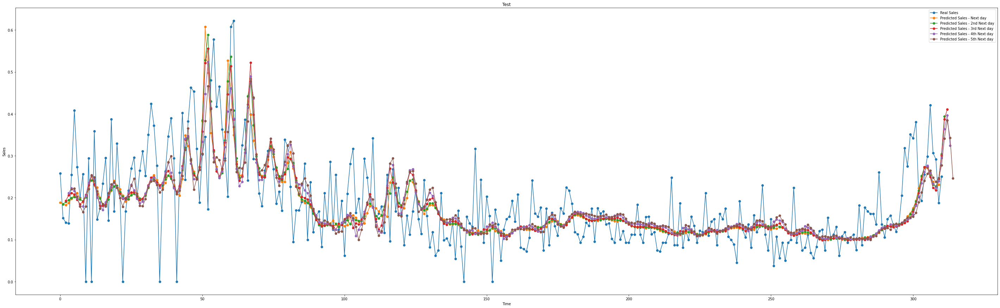

In [ ]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

#### 30 neurons + Dropout

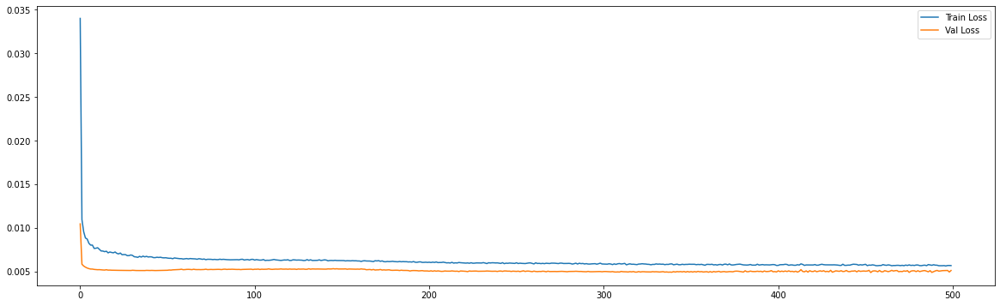

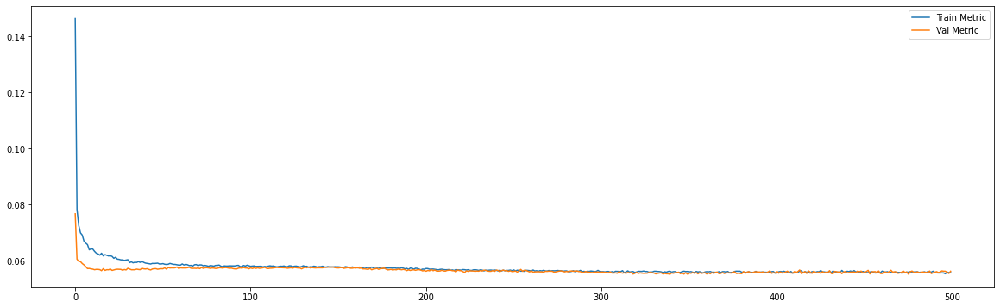



45/45 [==============================] - 0s 3ms/step - loss: 0.0055 - mae: 0.0547
loss and metric train data [0.005463157314807177, 0.05466107651591301]
10/10 [==============================] - 0s 2ms/step - loss: 0.0051 - mae: 0.0563
loss and metric val data [0.005109613295644522, 0.056326404213905334]
10/10 [==============================] - 0s 2ms/step - loss: 0.0085 - mae: 0.0663
loss and metric test data [0.008503991179168224, 0.0662919357419014]


In [ ]:
del regressor
regressor = Sequential()
regressor.add(LSTM(units=30, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dropout(0.3))
regressor.add(Dense(units=future_steps))

#Compiling the LSTM
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 500, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

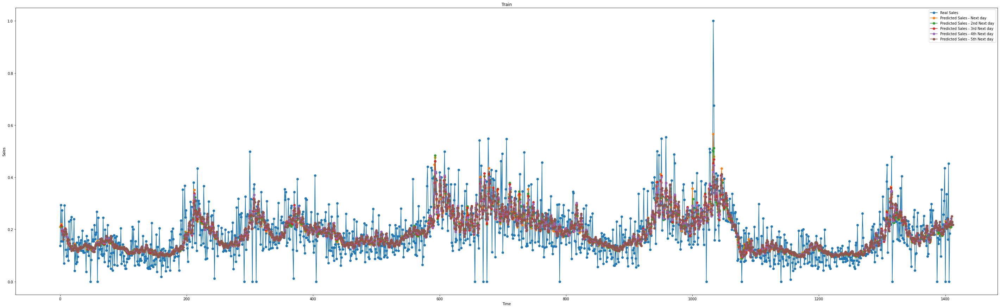

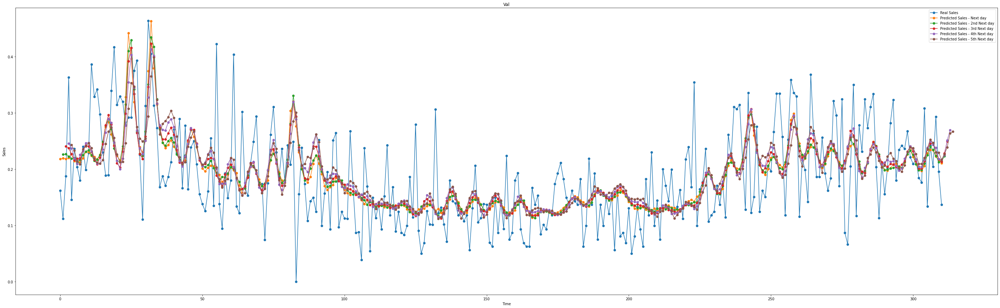

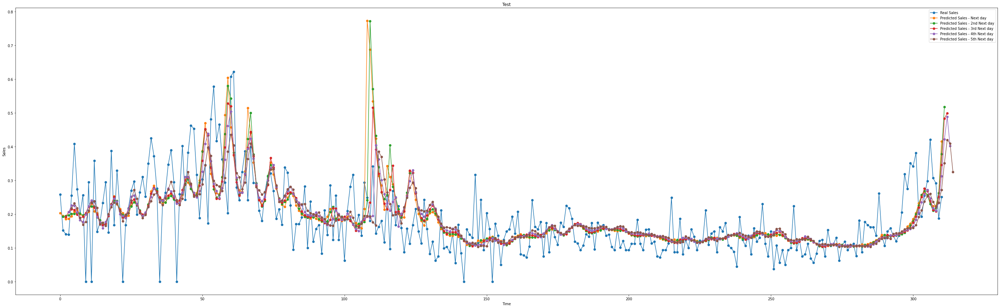

In [ ]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

### Variations

#### 30/50 neurons

Epoch 00129: early stopping
============================model:0===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0573
loss and metric train data [0.006308413110673428, 0.05732958763837814]
10/10 [==============================] - 0s 3ms/step - loss: 0.0052 - mae: 0.0565
loss and metric val data [0.005179206840693951, 0.0564601793885231]
10/10 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0598
loss and metric test data [0.0066442242823541164, 0.059776902198791504]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




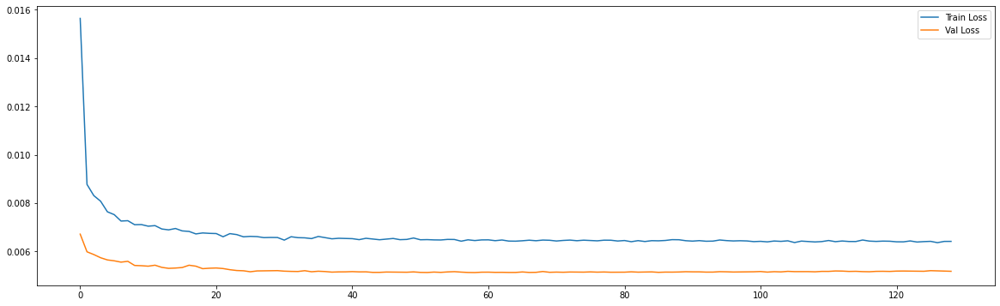

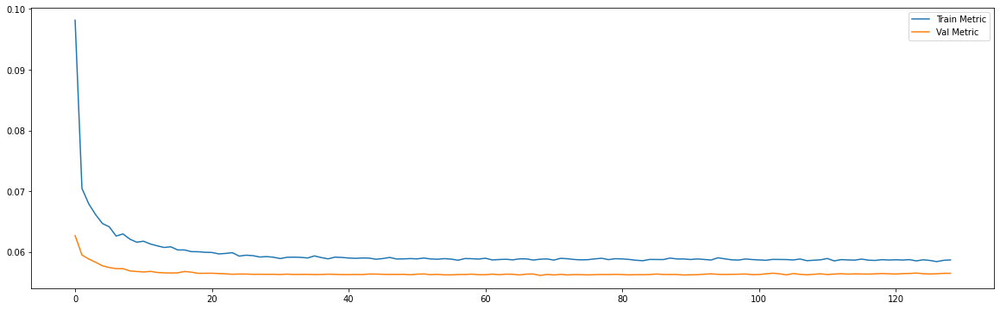

Epoch 00111: early stopping
============================model:1===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0574
loss and metric train data [0.006247466895729303, 0.05737174674868584]
10/10 [==============================] - 0s 6ms/step - loss: 0.0052 - mae: 0.0569
loss and metric val data [0.005194002762436867, 0.05687812343239784]
10/10 [==============================] - 0s 5ms/step - loss: 0.0066 - mae: 0.0600
loss and metric test data [0.00662107253447175, 0.06000635772943497]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




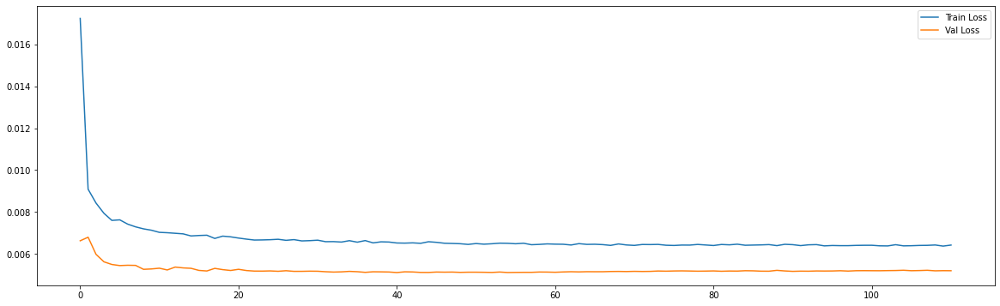

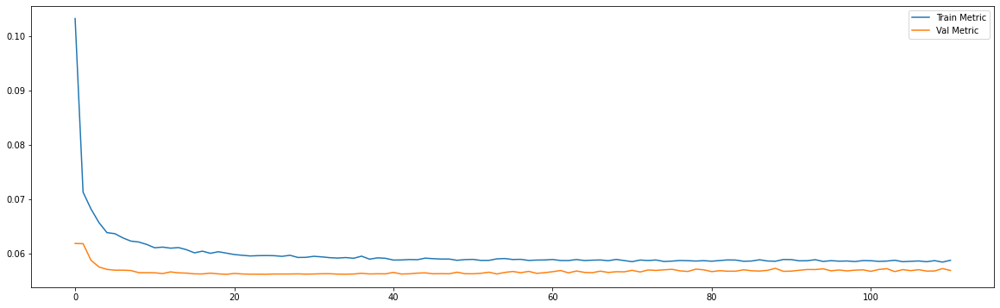

Epoch 00121: early stopping
============================model:2===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0584
loss and metric train data [0.006318240892142057, 0.05836997553706169]
10/10 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0580
loss and metric val data [0.0052099027670919895, 0.05797773599624634]
10/10 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0606
loss and metric test data [0.006622660905122757, 0.06058124452829361]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




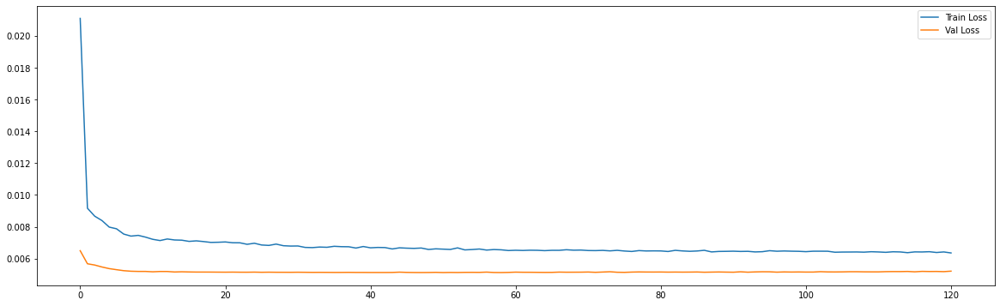

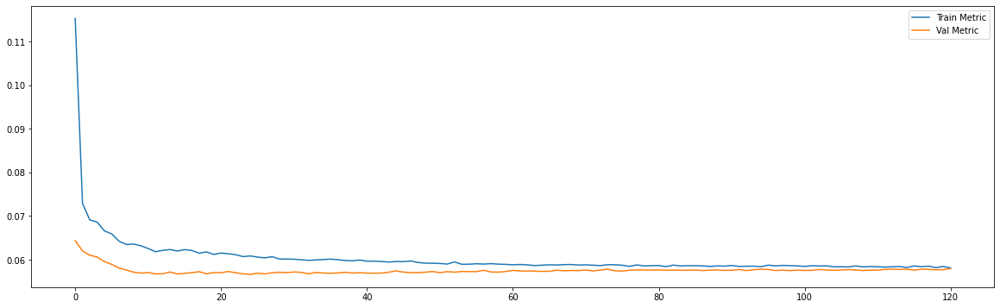

Epoch 00105: early stopping
============================model:3===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0579
loss and metric train data [0.006275607738643885, 0.05786571279168129]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0575
loss and metric val data [0.005187541246414185, 0.05748816952109337]
10/10 [==============================] - 0s 6ms/step - loss: 0.0066 - mae: 0.0604
loss and metric test data [0.006648444104939699, 0.060433004051446915]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




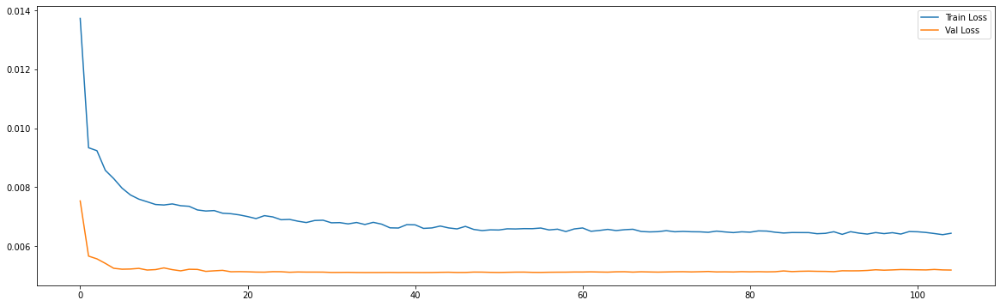

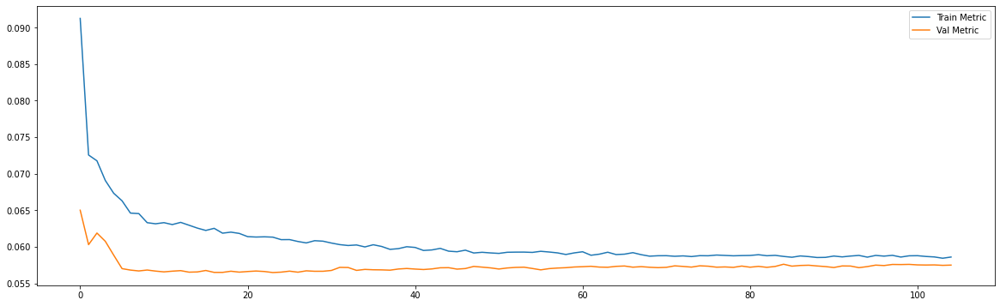

Epoch 00090: early stopping
============================model:4===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0063 - mae: 0.0572
loss and metric train data [0.00630355766043067, 0.05720674991607666]
10/10 [==============================] - 0s 5ms/step - loss: 0.0053 - mae: 0.0566
loss and metric val data [0.005295461975038052, 0.056600719690322876]
10/10 [==============================] - 0s 5ms/step - loss: 0.0069 - mae: 0.0611
loss and metric test data [0.006905858404934406, 0.06109261140227318]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




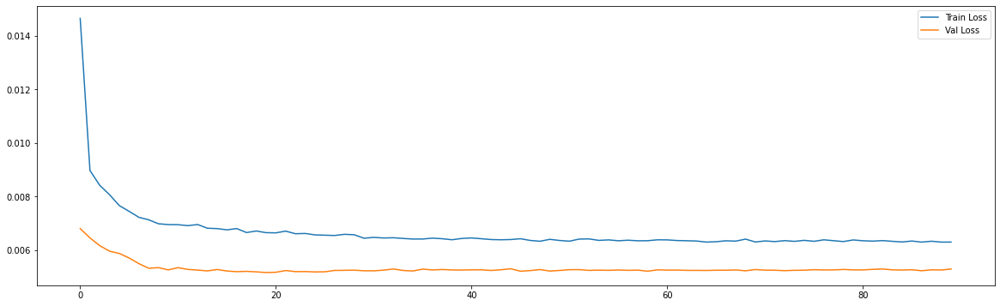

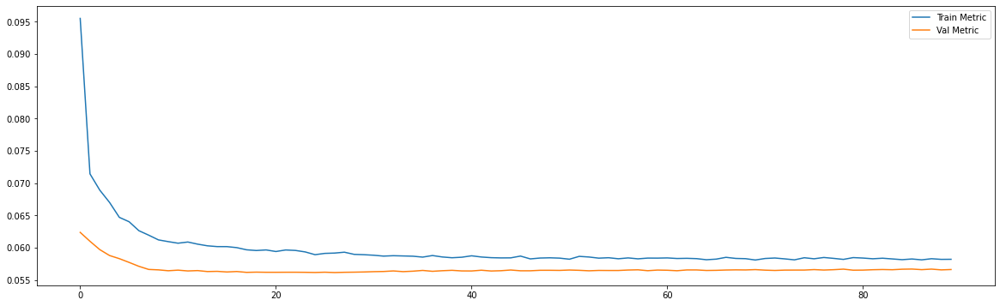

Epoch 00092: early stopping
============================model:5===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0064 - mae: 0.0579
loss and metric train data [0.00640497263520956, 0.05790260061621666]
10/10 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0572
loss and metric val data [0.005379535723477602, 0.057152505964040756]
10/10 [==============================] - 0s 9ms/step - loss: 0.0074 - mae: 0.0633
loss and metric test data [0.007386626210063696, 0.06332826614379883]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




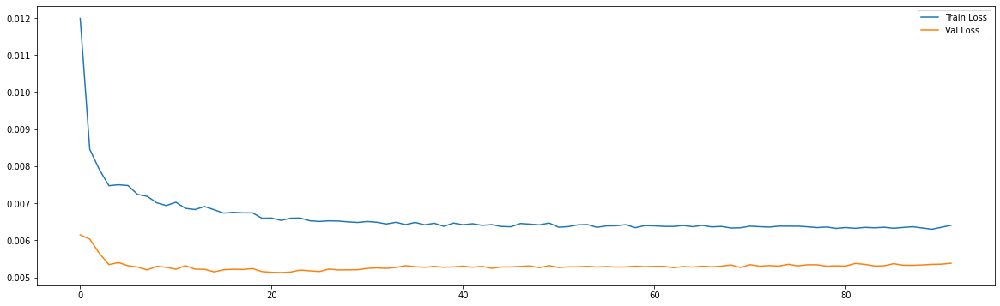

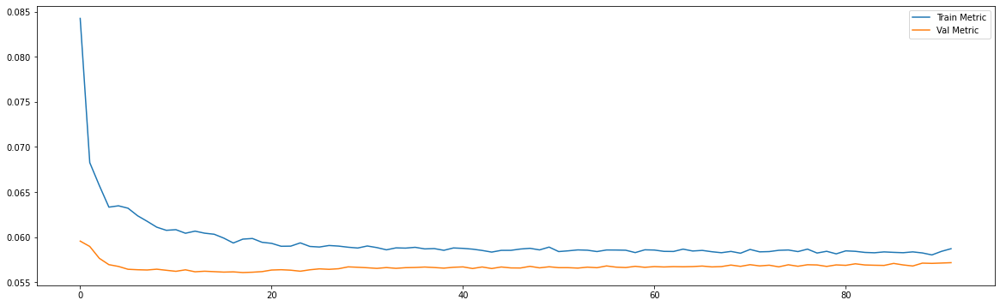

Epoch 00125: early stopping
============================model:6===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0573
loss and metric train data [0.006189737468957901, 0.05727110430598259]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0573
loss and metric val data [0.005244810599833727, 0.05730558931827545]
10/10 [==============================] - 0s 6ms/step - loss: 0.0067 - mae: 0.0609
loss and metric test data [0.006709141191095114, 0.06093055382370949]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




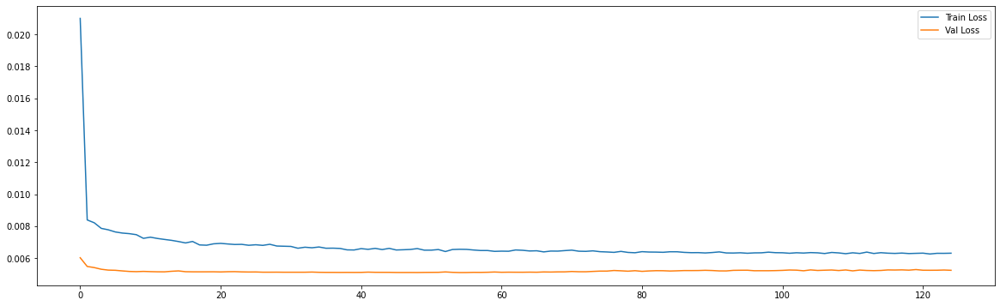

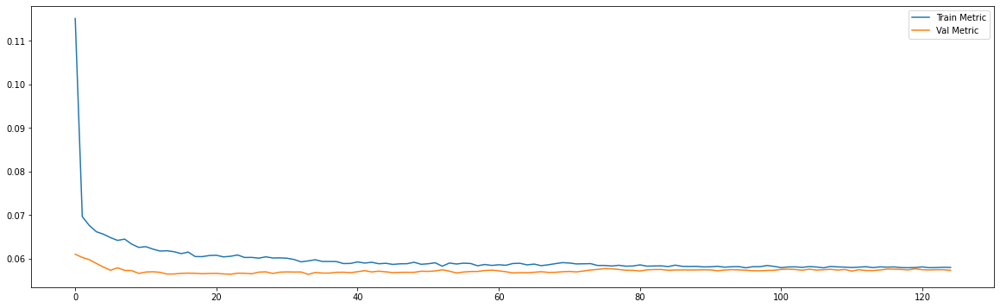

Epoch 00100: early stopping
============================model:7===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0569
loss and metric train data [0.006196796894073486, 0.05690770223736763]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0571
loss and metric val data [0.005289971362799406, 0.05714568495750427]
10/10 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0616
loss and metric test data [0.006967749446630478, 0.06161082163453102]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




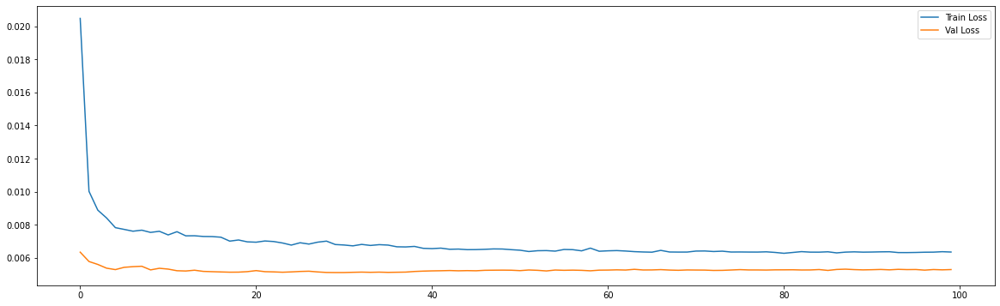

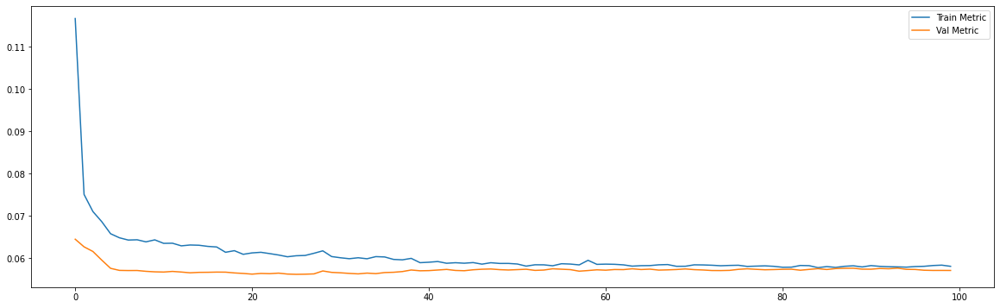

Epoch 00100: early stopping
============================model:8===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0572
loss and metric train data [0.006323142908513546, 0.0572015643119812]
10/10 [==============================] - 0s 7ms/step - loss: 0.0053 - mae: 0.0572
loss and metric val data [0.00528954342007637, 0.05717501416802406]
10/10 [==============================] - 0s 7ms/step - loss: 0.0068 - mae: 0.0609
loss and metric test data [0.006818785332143307, 0.06089121103286743]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




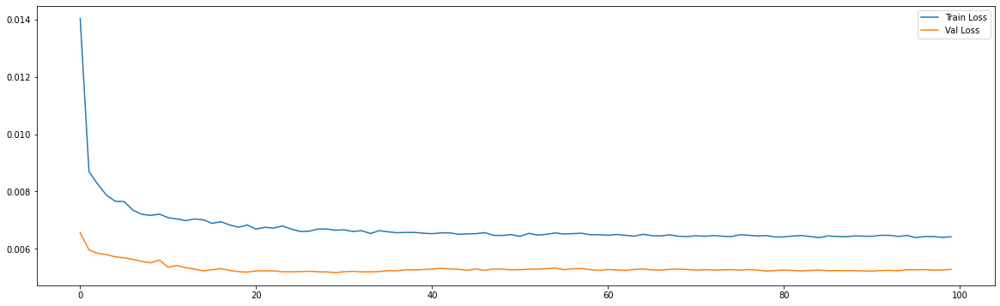

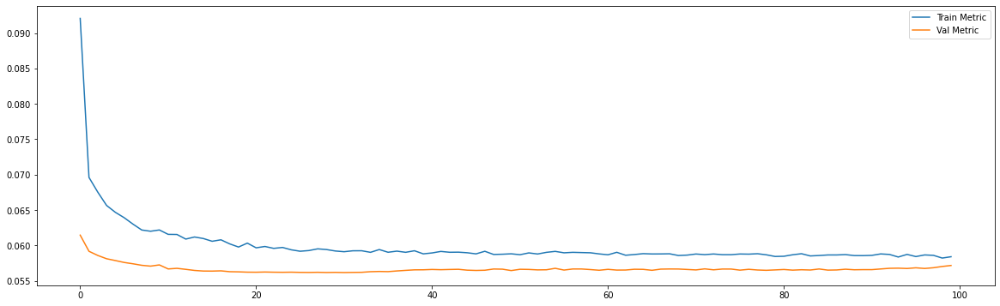

Epoch 00099: early stopping
============================model:9===========================
43/43 [==============================] - 1s 16ms/step - loss: 0.0064 - mae: 0.0573
loss and metric train data [0.006385523825883865, 0.05733948200941086]
10/10 [==============================] - 0s 15ms/step - loss: 0.0054 - mae: 0.0570
loss and metric val data [0.005380613263696432, 0.05701228231191635]
10/10 [==============================] - 0s 15ms/step - loss: 0.0070 - mae: 0.0617
loss and metric test data [0.0070056794211268425, 0.061653509736061096]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




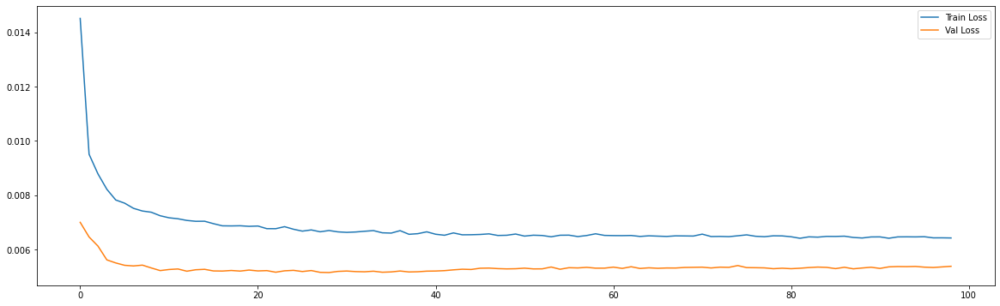

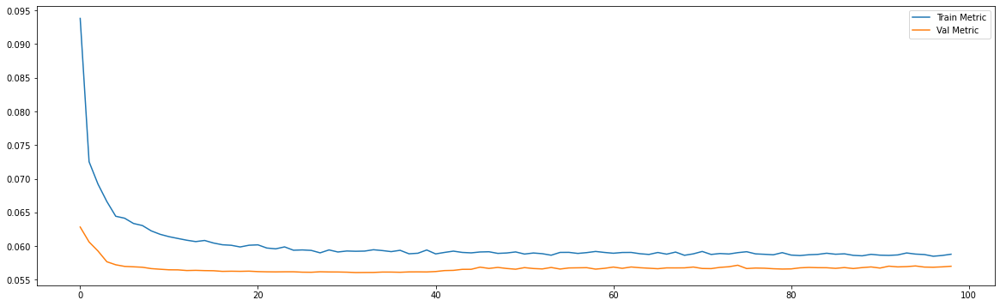

Epoch 00131: early stopping
============================model:10===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0579
loss and metric train data [0.006298784166574478, 0.05793675035238266]
10/10 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0584
loss and metric val data [0.005328874569386244, 0.058421872556209564]
10/10 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0610
loss and metric test data [0.006718899123370647, 0.0610382966697216]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




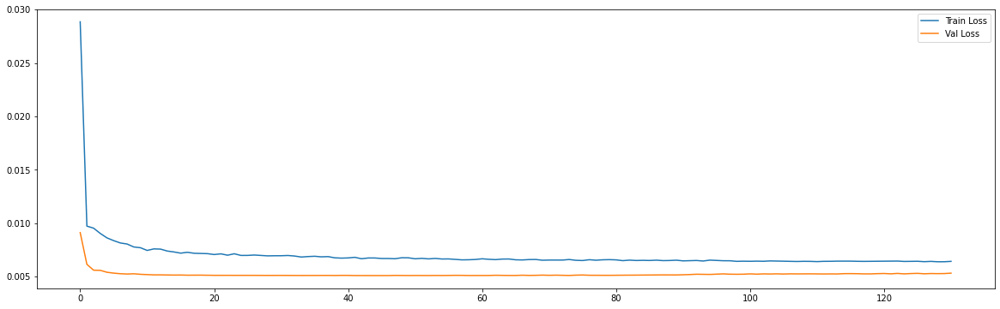

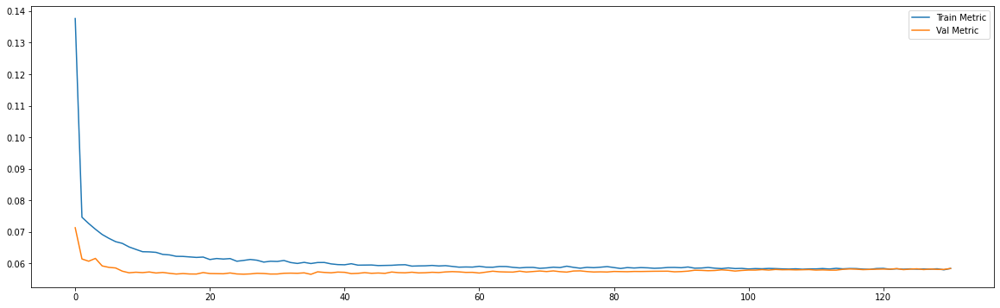

Epoch 00102: early stopping
============================model:11===========================
43/43 [==============================] - 1s 16ms/step - loss: 0.0063 - mae: 0.0576
loss and metric train data [0.006262543611228466, 0.057599592953920364]
10/10 [==============================] - 0s 16ms/step - loss: 0.0054 - mae: 0.0586
loss and metric val data [0.0054237074218690395, 0.05862930417060852]
10/10 [==============================] - 0s 15ms/step - loss: 0.0068 - mae: 0.0617
loss and metric test data [0.006847395561635494, 0.06165827065706253]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




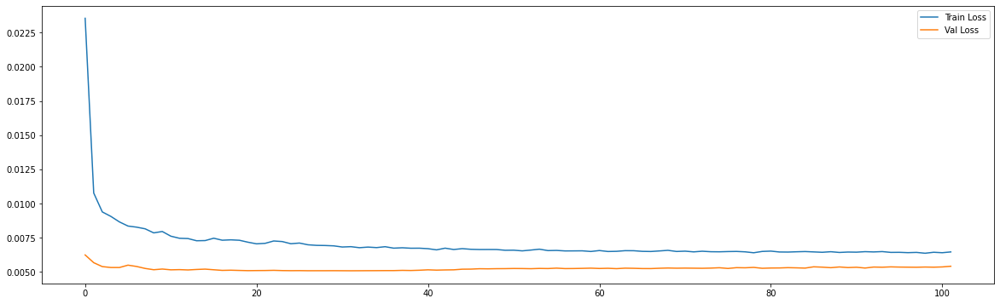

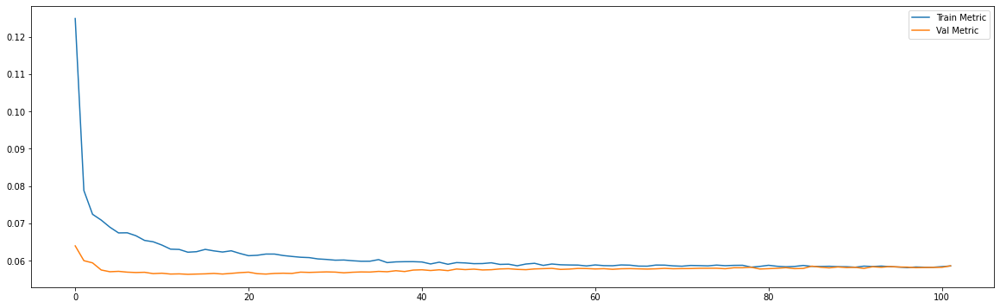

Epoch 00111: early stopping
============================model:12===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0573
loss and metric train data [0.0062994263134896755, 0.05733557417988777]
10/10 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0566
loss and metric val data [0.005198476370424032, 0.05664946138858795]
10/10 [==============================] - 0s 4ms/step - loss: 0.0067 - mae: 0.0599
loss and metric test data [0.006657042074948549, 0.05991162359714508]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




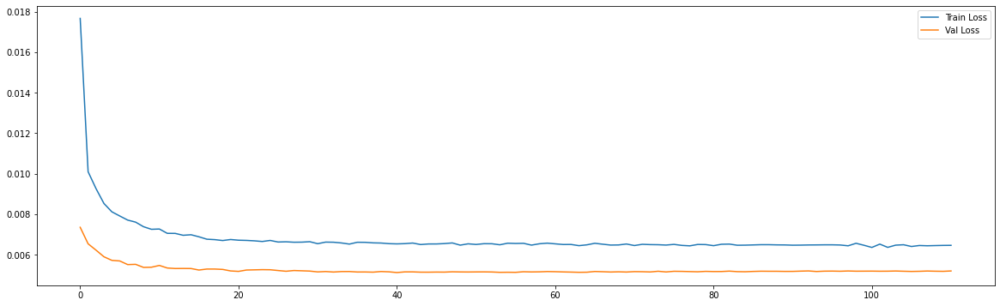

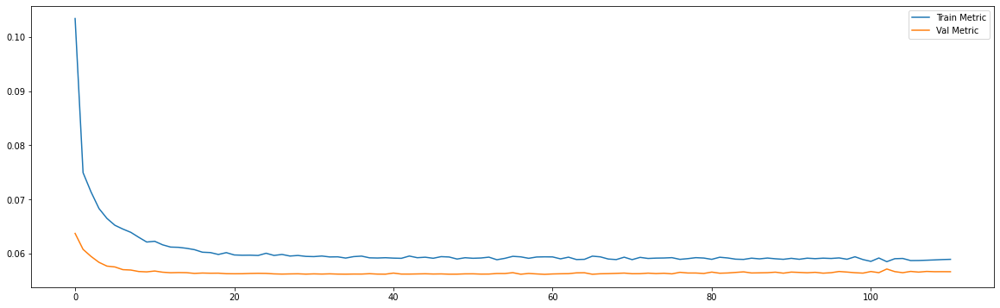

Epoch 00134: early stopping
============================model:13===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0575
loss and metric train data [0.00623891968280077, 0.05752182751893997]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0573
loss and metric val data [0.005212843418121338, 0.05725356936454773]
10/10 [==============================] - 0s 5ms/step - loss: 0.0066 - mae: 0.0603
loss and metric test data [0.006623868364840746, 0.060260120779275894]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




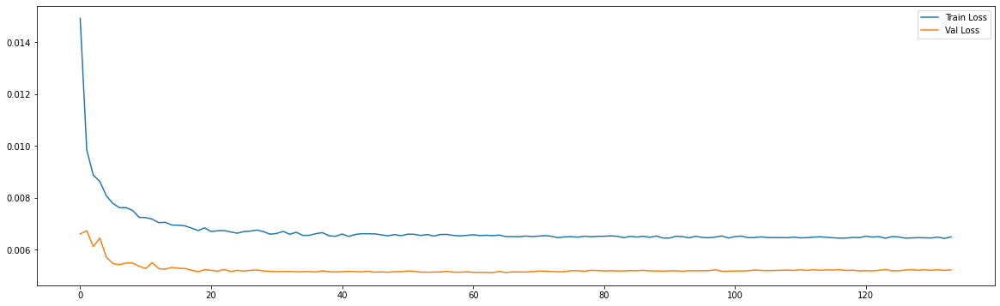

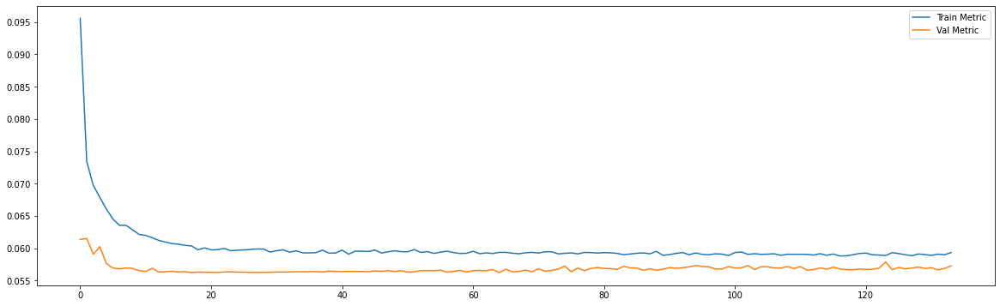

Epoch 00112: early stopping
============================model:14===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0583
loss and metric train data [0.006340547930449247, 0.058338697999715805]
10/10 [==============================] - 0s 4ms/step - loss: 0.0051 - mae: 0.0577
loss and metric val data [0.0051489416509866714, 0.057718049734830856]
10/10 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0604
loss and metric test data [0.006613559555262327, 0.0603579618036747]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




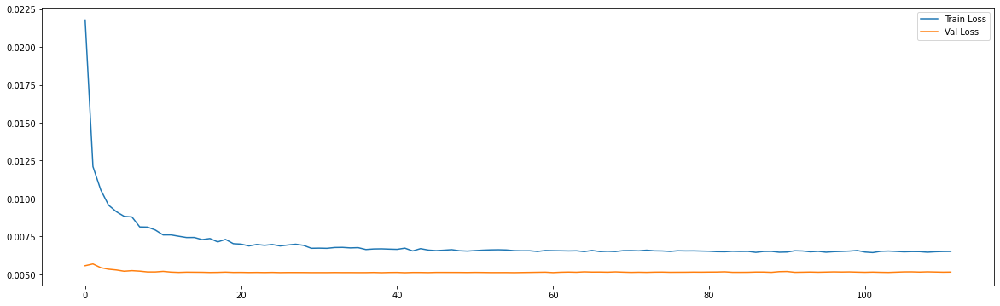

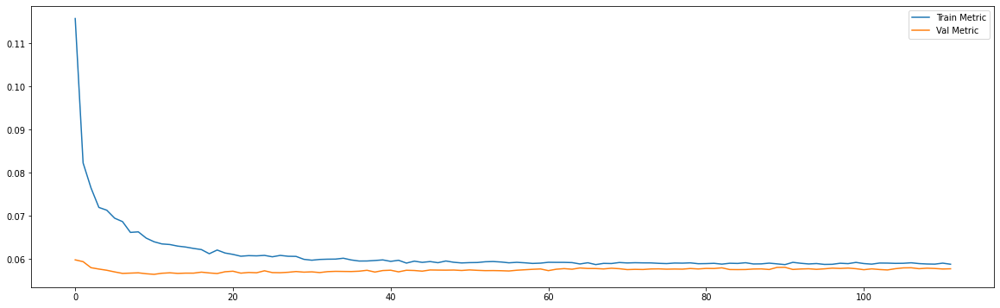

Epoch 00114: early stopping
============================model:15===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0580
loss and metric train data [0.006281815003603697, 0.05797744542360306]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0577
loss and metric val data [0.005197061225771904, 0.057697951793670654]
10/10 [==============================] - 0s 5ms/step - loss: 0.0066 - mae: 0.0604
loss and metric test data [0.006632614880800247, 0.06042004004120827]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




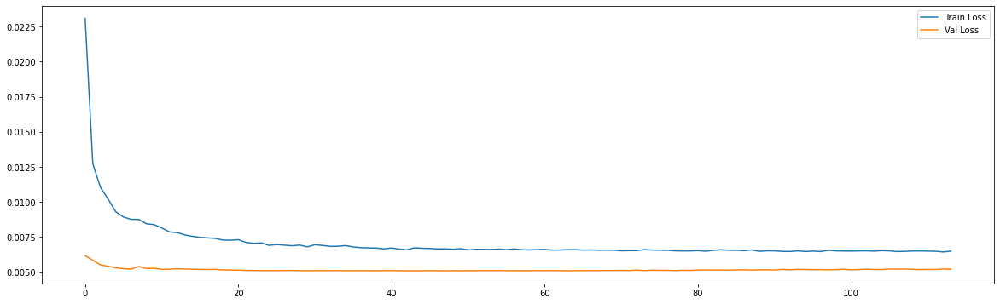

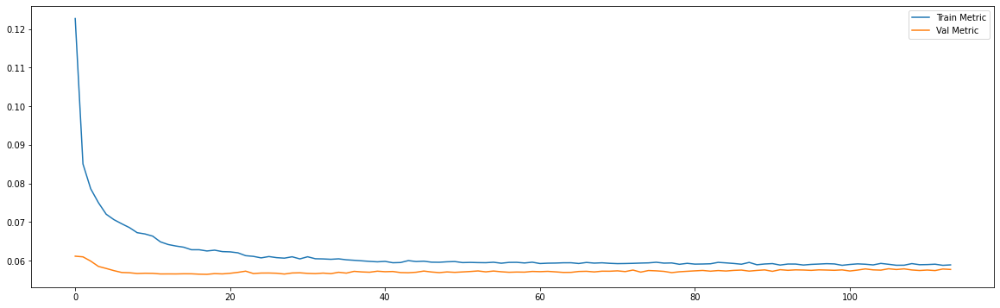

Epoch 00095: early stopping
============================model:16===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0063 - mae: 0.0570
loss and metric train data [0.00626407191157341, 0.05696563050150871]
10/10 [==============================] - 0s 5ms/step - loss: 0.0053 - mae: 0.0566
loss and metric val data [0.005262475460767746, 0.05659838020801544]
10/10 [==============================] - 0s 5ms/step - loss: 0.0068 - mae: 0.0605
loss and metric test data [0.0067968000657856464, 0.06052926555275917]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




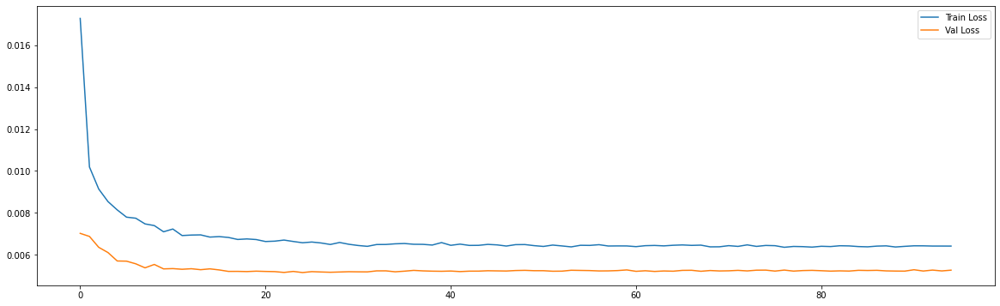

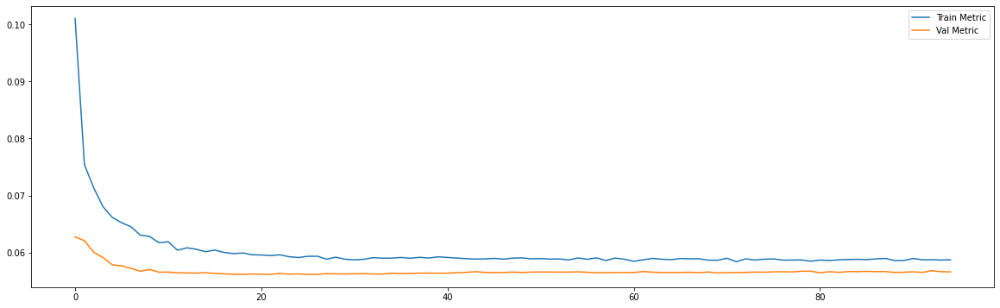

Epoch 00089: early stopping
============================model:17===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0573
loss and metric train data [0.006313622929155827, 0.05725419148802757]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0568
loss and metric val data [0.005293046589940786, 0.05679771304130554]
10/10 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0618
loss and metric test data [0.007091885432600975, 0.06177688017487526]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




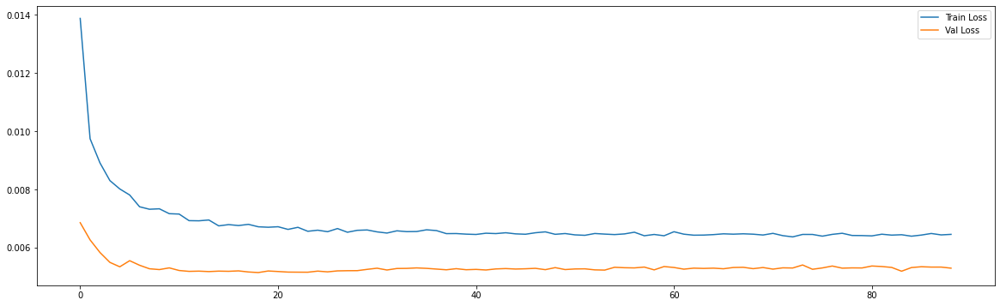

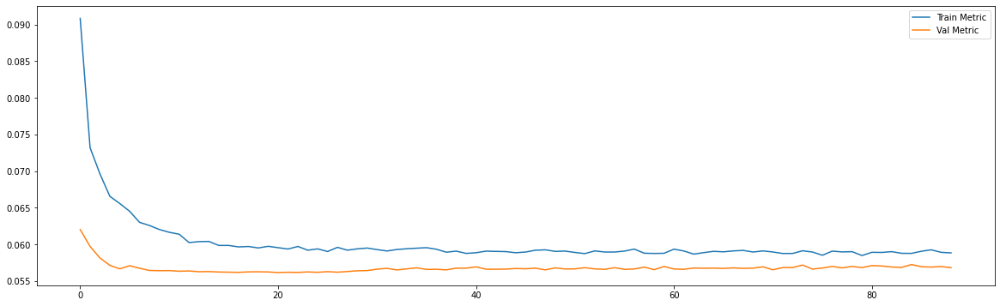

Epoch 00112: early stopping
============================model:18===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0571
loss and metric train data [0.0061834510415792465, 0.05712190642952919]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0573
loss and metric val data [0.005209923721849918, 0.05726008862257004]
10/10 [==============================] - 0s 5ms/step - loss: 0.0067 - mae: 0.0605
loss and metric test data [0.006651046685874462, 0.060532283037900925]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




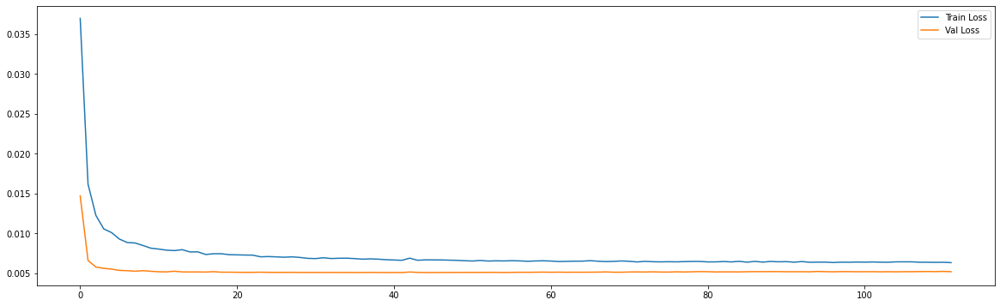

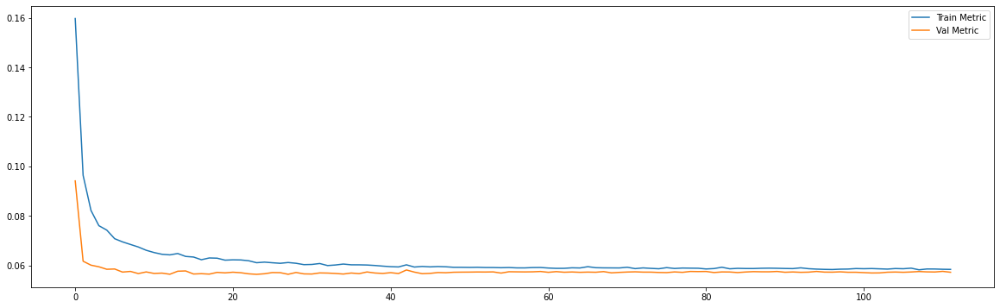

Epoch 00108: early stopping
============================model:19===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0571
loss and metric train data [0.006192969623953104, 0.05714608356356621]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0573
loss and metric val data [0.005264134146273136, 0.05728848651051521]
10/10 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0612
loss and metric test data [0.006844816263765097, 0.06120941787958145]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




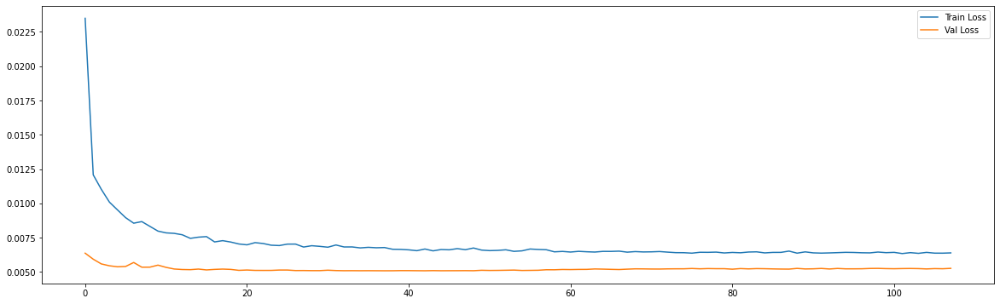

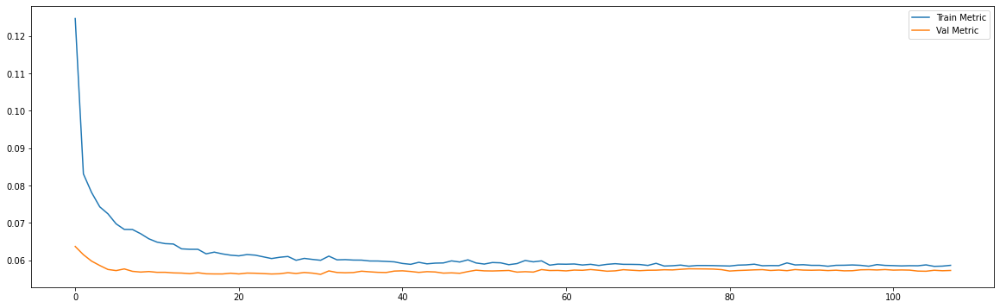

Epoch 00111: early stopping
============================model:20===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0572
loss and metric train data [0.006369305308908224, 0.05716797336935997]
10/10 [==============================] - 0s 7ms/step - loss: 0.0053 - mae: 0.0565
loss and metric val data [0.005257443059235811, 0.05654004588723183]
10/10 [==============================] - 0s 7ms/step - loss: 0.0069 - mae: 0.0610
loss and metric test data [0.006869696546345949, 0.06097789853811264]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




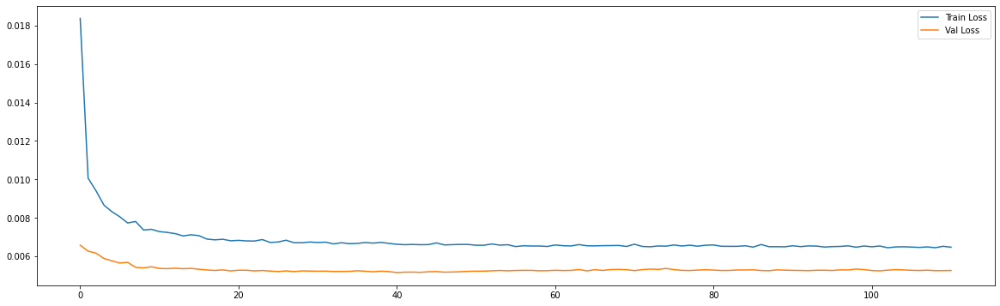

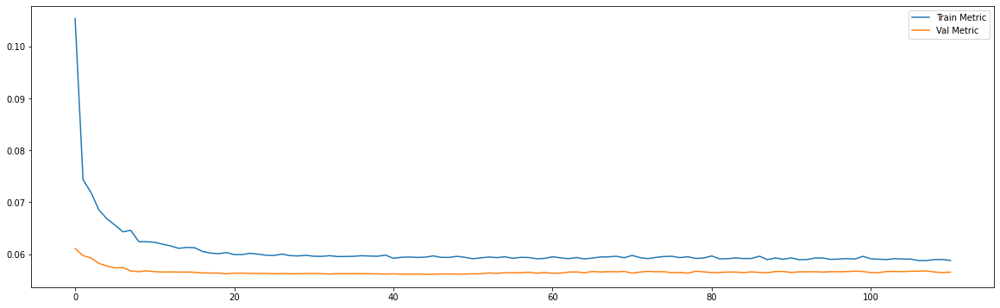

Epoch 00096: early stopping
============================model:21===========================
43/43 [==============================] - 1s 16ms/step - loss: 0.0063 - mae: 0.0571
loss and metric train data [0.0063453312031924725, 0.05707096308469772]
10/10 [==============================] - 0s 15ms/step - loss: 0.0053 - mae: 0.0568
loss and metric val data [0.005286825355142355, 0.05681169778108597]
10/10 [==============================] - 0s 15ms/step - loss: 0.0069 - mae: 0.0609
loss and metric test data [0.006887554656714201, 0.06088782474398613]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




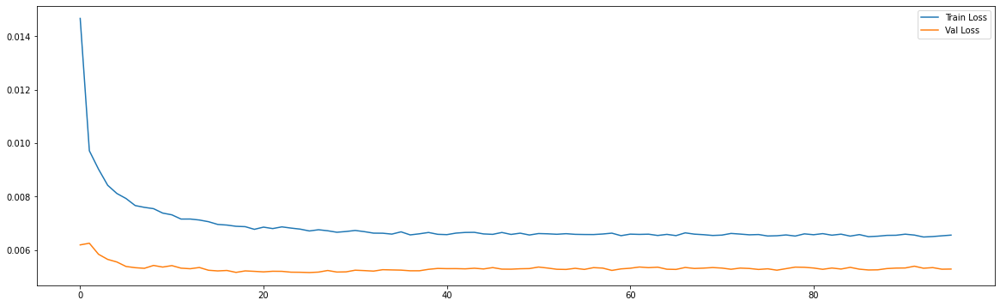

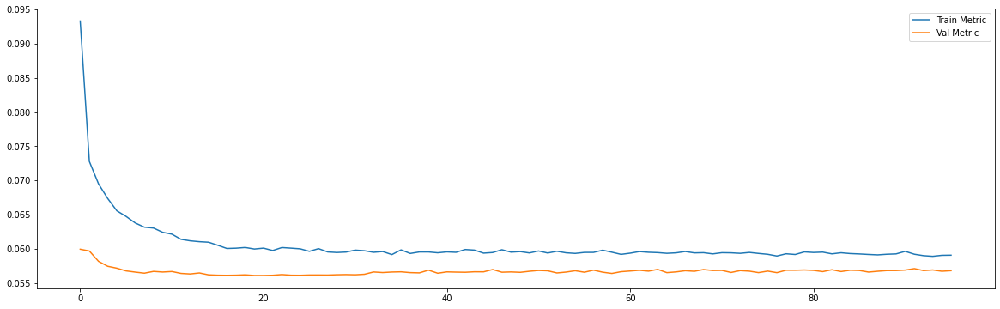

Epoch 00128: early stopping
============================model:22===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0576
loss and metric train data [0.00628402316942811, 0.057648416608572006]
10/10 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0581
loss and metric val data [0.005280795507133007, 0.05812021344900131]
10/10 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0607
loss and metric test data [0.006690524984151125, 0.06067986786365509]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




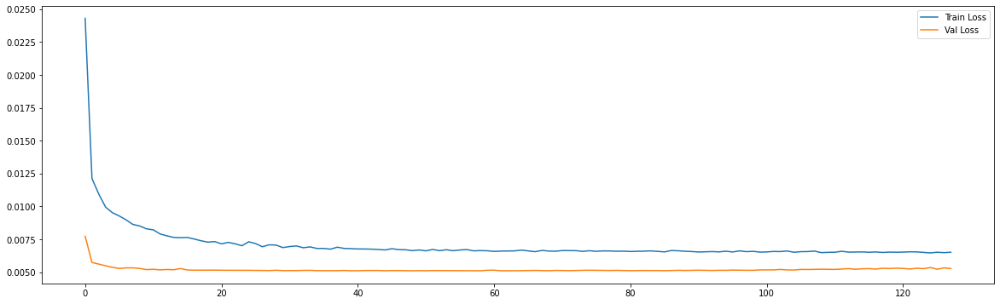

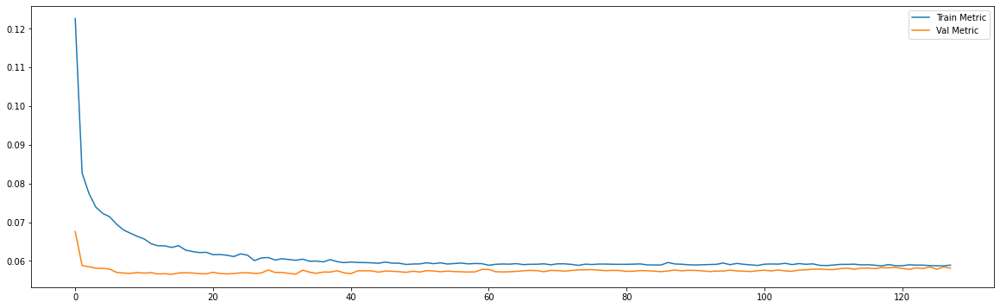

Epoch 00105: early stopping
============================model:23===========================
43/43 [==============================] - 1s 16ms/step - loss: 0.0063 - mae: 0.0574
loss and metric train data [0.006250620353966951, 0.05743750184774399]
10/10 [==============================] - 0s 16ms/step - loss: 0.0054 - mae: 0.0584
loss and metric val data [0.0053689563646912575, 0.0583532452583313]
10/10 [==============================] - 0s 15ms/step - loss: 0.0068 - mae: 0.0609
loss and metric test data [0.0067600407637655735, 0.06090072914958]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




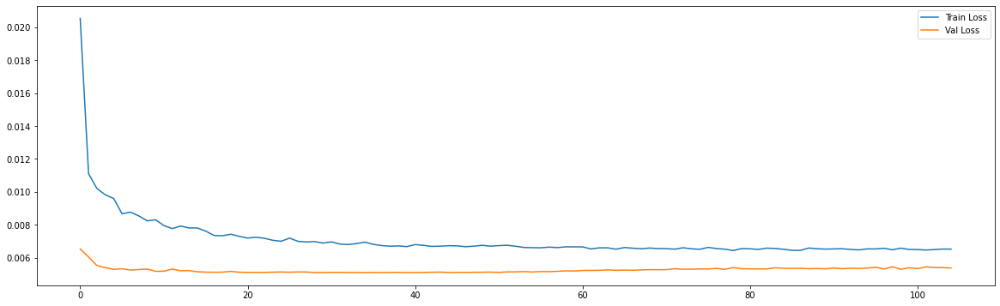

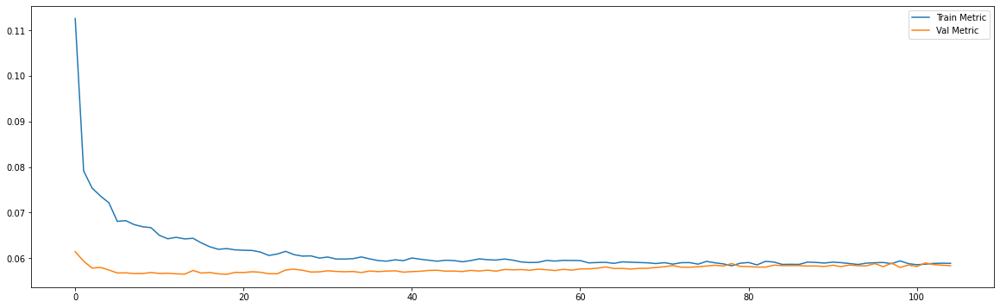

Epoch 00287: early stopping
============================model:24===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0564
loss and metric train data [0.005784295964986086, 0.056383538991212845]
10/10 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0563
loss and metric val data [0.005013852845877409, 0.05625824257731438]
10/10 [==============================] - 0s 3ms/step - loss: 0.0072 - mae: 0.0613
loss and metric test data [0.007178192492574453, 0.061320677399635315]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




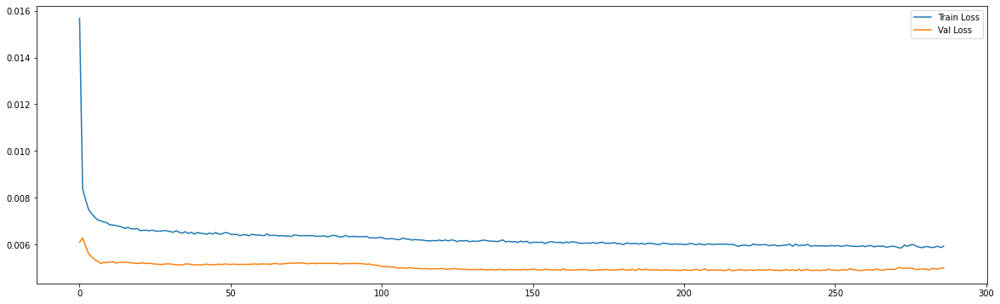

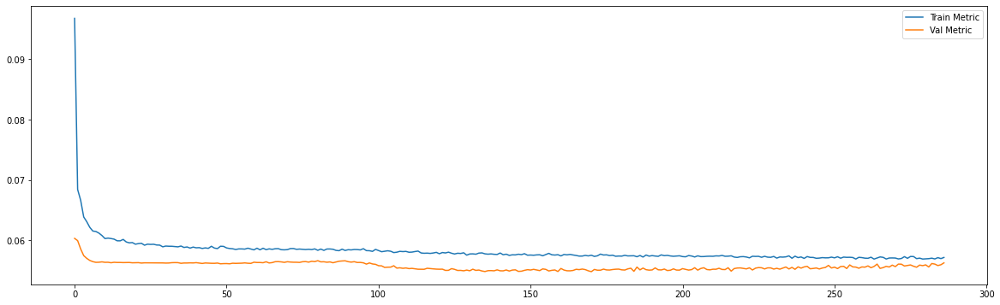

Epoch 00194: early stopping
============================model:25===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0058 - mae: 0.0564
loss and metric train data [0.005778367165476084, 0.05636914446949959]
10/10 [==============================] - 0s 6ms/step - loss: 0.0051 - mae: 0.0560
loss and metric val data [0.005081977695226669, 0.056027911603450775]
10/10 [==============================] - 0s 6ms/step - loss: 0.0074 - mae: 0.0601
loss and metric test data [0.007361133582890034, 0.0600808821618557]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




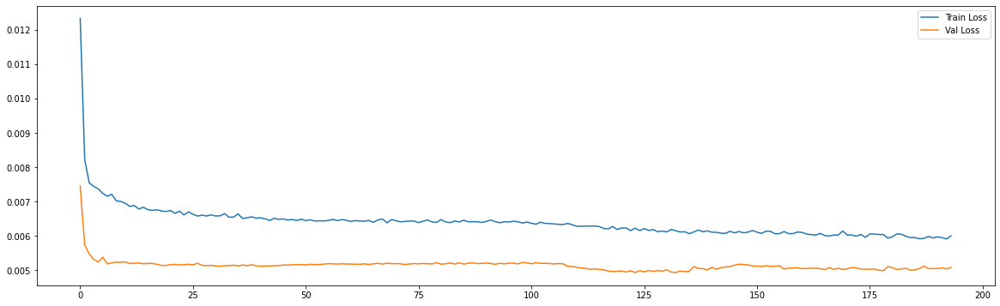

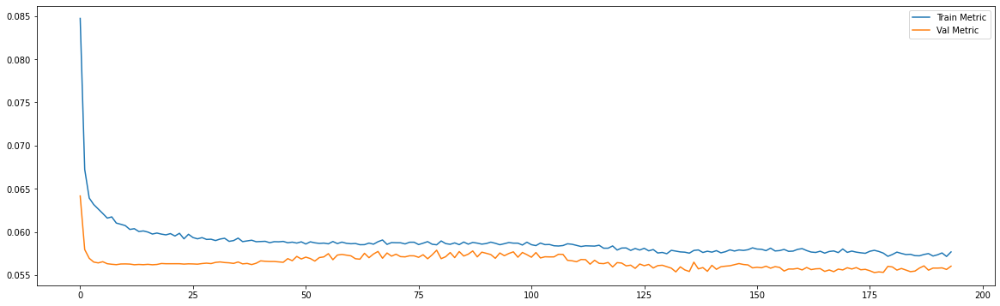

Epoch 00108: early stopping
============================model:26===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0583
loss and metric train data [0.006310373544692993, 0.05828411504626274]
10/10 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0579
loss and metric val data [0.00521107530221343, 0.05786573886871338]
10/10 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0604
loss and metric test data [0.006600043270736933, 0.060436002910137177]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




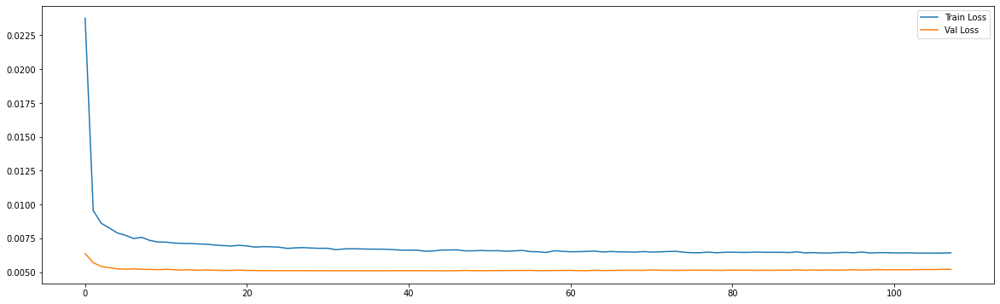

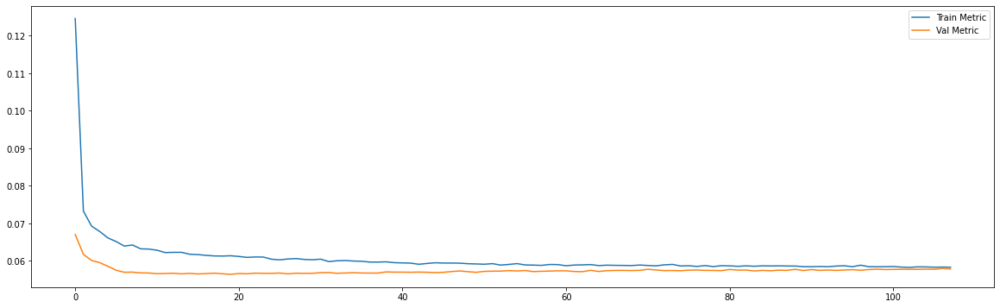

Epoch 00102: early stopping
============================model:27===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0578
loss and metric train data [0.006271939724683762, 0.05783290043473244]
10/10 [==============================] - 0s 6ms/step - loss: 0.0052 - mae: 0.0575
loss and metric val data [0.00522867264226079, 0.057456981390714645]
10/10 [==============================] - 0s 6ms/step - loss: 0.0066 - mae: 0.0604
loss and metric test data [0.006642643827944994, 0.06044956296682358]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




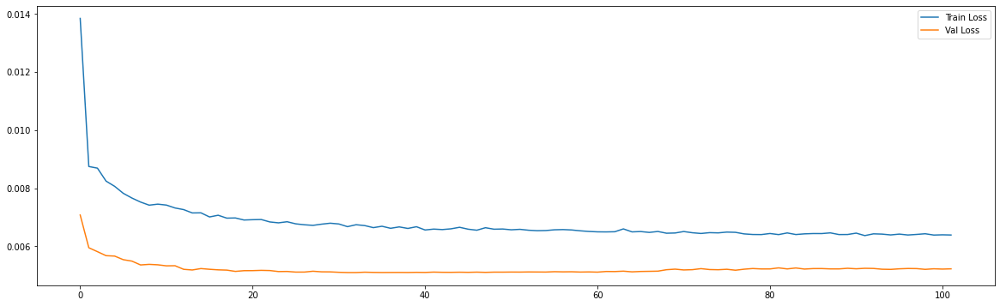

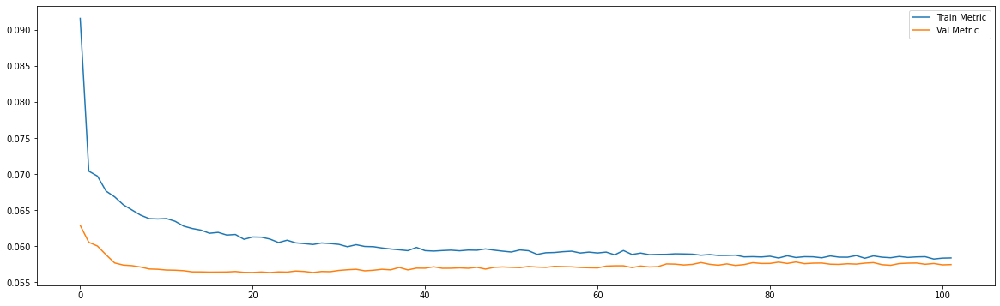

Epoch 00084: early stopping
============================model:28===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0574
loss and metric train data [0.006308679934591055, 0.05743853747844696]
10/10 [==============================] - 0s 5ms/step - loss: 0.0053 - mae: 0.0568
loss and metric val data [0.0053443326614797115, 0.05679282173514366]
10/10 [==============================] - 0s 5ms/step - loss: 0.0071 - mae: 0.0621
loss and metric test data [0.007093479391187429, 0.06208743155002594]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




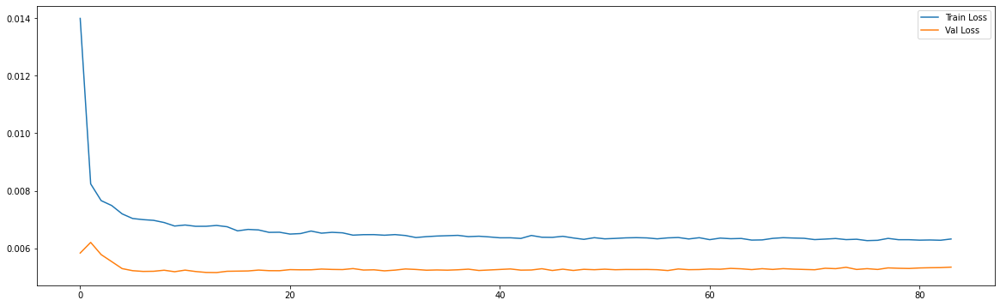

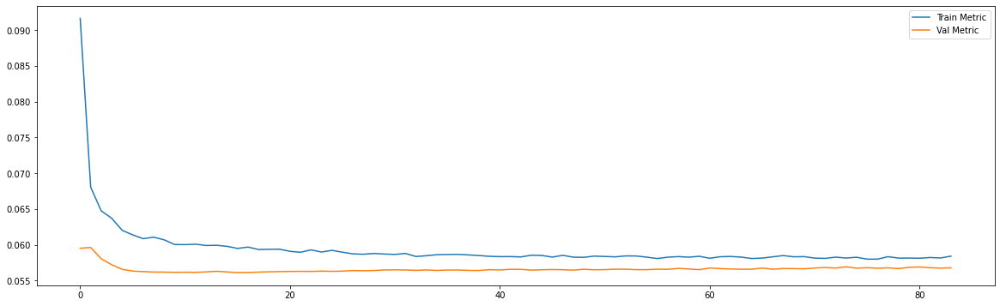

Epoch 00077: early stopping
============================model:29===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0062 - mae: 0.0573
loss and metric train data [0.0061962055042386055, 0.057290755212306976]
10/10 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0571
loss and metric val data [0.005160016939043999, 0.057145509868860245]
10/10 [==============================] - 0s 9ms/step - loss: 0.0066 - mae: 0.0603
loss and metric test data [0.006615941412746906, 0.06032771244645119]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




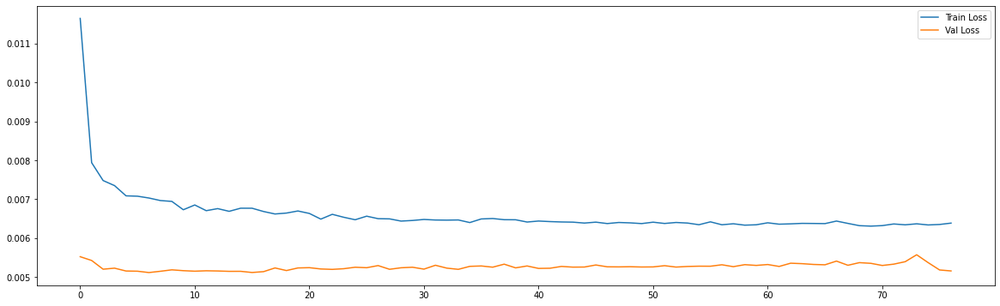

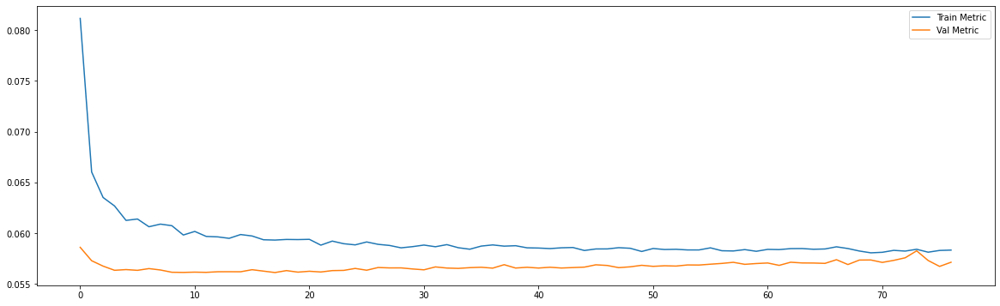

Epoch 00089: early stopping
============================model:30===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0571
loss and metric train data [0.006194021087139845, 0.05708028003573418]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0571
loss and metric val data [0.00522461486980319, 0.05705469846725464]
10/10 [==============================] - 0s 5ms/step - loss: 0.0067 - mae: 0.0608
loss and metric test data [0.006724902894347906, 0.06078958138823509]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




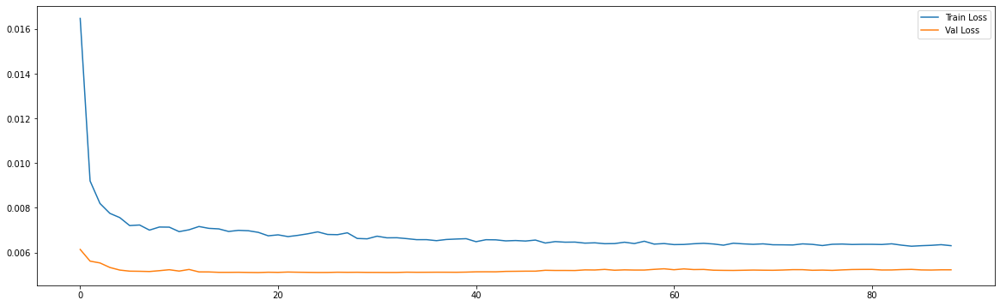

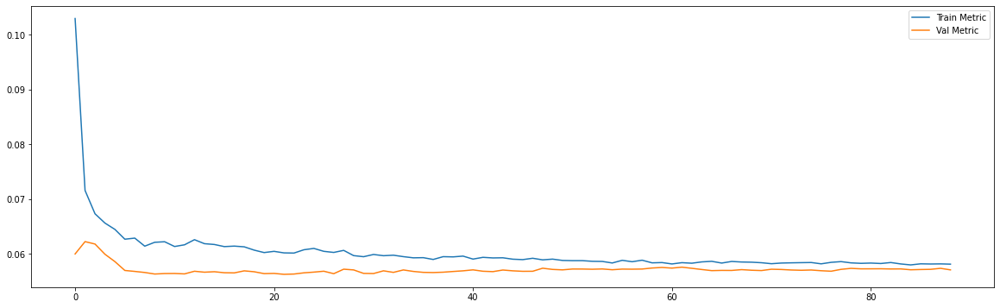

Epoch 00104: early stopping
============================model:31===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0062 - mae: 0.0571
loss and metric train data [0.00615451717749238, 0.05711737275123596]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0577
loss and metric val data [0.005346926394850016, 0.05767890438437462]
10/10 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0616
loss and metric test data [0.006876875180751085, 0.0615592785179615]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




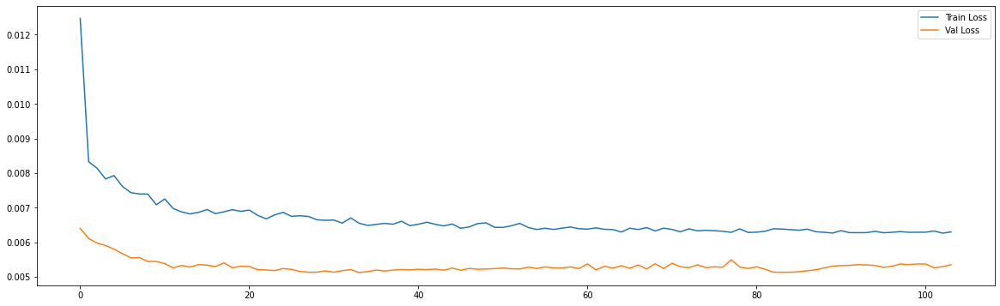

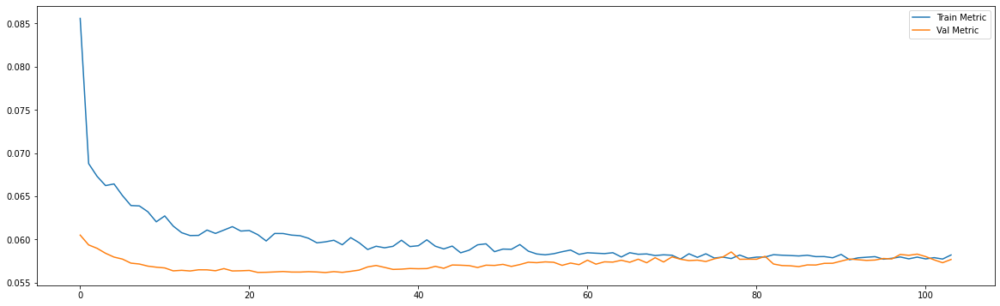

Epoch 00094: early stopping
============================model:32===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0572
loss and metric train data [0.006336171645671129, 0.057164888828992844]
10/10 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0569
loss and metric val data [0.0053418357856571674, 0.056857798248529434]
10/10 [==============================] - 0s 8ms/step - loss: 0.0069 - mae: 0.0611
loss and metric test data [0.00690306955948472, 0.06110247224569321]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




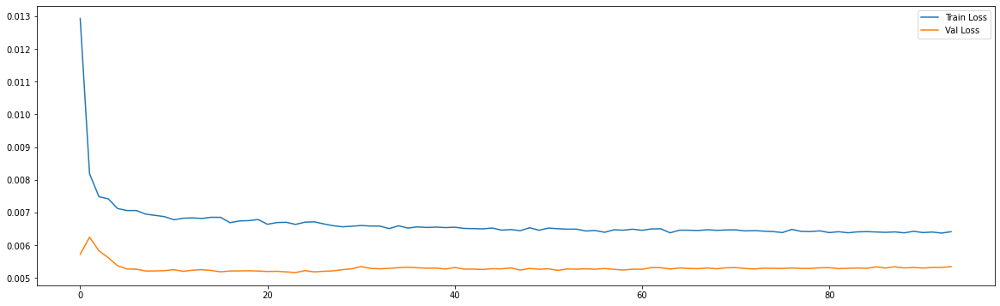

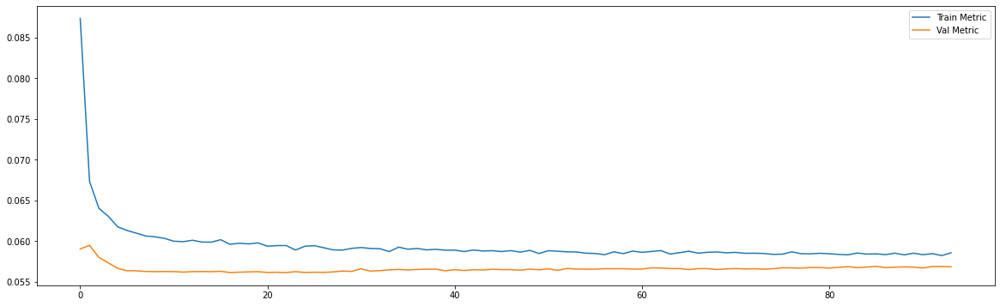

Epoch 00087: early stopping
============================model:33===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0063 - mae: 0.0572
loss and metric train data [0.006337375845760107, 0.05717543885111809]
10/10 [==============================] - 0s 16ms/step - loss: 0.0053 - mae: 0.0570
loss and metric val data [0.0053368061780929565, 0.05701611563563347]
10/10 [==============================] - 0s 16ms/step - loss: 0.0070 - mae: 0.0616
loss and metric test data [0.006994239054620266, 0.061638012528419495]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




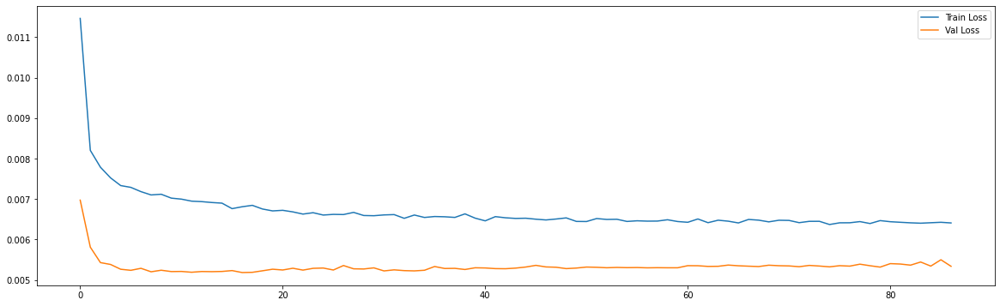

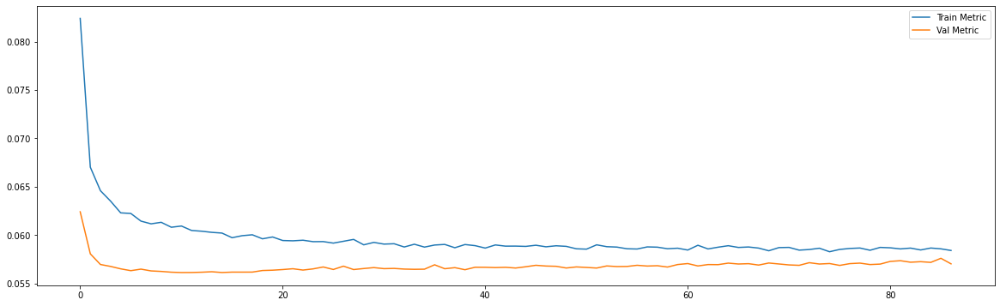

Epoch 00118: early stopping
============================model:34===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0578
loss and metric train data [0.00627056322991848, 0.05775698274374008]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0584
loss and metric val data [0.005341328680515289, 0.05838504061102867]
10/10 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0613
loss and metric test data [0.0067725516855716705, 0.06129680573940277]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




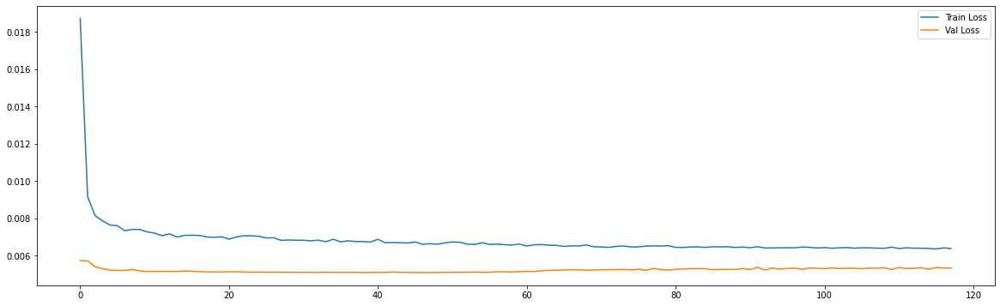

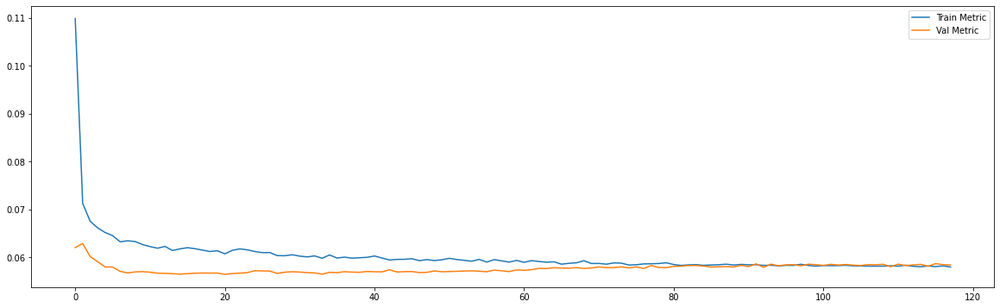

Epoch 00104: early stopping
============================model:35===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0062 - mae: 0.0572
loss and metric train data [0.006228642072528601, 0.05723286792635918]
10/10 [==============================] - 0s 16ms/step - loss: 0.0054 - mae: 0.0579
loss and metric val data [0.005364075303077698, 0.057883959263563156]
10/10 [==============================] - 0s 16ms/step - loss: 0.0069 - mae: 0.0615
loss and metric test data [0.006853586528450251, 0.06147380173206329]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




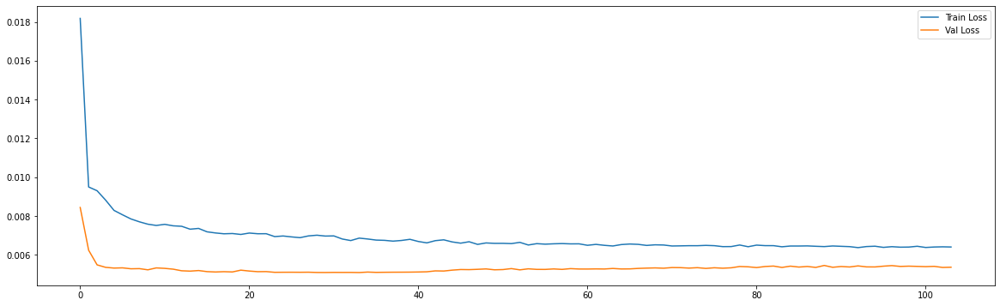

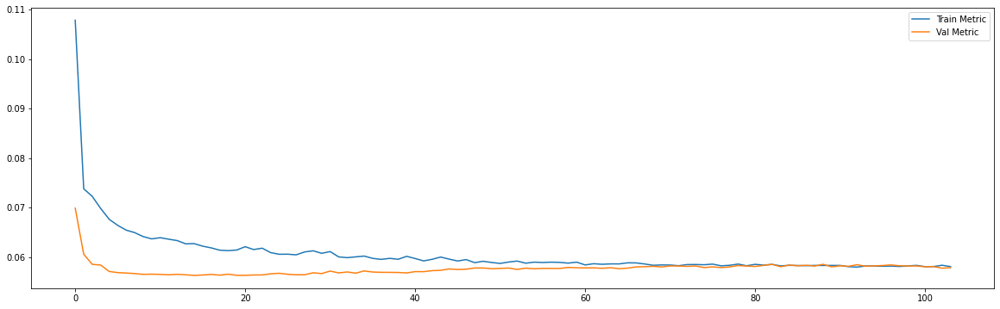

Epoch 00124: early stopping
============================model:36===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0573
loss and metric train data [0.006249468307942152, 0.05733078718185425]
10/10 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0567
loss and metric val data [0.005206889007240534, 0.05673035606741905]
10/10 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0602
loss and metric test data [0.006627432536333799, 0.060154445469379425]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




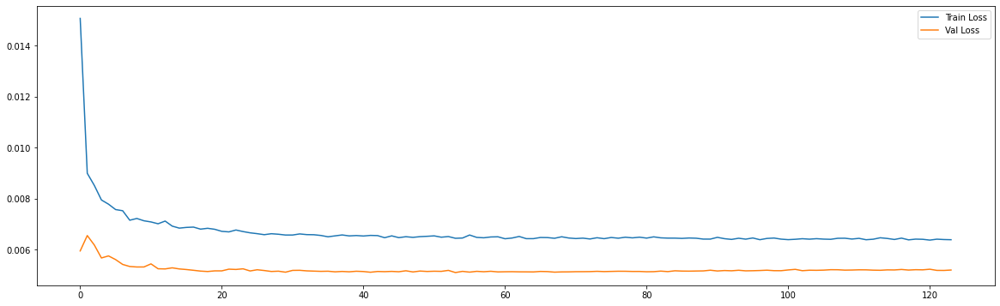

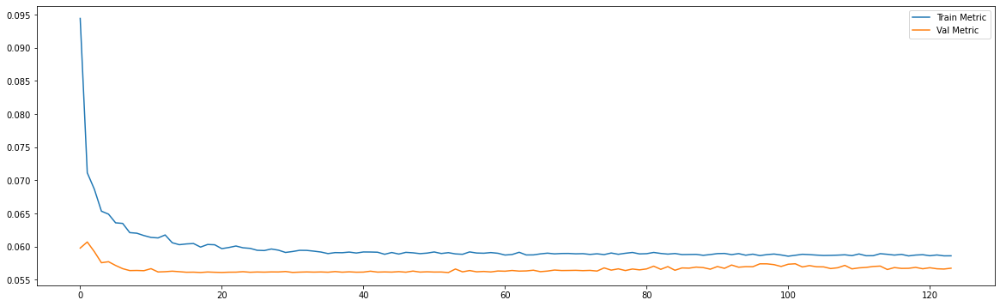

Epoch 00114: early stopping
============================model:37===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0576
loss and metric train data [0.006226313766092062, 0.05761781334877014]
10/10 [==============================] - 0s 6ms/step - loss: 0.0052 - mae: 0.0572
loss and metric val data [0.00520844291895628, 0.057249926030635834]
10/10 [==============================] - 0s 5ms/step - loss: 0.0066 - mae: 0.0603
loss and metric test data [0.006590059492737055, 0.060277096927165985]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




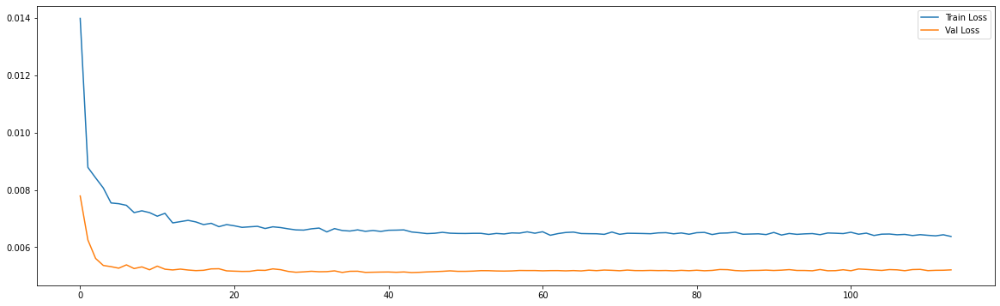

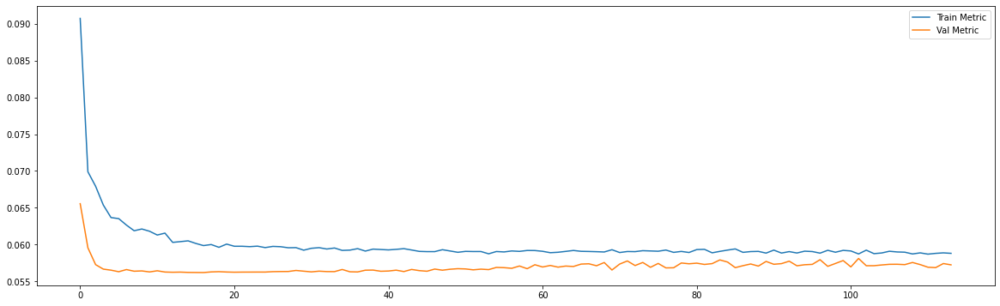

Epoch 00133: early stopping
============================model:38===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0580
loss and metric train data [0.006283153779804707, 0.05803212150931358]
10/10 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0578
loss and metric val data [0.0052238451316952705, 0.05778759345412254]
10/10 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0605
loss and metric test data [0.0066248150542378426, 0.06049739941954613]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




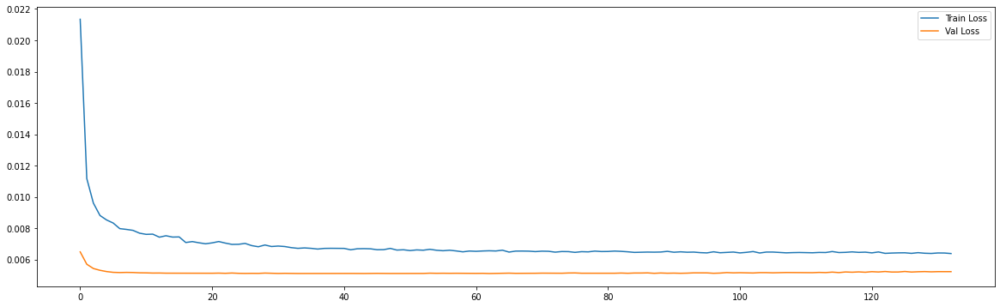

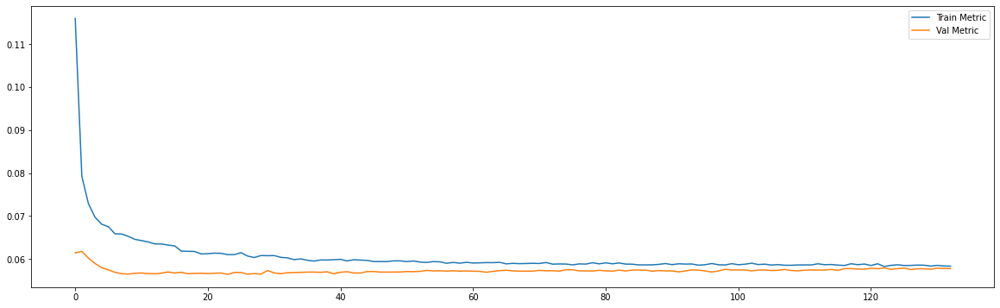

Epoch 00095: early stopping
============================model:39===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0576
loss and metric train data [0.006279256194829941, 0.05764639005064964]
10/10 [==============================] - 0s 6ms/step - loss: 0.0052 - mae: 0.0572
loss and metric val data [0.005183070432394743, 0.057168781757354736]
10/10 [==============================] - 0s 6ms/step - loss: 0.0066 - mae: 0.0602
loss and metric test data [0.006636860314756632, 0.06023721769452095]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




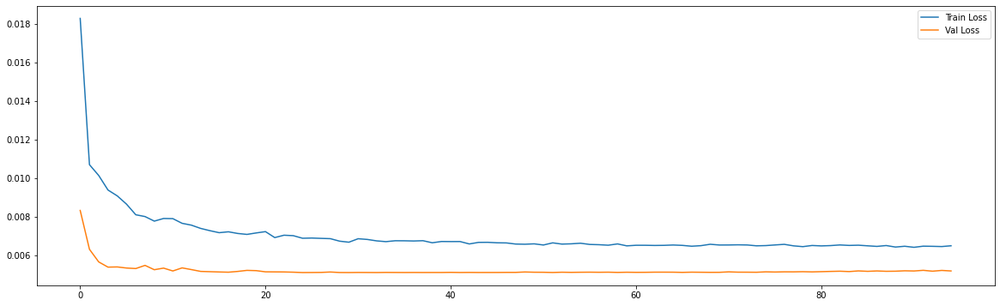

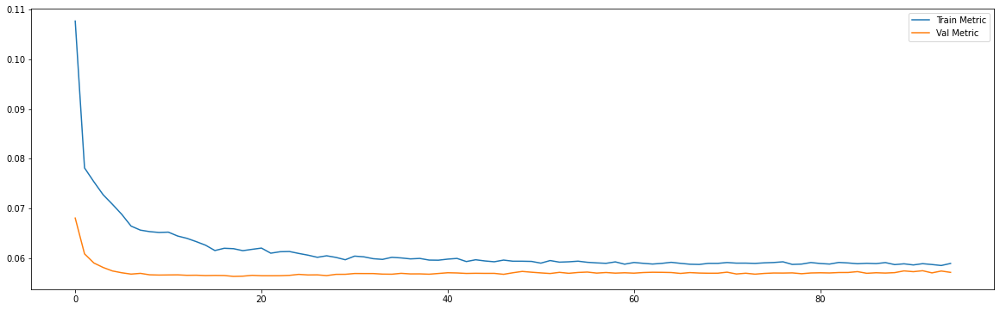

Epoch 00088: early stopping
============================model:40===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0572
loss and metric train data [0.006291823927313089, 0.05716753378510475]
10/10 [==============================] - 0s 6ms/step - loss: 0.0053 - mae: 0.0566
loss and metric val data [0.005293168593198061, 0.05660390853881836]
10/10 [==============================] - 0s 6ms/step - loss: 0.0069 - mae: 0.0611
loss and metric test data [0.006922690663486719, 0.061052218079566956]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




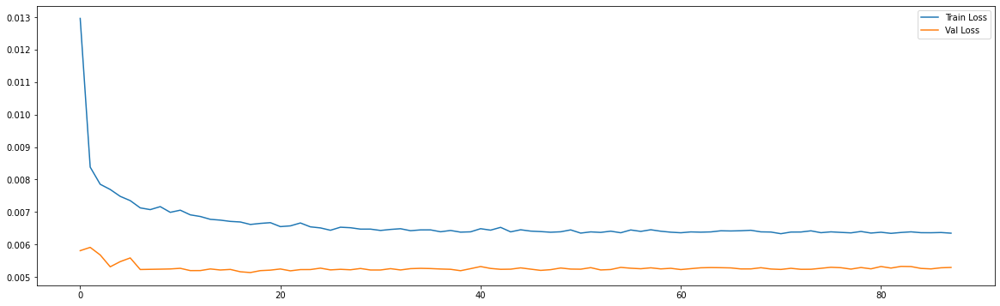

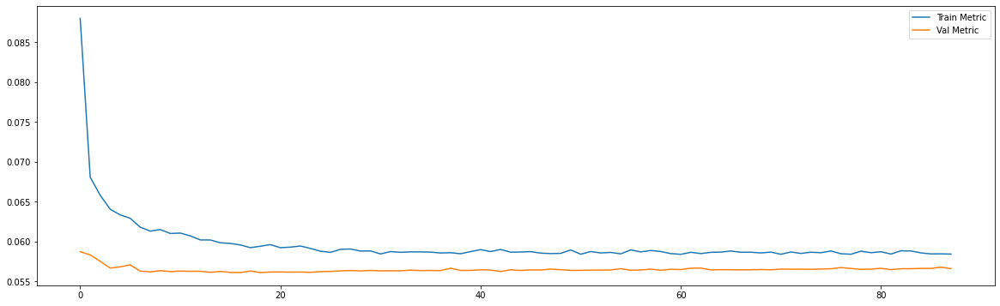

Epoch 00083: early stopping
============================model:41===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0063 - mae: 0.0577
loss and metric train data [0.006349386181682348, 0.05773961916565895]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0570
loss and metric val data [0.0052937851287424564, 0.057049017399549484]
10/10 [==============================] - 0s 9ms/step - loss: 0.0073 - mae: 0.0628
loss and metric test data [0.00727832829579711, 0.0628284141421318]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




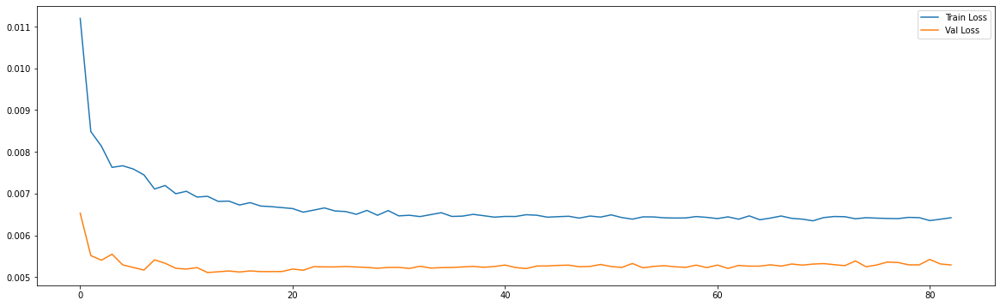

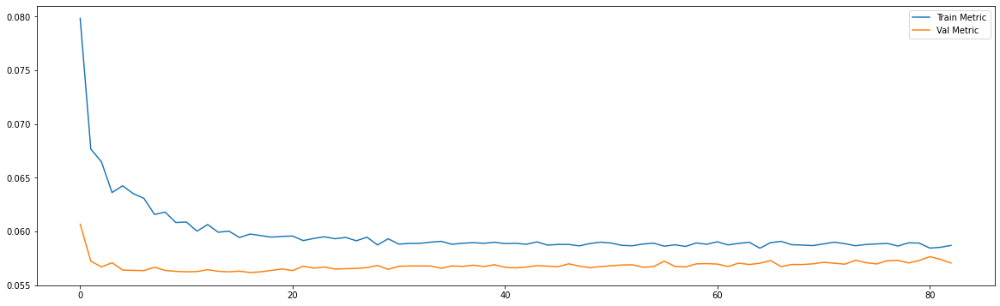

Epoch 00112: early stopping
============================model:42===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0571
loss and metric train data [0.006183501798659563, 0.05711061879992485]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0572
loss and metric val data [0.005226927809417248, 0.057192396372556686]
10/10 [==============================] - 0s 5ms/step - loss: 0.0067 - mae: 0.0605
loss and metric test data [0.006678929086774588, 0.06051083654165268]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




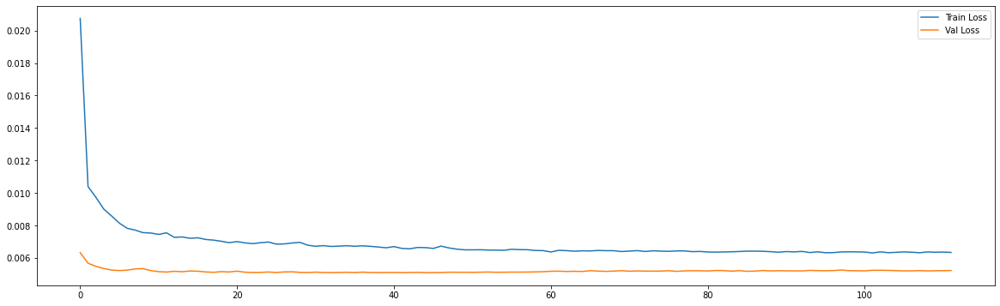

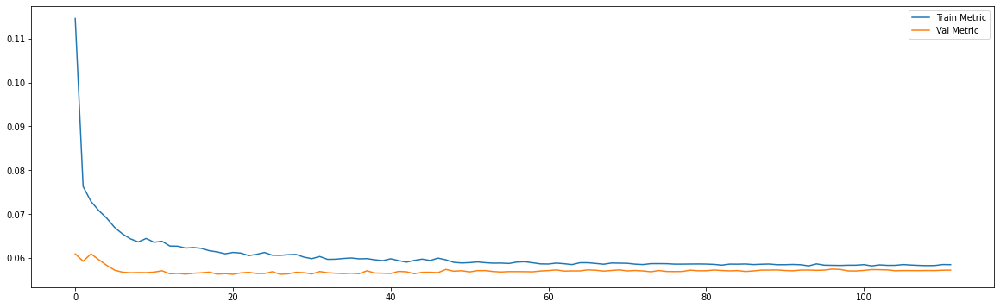

Epoch 00089: early stopping
============================model:43===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0063 - mae: 0.0576
loss and metric train data [0.006276142317801714, 0.05756999924778938]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0574
loss and metric val data [0.005311132408678532, 0.057421084493398666]
10/10 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0627
loss and metric test data [0.007202650420367718, 0.06268730759620667]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




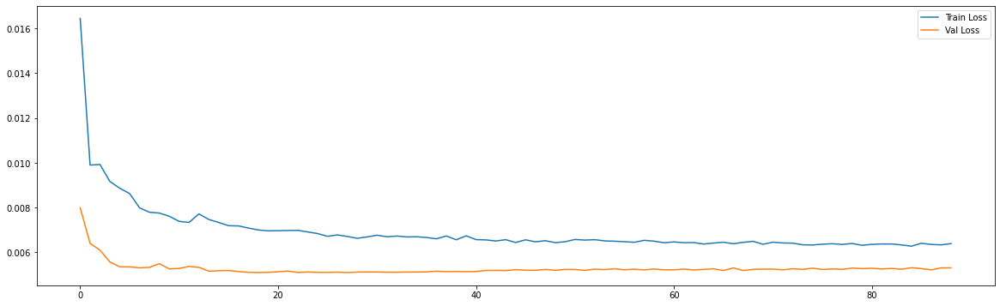

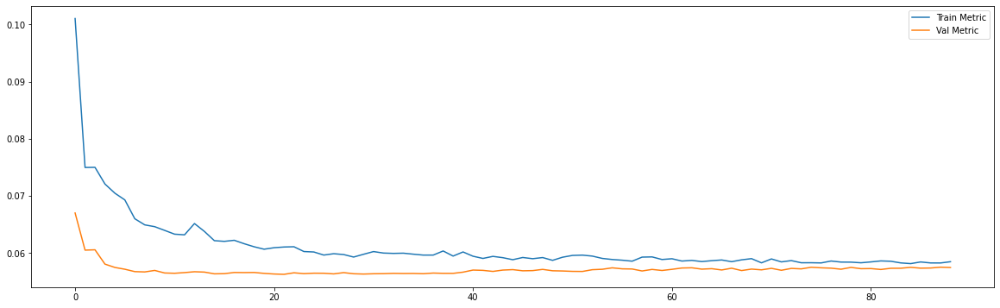

Epoch 00089: early stopping
============================model:44===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0064 - mae: 0.0573
loss and metric train data [0.006359029095619917, 0.05729735270142555]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0569
loss and metric val data [0.005343991331756115, 0.05685809254646301]
10/10 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0616
loss and metric test data [0.006970939692109823, 0.06164019554853439]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




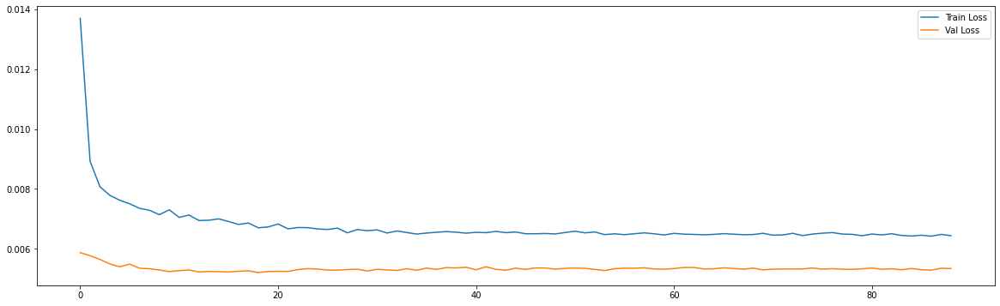

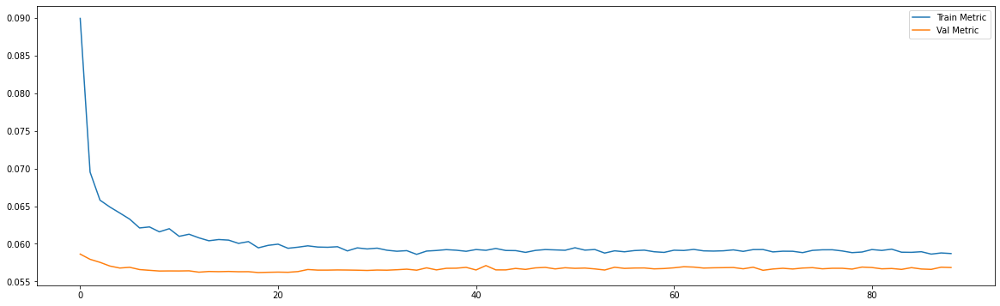

Epoch 00097: early stopping
============================model:45===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0065 - mae: 0.0579
loss and metric train data [0.0064511424861848354, 0.057878103107213974]
10/10 [==============================] - 0s 16ms/step - loss: 0.0053 - mae: 0.0572
loss and metric val data [0.005306650884449482, 0.057173751294612885]
10/10 [==============================] - 0s 16ms/step - loss: 0.0071 - mae: 0.0624
loss and metric test data [0.007149438839405775, 0.062443025410175323]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




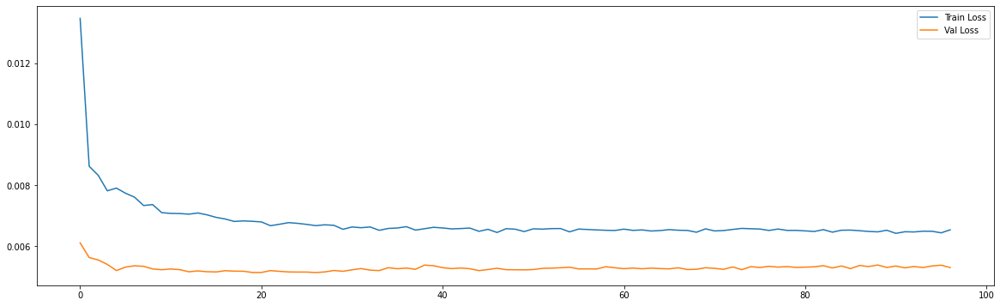

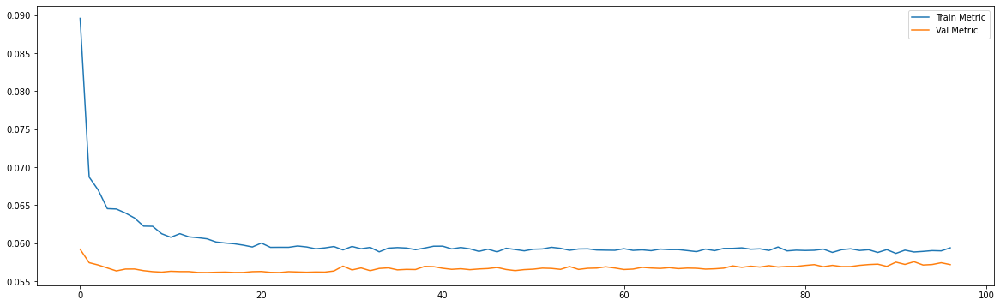

Epoch 00106: early stopping
============================model:46===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0575
loss and metric train data [0.006259433925151825, 0.057478658854961395]
10/10 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0580
loss and metric val data [0.005292900372296572, 0.057978466153144836]
10/10 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0607
loss and metric test data [0.006705950479954481, 0.060665521770715714]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




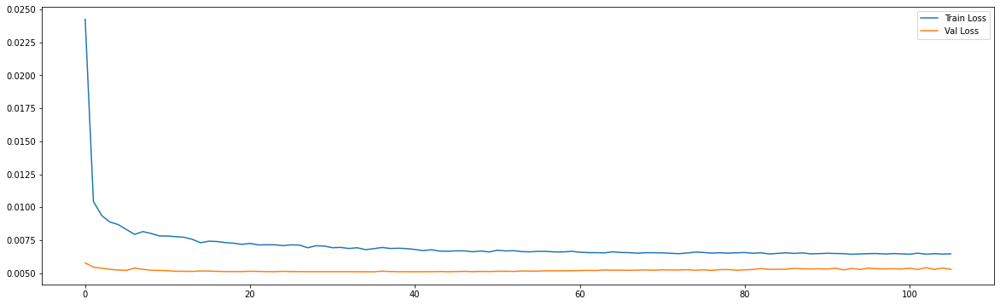

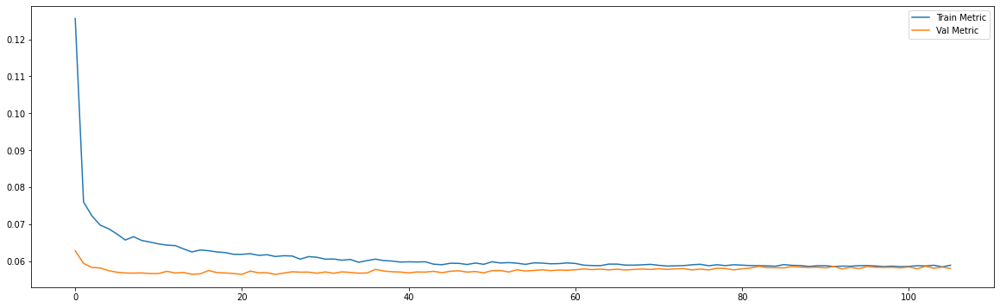

Epoch 00099: early stopping
============================model:47===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0063 - mae: 0.0573
loss and metric train data [0.0062720803543925285, 0.057285748422145844]
10/10 [==============================] - 0s 16ms/step - loss: 0.0052 - mae: 0.0575
loss and metric val data [0.005246270913630724, 0.057514190673828125]
10/10 [==============================] - 0s 16ms/step - loss: 0.0067 - mae: 0.0607
loss and metric test data [0.006731999106705189, 0.060674138367176056]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




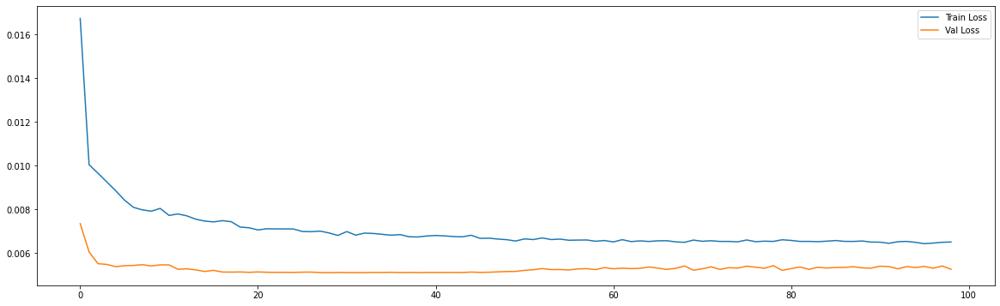

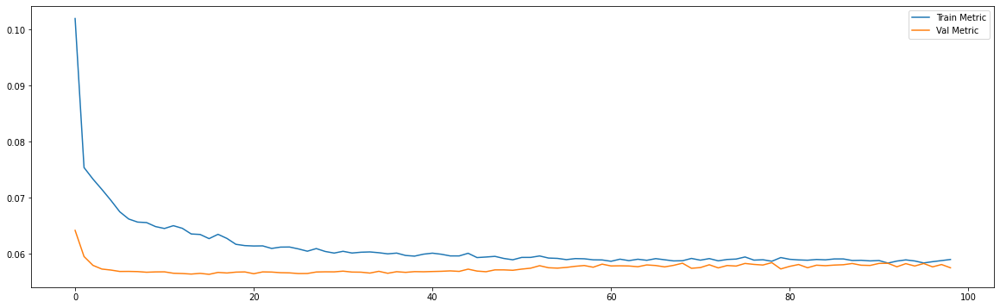

In [9]:
future_steps = 5
n_features = 1

neurons_list = [30,50]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120]
batch_size_list = [32,64]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for batch_size in batch_size_list:
        for lr in lr_list:
          x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch_size, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch_size,lr,1)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=future_steps))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          # early stop
          es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = batch_size, verbose = 0, shuffle = False, callbacks = [es])

          print('============================model:{}==========================='.format(i))

            
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          i+=1


          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch_size, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch_size,lr,2)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False))
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=future_steps))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          # early stop
          es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = batch_size, verbose = 0, shuffle = False, callbacks = [es])

          print('============================model:{}==========================='.format(i))

            
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          i+=1

## Best Model Resume 

Epoch 00194: early stopping

============================model:25===========================

45/45 [==============================] - 0s 6ms/step - loss: 0.0058 - mae: 0.0564

loss and metric train data [0.005778367165476084, 0.05636914446949959]

10/10 [==============================] - 0s 6ms/step - loss: 0.0051 - mae: 0.0560

loss and metric val data [0.005081977695226669, 0.056027911603450775]

10/10 [==============================] - 0s 6ms/step - loss: 0.0074 - mae: 0.0601

loss and metric test data [0.007361133582890034, 0.0600808821618557]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2





In [10]:
models[25]

{'batch_size': 32,
 'dropout': 0.2,
 'learning_rate': 0.001,
 'model': <tensorflow.python.keras.engine.sequential.Sequential at 0x7f1e367ed748>,
 'neurons': 50,
 'resumo': "'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2",
 'time_steps': 30}

Saving the Model

In [11]:
models[25]['model'].save("/content/drive/My Drive/ML Projects/Pharma Sales/LSTM_oneFeature.h5")

Ploting the model prediction

In [12]:
future_steps = 5
n_features = 1
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = 30,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

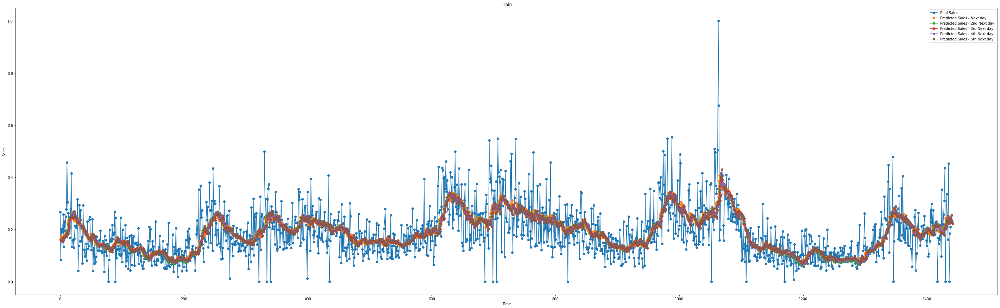

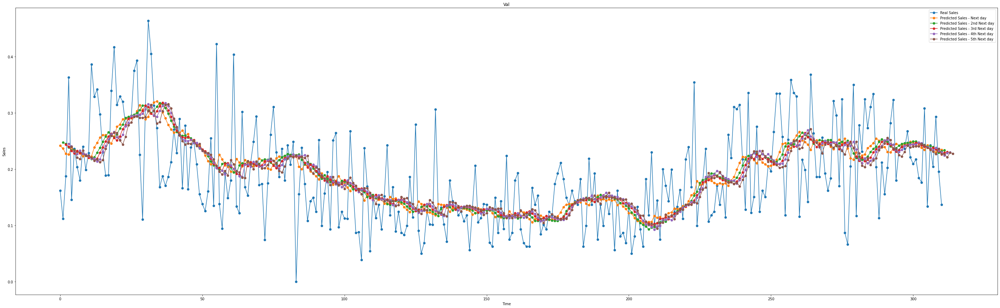

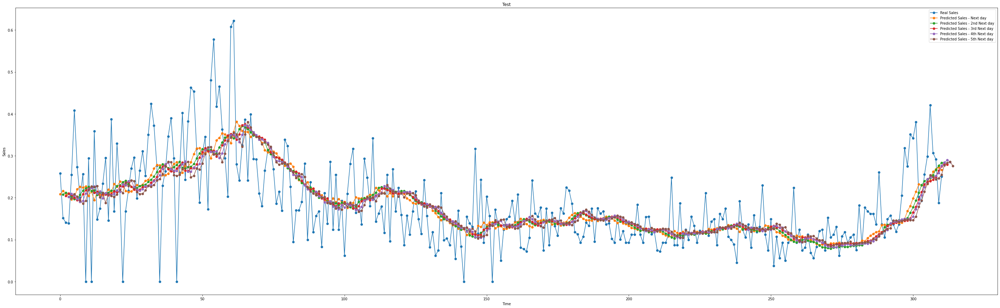

In [13]:
y_train_predict = models[30]['model'].predict(x_train)
y_val_predict = models[30]['model'].predict(x_val)
y_test_predict = models[30]['model'].predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

# Multi-Feature

## Importing

In [5]:
df_daily = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesdaily.csv')
df_daily = df_daily[['datum','Weekday Name','N02BE']]
df_daily.columns = ['data','weekday','N02BE']

## Encoding Categorial Features





Extracting month information from date column

In [6]:
df_daily['data'] = pd.to_datetime(df_daily['data'])
df_daily['month'] = df_daily['data'].dt.month
df_daily = df_daily[['weekday','month','N02BE']]

weekday and month can be converted using the OneHot, OrdinalEnconder and Sin/Cos.

In [7]:
df_daily = pd.concat([pd.get_dummies(df_daily['weekday']),df_daily],axis=1)
dict_ = {'Monday':1,'Tuesday':2,'Wednesday':3,'Thursday':4,'Friday':5,'Saturday':6,'Sunday':7}
df_daily['weekday'].replace(dict_,inplace = True)

In [8]:
df_daily = pd.concat([pd.get_dummies(df_daily['month']),df_daily],axis=1)

In [9]:
df_daily['weekday_sin'] = np.sin(df_daily['weekday']*(2.*np.pi/24))
df_daily['weekday_cos'] = np.cos(df_daily['weekday']*(2.*np.pi/24))
df_daily['month_sin'] = np.sin((df_daily['month']-1)*(2.*np.pi/12))
df_daily['month_cos'] = np.cos((df_daily['month']-1)*(2.*np.pi/12))

In [10]:
df_daily = df_daily[['weekday','Monday','Tuesday','Wednesday','Thursday',
                     'Friday','Saturday','Sunday','month',1,2,3,4,5,6,7,8,9,10,
                     11,12,'weekday_sin','weekday_cos','month_sin','month_cos',
                     'N02BE']]

In [11]:
df_daily

,weekday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,month,1,2,3,4,5,6,7,8,9,10,11,12,weekday_sin,weekday_cos,month_sin,month_cos,N02BE
0,4,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0.866025,5.000000e-01,0.0,1.000000e+00,32.40
1,5,0,0,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0.965926,2.588190e-01,0.0,1.000000e+00,50.60
2,6,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1.000000,6.123234e-17,0.0,1.000000e+00,61.85
3,7,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0.965926,-2.588190e-01,0.0,1.000000e+00,41.10
4,1,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0.258819,9.659258e-01,0.0,1.000000e+00,21.70
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2101,5,0,0,0,0,1,0,0,10,0,0,0,0,0,0,0,0,0,1,0,0,0.965926,2.588190e-01,-1.0,-1.836970e-16,22.45
2102,6,0,0,0,0,0,1,0,10,0,0,0,0,0,0,0,0,0,1,0,0,1.000000,6.123234e-17,-1.0,-1.836970e-16,25.40
2103,7,0,0,0,0,0,0,1,10,0,0,0,0,0,0,0,0,0,1,0,0,0.965926,-2.588190e-01,-1.0,-1.836970e-16,34.60
2104,1,1,0,0,0,0,0,0,10,0,0,0,0,0,0,0,0,0,1,0,0,0.258819,9.659258e-01,-1.0,-1.836970e-16,50.80


## Feature Engineering

Lag Approach

In [12]:
df_daily['lag1'] = df_daily['N02BE'].shift(1)
df_daily['lag2'] = df_daily['N02BE'].shift(2)
df_daily['lag3'] = df_daily['N02BE'].shift(3)
df_daily['lag4'] = df_daily['N02BE'].shift(4)
df_daily['lag5'] = df_daily['N02BE'].shift(5)
df_daily['lag6'] = df_daily['N02BE'].shift(6)
df_daily['lag7'] = df_daily['N02BE'].shift(7)
df_daily['lag30'] = df_daily['N02BE'].shift(30)
df_daily['lag60'] = df_daily['N02BE'].shift(60)
df_daily['lag120'] = df_daily['N02BE'].shift(120)
df_daily['lag240'] = df_daily['N02BE'].shift(240)

Rolling Mean Approach

In [13]:
df_daily['rolling_mean_2'] = df_daily['N02BE'].rolling(window = 2).mean()
df_daily['rolling_mean_3'] = df_daily['N02BE'].rolling(window = 3).mean()
df_daily['rolling_mean_4'] = df_daily['N02BE'].rolling(window = 4).mean()
df_daily['rolling_mean_5'] = df_daily['N02BE'].rolling(window = 5).mean()
df_daily['rolling_mean_6'] = df_daily['N02BE'].rolling(window = 6).mean()
df_daily['rolling_mean_7'] = df_daily['N02BE'].rolling(window = 7).mean()
df_daily['rolling_mean_30'] = df_daily['N02BE'].rolling(window = 30).mean()
df_daily['rolling_mean_60'] = df_daily['N02BE'].rolling(window = 60).mean()
df_daily['rolling_mean_120'] = df_daily['N02BE'].rolling(window = 120).mean()
df_daily['rolling_mean_240'] = df_daily['N02BE'].rolling(window = 240).mean()

In [14]:
df_daily

,weekday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,month,1,2,3,4,5,6,7,8,9,10,11,12,weekday_sin,weekday_cos,month_sin,month_cos,N02BE,lag1,lag2,lag3,lag4,lag5,lag6,lag7,lag30,lag60,lag120,lag240,rolling_mean_2,rolling_mean_3,rolling_mean_4,rolling_mean_5,rolling_mean_6,rolling_mean_7,rolling_mean_30,rolling_mean_60,rolling_mean_120,rolling_mean_240
0,4,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0.866025,5.000000e-01,0.0,1.000000e+00,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5,0,0,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0.965926,2.588190e-01,0.0,1.000000e+00,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,41.500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,6,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1.000000,6.123234e-17,0.0,1.000000e+00,61.85,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56.225,48.283333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,7,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0.965926,-2.588190e-01,0.0,1.000000e+00,41.10,61.85,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51.475,51.183333,46.4875,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0.258819,9.659258e-01,0.0,1.000000e+00,21.70,41.10,61.85,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.400,41.550000,43.8125,41.53,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2101,5,0,0,0,0,1,0,0,10,0,0,0,0,0,0,0,0,0,1,0,0,0.965926,2.588190e-01,-1.0,-1.836970e-16,22.45,40.40,30.20,47.00,49.40,67.8,48.0,41.1,29.23,6.00,27.0,29.00,31.425,31.016667,35.0125,37.89,42.875000,43.607143,34.939167,25.760500,22.726708,24.611371
2102,6,0,0,0,0,0,1,0,10,0,0,0,0,0,0,0,0,0,1,0,0,1.000000,6.123234e-17,-1.0,-1.836970e-16,25.40,22.45,40.40,30.20,47.00,49.4,67.8,48.0,14.00,17.25,22.0,42.60,23.925,29.416667,29.6125,33.09,35.808333,40.378571,35.319167,25.896333,22.755042,24.539704
2103,7,0,0,0,0,0,0,1,10,0,0,0,0,0,0,0,0,0,1,0,0,0.965926,-2.588190e-01,-1.0,-1.836970e-16,34.60,25.40,22.45,40.40,30.20,47.0,49.4,67.8,28.40,9.00,22.4,50.20,30.000,27.483333,30.7125,30.61,33.341667,35.635714,35.525833,26.323000,22.856708,24.474704
2104,1,1,0,0,0,0,0,0,10,0,0,0,0,0,0,0,0,0,1,0,0,0.258819,9.659258e-01,-1.0,-1.836970e-16,50.80,34.60,25.40,22.45,40.40,30.2,47.0,49.4,27.00,15.00,16.5,51.65,42.700,36.933333,33.3125,34.73,33.975000,35.835714,36.319167,26.919667,23.142542,24.471162


In [15]:
df_daily = df_daily[['weekday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday','weekday_sin','weekday_cos','month',1,2,3,4,5,6,7,8,9,10,11,12,'month_sin','month_cos',
          'lag1','lag2','lag3','lag4','lag5','lag6','lag7','lag30','lag60','lag120','lag240',
          'rolling_mean_2','rolling_mean_3','rolling_mean_4','rolling_mean_5','rolling_mean_6','rolling_mean_7','rolling_mean_30','rolling_mean_60','rolling_mean_120','rolling_mean_240',
          'N02BE']]

In [16]:
df_daily

,weekday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,weekday_sin,weekday_cos,month,1,2,3,4,5,6,7,8,9,10,11,12,month_sin,month_cos,lag1,lag2,lag3,lag4,lag5,lag6,lag7,lag30,lag60,lag120,lag240,rolling_mean_2,rolling_mean_3,rolling_mean_4,rolling_mean_5,rolling_mean_6,rolling_mean_7,rolling_mean_30,rolling_mean_60,rolling_mean_120,rolling_mean_240,N02BE
0,4,0,0,0,1,0,0,0,0.866025,5.000000e-01,1,1,0,0,0,0,0,0,0,0,0,0,0,0.0,1.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.40
1,5,0,0,0,0,1,0,0,0.965926,2.588190e-01,1,1,0,0,0,0,0,0,0,0,0,0,0,0.0,1.000000e+00,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,41.500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.60
2,6,0,0,0,0,0,1,0,1.000000,6.123234e-17,1,1,0,0,0,0,0,0,0,0,0,0,0,0.0,1.000000e+00,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56.225,48.283333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,61.85
3,7,0,0,0,0,0,0,1,0.965926,-2.588190e-01,1,1,0,0,0,0,0,0,0,0,0,0,0,0.0,1.000000e+00,61.85,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51.475,51.183333,46.4875,NaN,NaN,NaN,NaN,NaN,NaN,NaN,41.10
4,1,1,0,0,0,0,0,0,0.258819,9.659258e-01,1,1,0,0,0,0,0,0,0,0,0,0,0,0.0,1.000000e+00,41.10,61.85,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.400,41.550000,43.8125,41.53,NaN,NaN,NaN,NaN,NaN,NaN,21.70
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2101,5,0,0,0,0,1,0,0,0.965926,2.588190e-01,10,0,0,0,0,0,0,0,0,0,1,0,0,-1.0,-1.836970e-16,40.40,30.20,47.00,49.40,67.8,48.0,41.1,29.23,6.00,27.0,29.00,31.425,31.016667,35.0125,37.89,42.875000,43.607143,34.939167,25.760500,22.726708,24.611371,22.45
2102,6,0,0,0,0,0,1,0,1.000000,6.123234e-17,10,0,0,0,0,0,0,0,0,0,1,0,0,-1.0,-1.836970e-16,22.45,40.40,30.20,47.00,49.4,67.8,48.0,14.00,17.25,22.0,42.60,23.925,29.416667,29.6125,33.09,35.808333,40.378571,35.319167,25.896333,22.755042,24.539704,25.40
2103,7,0,0,0,0,0,0,1,0.965926,-2.588190e-01,10,0,0,0,0,0,0,0,0,0,1,0,0,-1.0,-1.836970e-16,25.40,22.45,40.40,30.20,47.0,49.4,67.8,28.40,9.00,22.4,50.20,30.000,27.483333,30.7125,30.61,33.341667,35.635714,35.525833,26.323000,22.856708,24.474704,34.60
2104,1,1,0,0,0,0,0,0,0.258819,9.659258e-01,10,0,0,0,0,0,0,0,0,0,1,0,0,-1.0,-1.836970e-16,34.60,25.40,22.45,40.40,30.2,47.0,49.4,27.00,15.00,16.5,51.65,42.700,36.933333,33.3125,34.73,33.975000,35.835714,36.319167,26.919667,23.142542,24.471162,50.80


## Feature Importance

----

Based on the features created above, I'll determine wich are really relevant for the LSTM.

In [17]:
df_daily.corr()

,weekday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,weekday_sin,weekday_cos,month,1,2,3,4,5,6,7,8,9,10,11,12,month_sin,month_cos,lag1,lag2,lag3,lag4,lag5,lag6,lag7,lag30,lag60,lag120,lag240,rolling_mean_2,rolling_mean_3,rolling_mean_4,rolling_mean_5,rolling_mean_6,rolling_mean_7,rolling_mean_30,rolling_mean_60,rolling_mean_120,rolling_mean_240,N02BE
weekday,1.000000,-0.612530,-0.408386,-0.203845,-0.000097,0.204047,0.408192,0.612336,0.927083,-0.990568,0.000607,-0.000912,-0.002691,0.004945,-0.000922,-0.001747,0.002475,-0.002583,0.001599,0.000776,-0.004510,0.001780,0.001751,0.000959,0.000444,-0.004027,-0.121533,-0.079472,-0.023994,0.034387,0.085315,0.108987,-0.120500,-0.025819,0.000145,-0.130833,0.060833,-0.007872,-0.033305,-0.035007,-0.021126,-0.000753,0.005213,-0.002975,0.001867,0.000892,0.107282
Monday,-0.612530,1.000000,-0.166759,-0.166436,-0.166759,-0.166759,-0.166759,-0.166759,-0.773120,0.514439,0.000152,-0.002114,0.004223,-0.002792,0.001327,-0.002792,0.001327,0.001989,-0.002792,0.001327,0.003570,-0.002314,-0.000797,-0.000714,-0.000658,0.091261,0.096462,-0.034244,-0.045414,-0.047875,-0.041311,-0.019317,0.098008,-0.044434,0.091111,0.106862,0.043208,0.072168,0.045620,0.025402,0.009389,-0.000210,0.003949,0.004066,-0.000537,0.000605,-0.017933
Tuesday,-0.408386,-0.166759,1.000000,-0.166436,-0.166759,-0.166759,-0.166759,-0.166759,-0.395035,0.417819,-0.000649,0.002679,-0.000771,-0.002792,0.001327,0.001989,-0.003525,0.001989,-0.002792,0.001327,0.003570,-0.002314,-0.000797,-0.000973,0.000297,-0.017758,0.091563,0.096527,-0.034303,-0.045511,-0.047751,-0.041308,0.089280,-0.034332,-0.021609,0.092743,-0.034265,0.014274,0.043708,0.026889,0.012376,0.000580,-0.002685,0.003792,-0.001071,-0.001265,-0.040435
Wednesday,-0.203845,-0.166436,-0.166436,1.000000,-0.166436,-0.166436,-0.166436,-0.166436,-0.070229,0.263606,0.001494,-0.001696,-0.000370,-0.002373,0.001744,0.002414,-0.003115,0.002414,0.002414,-0.003115,-0.001115,0.003341,-0.000415,0.000045,-0.001407,-0.041577,-0.019353,0.091345,0.097003,-0.033796,-0.046366,-0.047842,-0.020296,0.099296,-0.040937,-0.021522,-0.052858,-0.046168,-0.005617,0.022364,0.011275,0.000396,-0.004902,-0.000372,-0.000154,0.000242,-0.048179
Thursday,-0.000097,-0.166759,-0.166759,-0.166436,1.000000,-0.166759,-0.166759,-0.166759,0.178762,0.063812,-0.001451,0.002679,-0.000771,0.001989,-0.003525,0.001989,0.001327,-0.002792,0.001989,-0.003525,-0.001507,0.002961,-0.000797,0.000699,0.001763,-0.048012,-0.041336,-0.019296,0.091294,0.096919,-0.033670,-0.046364,-0.042313,0.091576,-0.049885,-0.042496,-0.055423,-0.057340,-0.051367,-0.017030,0.008454,0.000539,-0.004928,-0.004507,-0.000591,0.000189,-0.045818
Friday,0.204047,-0.166759,-0.166759,-0.166436,-0.166759,1.000000,-0.166759,-0.166759,0.335370,-0.169450,-0.002252,0.002679,-0.000771,0.001989,-0.003525,0.001989,0.001327,-0.002792,0.001989,0.001327,-0.001507,-0.002314,-0.000797,0.000699,-0.000147,-0.045650,-0.047775,-0.041280,-0.019353,0.091210,0.097064,-0.033668,-0.046822,-0.021601,-0.045551,-0.049313,-0.047325,-0.055142,-0.056979,-0.052214,-0.022864,0.000037,-0.004345,-0.005044,-0.000577,-0.001912,-0.034716
Saturday,0.408192,-0.166759,-0.166759,-0.166436,-0.166759,-0.166759,1.000000,-0.166759,0.388786,-0.419770,0.001755,-0.002114,-0.000771,0.001989,0.001327,-0.002792,0.001327,-0.002792,0.001989,0.001327,-0.001507,-0.002314,0.004399,-0.000008,0.000552,-0.034545,-0.045411,-0.047719,-0.041339,-0.019448,0.091354,0.097072,-0.044392,-0.042147,-0.035408,-0.045398,0.036204,0.006944,-0.011839,-0.020971,-0.022269,-0.000613,0.002967,-0.001301,0.001447,-0.000113,0.095955
Sunday,0.612336,-0.166759,-0.166759,-0.166436,-0.166759,-0.166759,-0.166759,1.000000,0.335370,-0.670090,0.000953,-0.002114,-0.000771,0.001989,0.001327,-0.002792,0.001327,0.001989,-0.002792,0.001327,-0.001507,0.002961,-0.000797,0.000251,-0.000402,0.096157,-0.034301,-0.045355,-0.047778,-0.041435,-0.019320,0.091362,-0.033619,-0.048245,0.102144,-0.041053,0.110308,0.065044,0.036300,0.015488,0.003621,-0.000729,0.0099

## LSTM 

Whith Month and Weekday as additional features

In [27]:
df_train,df_val,df_test = dataSplit(df = df_daily[['weekday','month','N02BE']],train_percent = 0.7,val_percent = 0.15)
df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange = (0,1))

(1474, 3)
(316, 3)
(316, 3)
[1. 1. 1.]
[0. 0. 0.]


[1.         0.90909091 0.46335404]
[0. 0. 0.]


[1.         1.         0.62173913]
[0. 0. 0.]
-------------------------
(1474, 3)
(316, 3)
(316, 3)


Epoch 00283: early stopping
============================model:0===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0572
loss and metric train data [0.00617524329572916, 0.05718985199928284]
10/10 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0552
loss and metric val data [0.004968336317688227, 0.055220022797584534]
10/10 [==============================] - 0s 4ms/step - loss: 0.0061 - mae: 0.0576
loss and metric test data [0.006128717679530382, 0.057643793523311615]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




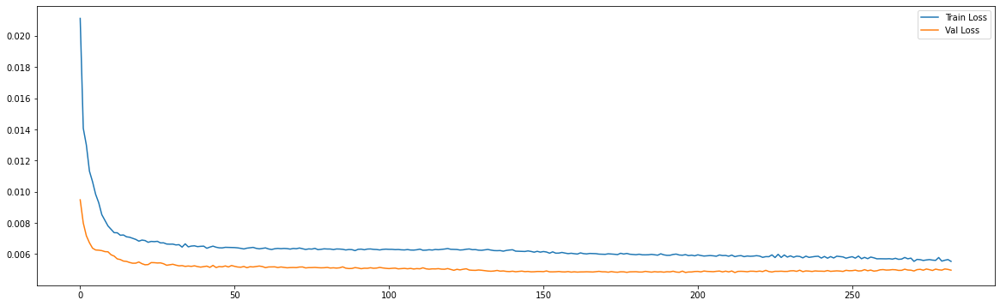

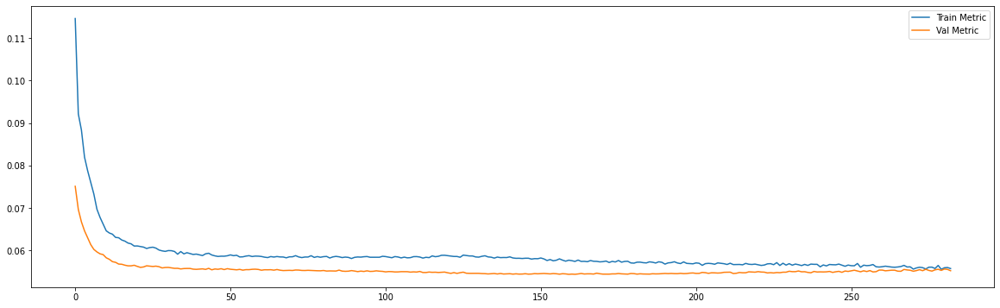

Epoch 00232: early stopping
============================model:1===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0053 - mae: 0.0539
loss and metric train data [0.00529505405575037, 0.053858429193496704]
10/10 [==============================] - 0s 5ms/step - loss: 0.0050 - mae: 0.0553
loss and metric val data [0.005024801008403301, 0.055267684161663055]
10/10 [==============================] - 0s 6ms/step - loss: 0.0059 - mae: 0.0564
loss and metric test data [0.0058587477542459965, 0.05635174363851547]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




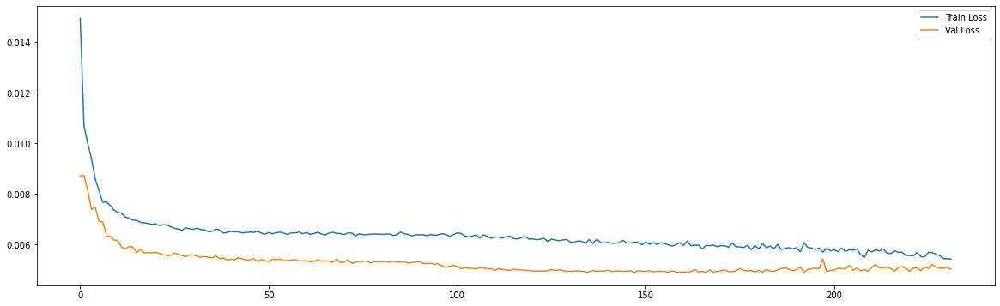

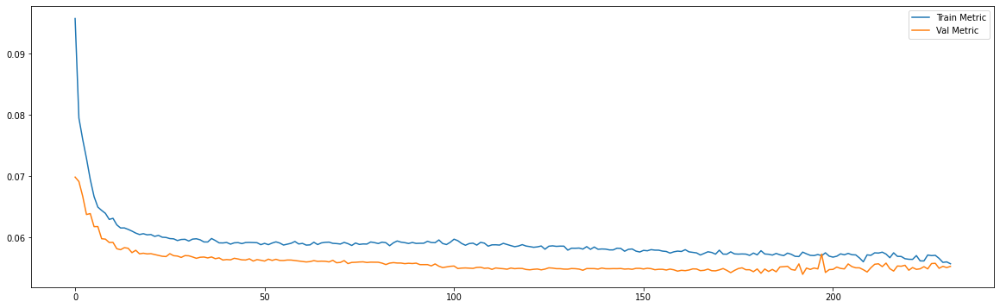

Epoch 00312: early stopping
============================model:2===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0057 - mae: 0.0560
loss and metric train data [0.0056607224978506565, 0.05604223906993866]
10/10 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0561
loss and metric val data [0.004943801090121269, 0.05606940761208534]
10/10 [==============================] - 0s 4ms/step - loss: 0.0059 - mae: 0.0580
loss and metric test data [0.00593475392088294, 0.05796108767390251]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




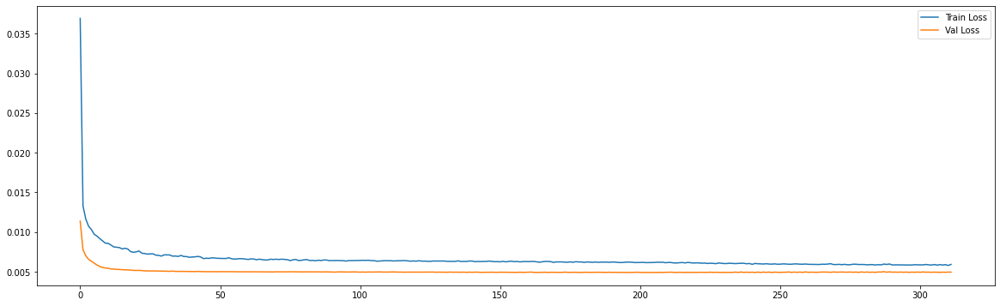

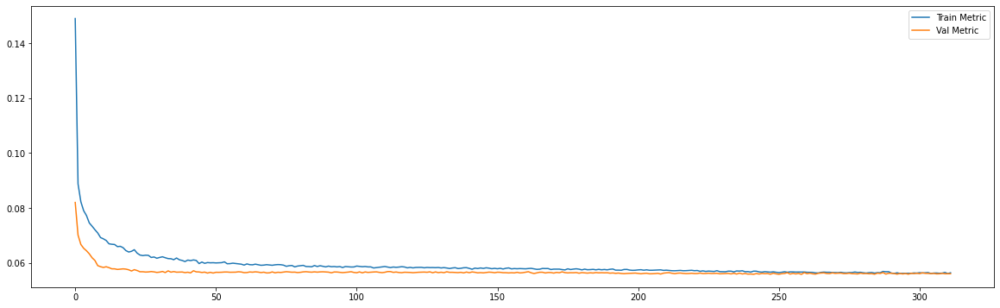

Epoch 00215: early stopping
============================model:3===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0057 - mae: 0.0560
loss and metric train data [0.005749434232711792, 0.05597453564405441]
10/10 [==============================] - 0s 5ms/step - loss: 0.0050 - mae: 0.0558
loss and metric val data [0.0049577257595956326, 0.055778417736291885]
10/10 [==============================] - 0s 6ms/step - loss: 0.0060 - mae: 0.0582
loss and metric test data [0.006010859739035368, 0.05818668007850647]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




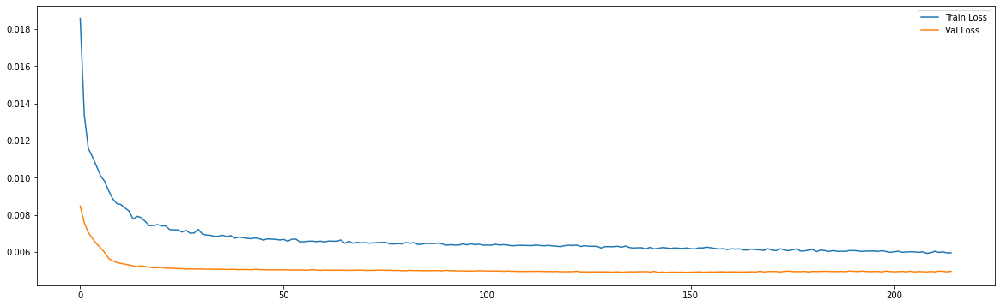

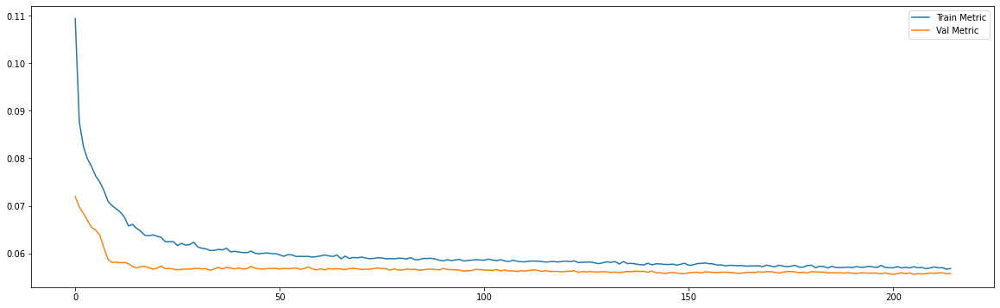

Epoch 00333: early stopping
============================model:4===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0051 - mae: 0.0537
loss and metric train data [0.005091213155537844, 0.05372212082147598]
10/10 [==============================] - 0s 7ms/step - loss: 0.0048 - mae: 0.0543
loss and metric val data [0.0047689806669950485, 0.05432571843266487]
10/10 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0593
loss and metric test data [0.006249123252928257, 0.059268780052661896]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




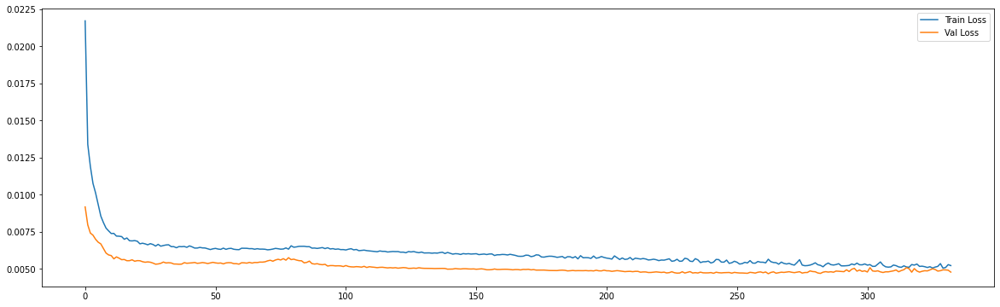

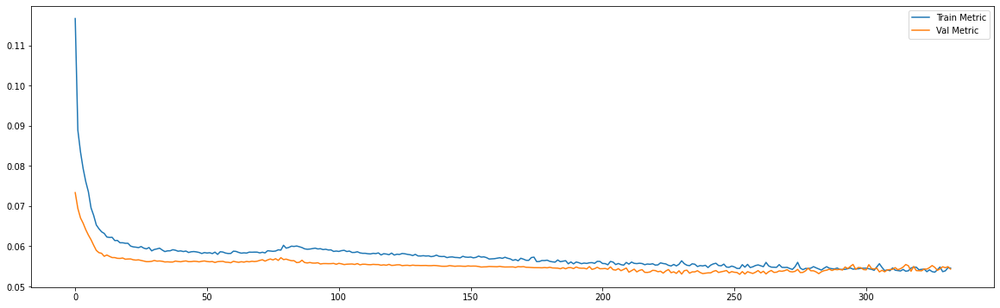

Epoch 00263: early stopping
============================model:5===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0524
loss and metric train data [0.004883037880063057, 0.05240180715918541]
10/10 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0547
loss and metric val data [0.00484743295237422, 0.05467298999428749]
10/10 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0577
loss and metric test data [0.005879005417227745, 0.05766460672020912]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




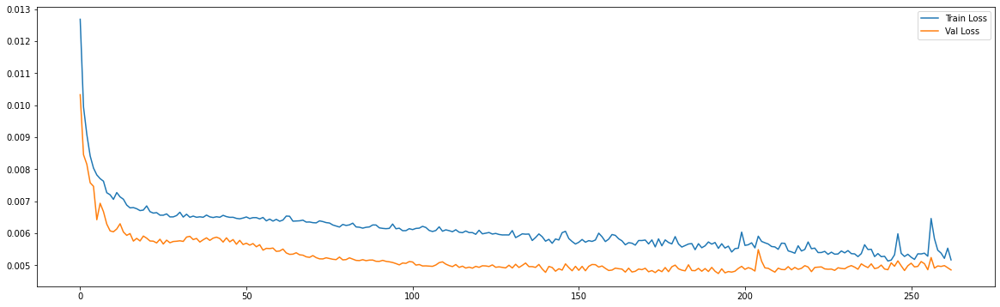

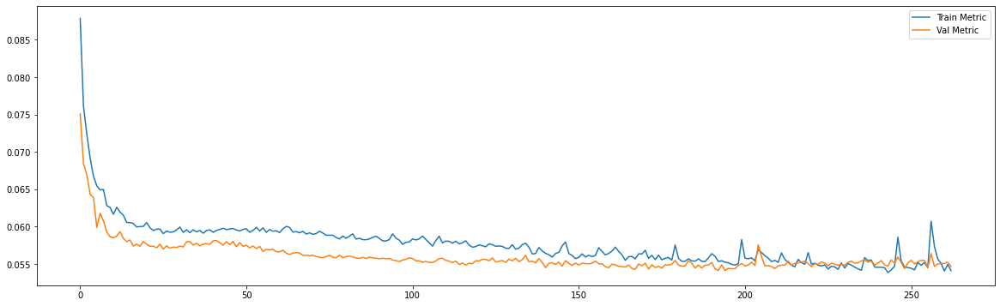

Epoch 00158: early stopping
============================model:6===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0059 - mae: 0.0559
loss and metric train data [0.0059118554927408695, 0.05592529848217964]
10/10 [==============================] - 0s 5ms/step - loss: 0.0050 - mae: 0.0560
loss and metric val data [0.004981235135346651, 0.05603598430752754]
10/10 [==============================] - 0s 5ms/step - loss: 0.0064 - mae: 0.0588
loss and metric test data [0.006369882728904486, 0.05882328376173973]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




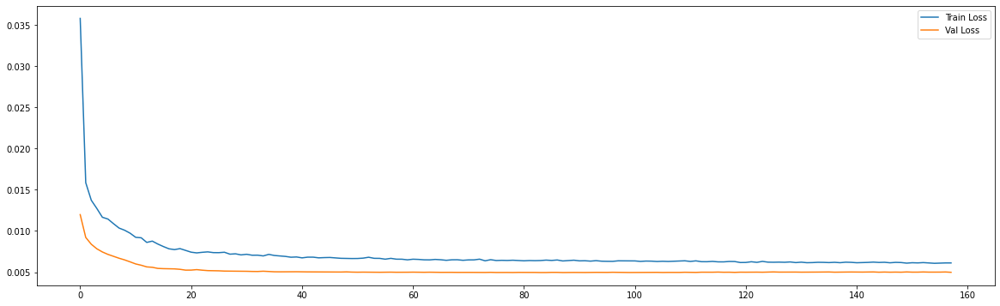

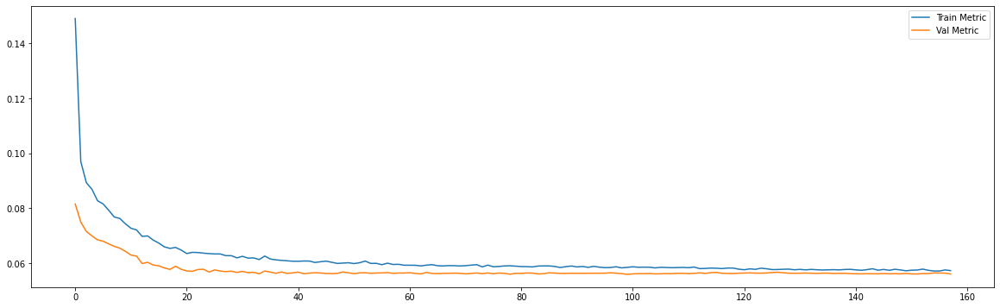

Epoch 00315: early stopping
============================model:7===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0530
loss and metric train data [0.005029522813856602, 0.052958108484745026]
10/10 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0556
loss and metric val data [0.0049043395556509495, 0.05560578033328056]
10/10 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0577
loss and metric test data [0.006057952530682087, 0.05765799060463905]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




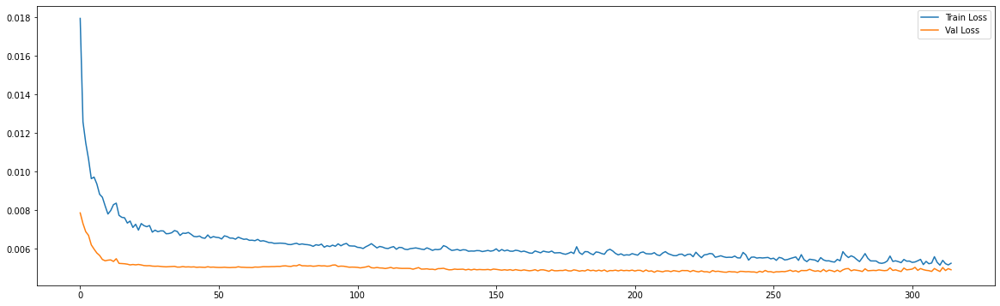

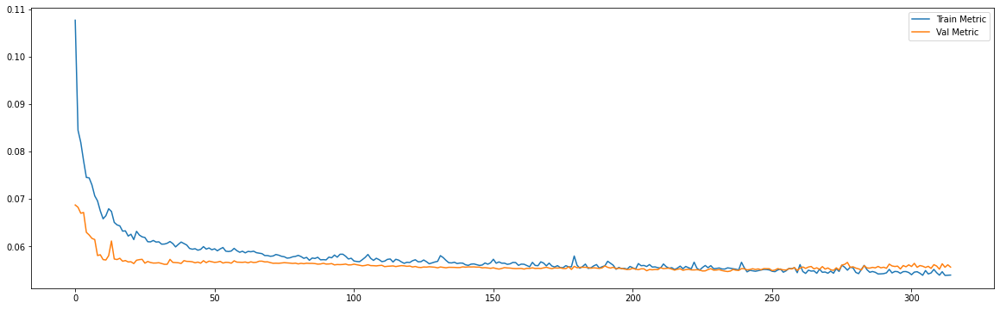

Epoch 00223: early stopping
============================model:8===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0550
loss and metric train data [0.005521230865269899, 0.05499657988548279]
10/10 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0570
loss and metric val data [0.005234996788203716, 0.05700407177209854]
10/10 [==============================] - 0s 8ms/step - loss: 0.0074 - mae: 0.0618
loss and metric test data [0.007358564995229244, 0.0618010088801384]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




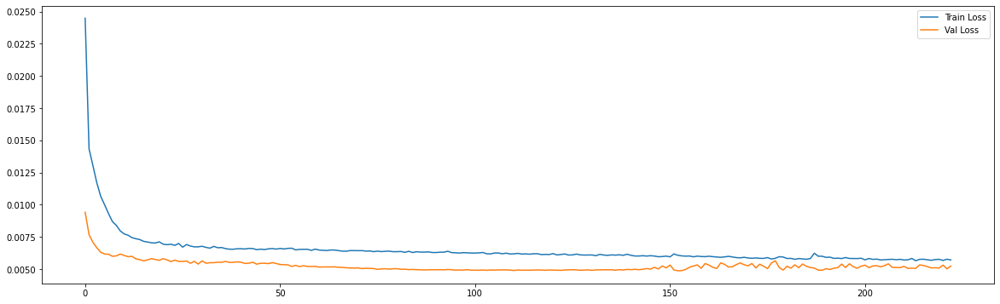

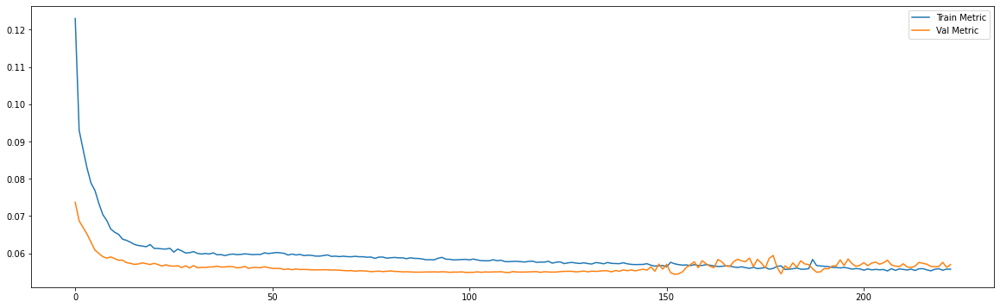

Epoch 00237: early stopping
============================model:9===========================
43/43 [==============================] - 1s 16ms/step - loss: 0.0050 - mae: 0.0534
loss and metric train data [0.005017927382141352, 0.0533963181078434]
10/10 [==============================] - 0s 15ms/step - loss: 0.0049 - mae: 0.0562
loss and metric val data [0.0048715886659920216, 0.05623789131641388]
10/10 [==============================] - 0s 15ms/step - loss: 0.0062 - mae: 0.0594
loss and metric test data [0.006207020487636328, 0.059355683624744415]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




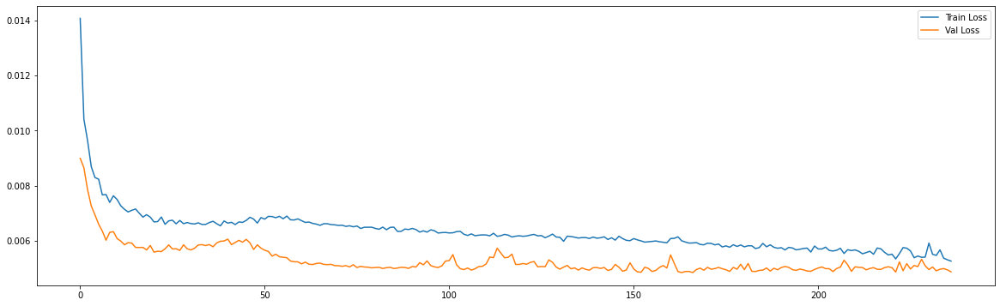

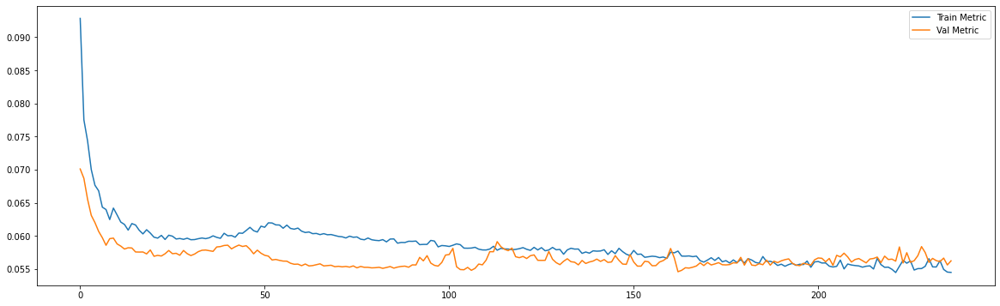

Epoch 00165: early stopping
============================model:10===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0059 - mae: 0.0560
loss and metric train data [0.005896229762583971, 0.056010182946920395]
10/10 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0565
loss and metric val data [0.005074325017631054, 0.05654679611325264]
10/10 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0602
loss and metric test data [0.006602961104363203, 0.060195740312337875]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




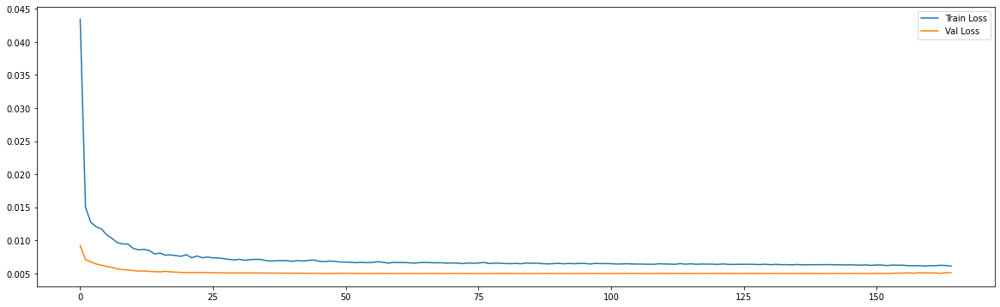

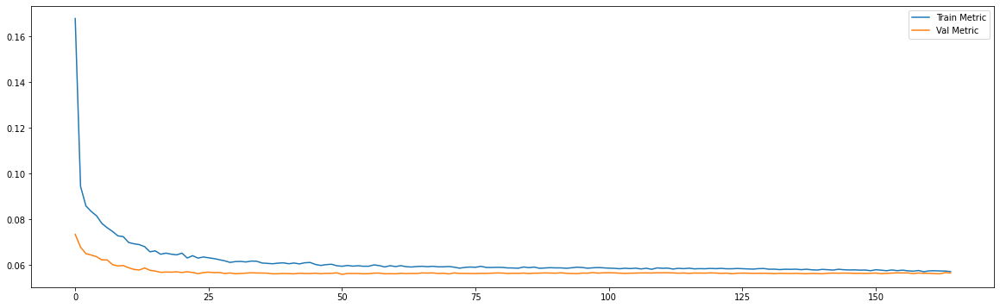

Epoch 00186: early stopping
============================model:11===========================
43/43 [==============================] - 1s 16ms/step - loss: 0.0058 - mae: 0.0554
loss and metric train data [0.0057679940946400166, 0.055389173328876495]
10/10 [==============================] - 0s 15ms/step - loss: 0.0051 - mae: 0.0564
loss and metric val data [0.0050805965438485146, 0.056381773203611374]
10/10 [==============================] - 0s 15ms/step - loss: 0.0066 - mae: 0.0608
loss and metric test data [0.006600124761462212, 0.06075989827513695]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




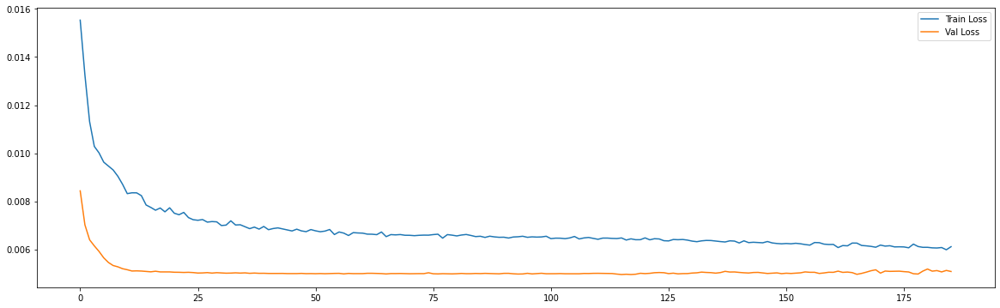

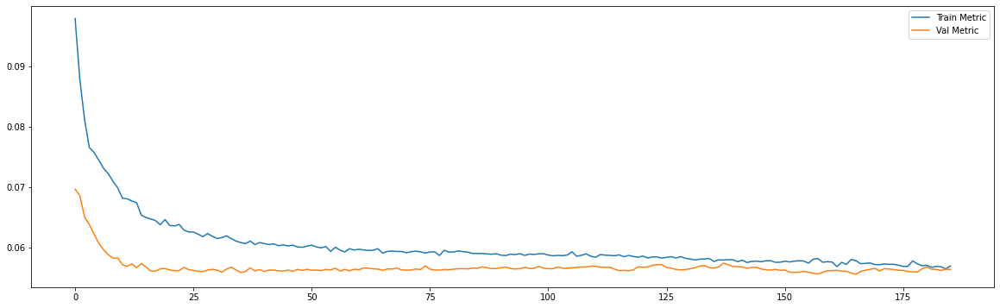

Epoch 00307: early stopping
============================model:12===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0057 - mae: 0.0561
loss and metric train data [0.005651519633829594, 0.05609872192144394]
10/10 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0556
loss and metric val data [0.005025713704526424, 0.05555744096636772]
10/10 [==============================] - 0s 4ms/step - loss: 0.0061 - mae: 0.0570
loss and metric test data [0.0060851904563605785, 0.05703325197100639]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




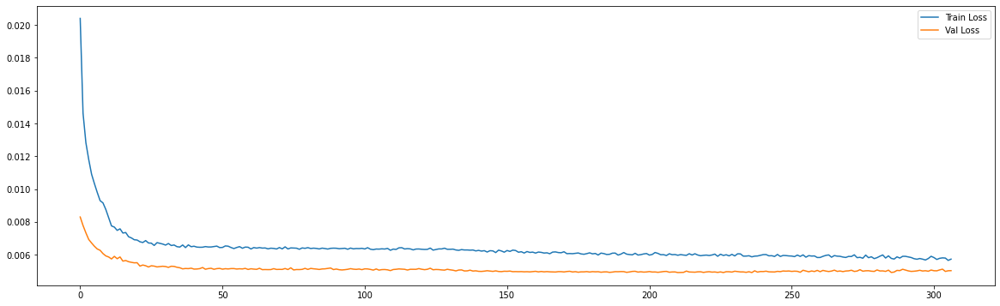

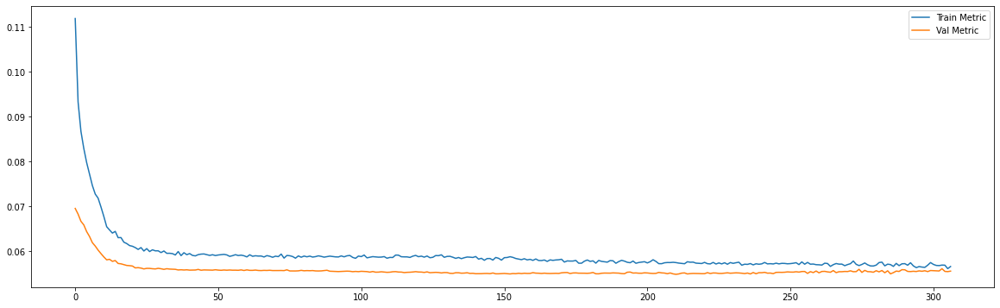

Epoch 00224: early stopping
============================model:13===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0055 - mae: 0.0555
loss and metric train data [0.005525573622435331, 0.05550175532698631]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0563
loss and metric val data [0.005193945486098528, 0.05629806965589523]
10/10 [==============================] - 0s 6ms/step - loss: 0.0058 - mae: 0.0562
loss and metric test data [0.005816144868731499, 0.05618692561984062]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




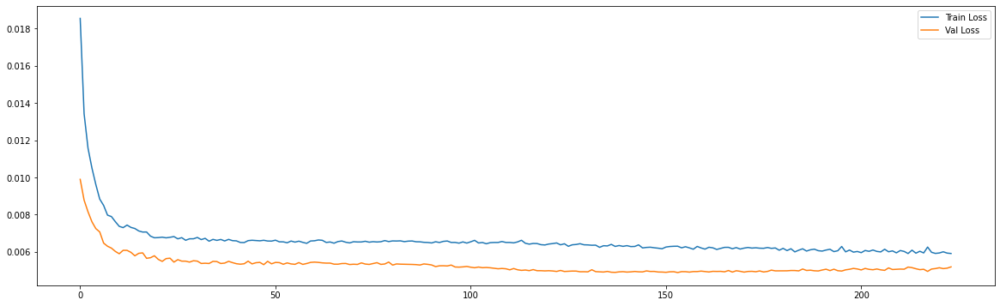

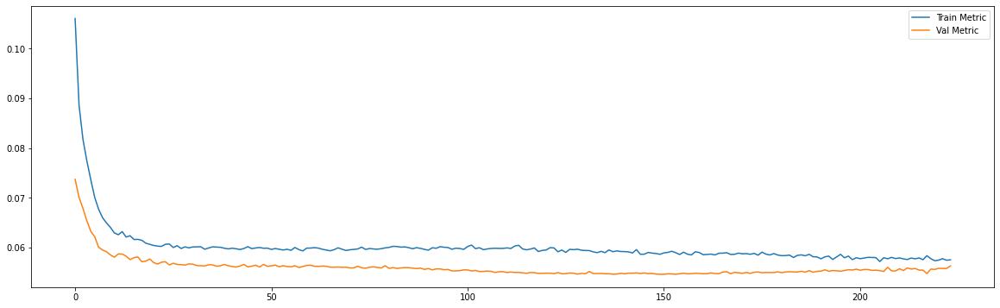

Epoch 00279: early stopping
============================model:14===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0567
loss and metric train data [0.005834526382386684, 0.05671657994389534]
10/10 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0569
loss and metric val data [0.0050053671002388, 0.05689460411667824]
10/10 [==============================] - 0s 4ms/step - loss: 0.0061 - mae: 0.0595
loss and metric test data [0.006126179825514555, 0.059452205896377563]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




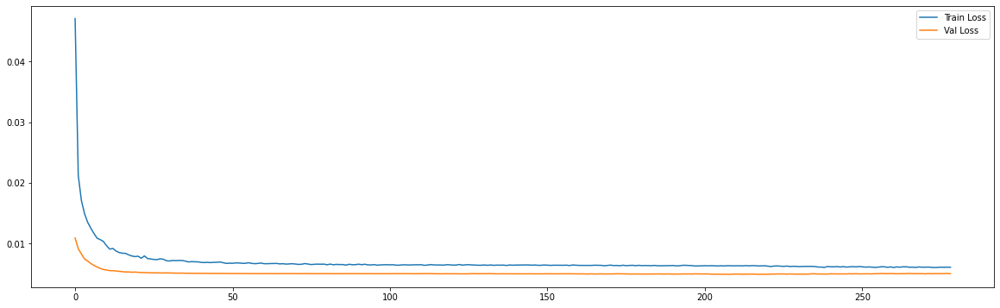

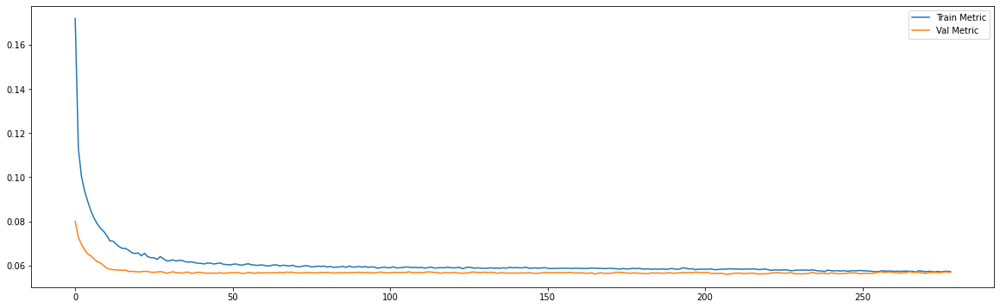

Epoch 00258: early stopping
============================model:15===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0058 - mae: 0.0559
loss and metric train data [0.005757006350904703, 0.055884864181280136]
10/10 [==============================] - 0s 5ms/step - loss: 0.0050 - mae: 0.0559
loss and metric val data [0.0049732886254787445, 0.05586019530892372]
10/10 [==============================] - 0s 6ms/step - loss: 0.0060 - mae: 0.0585
loss and metric test data [0.0060437461361289024, 0.058496467769145966]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




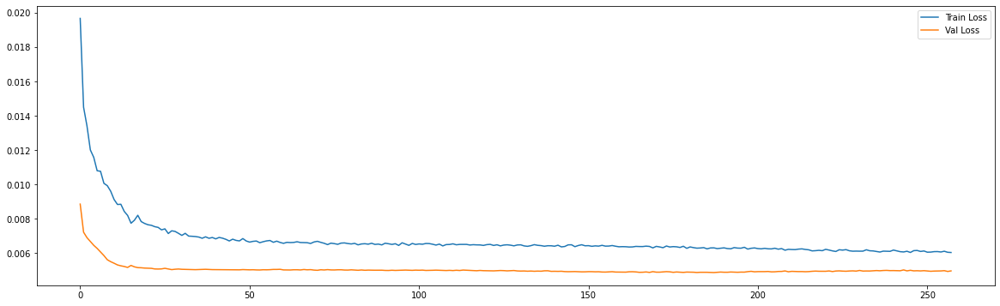

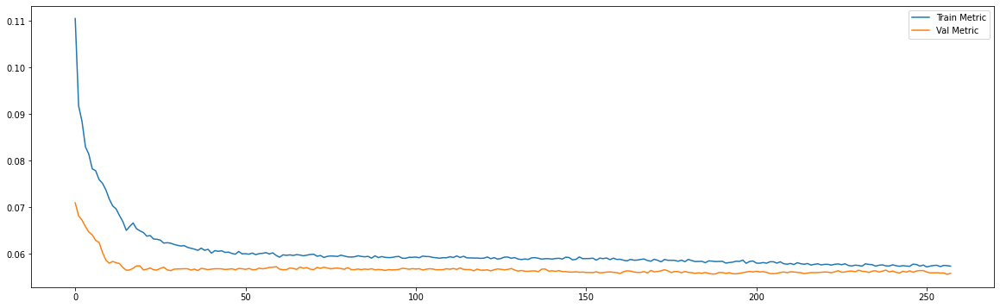

Epoch 00110: early stopping
============================model:16===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0063 - mae: 0.0567
loss and metric train data [0.006304366514086723, 0.056693609803915024]
10/10 [==============================] - 0s 5ms/step - loss: 0.0054 - mae: 0.0565
loss and metric val data [0.005416791420429945, 0.0564812608063221]
10/10 [==============================] - 0s 5ms/step - loss: 0.0068 - mae: 0.0584
loss and metric test data [0.006771010812371969, 0.05838823318481445]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




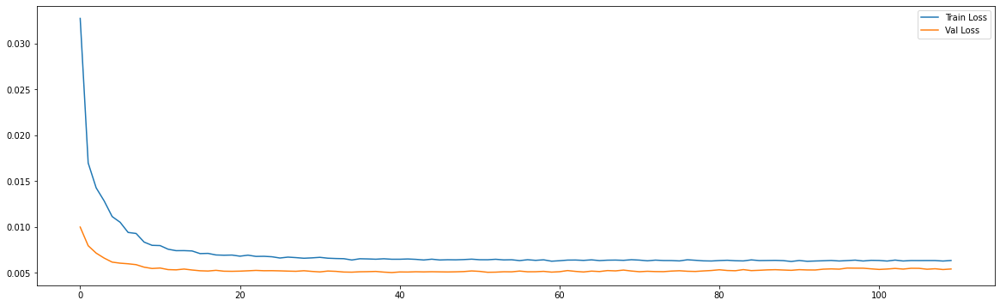

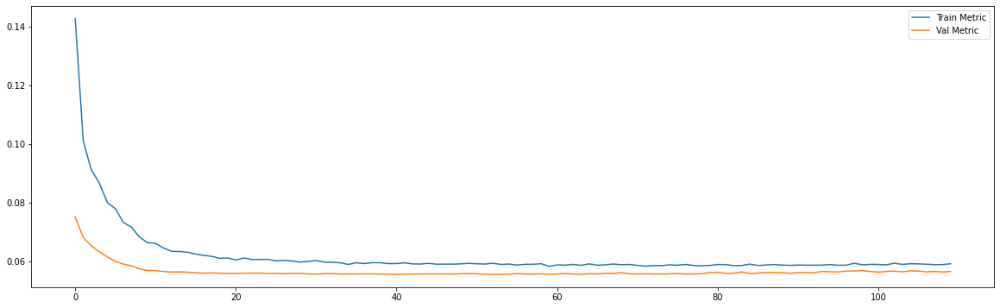

Epoch 00260: early stopping
============================model:17===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0532
loss and metric train data [0.005122676957398653, 0.05316095054149628]
10/10 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0555
loss and metric val data [0.004925112705677748, 0.0555078387260437]
10/10 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0586
loss and metric test data [0.006261917762458324, 0.058643873780965805]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




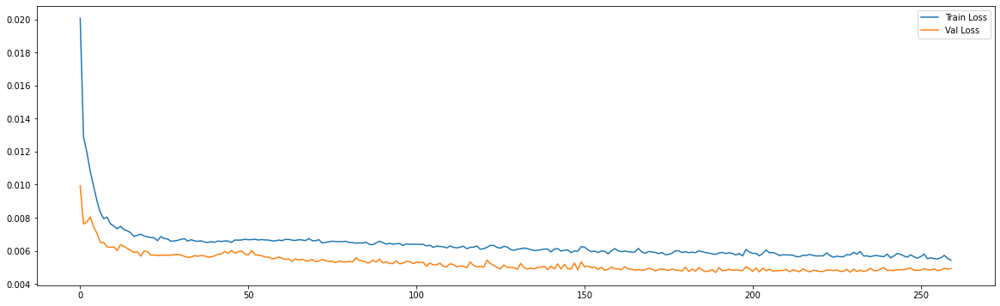

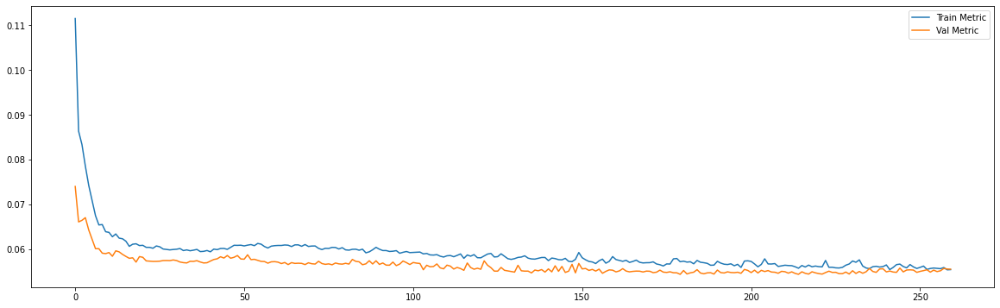

Epoch 00233: early stopping
============================model:18===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0056 - mae: 0.0548
loss and metric train data [0.005636728368699551, 0.05483075976371765]
10/10 [==============================] - 0s 5ms/step - loss: 0.0050 - mae: 0.0560
loss and metric val data [0.005006745923310518, 0.05602838471531868]
10/10 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0581
loss and metric test data [0.006169872358441353, 0.05810394138097763]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




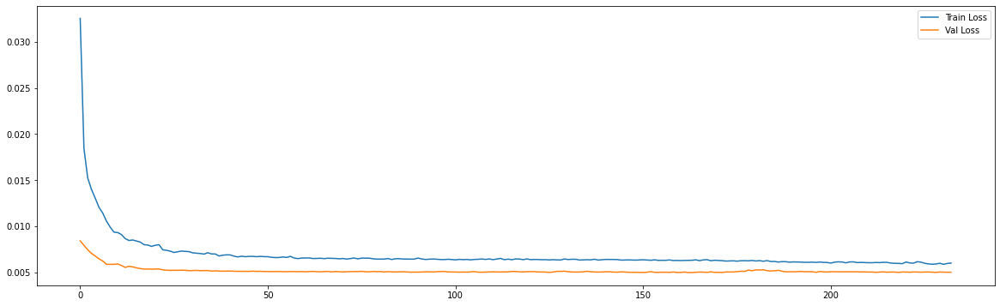

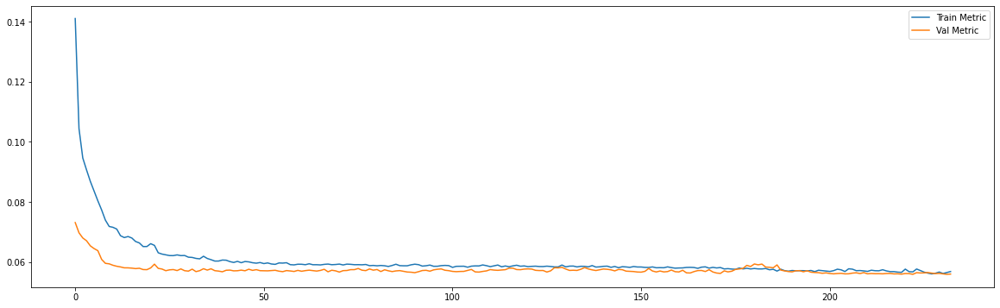

Epoch 00161: early stopping
============================model:19===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0560
loss and metric train data [0.005896484944969416, 0.056022368371486664]
10/10 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0565
loss and metric val data [0.005079003516584635, 0.05654798075556755]
10/10 [==============================] - 0s 9ms/step - loss: 0.0064 - mae: 0.0588
loss and metric test data [0.006436353549361229, 0.05880182236433029]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




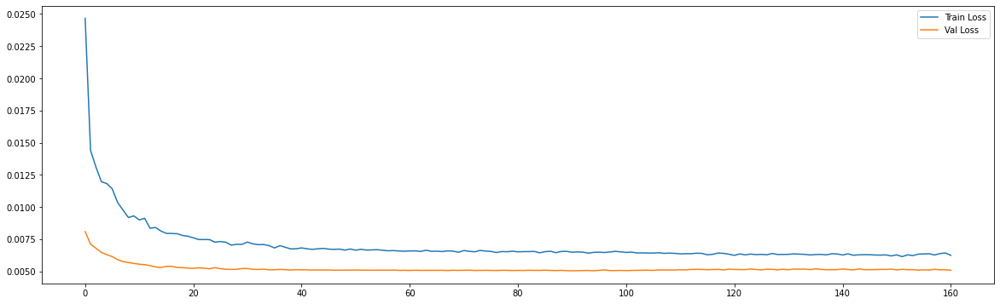

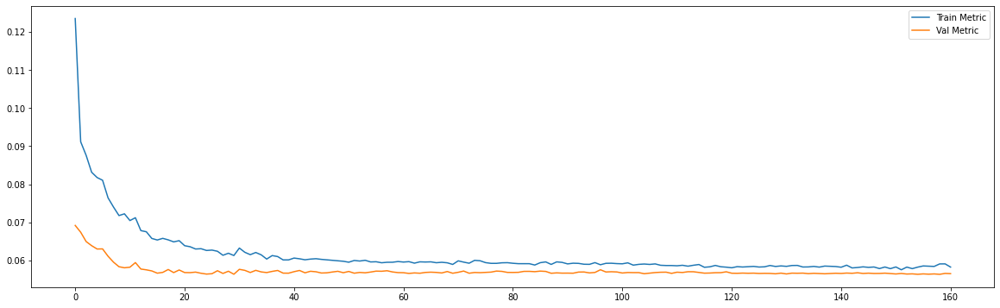

Epoch 00124: early stopping
============================model:20===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0560
loss and metric train data [0.006124122533947229, 0.055989254266023636]
10/10 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0558
loss and metric val data [0.005188854411244392, 0.05580396205186844]
10/10 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0576
loss and metric test data [0.006389578338712454, 0.05756933242082596]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




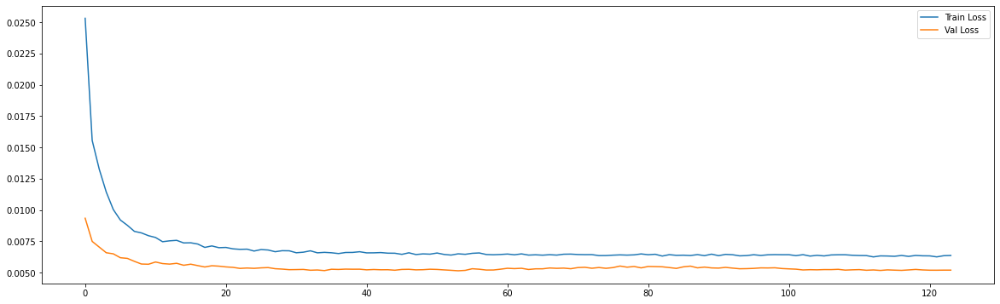

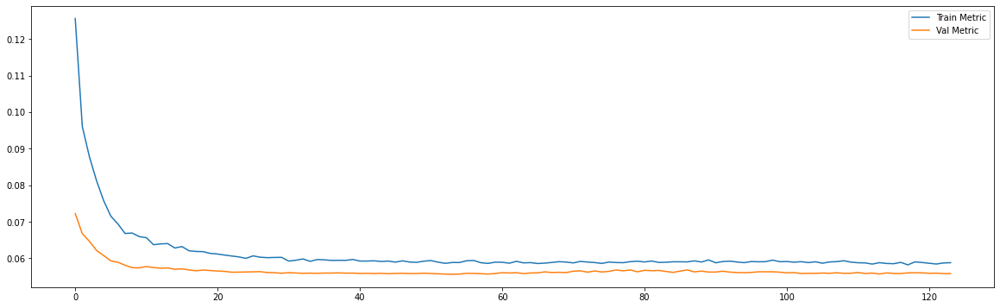

Epoch 00300: early stopping
============================model:21===========================
43/43 [==============================] - 1s 17ms/step - loss: 0.0051 - mae: 0.0529
loss and metric train data [0.005108305718749762, 0.052893687039613724]
10/10 [==============================] - 0s 16ms/step - loss: 0.0053 - mae: 0.0587
loss and metric val data [0.005346916150301695, 0.05867091938853264]
10/10 [==============================] - 0s 15ms/step - loss: 0.0066 - mae: 0.0605
loss and metric test data [0.006637039594352245, 0.060478392988443375]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




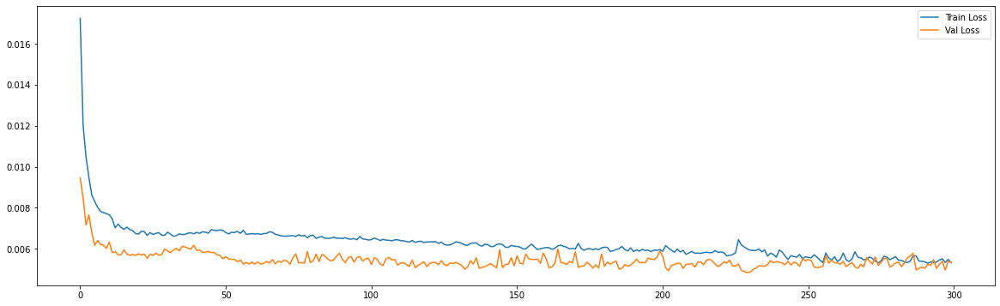

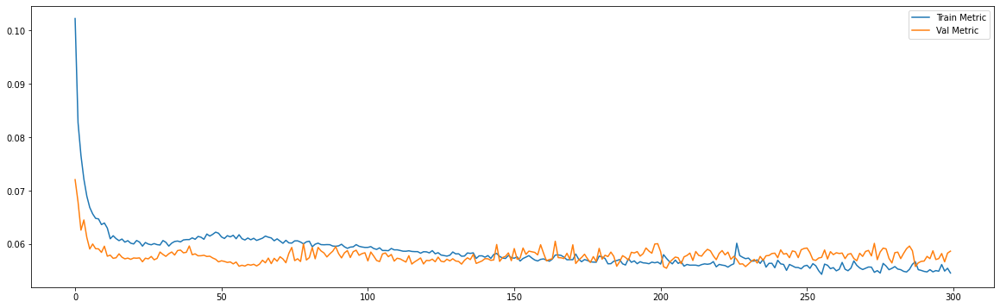

Epoch 00192: early stopping
============================model:22===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0062 - mae: 0.0586
loss and metric train data [0.00619823532178998, 0.058579396456480026]
10/10 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0584
loss and metric val data [0.005207332782447338, 0.0583534836769104]
10/10 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0616
loss and metric test data [0.006615149788558483, 0.06156442314386368]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




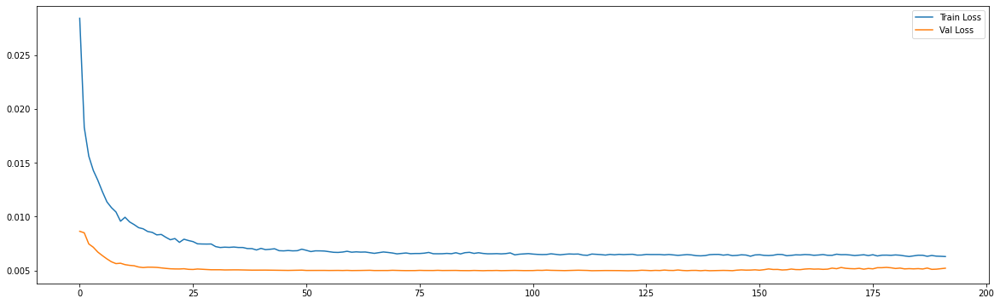

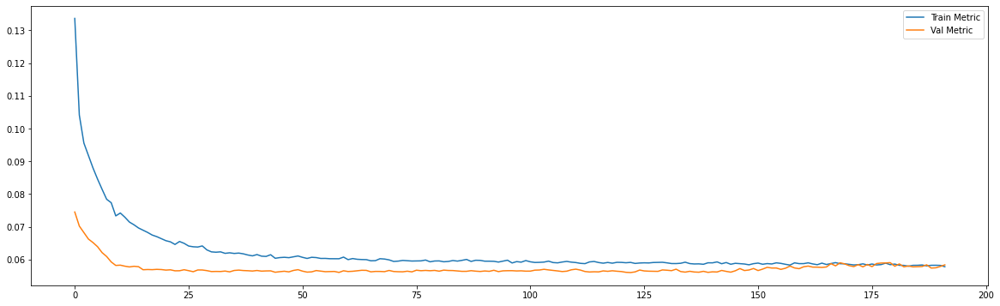

Epoch 00145: early stopping
============================model:23===========================
43/43 [==============================] - 1s 16ms/step - loss: 0.0061 - mae: 0.0568
loss and metric train data [0.006064603570848703, 0.05677049607038498]
10/10 [==============================] - 0s 15ms/step - loss: 0.0051 - mae: 0.0567
loss and metric val data [0.005060340743511915, 0.05670161545276642]
10/10 [==============================] - 0s 15ms/step - loss: 0.0066 - mae: 0.0603
loss and metric test data [0.0065561323426663876, 0.060266464948654175]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




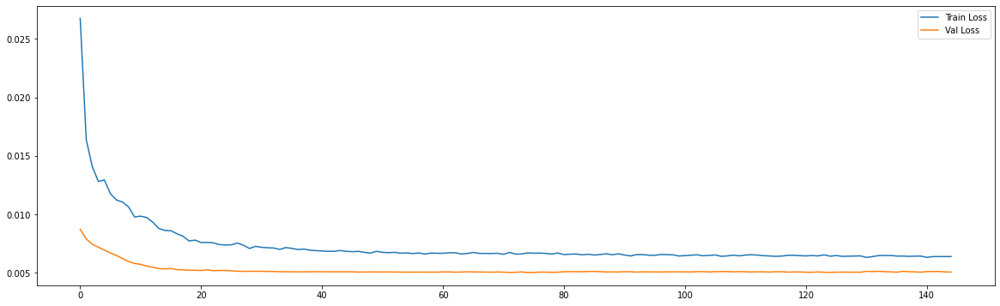

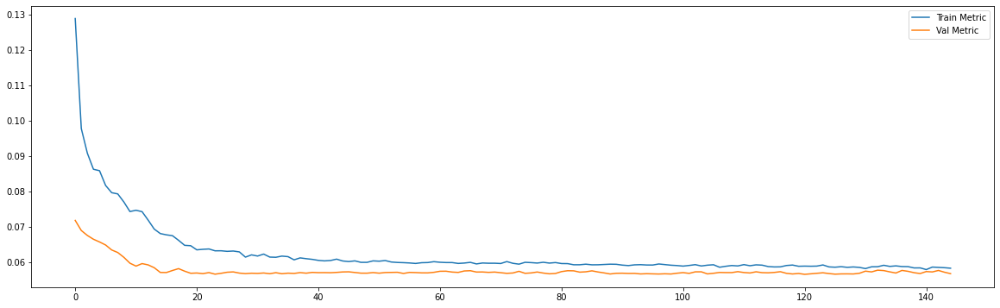

Epoch 00222: early stopping
============================model:24===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0053 - mae: 0.0543
loss and metric train data [0.00526325311511755, 0.05433937907218933]
10/10 [==============================] - 0s 4ms/step - loss: 0.0051 - mae: 0.0557
loss and metric val data [0.005078862886875868, 0.05567947030067444]
10/10 [==============================] - 0s 4ms/step - loss: 0.0060 - mae: 0.0567
loss and metric test data [0.006017482373863459, 0.05672232806682587]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




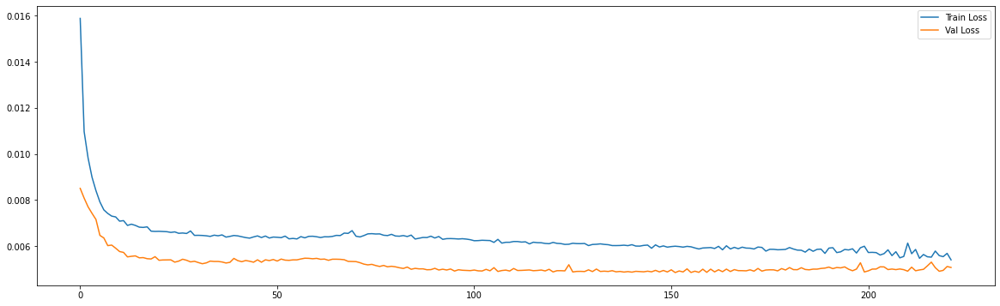

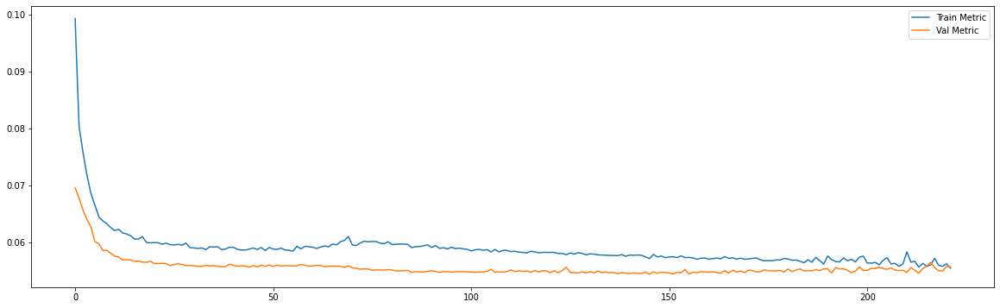

Epoch 00289: early stopping
============================model:25===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0043 - mae: 0.0500
loss and metric train data [0.00434074504300952, 0.05001599341630936]
10/10 [==============================] - 0s 6ms/step - loss: 0.0056 - mae: 0.0582
loss and metric val data [0.005587216466665268, 0.05822594463825226]
10/10 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0581
loss and metric test data [0.006312604062259197, 0.05805341899394989]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




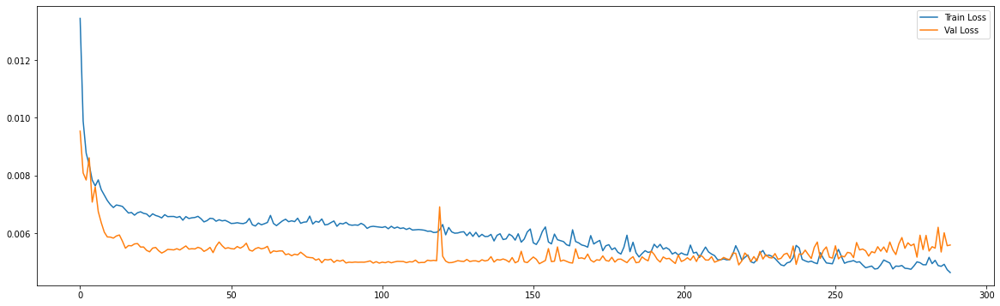

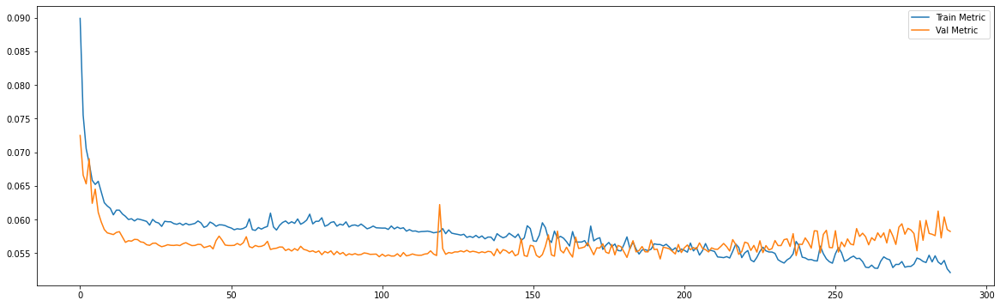

Epoch 00167: early stopping
============================model:26===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0059 - mae: 0.0569
loss and metric train data [0.005871290806680918, 0.056923992931842804]
10/10 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0565
loss and metric val data [0.004990063142031431, 0.05647924169898033]
10/10 [==============================] - 0s 4ms/step - loss: 0.0061 - mae: 0.0593
loss and metric test data [0.006058197934180498, 0.059306006878614426]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




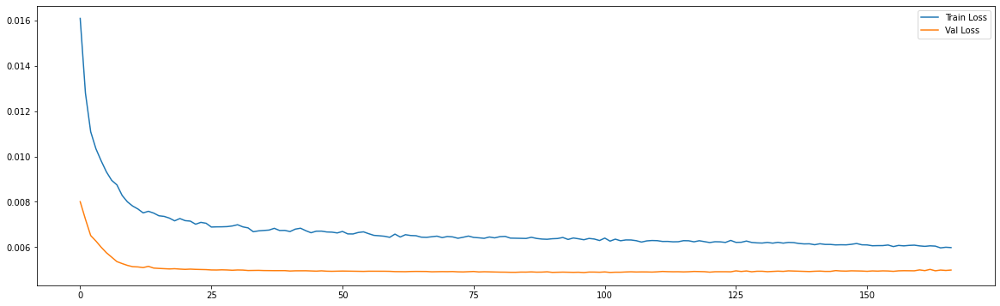

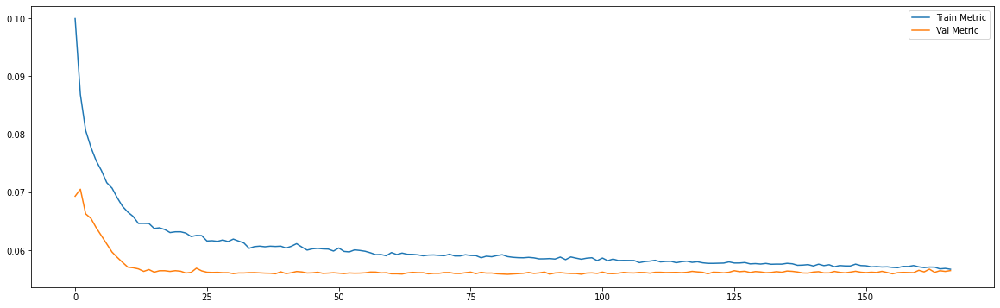

Epoch 00164: early stopping
============================model:27===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0058 - mae: 0.0560
loss and metric train data [0.005755308549851179, 0.05599033832550049]
10/10 [==============================] - 0s 6ms/step - loss: 0.0049 - mae: 0.0555
loss and metric val data [0.004926200024783611, 0.05545998364686966]
10/10 [==============================] - 0s 6ms/step - loss: 0.0059 - mae: 0.0578
loss and metric test data [0.005929203703999519, 0.05783369392156601]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




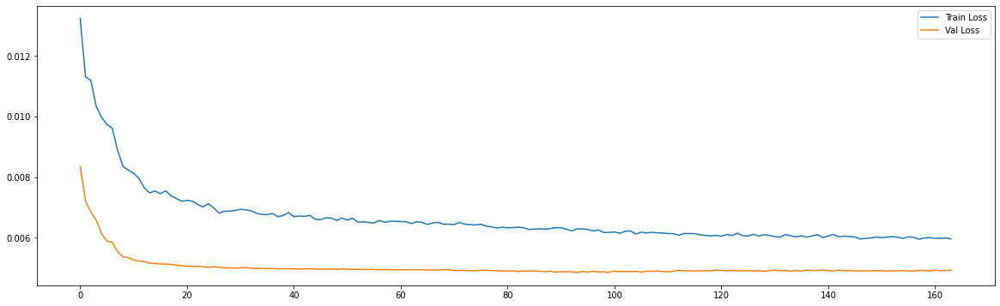

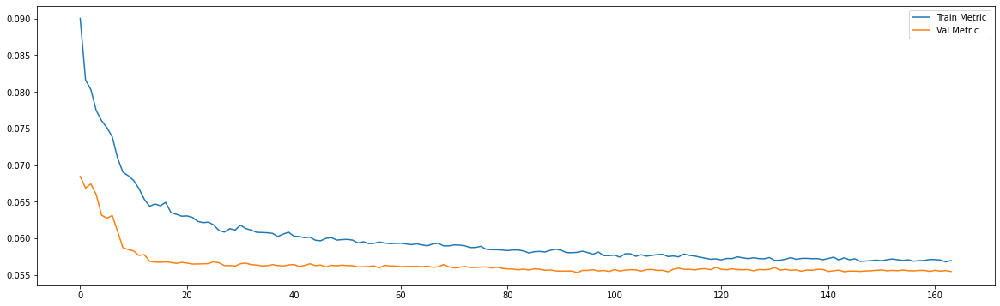

Epoch 00235: early stopping
============================model:28===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0051 - mae: 0.0533
loss and metric train data [0.005092503968626261, 0.05331183224916458]
10/10 [==============================] - 0s 5ms/step - loss: 0.0049 - mae: 0.0540
loss and metric val data [0.004941579420119524, 0.053957536816596985]
10/10 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0579
loss and metric test data [0.006169469561427832, 0.05785011872649193]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




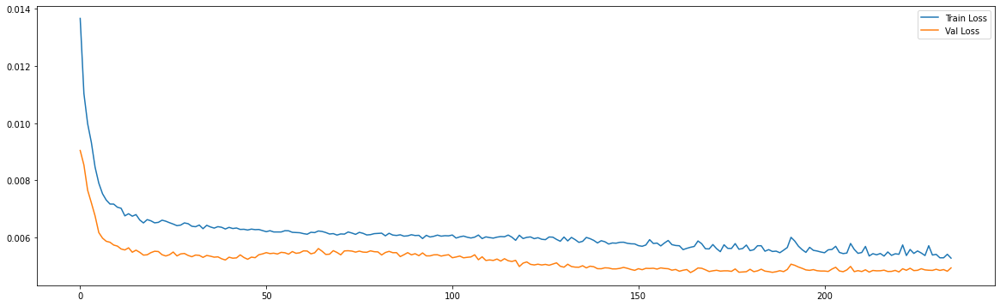

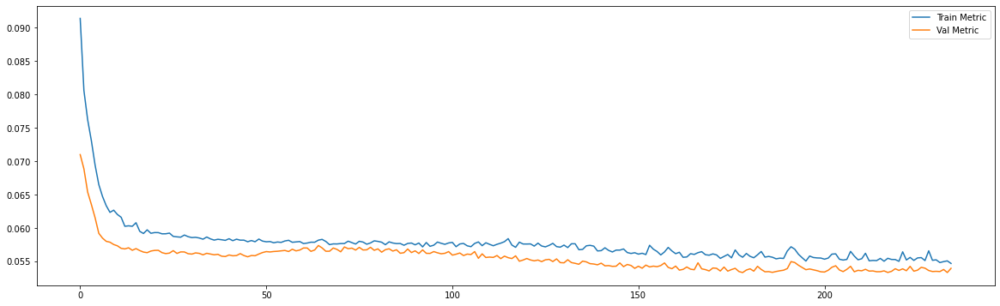

Epoch 00318: early stopping
============================model:29===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0044 - mae: 0.0502
loss and metric train data [0.00440669059753418, 0.05015702173113823]
10/10 [==============================] - 0s 9ms/step - loss: 0.0057 - mae: 0.0571
loss and metric val data [0.005677343346178532, 0.05705389380455017]
10/10 [==============================] - 0s 10ms/step - loss: 0.0062 - mae: 0.0583
loss and metric test data [0.006150847300887108, 0.058271151036024094]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




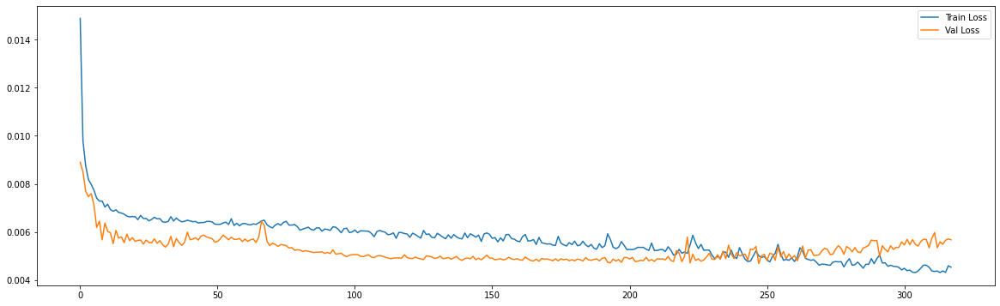

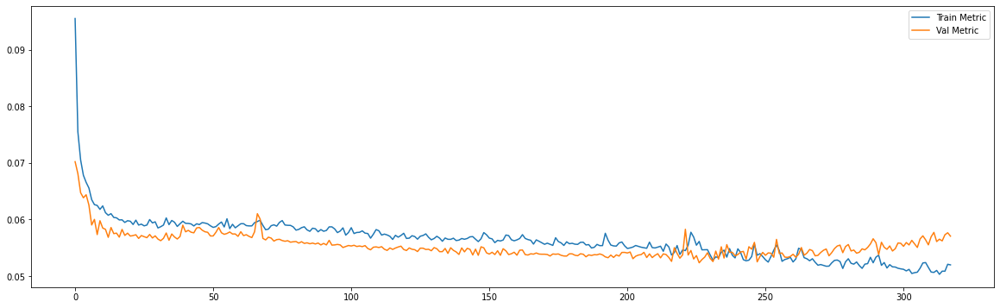

Epoch 00342: early stopping
============================model:30===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0050 - mae: 0.0537
loss and metric train data [0.005031484644860029, 0.05374043807387352]
10/10 [==============================] - 0s 5ms/step - loss: 0.0050 - mae: 0.0549
loss and metric val data [0.00495117949321866, 0.0548856146633625]
10/10 [==============================] - 0s 5ms/step - loss: 0.0060 - mae: 0.0587
loss and metric test data [0.005985519848763943, 0.0586540624499321]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




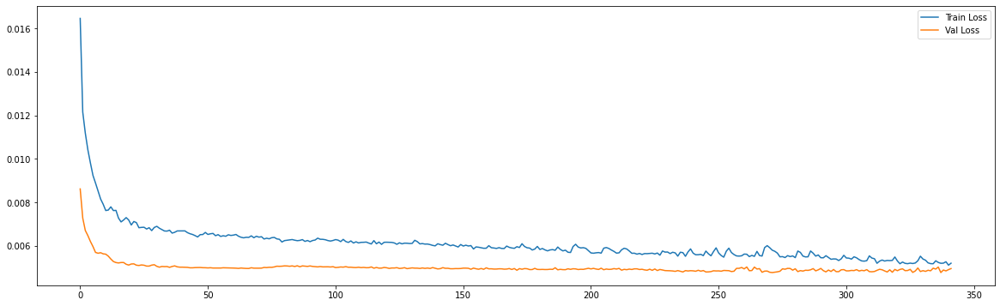

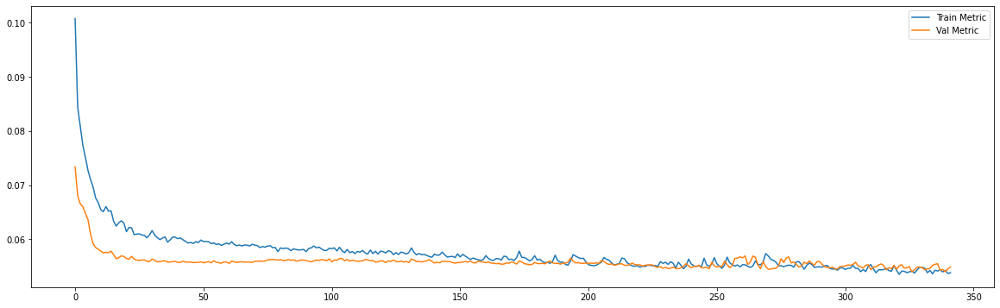

Epoch 00391: early stopping
============================model:31===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0043 - mae: 0.0500
loss and metric train data [0.0043042912147939205, 0.050042930990457535]
10/10 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0545
loss and metric val data [0.004911970347166061, 0.05445167422294617]
10/10 [==============================] - 0s 9ms/step - loss: 0.0059 - mae: 0.0563
loss and metric test data [0.005893190857023001, 0.0562848262488842]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




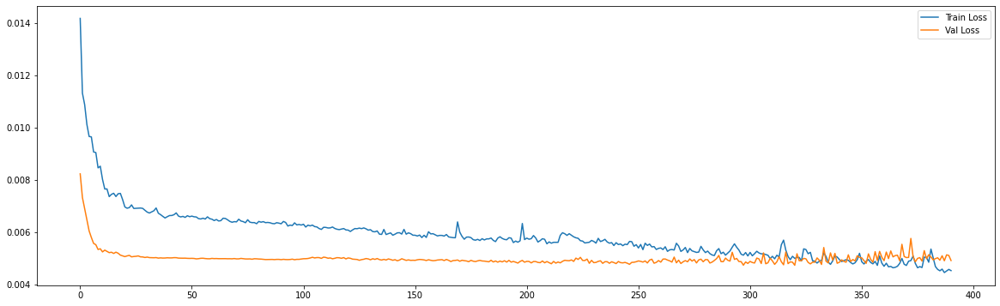

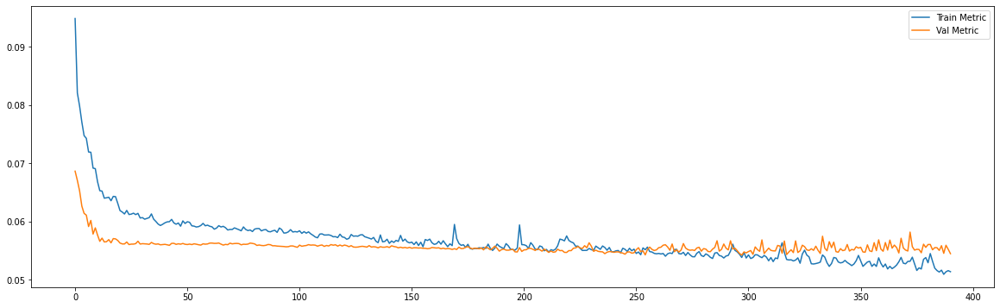

Epoch 00294: early stopping
============================model:32===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0556
loss and metric train data [0.005297135096043348, 0.05557316541671753]
10/10 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0559
loss and metric val data [0.004909371957182884, 0.05585286393761635]
10/10 [==============================] - 0s 9ms/step - loss: 0.0072 - mae: 0.0617
loss and metric test data [0.00718130636960268, 0.06172598898410797]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




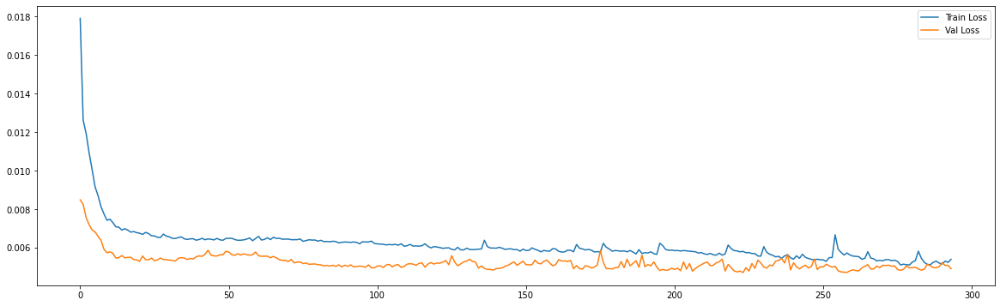

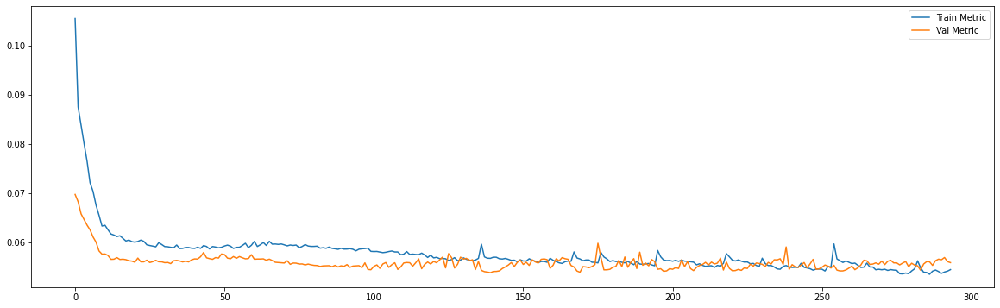

Epoch 00199: early stopping
============================model:33===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0054 - mae: 0.0547
loss and metric train data [0.0053580100648105145, 0.05473148822784424]
10/10 [==============================] - 0s 16ms/step - loss: 0.0054 - mae: 0.0567
loss and metric val data [0.00535134132951498, 0.05674222856760025]
10/10 [==============================] - 0s 16ms/step - loss: 0.0070 - mae: 0.0612
loss and metric test data [0.007015314884483814, 0.06119253858923912]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




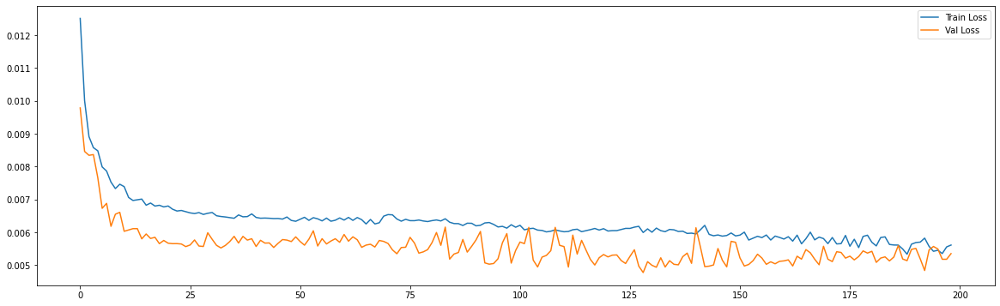

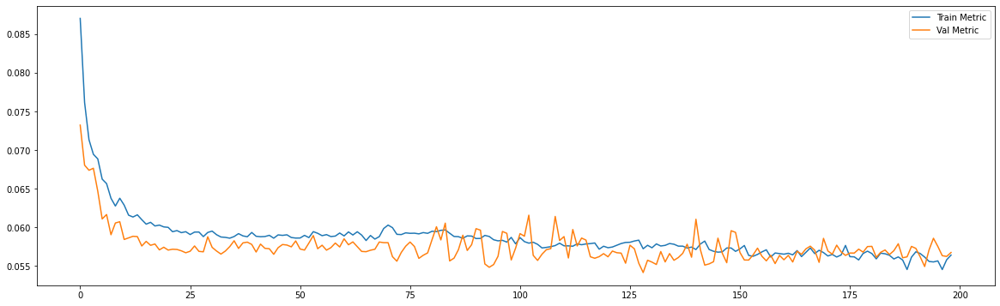

Epoch 00131: early stopping
============================model:34===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0058 - mae: 0.0557
loss and metric train data [0.005799506325274706, 0.05567794293165207]
10/10 [==============================] - 0s 8ms/step - loss: 0.0051 - mae: 0.0566
loss and metric val data [0.005103376694023609, 0.05659127235412598]
10/10 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0605
loss and metric test data [0.006648610346019268, 0.06054265424609184]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




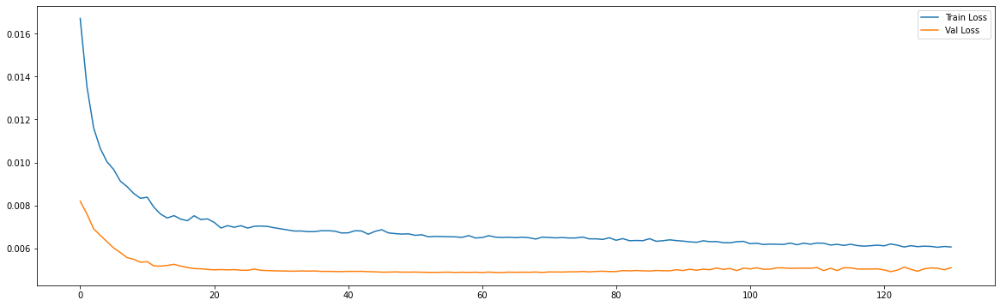

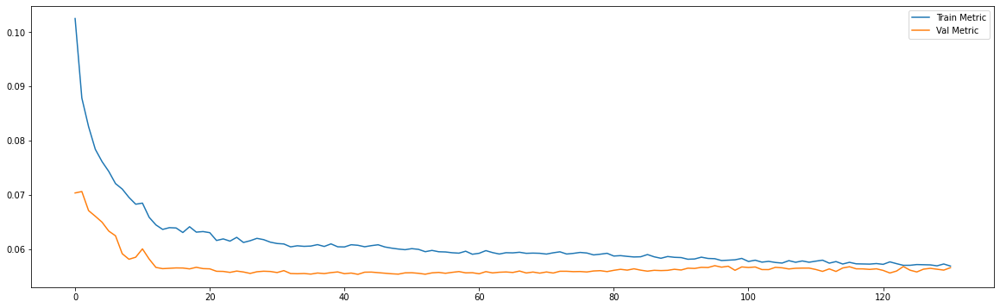

Epoch 00414: early stopping
============================model:35===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0044 - mae: 0.0501
loss and metric train data [0.0043798284605145454, 0.05011748522520065]
10/10 [==============================] - 0s 17ms/step - loss: 0.0052 - mae: 0.0565
loss and metric val data [0.0052168057300150394, 0.056489620357751846]
10/10 [==============================] - 0s 17ms/step - loss: 0.0060 - mae: 0.0582
loss and metric test data [0.006019510794430971, 0.05821889638900757]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




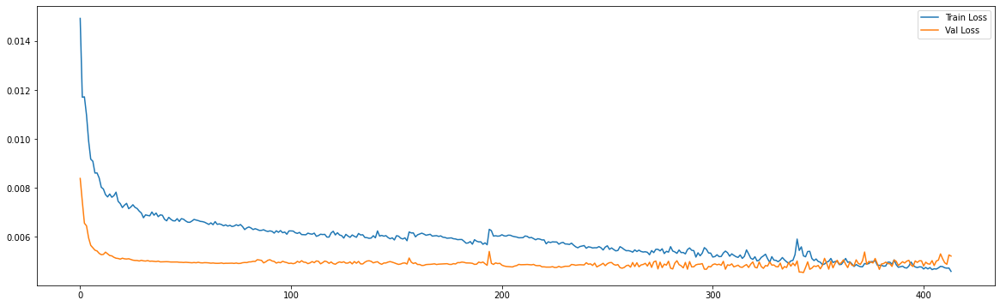

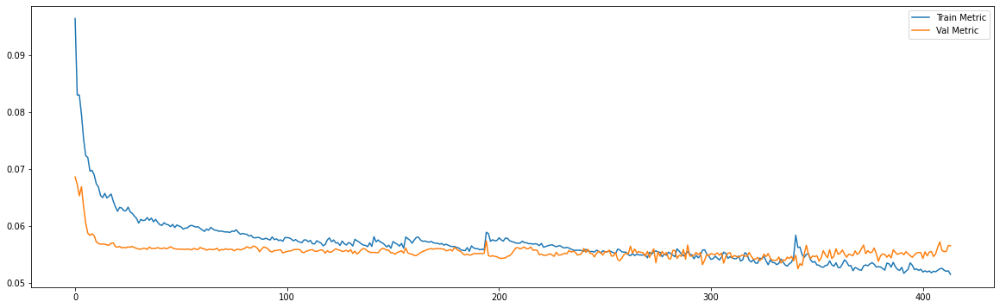

Epoch 00100: early stopping
============================model:36===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0064 - mae: 0.0571
loss and metric train data [0.00636095879599452, 0.05714183673262596]
10/10 [==============================] - 0s 3ms/step - loss: 0.0052 - mae: 0.0554
loss and metric val data [0.005242386367172003, 0.05536341294646263]
10/10 [==============================] - 0s 4ms/step - loss: 0.0064 - mae: 0.0573
loss and metric test data [0.006432150490581989, 0.057288069278001785]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




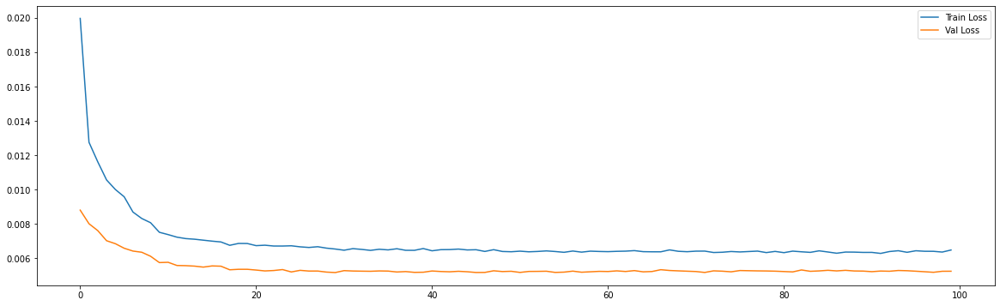

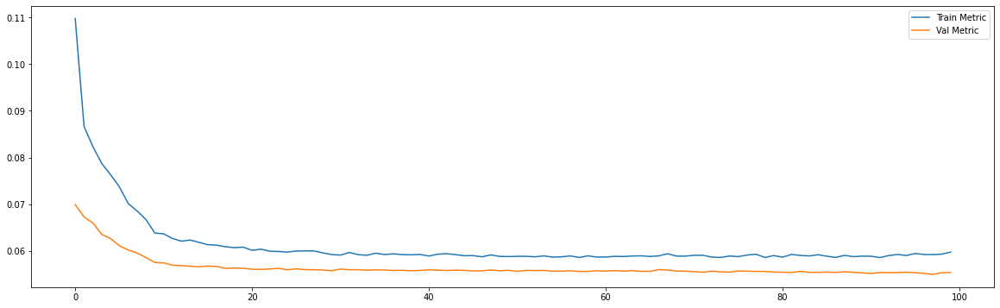

Epoch 00175: early stopping
============================model:37===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0059 - mae: 0.0567
loss and metric train data [0.005855151917785406, 0.05670326575636864]
10/10 [==============================] - 0s 6ms/step - loss: 0.0052 - mae: 0.0561
loss and metric val data [0.005205802619457245, 0.05606400966644287]
10/10 [==============================] - 0s 6ms/step - loss: 0.0061 - mae: 0.0566
loss and metric test data [0.0060845972038805485, 0.05662144720554352]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




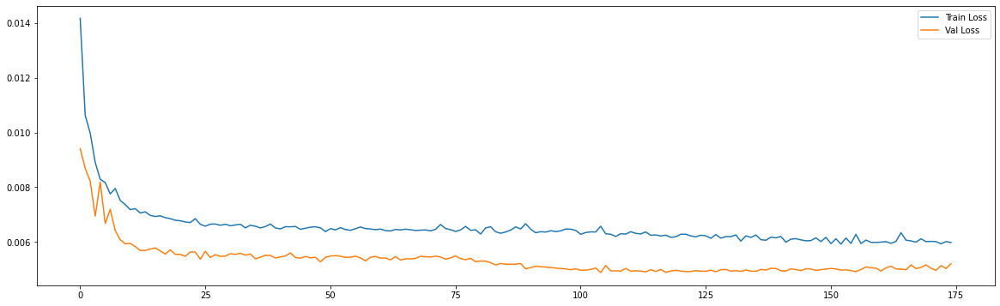

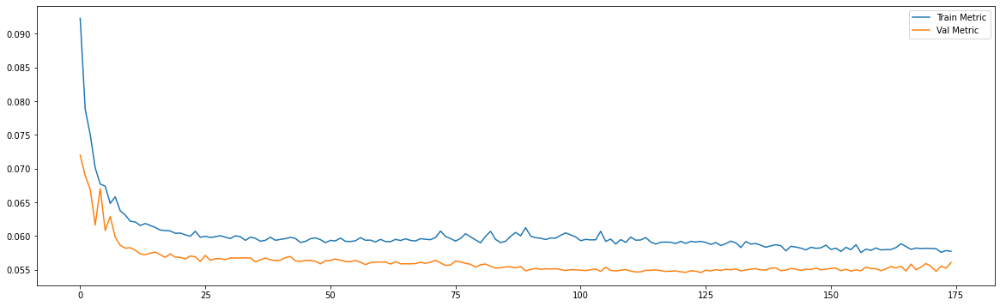

Epoch 00240: early stopping
============================model:38===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0563
loss and metric train data [0.005768600385636091, 0.056316617876291275]
10/10 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0563
loss and metric val data [0.004966487642377615, 0.05625316873192787]
10/10 [==============================] - 0s 4ms/step - loss: 0.0061 - mae: 0.0592
loss and metric test data [0.006102375220507383, 0.059180937707424164]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




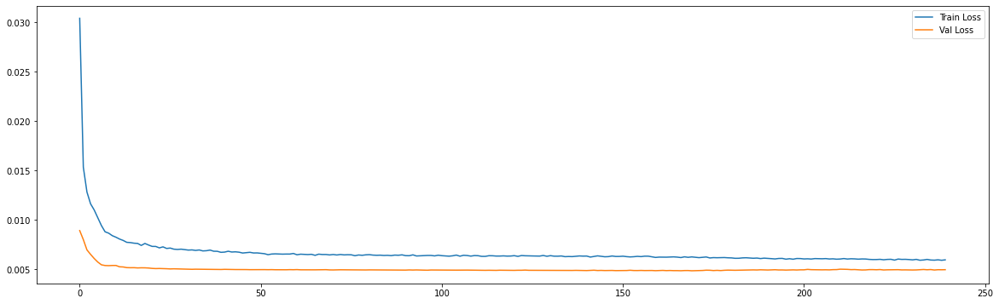

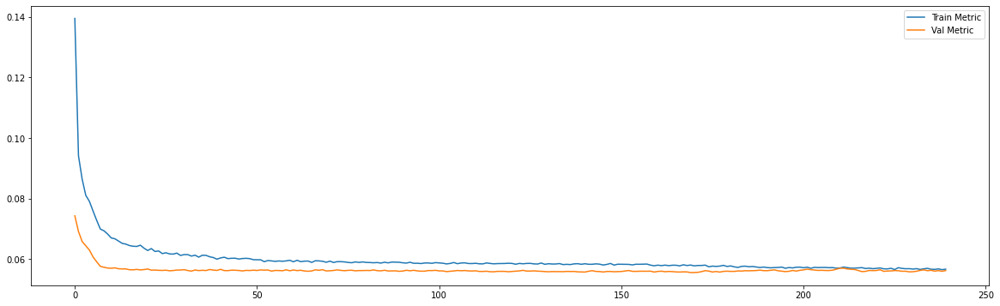

Epoch 00401: early stopping
============================model:39===========================
45/45 [==============================] - 0s 7ms/step - loss: 0.0048 - mae: 0.0532
loss and metric train data [0.004838972818106413, 0.05321799963712692]
10/10 [==============================] - 0s 6ms/step - loss: 0.0051 - mae: 0.0564
loss and metric val data [0.005052207503467798, 0.05640636011958122]
10/10 [==============================] - 0s 6ms/step - loss: 0.0059 - mae: 0.0574
loss and metric test data [0.005850817542523146, 0.057423185557127]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




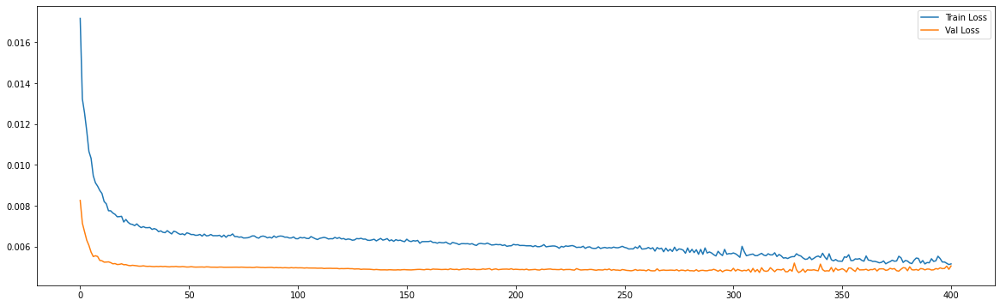

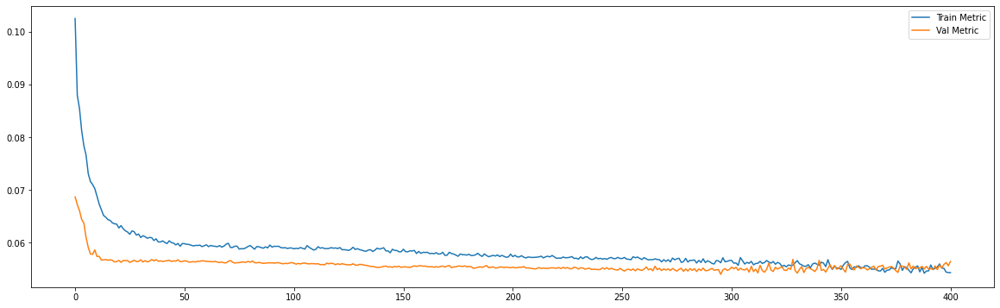

Epoch 00352: early stopping
============================model:40===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0047 - mae: 0.0521
loss and metric train data [0.004700756166130304, 0.05212635546922684]
10/10 [==============================] - 0s 5ms/step - loss: 0.0047 - mae: 0.0539
loss and metric val data [0.004706219304352999, 0.05394832044839859]
10/10 [==============================] - 0s 5ms/step - loss: 0.0057 - mae: 0.0563
loss and metric test data [0.005694663152098656, 0.0562836192548275]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




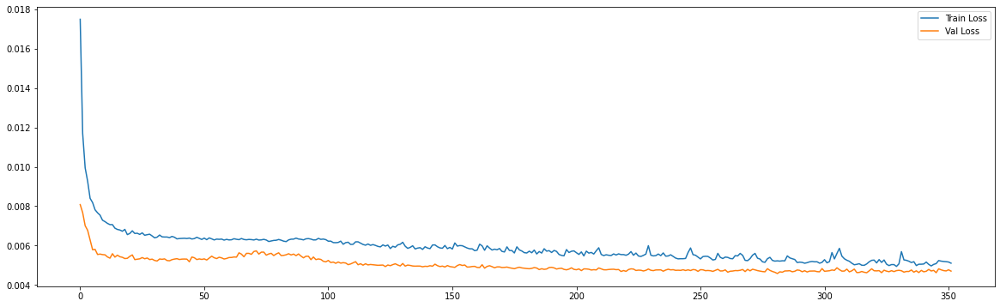

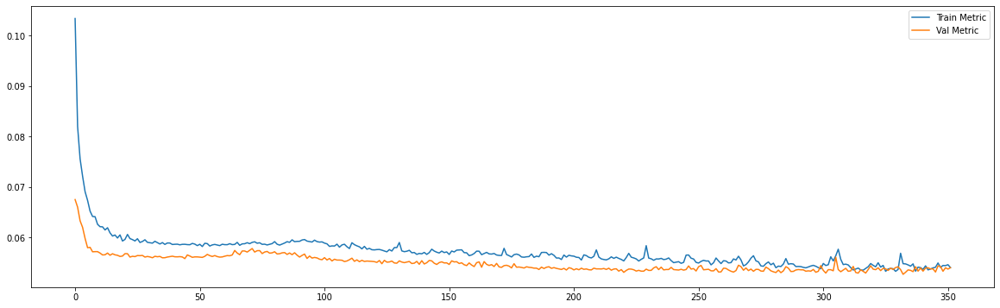

Epoch 00356: early stopping
============================model:41===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0045 - mae: 0.0505
loss and metric train data [0.0045074294321238995, 0.050465844571590424]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0561
loss and metric val data [0.005268132779747248, 0.056071143597364426]
10/10 [==============================] - 0s 9ms/step - loss: 0.0061 - mae: 0.0578
loss and metric test data [0.00606901478022337, 0.057828933000564575]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




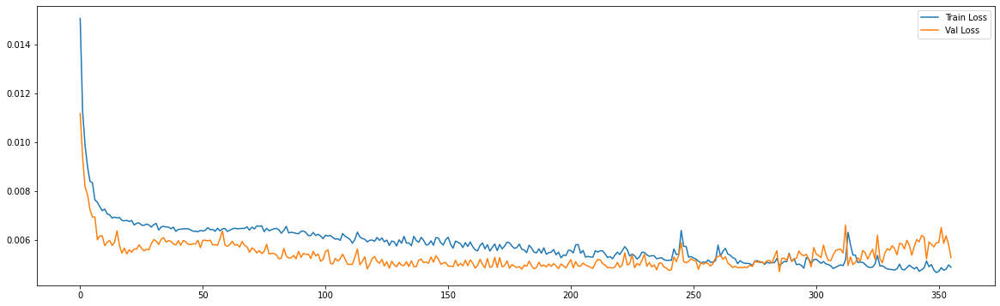

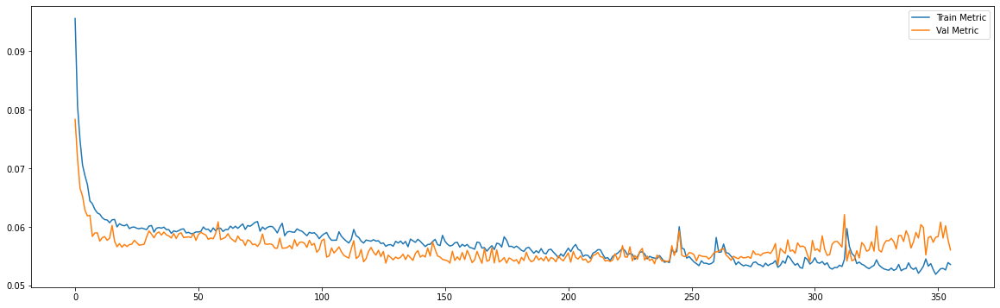

Epoch 00406: early stopping
============================model:42===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0049 - mae: 0.0523
loss and metric train data [0.004876609425991774, 0.052325405180454254]
10/10 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0535
loss and metric val data [0.004795082379132509, 0.05353366583585739]
10/10 [==============================] - 0s 5ms/step - loss: 0.0065 - mae: 0.0597
loss and metric test data [0.0064500137232244015, 0.059745125472545624]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




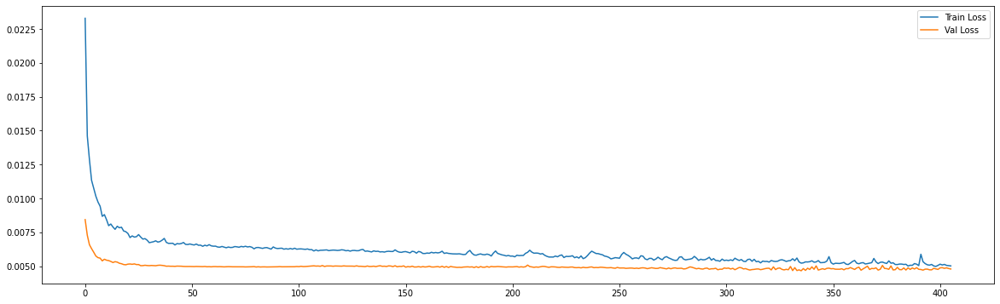

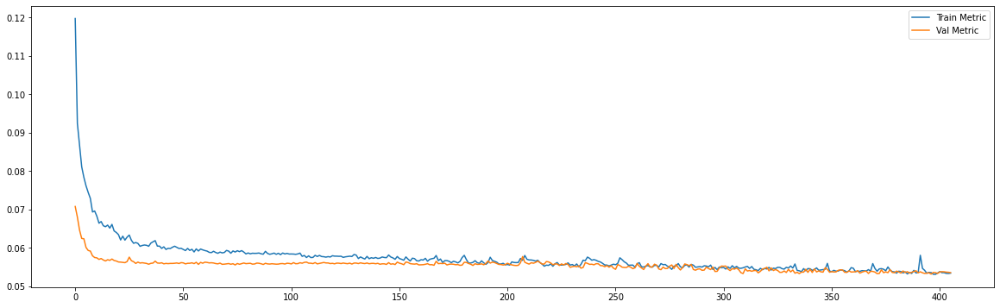

Epoch 00317: early stopping
============================model:43===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0056 - mae: 0.0571
loss and metric train data [0.005574720446020365, 0.057060692459344864]
10/10 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0578
loss and metric val data [0.005155074410140514, 0.05778004974126816]
10/10 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0617
loss and metric test data [0.006855473853647709, 0.061724670231342316]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




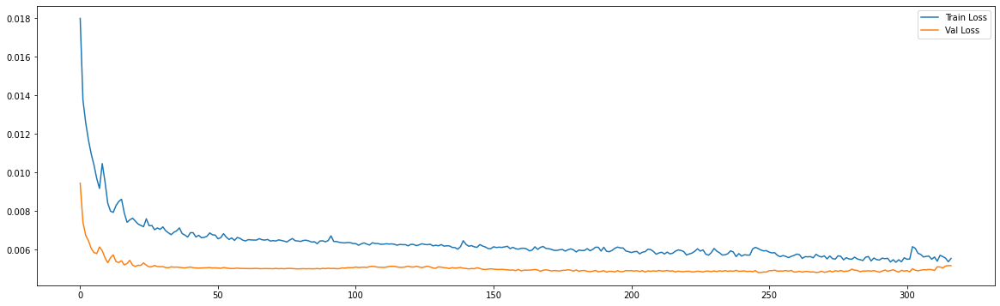

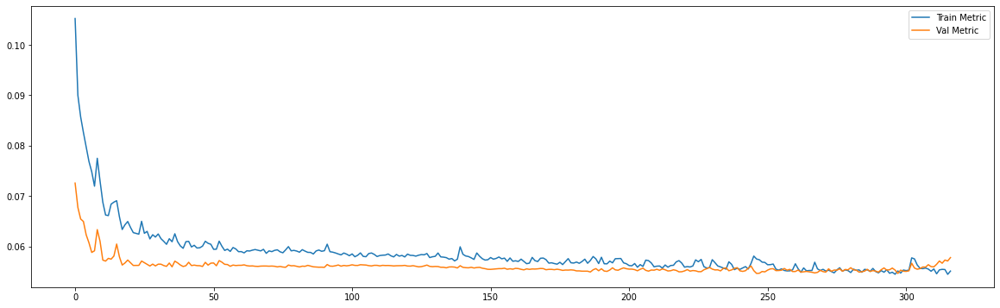

Epoch 00277: early stopping
============================model:44===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0547
loss and metric train data [0.0053267511539161205, 0.05466276407241821]
10/10 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0545
loss and metric val data [0.004790071863681078, 0.0544607900083065]
10/10 [==============================] - 0s 9ms/step - loss: 0.0061 - mae: 0.0582
loss and metric test data [0.006062041036784649, 0.05823911726474762]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




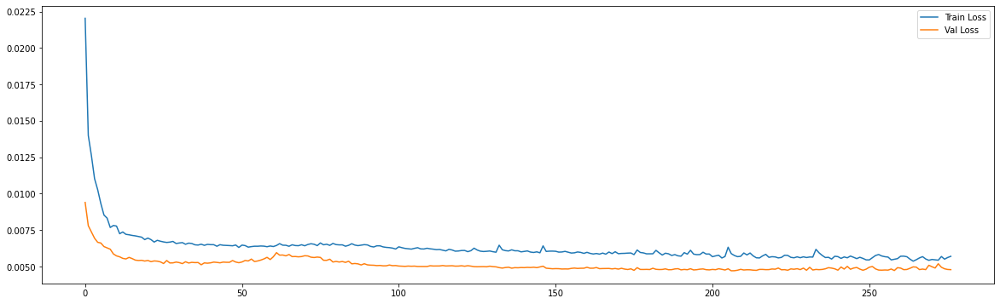

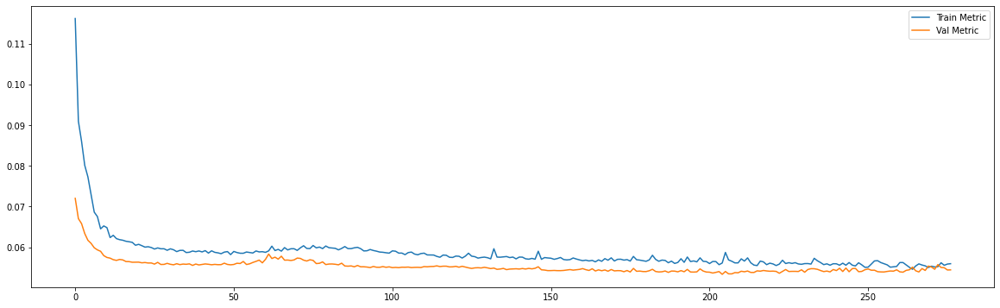

Epoch 00275: early stopping
============================model:45===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0051 - mae: 0.0540
loss and metric train data [0.005130028817802668, 0.053955722600221634]
10/10 [==============================] - 0s 16ms/step - loss: 0.0053 - mae: 0.0578
loss and metric val data [0.005251260939985514, 0.05781010538339615]
10/10 [==============================] - 0s 16ms/step - loss: 0.0070 - mae: 0.0613
loss and metric test data [0.007011104840785265, 0.061338938772678375]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




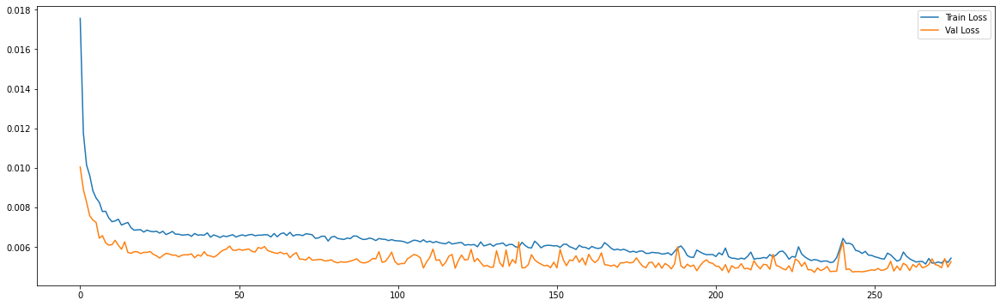

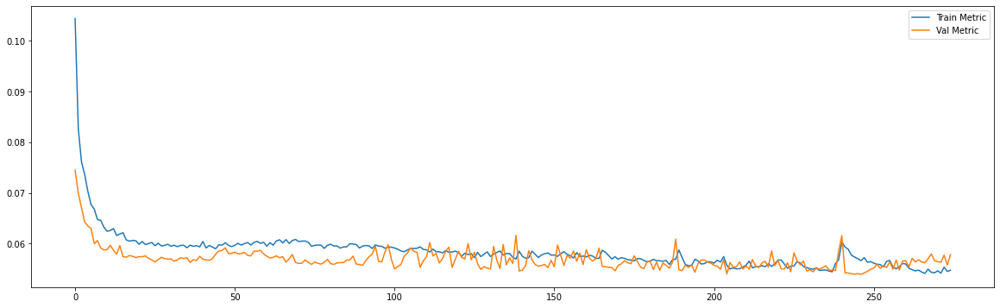

Epoch 00212: early stopping
============================model:46===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0560
loss and metric train data [0.0056010144762694836, 0.055973876267671585]
10/10 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0572
loss and metric val data [0.005183216650038958, 0.057193104177713394]
10/10 [==============================] - 0s 9ms/step - loss: 0.0063 - mae: 0.0607
loss and metric test data [0.006344555411487818, 0.06072460114955902]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




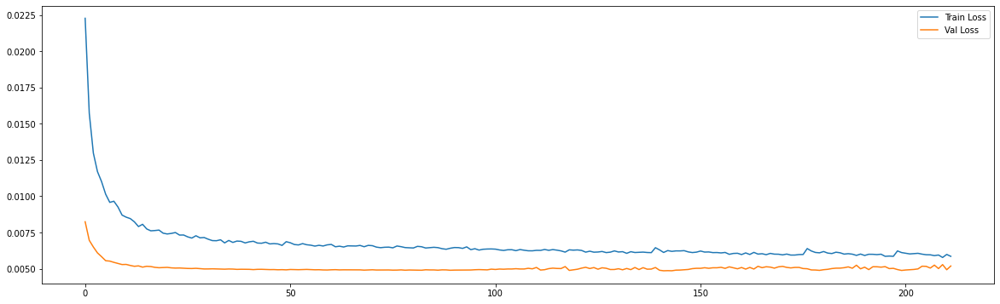

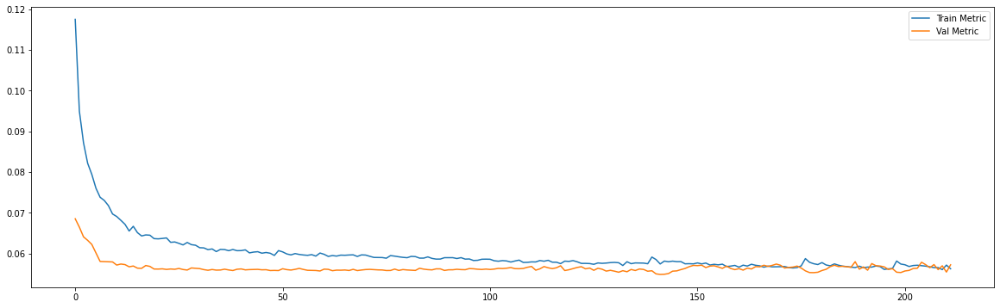

Epoch 00224: early stopping
============================model:47===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0057 - mae: 0.0554
loss and metric train data [0.005661295261234045, 0.05542027950286865]
10/10 [==============================] - 0s 16ms/step - loss: 0.0051 - mae: 0.0560
loss and metric val data [0.005090511403977871, 0.056012701243162155]
10/10 [==============================] - 0s 16ms/step - loss: 0.0065 - mae: 0.0606
loss and metric test data [0.006525109522044659, 0.06061382219195366]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




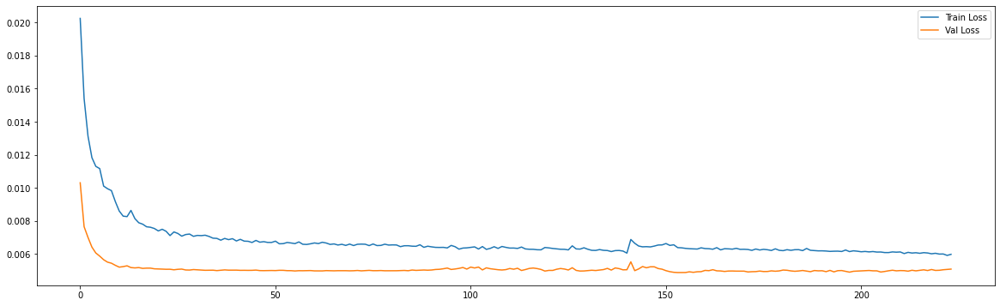

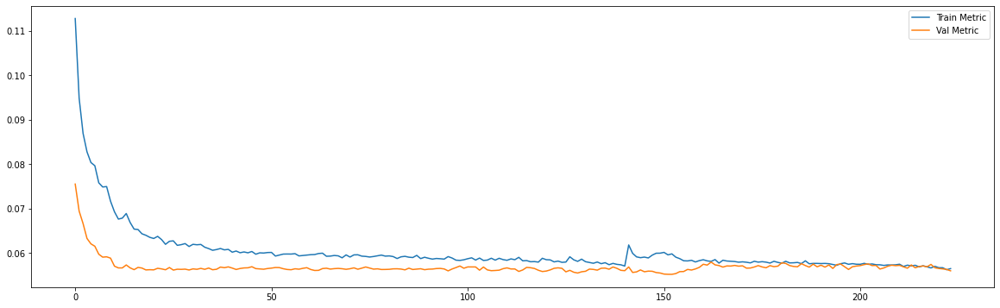

In [28]:
future_steps = 5
n_features = df_train.shape[1]

neurons_list = [30,50]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120]
batch_size_list = [32,64]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for batch_size in batch_size_list:
        for lr in lr_list:
          x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch_size, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch_size,lr,1)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=future_steps))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          # early stop
          es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = batch_size, verbose = 0, shuffle = False, callbacks = [es])

          print('============================model:{}==========================='.format(i))

            
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          i+=1


          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch_size, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch_size,lr,2)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False))
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=future_steps))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          # early stop
          es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = batch_size, verbose = 0, shuffle = False, callbacks = [es])

          print('============================model:{}==========================='.format(i))

            
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          i+=1

### Best Model Resume

`Validation metric as evaluation parameter`

Epoch 00406: early stopping

============================model:42===========================

45/45 [==============================] - 0s 6ms/step - loss: 0.0049 - mae: 0.0523

loss and metric train data [0.004876609425991774, 0.052325405180454254]

10/10 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0535

loss and metric val data [0.004795082379132509, 0.05353366583585739]

10/10 [==============================] - 0s 5ms/step - loss: 0.0065 - mae: 0.0597

loss and metric test data [0.0064500137232244015, 0.059745125472545624]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1





In [29]:
models[42]

{'batch_size': 64,
 'dropout': 0.4,
 'learning_rate': 0.001,
 'model': <tensorflow.python.keras.engine.sequential.Sequential at 0x7f1e22f8cc18>,
 'neurons': 50,
 'resumo': "'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1",
 'time_steps': 60}

Saving the Model

In [30]:
models[42]['model'].save("/content/drive/My Drive/ML Projects/Pharma Sales/LSTM_multiFeature_weekdayMonth.h5")

Ploting the model prediction

In [31]:
future_steps = 5
n_features = df_train.shape[1]
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = 60,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

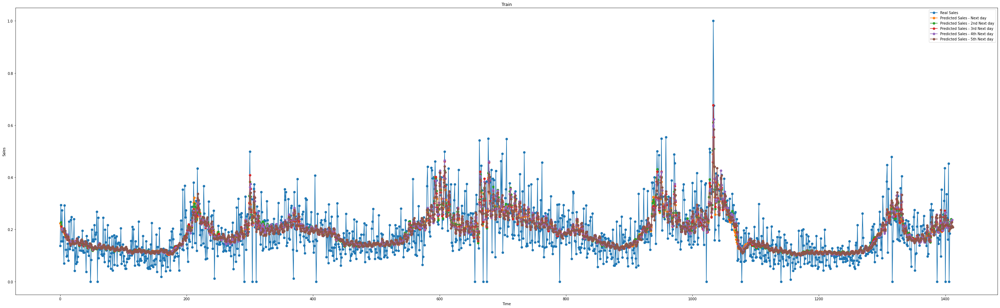

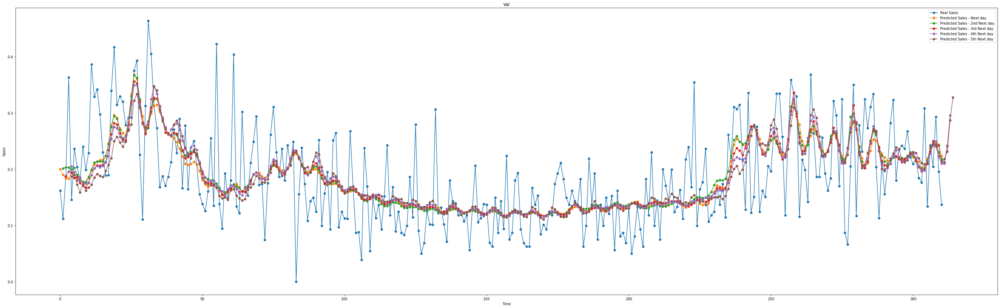

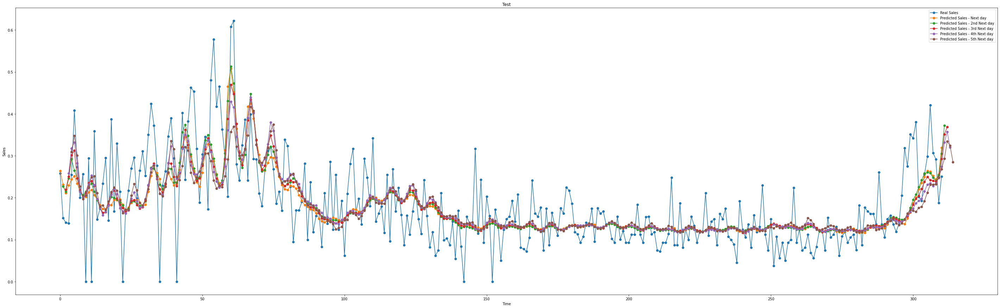

In [32]:
y_train_predict = models[42]['model'].predict(x_train)
y_val_predict = models[42]['model'].predict(x_val)
y_test_predict = models[42]['model'].predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

## LSTM

Month and Weekday as Cyclical Features



In [33]:
df_train,df_val,df_test = dataSplit(df = df_daily[['weekday_sin','weekday_cos','month_sin','month_cos','N02BE']],train_percent = 0.7,val_percent = 0.15)
df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange = (0,1))

(1474, 5)
(316, 5)
(316, 5)
[1. 1. 1. 1. 1.]
[0. 0. 0. 0. 0.]


[1.         1.         1.         1.         0.46335404]
[0. 0. 0. 0. 0.]


[1.         1.         1.         1.         0.62173913]
[0. 0. 0. 0. 0.]
-------------------------
(1474, 5)
(316, 5)
(316, 5)


Epoch 00246: early stopping
============================model:0===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0054 - mae: 0.0547
loss and metric train data [0.005421399138867855, 0.05472114682197571]
10/10 [==============================] - 0s 4ms/step - loss: 0.0048 - mae: 0.0546
loss and metric val data [0.004763339180499315, 0.054648734629154205]
10/10 [==============================] - 0s 4ms/step - loss: 0.0069 - mae: 0.0583
loss and metric test data [0.0068750083446502686, 0.058253541588783264]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




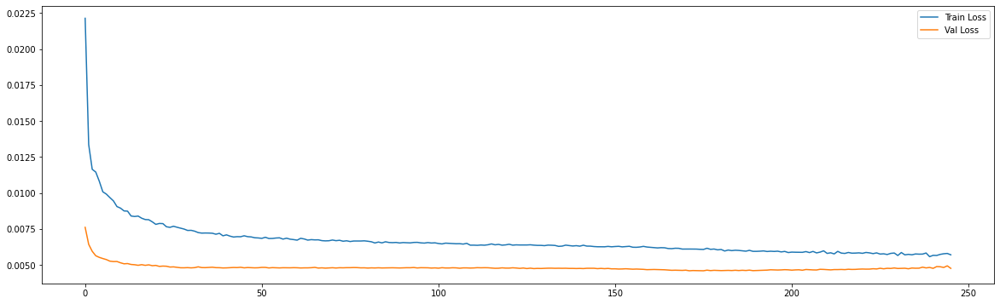

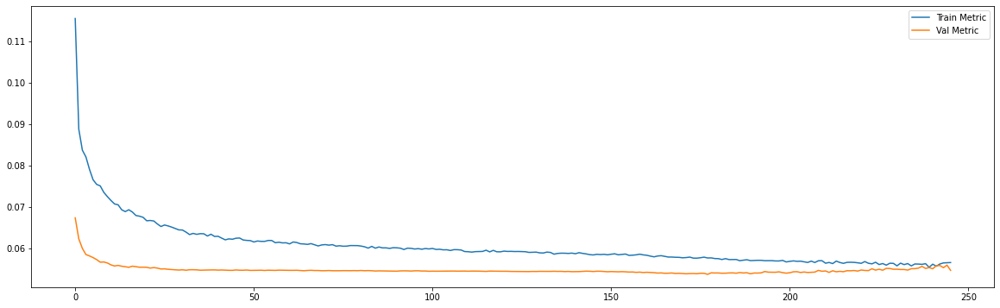

Epoch 00157: early stopping
============================model:1===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0056 - mae: 0.0548
loss and metric train data [0.0055505335330963135, 0.054823484271764755]
10/10 [==============================] - 0s 5ms/step - loss: 0.0050 - mae: 0.0556
loss and metric val data [0.004984688013792038, 0.055636752396821976]
10/10 [==============================] - 0s 6ms/step - loss: 0.0065 - mae: 0.0575
loss and metric test data [0.006453996524214745, 0.057509396225214005]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




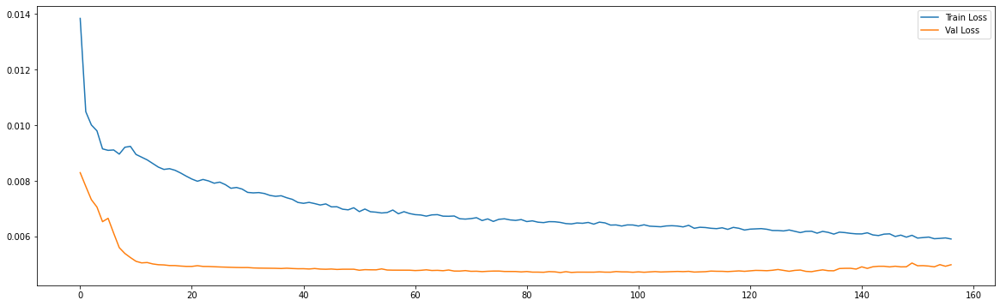

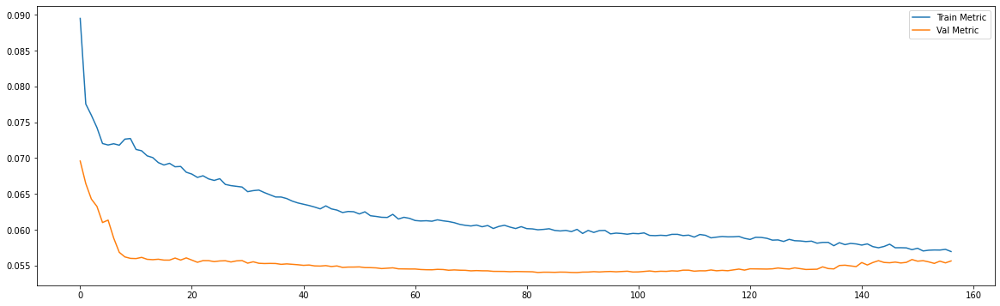

Epoch 00131: early stopping
============================model:2===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0061 - mae: 0.0573
loss and metric train data [0.0061242165975272655, 0.05729948356747627]
10/10 [==============================] - 0s 4ms/step - loss: 0.0048 - mae: 0.0548
loss and metric val data [0.004767836537212133, 0.054826851934194565]
10/10 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0584
loss and metric test data [0.0062505146488547325, 0.05841851979494095]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




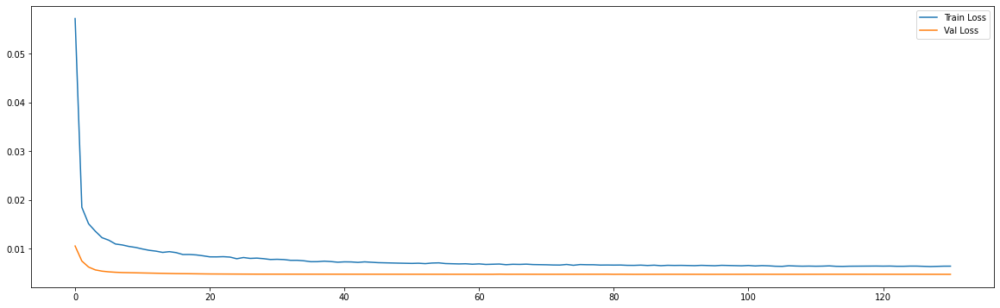

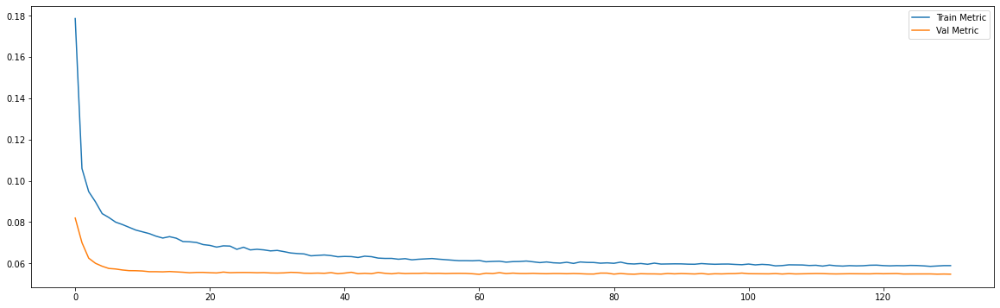

Epoch 00249: early stopping
============================model:3===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0054 - mae: 0.0547
loss and metric train data [0.005359375849366188, 0.0546945258975029]
10/10 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0552
loss and metric val data [0.004793502390384674, 0.05515441298484802]
10/10 [==============================] - 0s 5ms/step - loss: 0.0063 - mae: 0.0567
loss and metric test data [0.006252963095903397, 0.05665716528892517]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




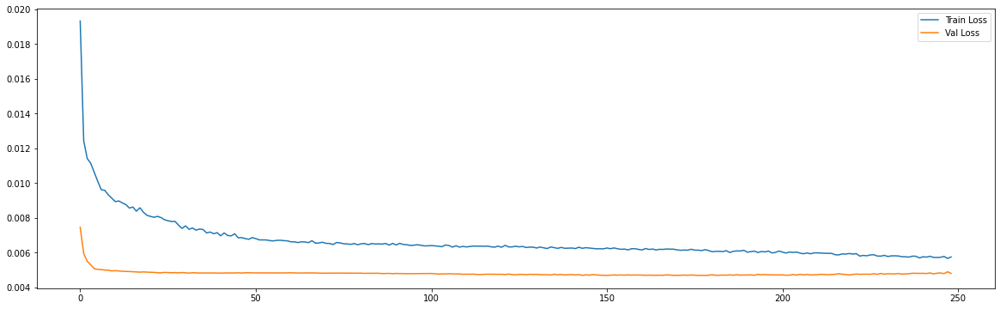

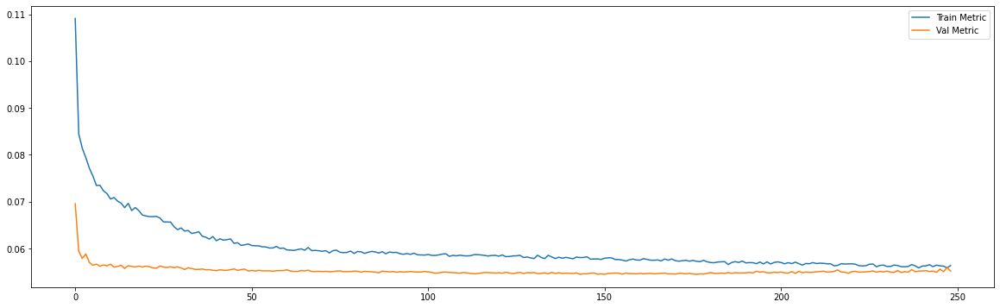

Epoch 00101: early stopping
============================model:4===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0567
loss and metric train data [0.006173199974000454, 0.05671592429280281]
10/10 [==============================] - 0s 5ms/step - loss: 0.0049 - mae: 0.0545
loss and metric val data [0.0048582484014332294, 0.054481495171785355]
10/10 [==============================] - 0s 5ms/step - loss: 0.0063 - mae: 0.0577
loss and metric test data [0.006320123560726643, 0.05767262354493141]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




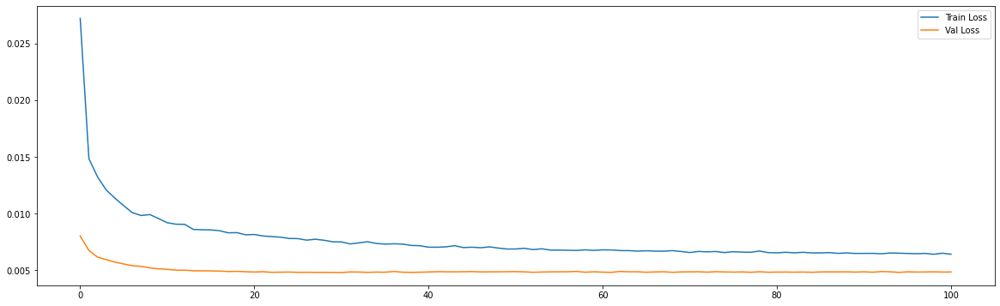

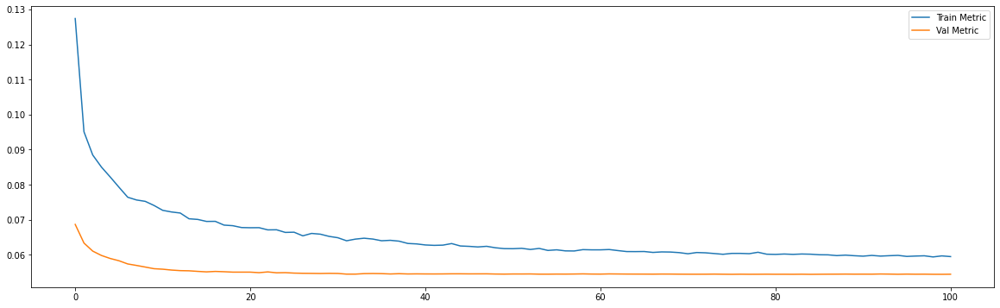

Epoch 00203: early stopping
============================model:5===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0535
loss and metric train data [0.0049793915823102, 0.05353584513068199]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0567
loss and metric val data [0.005280373152345419, 0.056661926209926605]
10/10 [==============================] - 0s 9ms/step - loss: 0.0071 - mae: 0.0596
loss and metric test data [0.00709399301558733, 0.05957455188035965]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




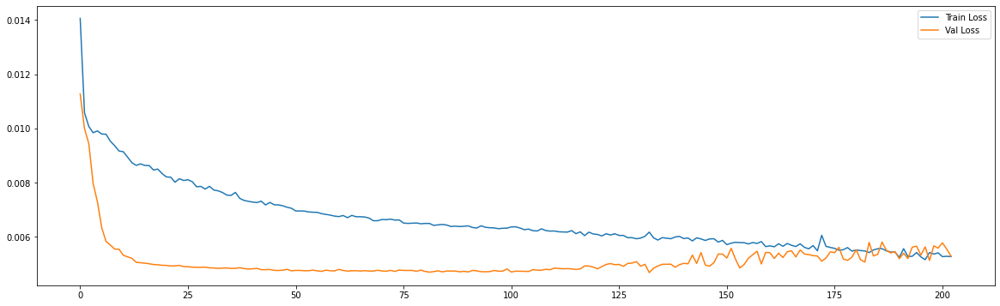

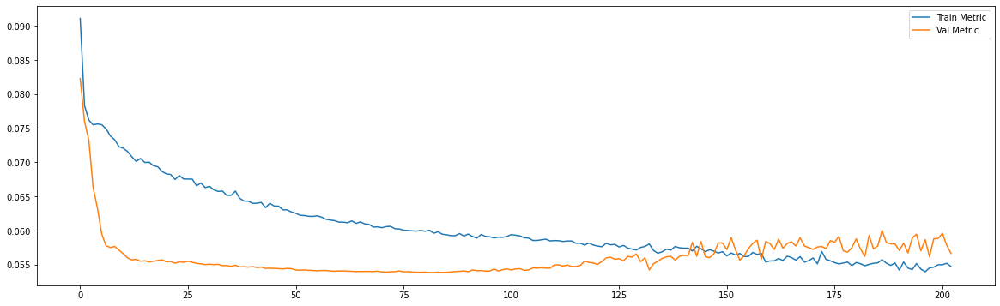

Epoch 00211: early stopping
============================model:6===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0058 - mae: 0.0556
loss and metric train data [0.005828403402119875, 0.05559026449918747]
10/10 [==============================] - 0s 5ms/step - loss: 0.0049 - mae: 0.0558
loss and metric val data [0.004923097789287567, 0.055826205760240555]
10/10 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0579
loss and metric test data [0.006174022331833839, 0.057871975004673004]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




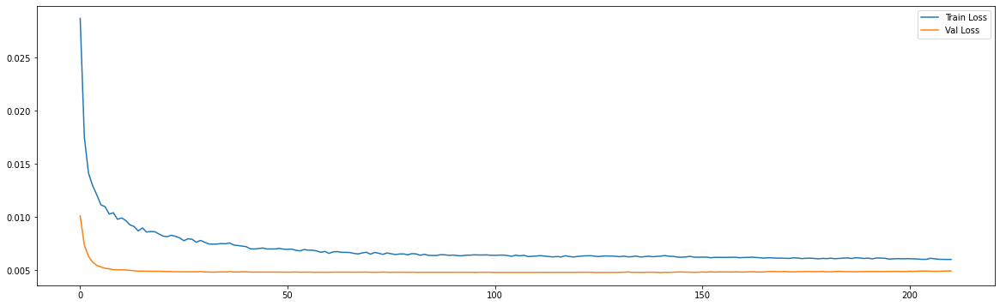

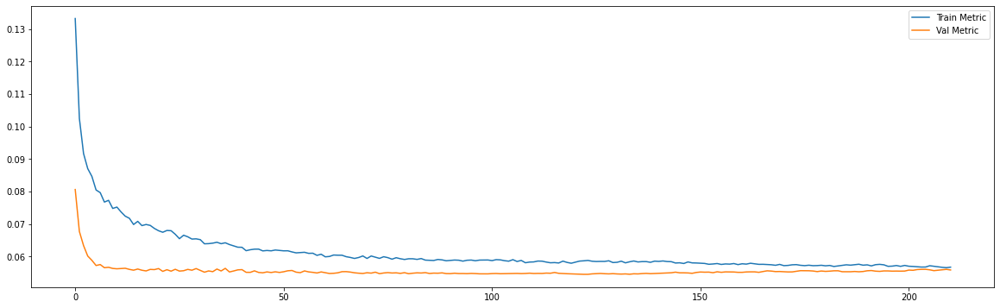

Epoch 00316: early stopping
============================model:7===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0049 - mae: 0.0521
loss and metric train data [0.004886135924607515, 0.05210103839635849]
10/10 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0567
loss and metric val data [0.005075753666460514, 0.05666634812951088]
10/10 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0598
loss and metric test data [0.006889751646667719, 0.059804946184158325]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




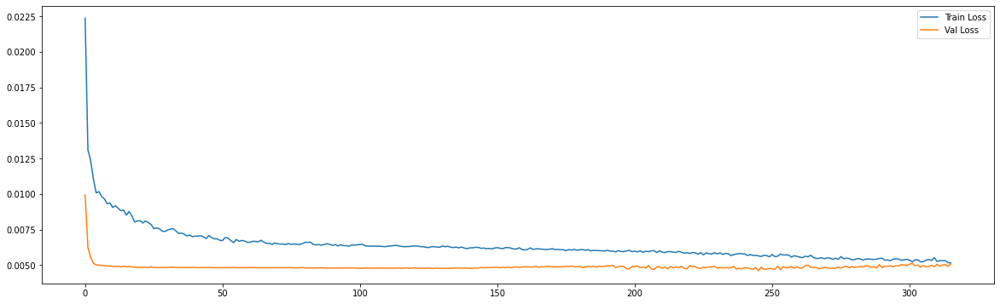

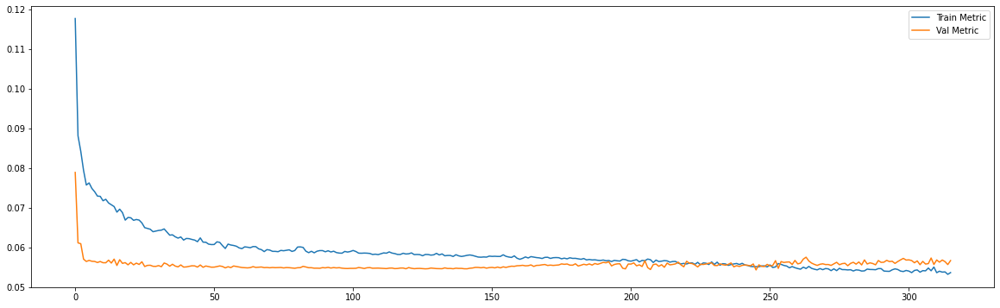

Epoch 00218: early stopping
============================model:8===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0541
loss and metric train data [0.005284235347062349, 0.05405399575829506]
10/10 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0585
loss and metric val data [0.005303505342453718, 0.05846796929836273]
10/10 [==============================] - 0s 8ms/step - loss: 0.0072 - mae: 0.0602
loss and metric test data [0.007160334847867489, 0.060218941420316696]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




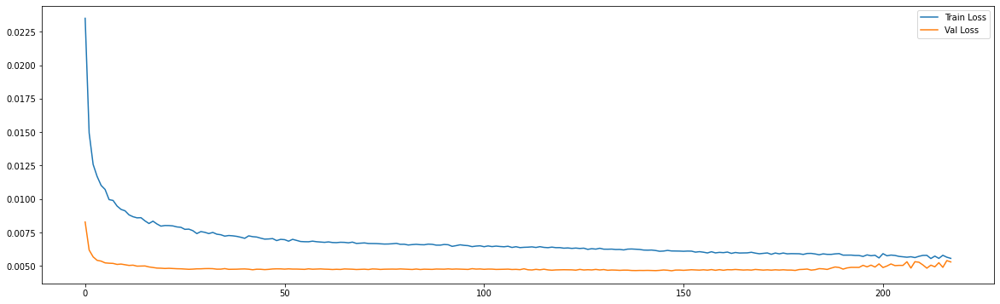

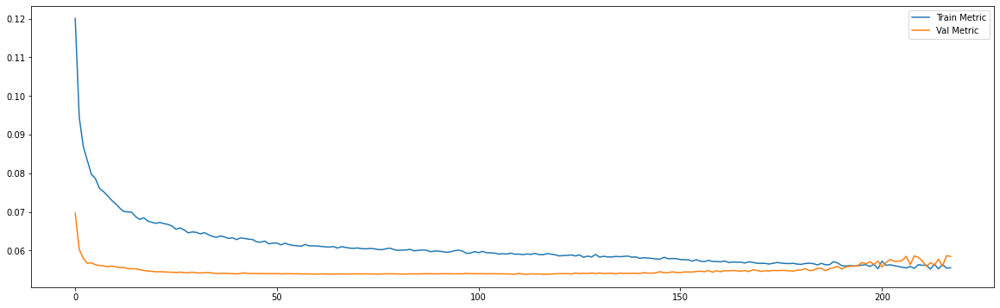

Epoch 00163: early stopping
============================model:9===========================
43/43 [==============================] - 1s 17ms/step - loss: 0.0054 - mae: 0.0540
loss and metric train data [0.005410883110016584, 0.054001081734895706]
10/10 [==============================] - 0s 16ms/step - loss: 0.0050 - mae: 0.0555
loss and metric val data [0.004990680608898401, 0.05552154406905174]
10/10 [==============================] - 0s 16ms/step - loss: 0.0067 - mae: 0.0591
loss and metric test data [0.006669394206255674, 0.059118885546922684]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




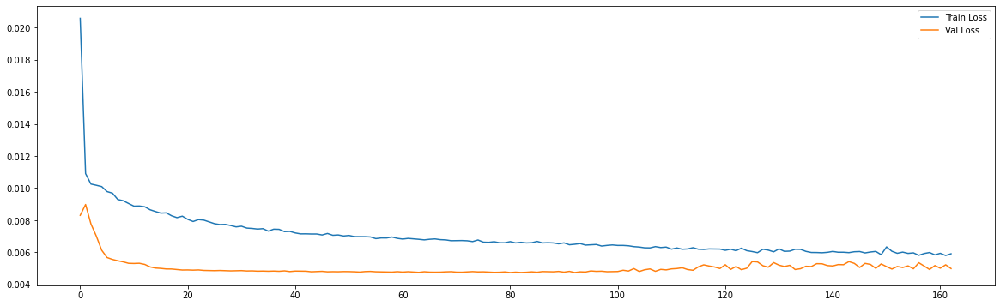

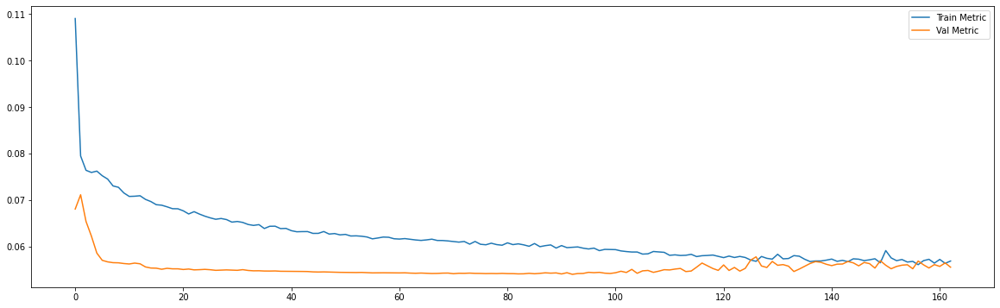

Epoch 00182: early stopping
============================model:10===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0574
loss and metric train data [0.006071695126593113, 0.05739419907331467]
10/10 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0566
loss and metric val data [0.004900905303657055, 0.05656912177801132]
10/10 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0594
loss and metric test data [0.006265445612370968, 0.05941680446267128]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




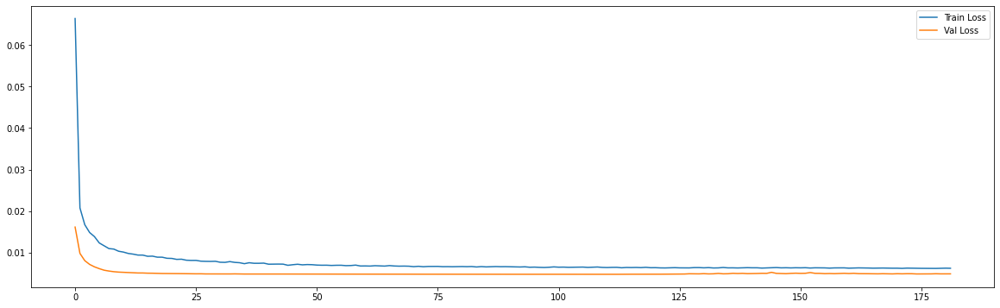

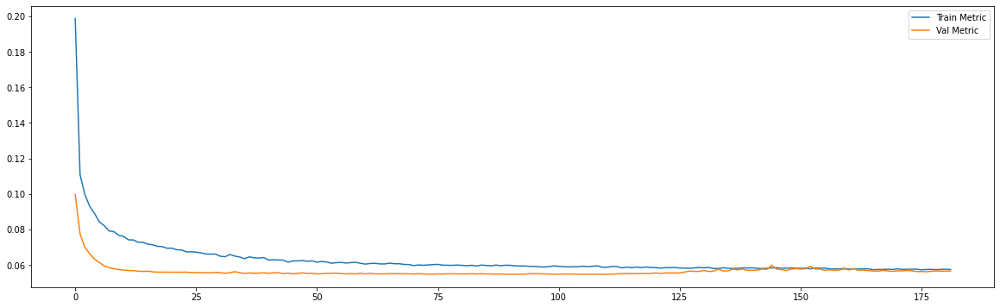

Epoch 00263: early stopping
============================model:11===========================
43/43 [==============================] - 1s 17ms/step - loss: 0.0054 - mae: 0.0540
loss and metric train data [0.005417343229055405, 0.05401692911982536]
10/10 [==============================] - 0s 16ms/step - loss: 0.0049 - mae: 0.0565
loss and metric val data [0.004912381526082754, 0.056467846035957336]
10/10 [==============================] - 0s 16ms/step - loss: 0.0064 - mae: 0.0583
loss and metric test data [0.006406902335584164, 0.058287471532821655]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




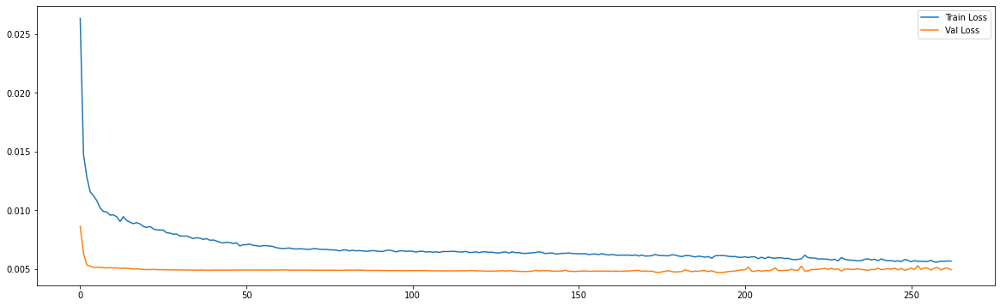

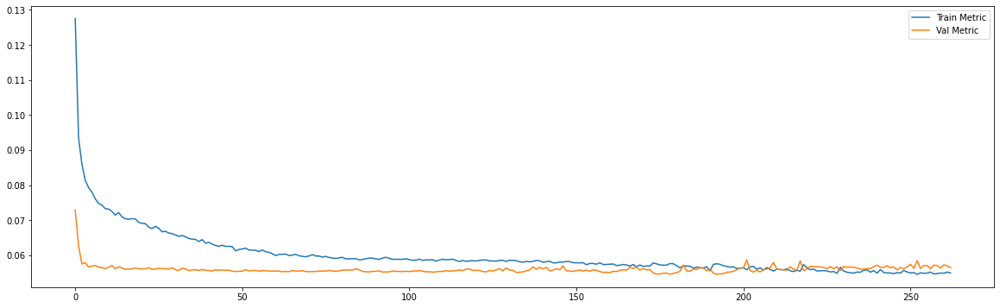

Epoch 00269: early stopping
============================model:12===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0054 - mae: 0.0547
loss and metric train data [0.005372638814151287, 0.05469943955540657]
10/10 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0566
loss and metric val data [0.005038364790380001, 0.0565844364464283]
10/10 [==============================] - 0s 4ms/step - loss: 0.0069 - mae: 0.0602
loss and metric test data [0.006945551838725805, 0.06023037061095238]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




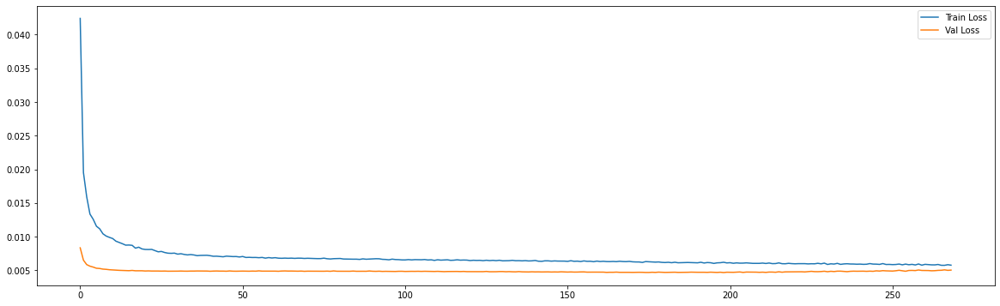

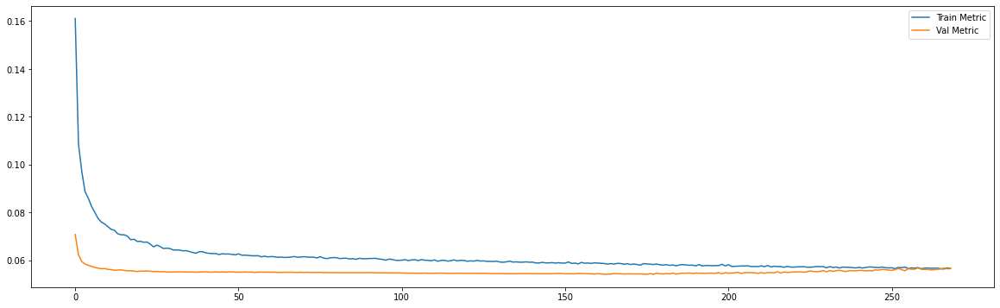

Epoch 00205: early stopping
============================model:13===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0054 - mae: 0.0550
loss and metric train data [0.00544921588152647, 0.05502431094646454]
10/10 [==============================] - 0s 5ms/step - loss: 0.0051 - mae: 0.0565
loss and metric val data [0.005090911407023668, 0.056533120572566986]
10/10 [==============================] - 0s 6ms/step - loss: 0.0064 - mae: 0.0578
loss and metric test data [0.006436049938201904, 0.05779007077217102]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




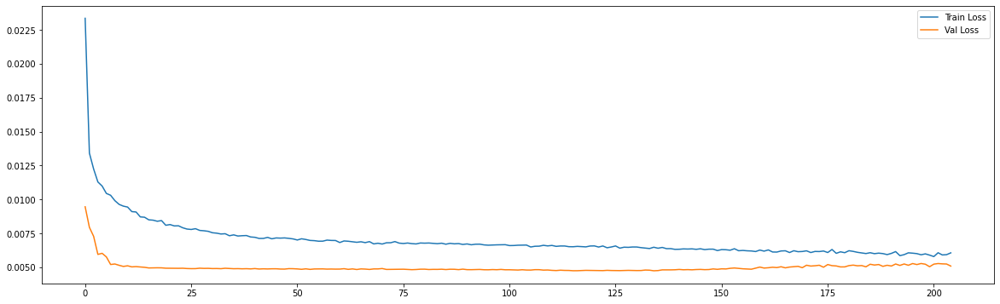

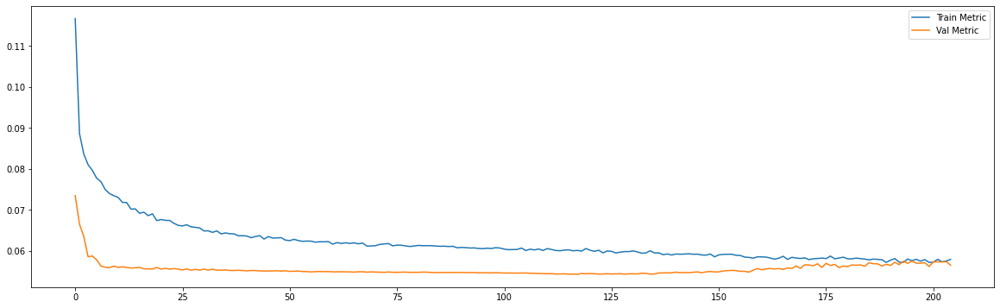

Epoch 00127: early stopping
============================model:14===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0574
loss and metric train data [0.00615384615957737, 0.05738784372806549]
10/10 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0552
loss and metric val data [0.0048139928840100765, 0.055180054157972336]
10/10 [==============================] - 0s 3ms/step - loss: 0.0063 - mae: 0.0586
loss and metric test data [0.006322926841676235, 0.05862336605787277]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




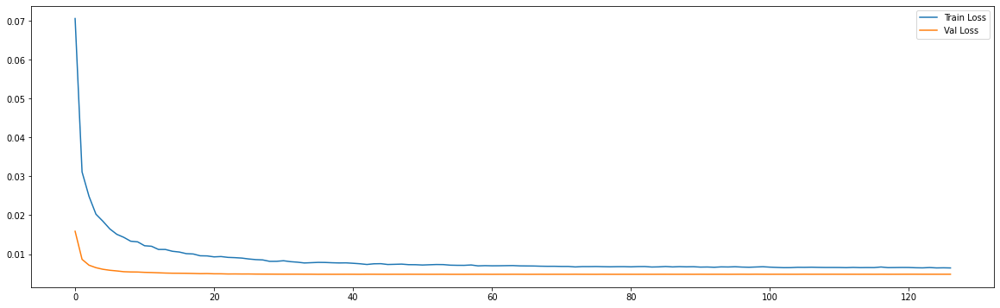

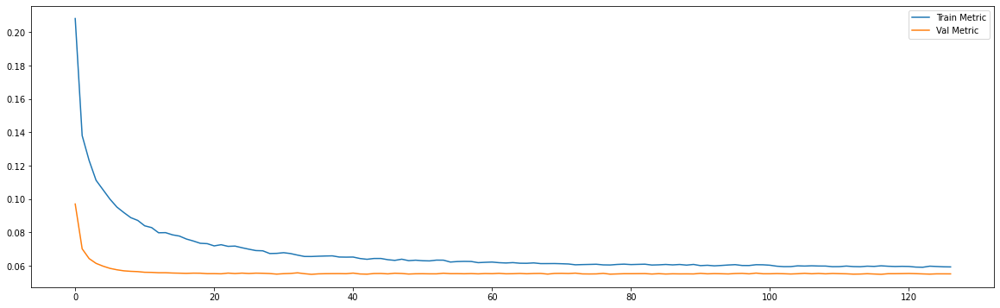

Epoch 00295: early stopping
============================model:15===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0054 - mae: 0.0548
loss and metric train data [0.005367546807974577, 0.054811302572488785]
10/10 [==============================] - 0s 5ms/step - loss: 0.0049 - mae: 0.0559
loss and metric val data [0.004939292557537556, 0.055862799286842346]
10/10 [==============================] - 0s 5ms/step - loss: 0.0076 - mae: 0.0599
loss and metric test data [0.00763167766854167, 0.05988577380776405]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




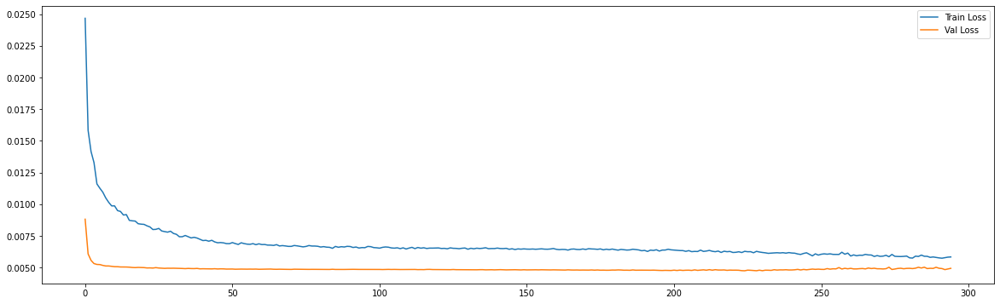

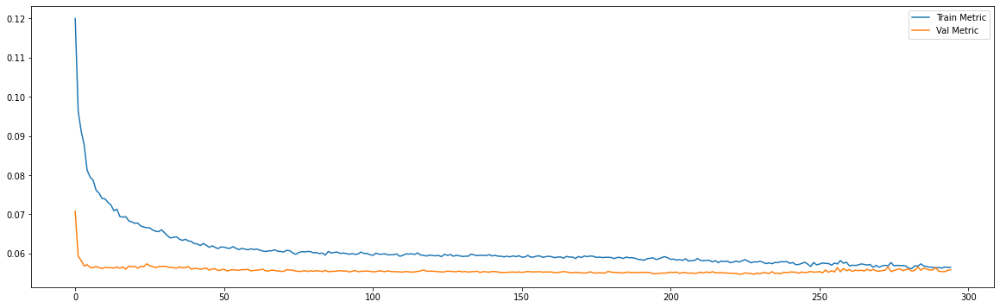

Epoch 00093: early stopping
============================model:16===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0570
loss and metric train data [0.006209725514054298, 0.05695750564336777]
10/10 [==============================] - 0s 5ms/step - loss: 0.0049 - mae: 0.0546
loss and metric val data [0.004884769674390554, 0.05463661998510361]
10/10 [==============================] - 0s 5ms/step - loss: 0.0064 - mae: 0.0578
loss and metric test data [0.006371746305376291, 0.0578395240008831]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




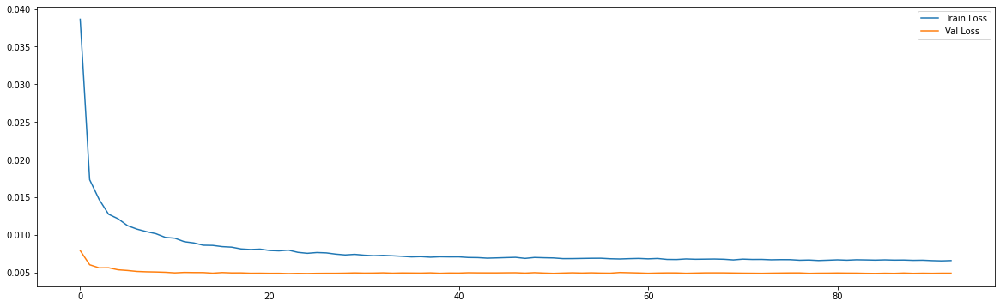

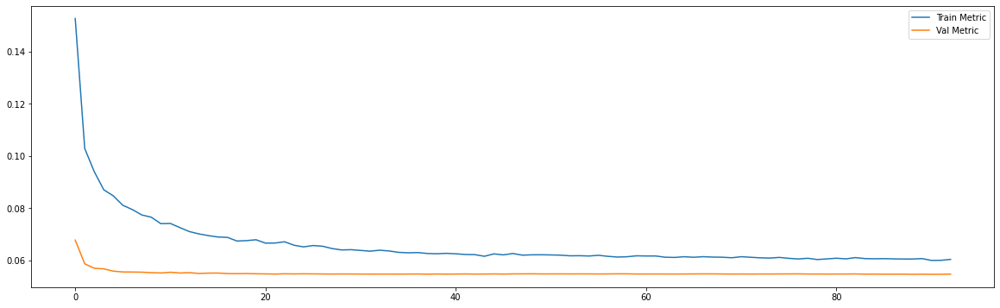

Epoch 00146: early stopping
============================model:17===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0549
loss and metric train data [0.005624590907245874, 0.05488070473074913]
10/10 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0567
loss and metric val data [0.005193779710680246, 0.0566553920507431]
10/10 [==============================] - 0s 8ms/step - loss: 0.0061 - mae: 0.0572
loss and metric test data [0.006094790995121002, 0.05721227079629898]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




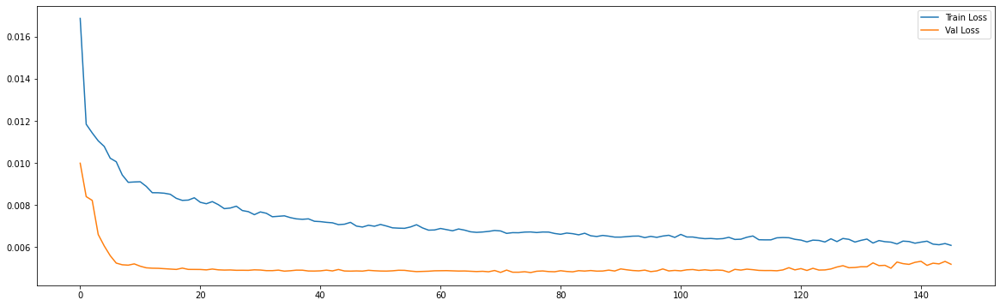

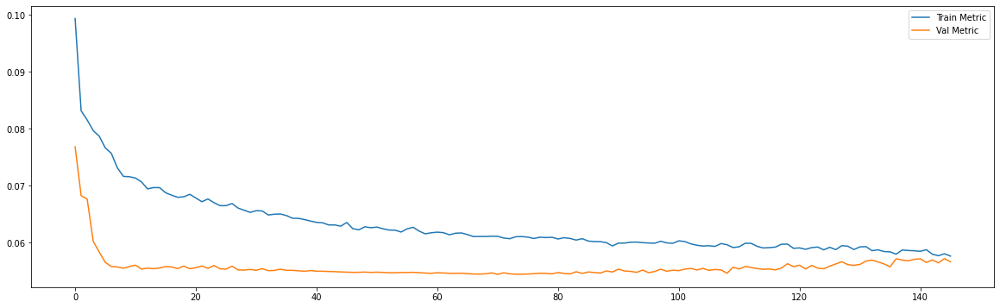

Epoch 00246: early stopping
============================model:18===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0058 - mae: 0.0554
loss and metric train data [0.00578115601092577, 0.05539105087518692]
10/10 [==============================] - 0s 5ms/step - loss: 0.0049 - mae: 0.0557
loss and metric val data [0.004910018760710955, 0.05573580041527748]
10/10 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0581
loss and metric test data [0.006205662153661251, 0.05812748521566391]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




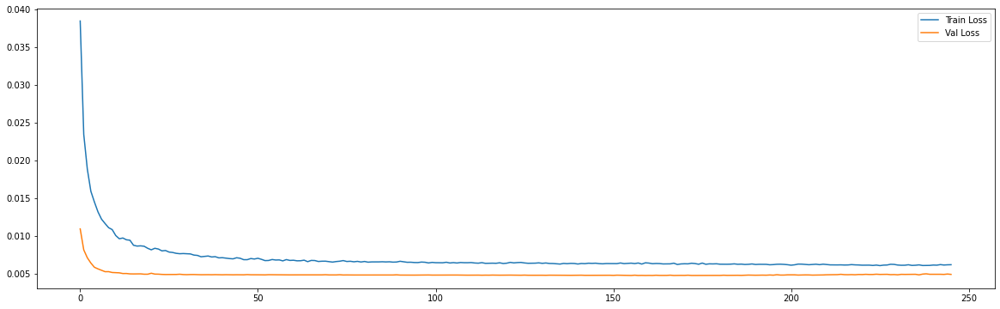

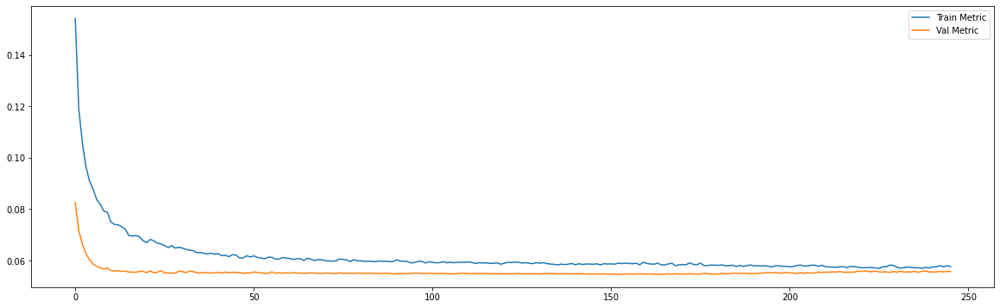

Epoch 00227: early stopping
============================model:19===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0545
loss and metric train data [0.00559015478938818, 0.05453456565737724]
10/10 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0561
loss and metric val data [0.004988942760974169, 0.05611942335963249]
10/10 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0592
loss and metric test data [0.006490177009254694, 0.05918581783771515]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




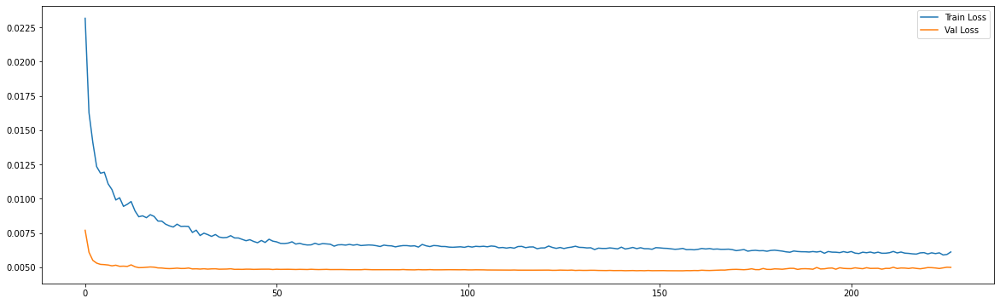

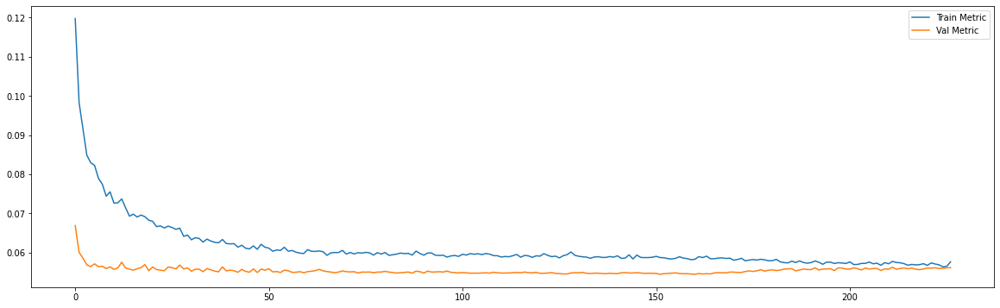

Epoch 00257: early stopping
============================model:20===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0055 - mae: 0.0555
loss and metric train data [0.005535636097192764, 0.055496346205472946]
10/10 [==============================] - 0s 8ms/step - loss: 0.0053 - mae: 0.0597
loss and metric val data [0.0052841524593532085, 0.059732481837272644]
10/10 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0586
loss and metric test data [0.006599847227334976, 0.05856753885746002]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




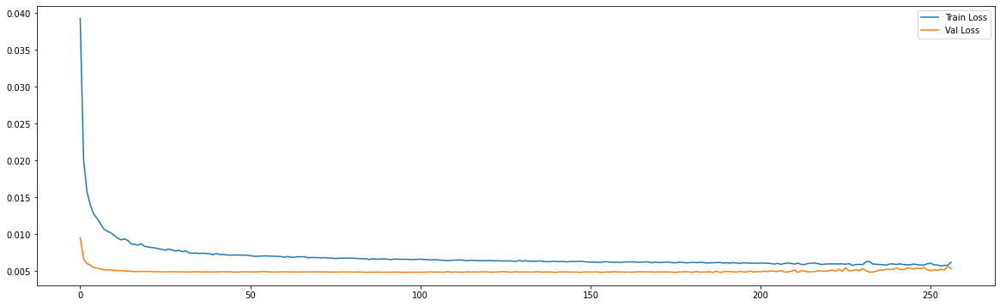

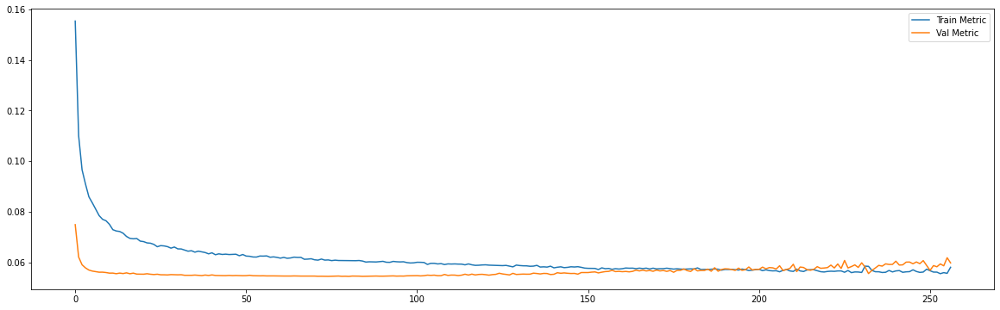

Epoch 00204: early stopping
============================model:21===========================
43/43 [==============================] - 1s 17ms/step - loss: 0.0053 - mae: 0.0539
loss and metric train data [0.005288051441311836, 0.053872715681791306]
10/10 [==============================] - 0s 15ms/step - loss: 0.0051 - mae: 0.0573
loss and metric val data [0.005062073934823275, 0.057267896831035614]
10/10 [==============================] - 0s 15ms/step - loss: 0.0069 - mae: 0.0603
loss and metric test data [0.00692801782861352, 0.06030264124274254]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




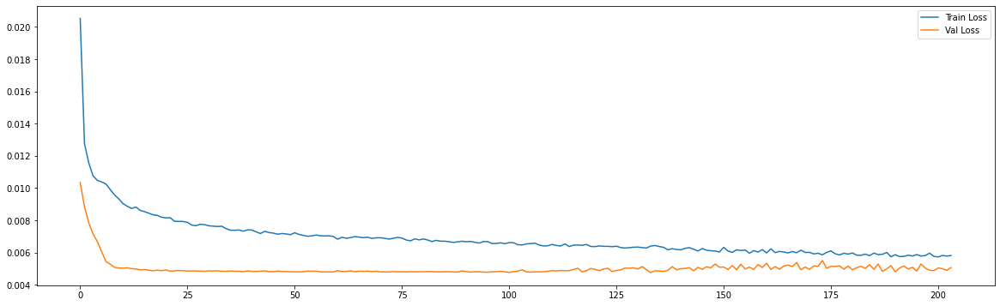

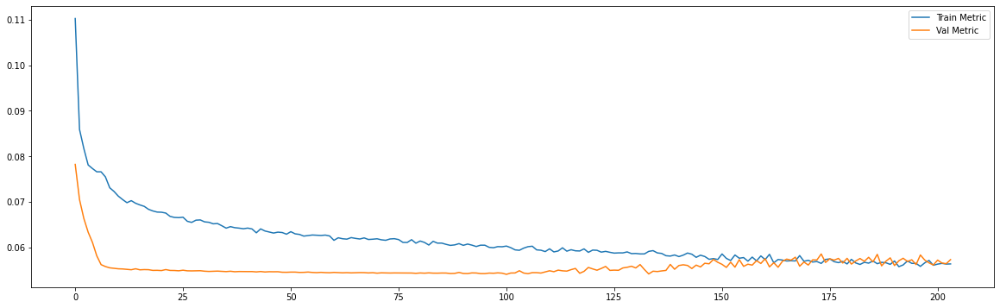

Epoch 00349: early stopping
============================model:22===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0547
loss and metric train data [0.005530208814889193, 0.0546901635825634]
10/10 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0566
loss and metric val data [0.004898548126220703, 0.0566147118806839]
10/10 [==============================] - 0s 8ms/step - loss: 0.0065 - mae: 0.0591
loss and metric test data [0.006467440631240606, 0.05909901484847069]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




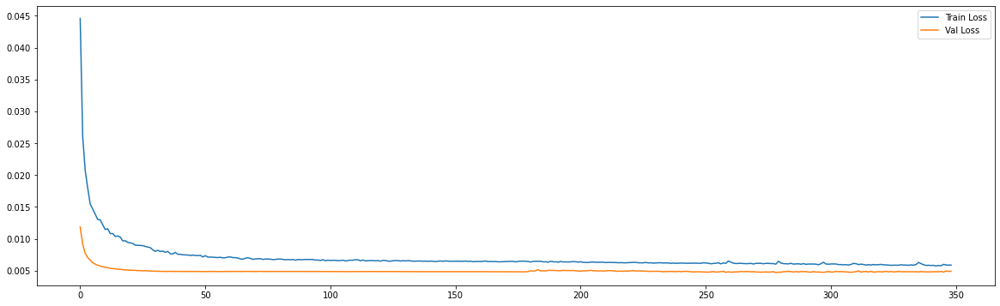

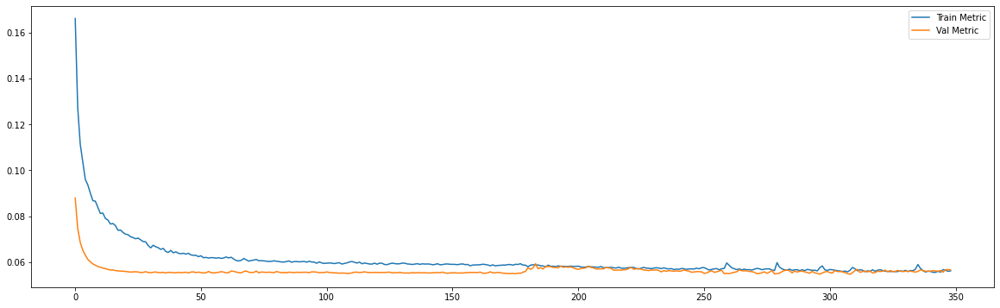

Epoch 00148: early stopping
============================model:23===========================
43/43 [==============================] - 1s 17ms/step - loss: 0.0061 - mae: 0.0574
loss and metric train data [0.006094478070735931, 0.05738028138875961]
10/10 [==============================] - 0s 15ms/step - loss: 0.0050 - mae: 0.0572
loss and metric val data [0.005036953371018171, 0.05723103880882263]
10/10 [==============================] - 0s 15ms/step - loss: 0.0063 - mae: 0.0596
loss and metric test data [0.006313017103821039, 0.05960388481616974]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




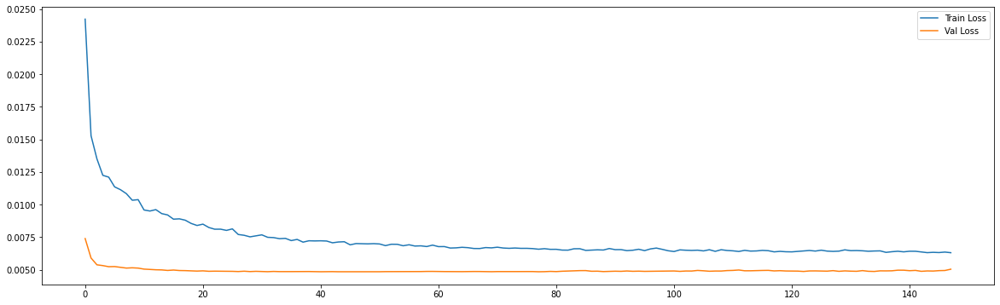

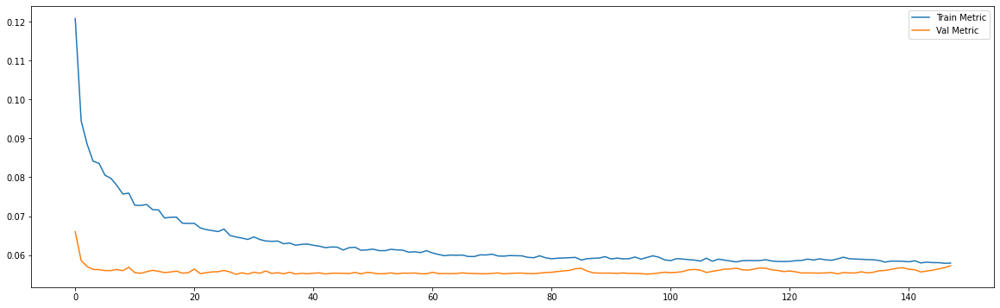

Epoch 00185: early stopping
============================model:24===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0055 - mae: 0.0551
loss and metric train data [0.005486755166202784, 0.05512925237417221]
10/10 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0561
loss and metric val data [0.0050360593013465405, 0.05608029291033745]
10/10 [==============================] - 0s 4ms/step - loss: 0.0078 - mae: 0.0611
loss and metric test data [0.007799379527568817, 0.061095695942640305]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




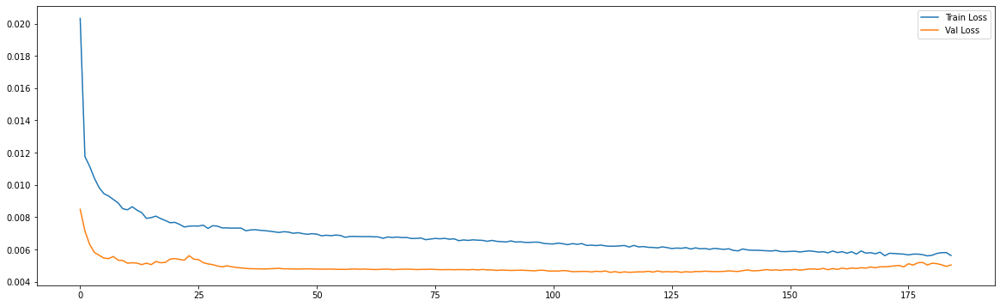

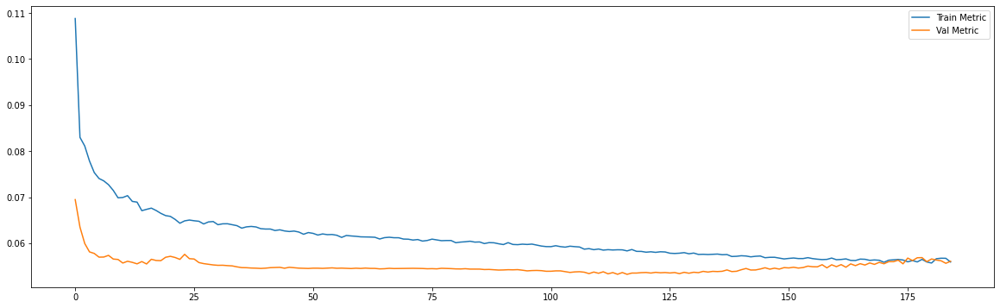

Epoch 00138: early stopping
============================model:25===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0055 - mae: 0.0554
loss and metric train data [0.005541590508073568, 0.05537248030304909]
10/10 [==============================] - 0s 6ms/step - loss: 0.0048 - mae: 0.0548
loss and metric val data [0.004826611373573542, 0.05482083559036255]
10/10 [==============================] - 0s 6ms/step - loss: 0.0071 - mae: 0.0571
loss and metric test data [0.007065902464091778, 0.05706939846277237]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




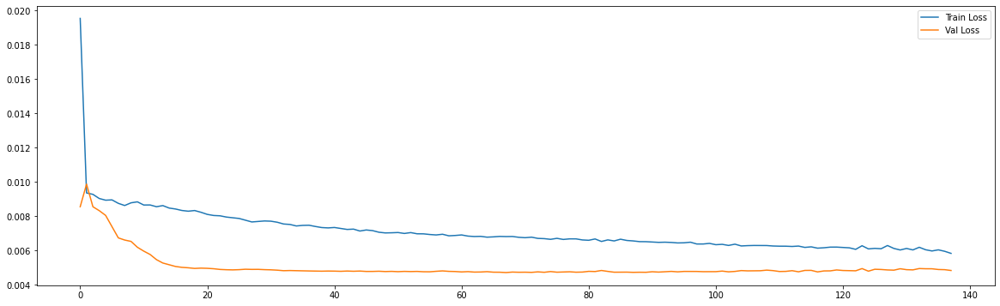

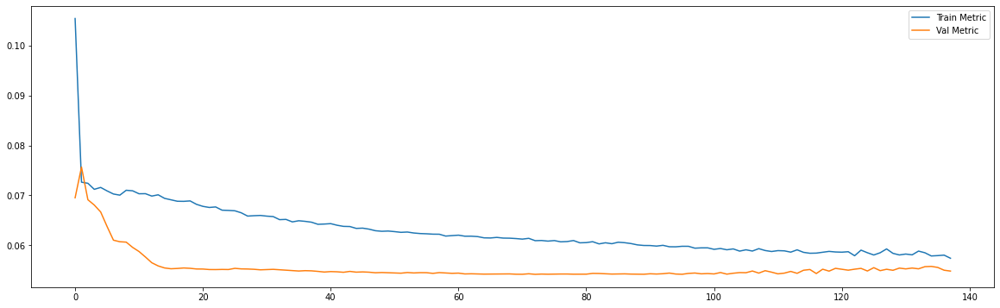

Epoch 00105: early stopping
============================model:26===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0061 - mae: 0.0573
loss and metric train data [0.0061247809790074825, 0.05728497728705406]
10/10 [==============================] - 0s 4ms/step - loss: 0.0048 - mae: 0.0549
loss and metric val data [0.004791895393282175, 0.05493844300508499]
10/10 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0583
loss and metric test data [0.006252791732549667, 0.058345045894384384]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




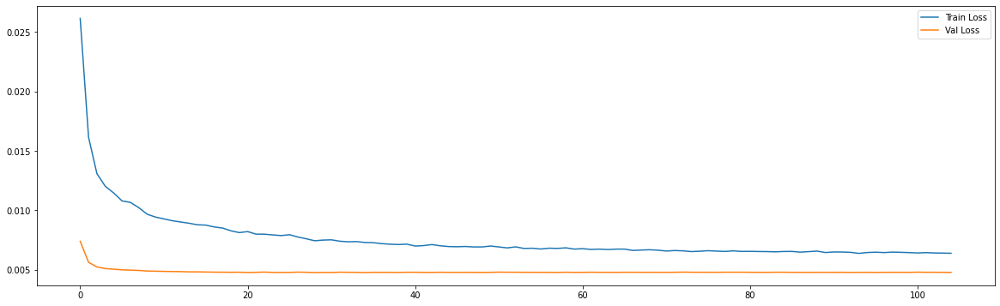

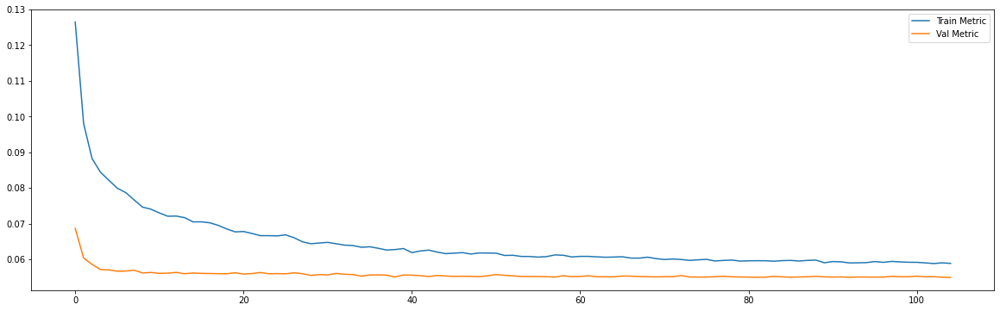

Epoch 00241: early stopping
============================model:27===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0054 - mae: 0.0549
loss and metric train data [0.00542106106877327, 0.05493827909231186]
10/10 [==============================] - 0s 6ms/step - loss: 0.0047 - mae: 0.0548
loss and metric val data [0.004732801578938961, 0.0548122264444828]
10/10 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0582
loss and metric test data [0.006328613497316837, 0.05819797143340111]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




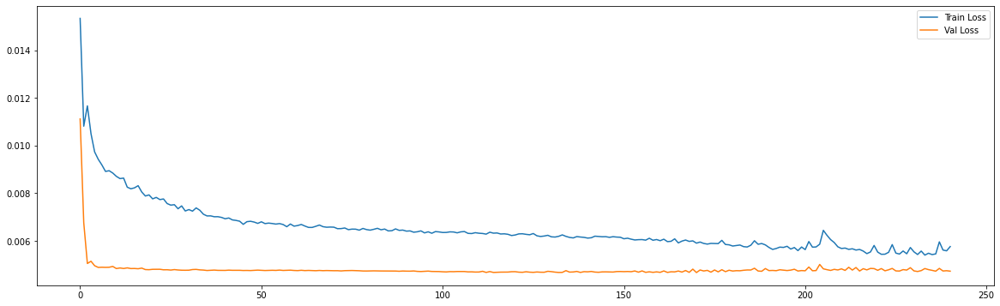

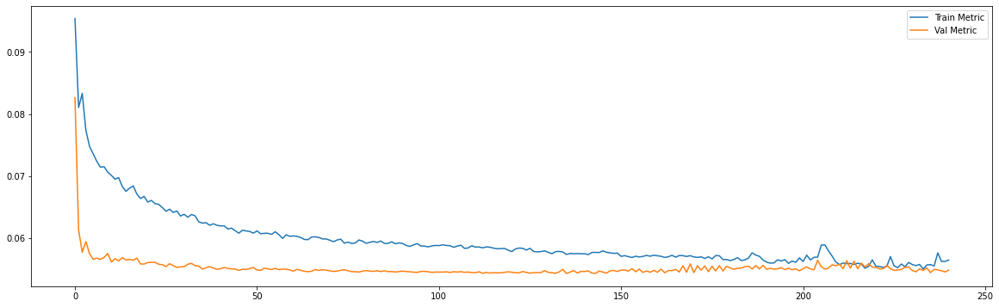

Epoch 00177: early stopping
============================model:28===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0055 - mae: 0.0551
loss and metric train data [0.005503976717591286, 0.05511008948087692]
10/10 [==============================] - 0s 5ms/step - loss: 0.0050 - mae: 0.0556
loss and metric val data [0.005005138926208019, 0.05563301220536232]
10/10 [==============================] - 0s 7ms/step - loss: 0.0072 - mae: 0.0593
loss and metric test data [0.007151584606617689, 0.05928801745176315]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




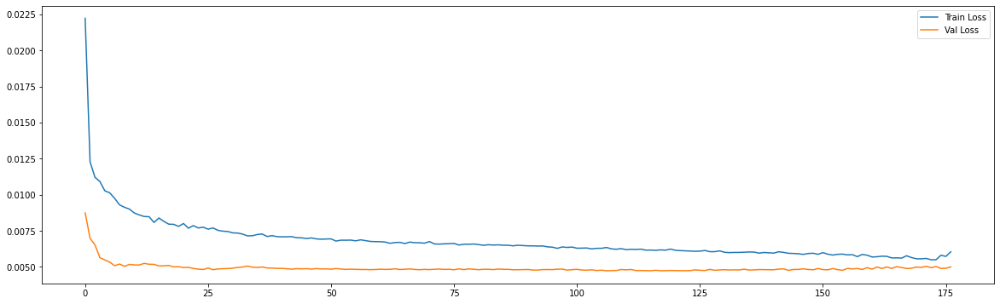

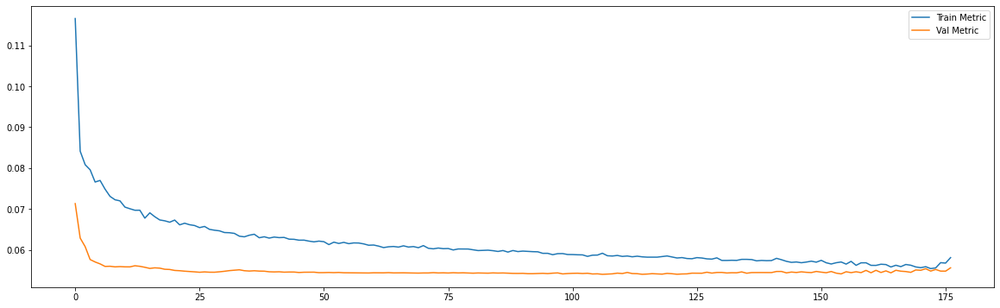

Epoch 00130: early stopping
============================model:29===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0054 - mae: 0.0540
loss and metric train data [0.0053979167714715, 0.054048288613557816]
10/10 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0570
loss and metric val data [0.005361235234886408, 0.05704287439584732]
10/10 [==============================] - 0s 9ms/step - loss: 0.0070 - mae: 0.0579
loss and metric test data [0.0069958060048520565, 0.05787423253059387]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




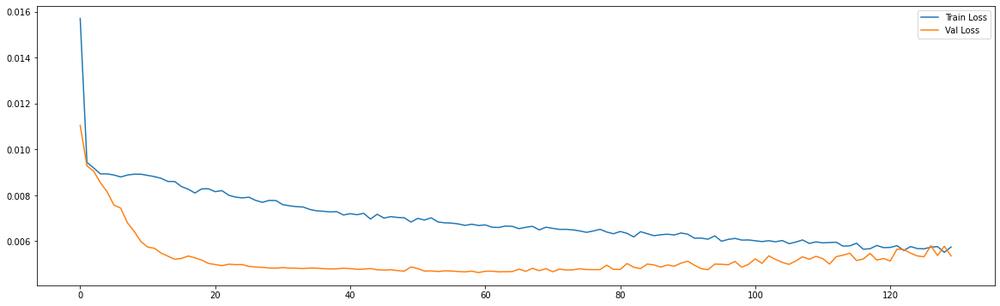

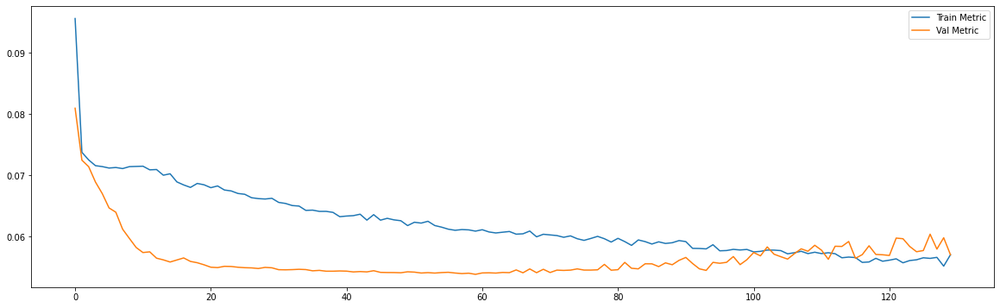

Epoch 00090: early stopping
============================model:30===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0061 - mae: 0.0568
loss and metric train data [0.0060862209647893906, 0.05677762255072594]
10/10 [==============================] - 0s 6ms/step - loss: 0.0048 - mae: 0.0545
loss and metric val data [0.004779167473316193, 0.05453859642148018]
10/10 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0579
loss and metric test data [0.006232114974409342, 0.0578959621489048]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




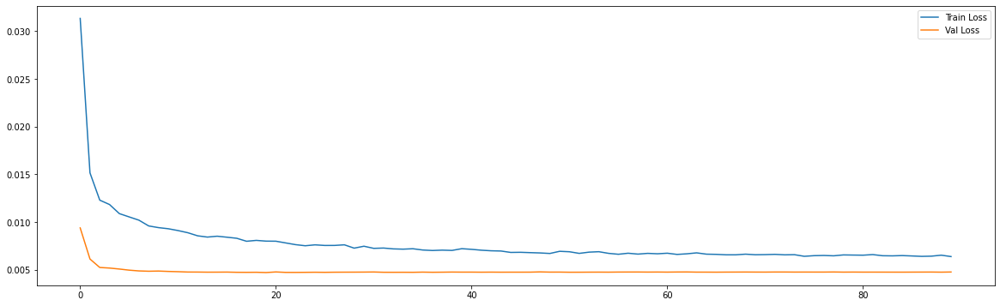

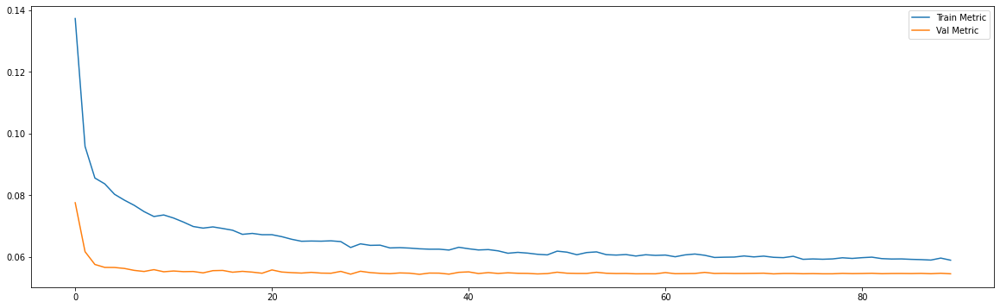

Epoch 00157: early stopping
============================model:31===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0056 - mae: 0.0548
loss and metric train data [0.005553898401558399, 0.05484330281615257]
10/10 [==============================] - 0s 10ms/step - loss: 0.0051 - mae: 0.0572
loss and metric val data [0.005059899762272835, 0.05721619725227356]
10/10 [==============================] - 0s 10ms/step - loss: 0.0064 - mae: 0.0588
loss and metric test data [0.006371794268488884, 0.05875588208436966]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




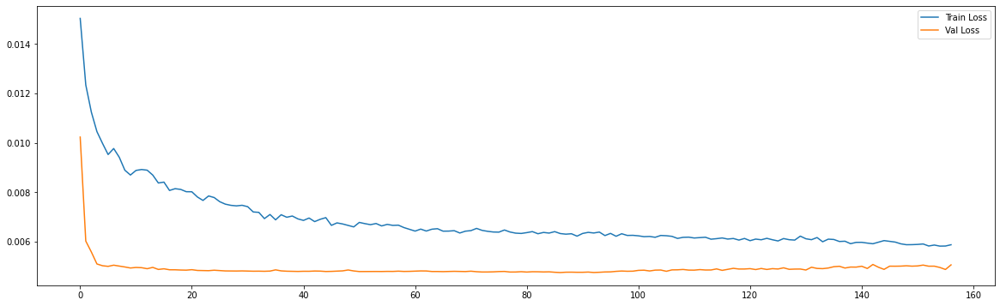

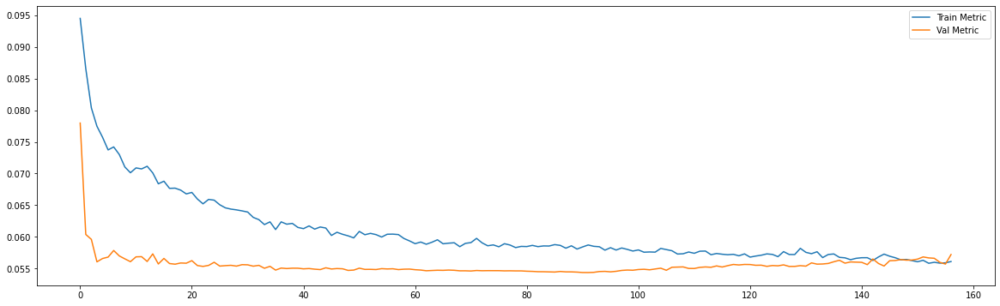

Epoch 00207: early stopping
============================model:32===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0543
loss and metric train data [0.005419187247753143, 0.054330531507730484]
10/10 [==============================] - 0s 8ms/step - loss: 0.0049 - mae: 0.0551
loss and metric val data [0.004898004699498415, 0.05509904399514198]
10/10 [==============================] - 0s 9ms/step - loss: 0.0064 - mae: 0.0583
loss and metric test data [0.006437431089580059, 0.05825772508978844]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




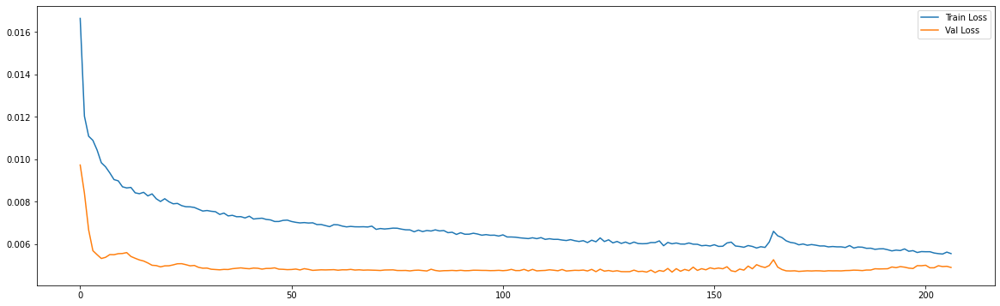

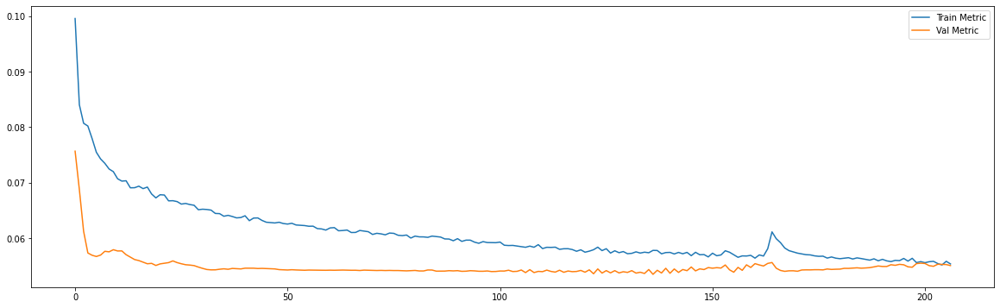

Epoch 00213: early stopping
============================model:33===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0047 - mae: 0.0520
loss and metric train data [0.004731412511318922, 0.05195504426956177]
10/10 [==============================] - 0s 17ms/step - loss: 0.0052 - mae: 0.0587
loss and metric val data [0.005219911690801382, 0.05868181958794594]
10/10 [==============================] - 0s 17ms/step - loss: 0.0066 - mae: 0.0577
loss and metric test data [0.006629543844610453, 0.057723868638277054]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




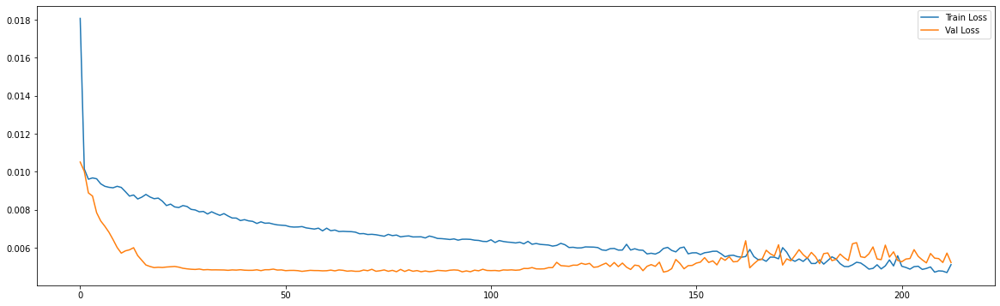

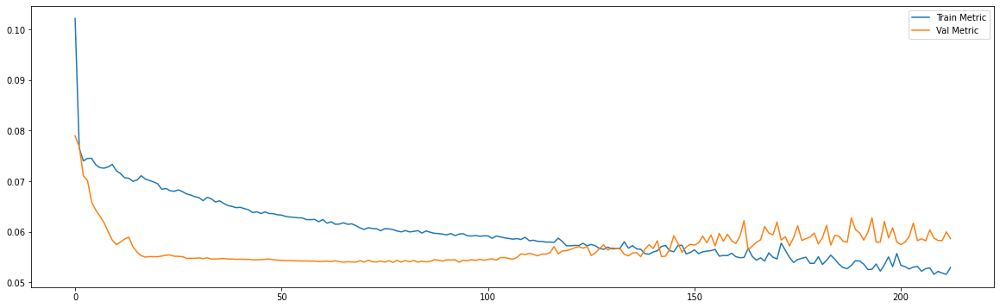

Epoch 00098: early stopping
============================model:34===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0061 - mae: 0.0565
loss and metric train data [0.006057375110685825, 0.056492481380701065]
10/10 [==============================] - 0s 9ms/step - loss: 0.0048 - mae: 0.0550
loss and metric val data [0.004812512081116438, 0.05499335005879402]
10/10 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0585
loss and metric test data [0.006241879891604185, 0.05846017599105835]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




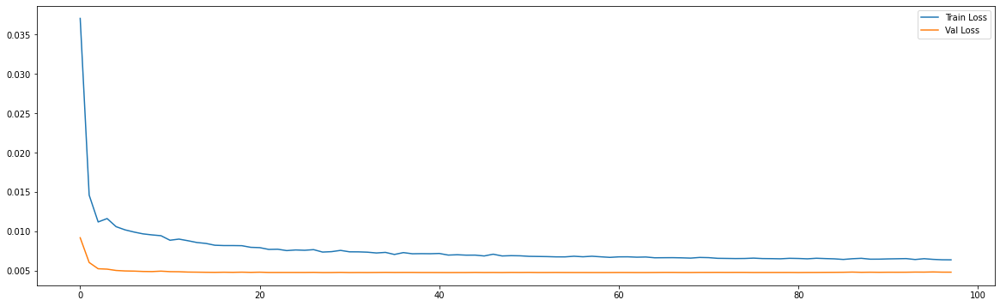

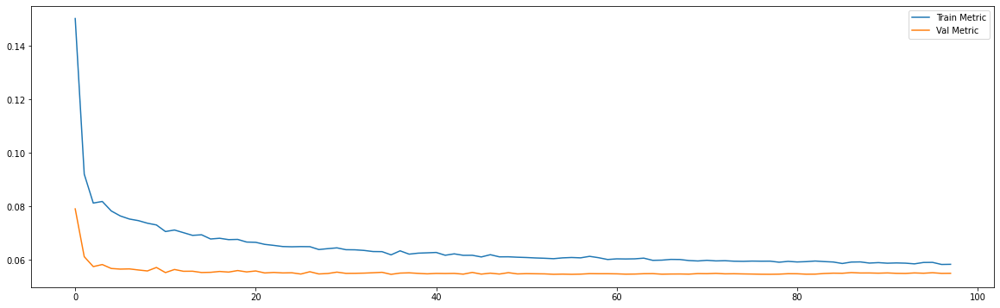

Epoch 00147: early stopping
============================model:35===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0057 - mae: 0.0551
loss and metric train data [0.005748041905462742, 0.05511033907532692]
10/10 [==============================] - 0s 16ms/step - loss: 0.0050 - mae: 0.0566
loss and metric val data [0.00497217383235693, 0.05655888468027115]
10/10 [==============================] - 0s 17ms/step - loss: 0.0062 - mae: 0.0584
loss and metric test data [0.006249628029763699, 0.05838698893785477]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




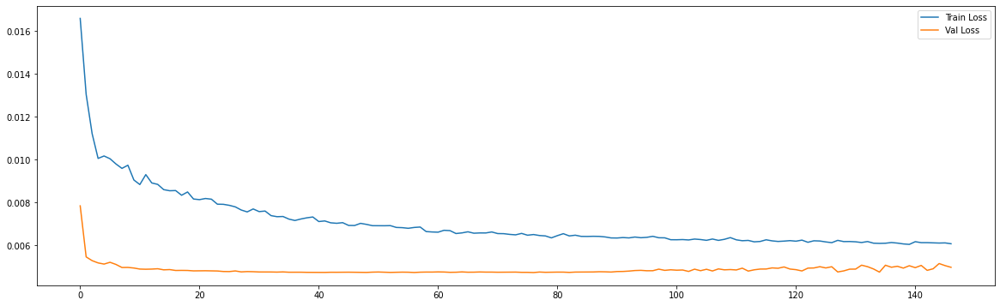

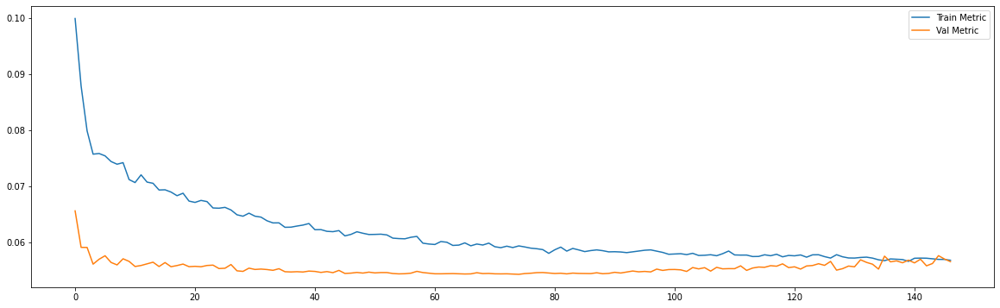

Epoch 00200: early stopping
============================model:36===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0055 - mae: 0.0554
loss and metric train data [0.005458085332065821, 0.055366355925798416]
10/10 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0572
loss and metric val data [0.005214979872107506, 0.05723447725176811]
10/10 [==============================] - 0s 4ms/step - loss: 0.0071 - mae: 0.0611
loss and metric test data [0.007109249476343393, 0.061091188341379166]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




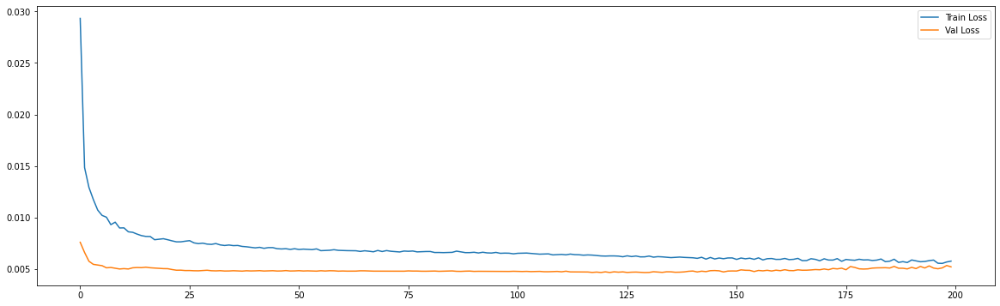

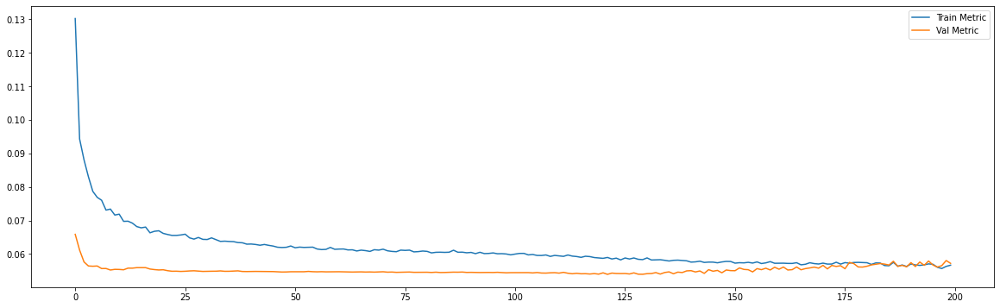

Epoch 00155: early stopping
============================model:37===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0056 - mae: 0.0556
loss and metric train data [0.0055790734477341175, 0.055564288049936295]
10/10 [==============================] - 0s 6ms/step - loss: 0.0051 - mae: 0.0559
loss and metric val data [0.0051419660449028015, 0.05585706606507301]
10/10 [==============================] - 0s 6ms/step - loss: 0.0095 - mae: 0.0623
loss and metric test data [0.009491975419223309, 0.06232384964823723]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




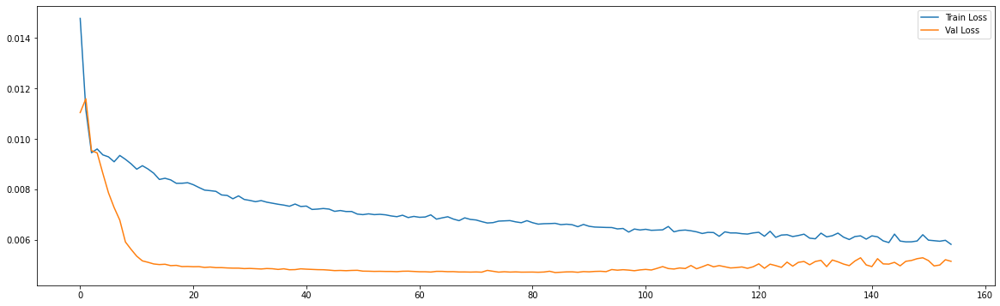

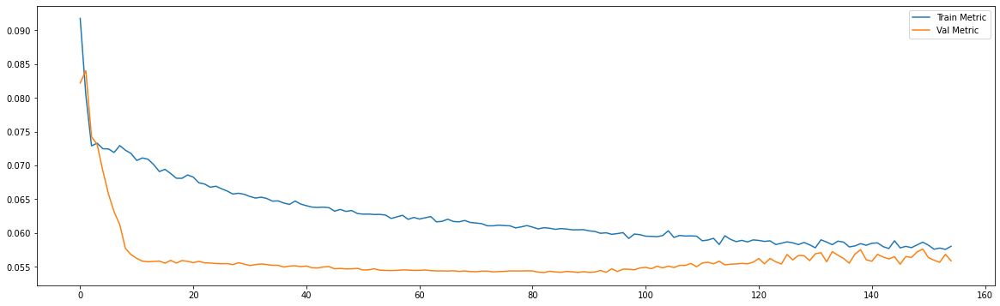

Epoch 00097: early stopping
============================model:38===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0061 - mae: 0.0574
loss and metric train data [0.006127581000328064, 0.05736194923520088]
10/10 [==============================] - 0s 4ms/step - loss: 0.0048 - mae: 0.0550
loss and metric val data [0.004783788230270147, 0.05496664717793465]
10/10 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0584
loss and metric test data [0.006239395588636398, 0.05841320753097534]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




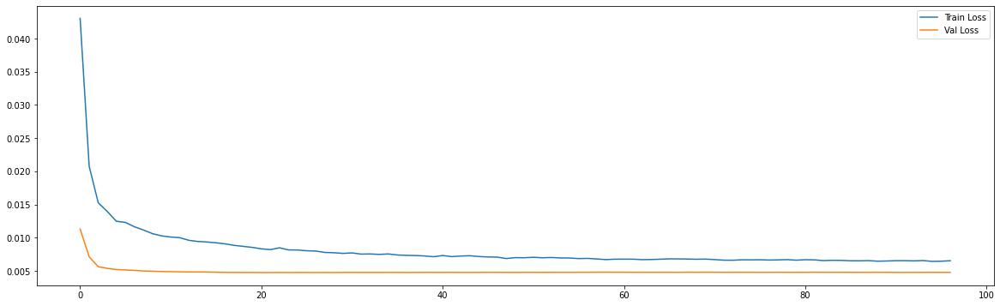

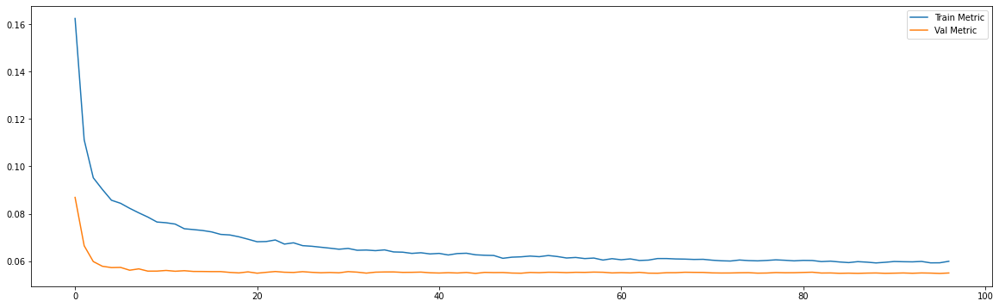

Epoch 00218: early stopping
============================model:39===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0054 - mae: 0.0551
loss and metric train data [0.005440716166049242, 0.0550946407020092]
10/10 [==============================] - 0s 7ms/step - loss: 0.0049 - mae: 0.0559
loss and metric val data [0.004913936834782362, 0.055937446653842926]
10/10 [==============================] - 0s 7ms/step - loss: 0.0065 - mae: 0.0572
loss and metric test data [0.0065114726312458515, 0.05715825781226158]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




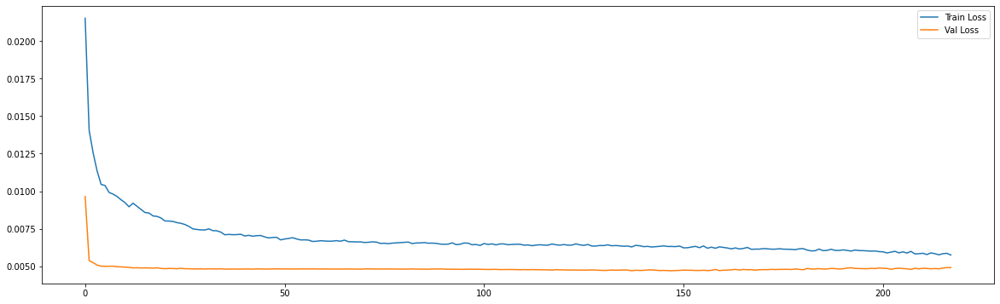

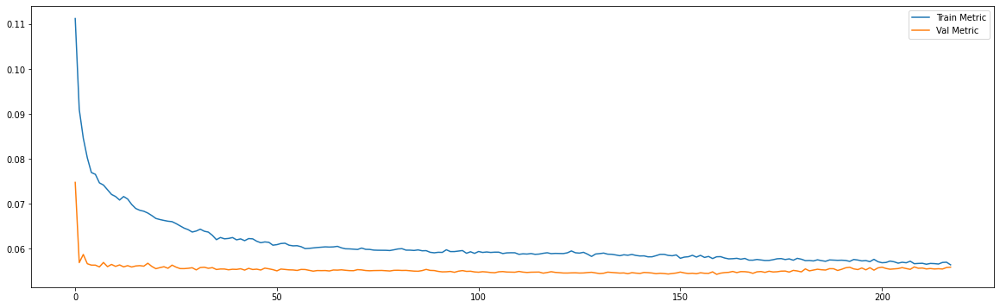

Epoch 00114: early stopping
============================model:40===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0059 - mae: 0.0555
loss and metric train data [0.0058664982207119465, 0.05552244931459427]
10/10 [==============================] - 0s 6ms/step - loss: 0.0049 - mae: 0.0548
loss and metric val data [0.004862800240516663, 0.05475018545985222]
10/10 [==============================] - 0s 5ms/step - loss: 0.0060 - mae: 0.0567
loss and metric test data [0.006015041843056679, 0.05673080310225487]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




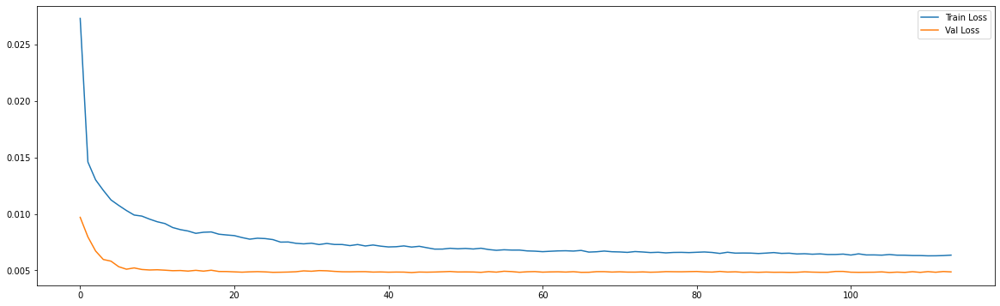

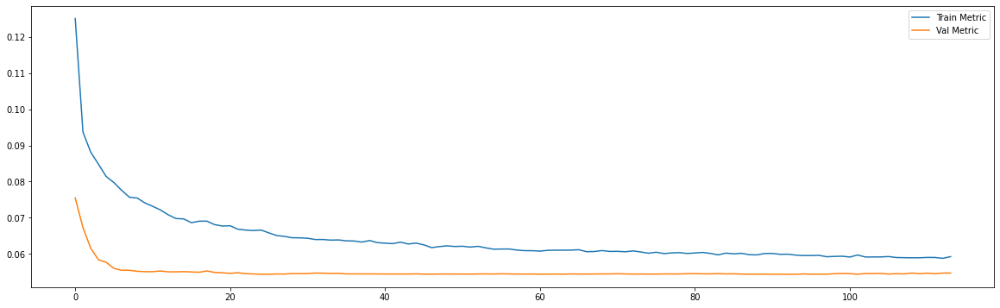

Epoch 00157: early stopping
============================model:41===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0055 - mae: 0.0549
loss and metric train data [0.00552827725186944, 0.054929036647081375]
10/10 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0562
loss and metric val data [0.005032435990869999, 0.05619676411151886]
10/10 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0585
loss and metric test data [0.00647231237962842, 0.058505214750766754]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




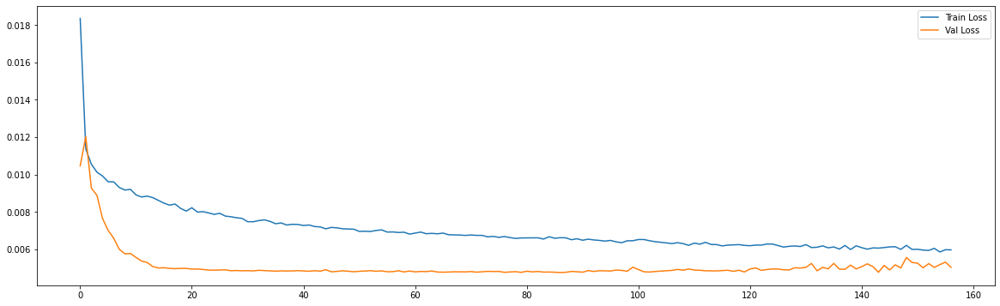

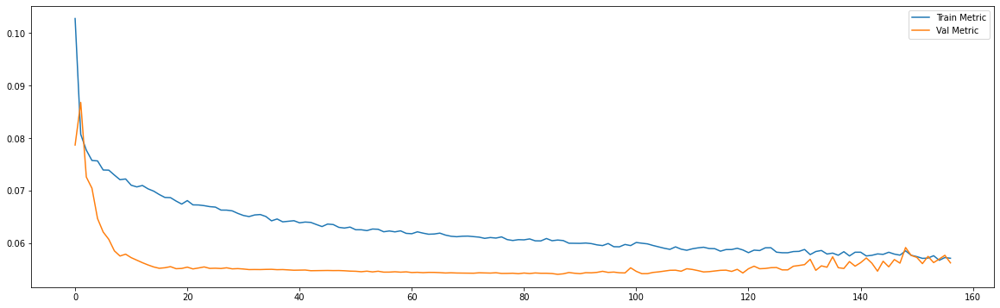

Epoch 00196: early stopping
============================model:42===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0058 - mae: 0.0554
loss and metric train data [0.005814784672111273, 0.05538111925125122]
10/10 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0553
loss and metric val data [0.0048384531401097775, 0.05527684465050697]
10/10 [==============================] - 0s 5ms/step - loss: 0.0061 - mae: 0.0575
loss and metric test data [0.006077675148844719, 0.057508841156959534]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




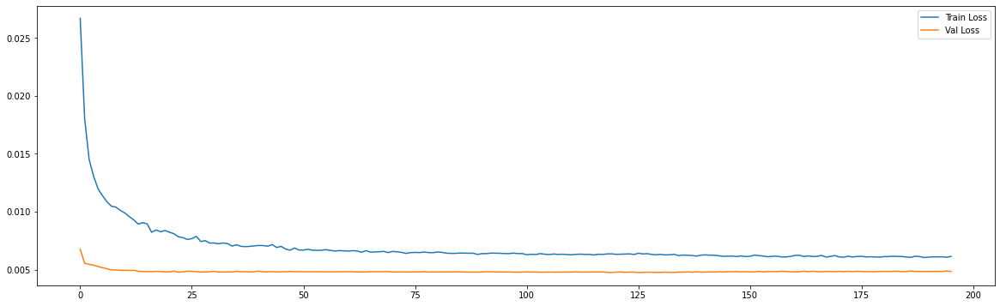

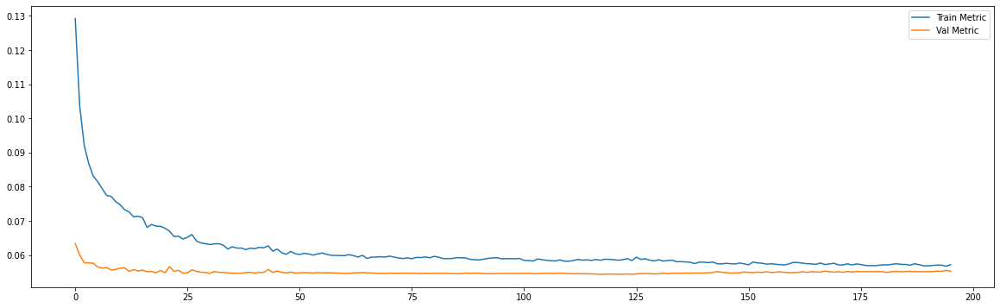

Epoch 00161: early stopping
============================model:43===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0057 - mae: 0.0554
loss and metric train data [0.005744281690567732, 0.055424246937036514]
10/10 [==============================] - 0s 9ms/step - loss: 0.0050 - mae: 0.0561
loss and metric val data [0.004961647093296051, 0.05612849444150925]
10/10 [==============================] - 0s 9ms/step - loss: 0.0065 - mae: 0.0595
loss and metric test data [0.006518286652863026, 0.05946551263332367]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




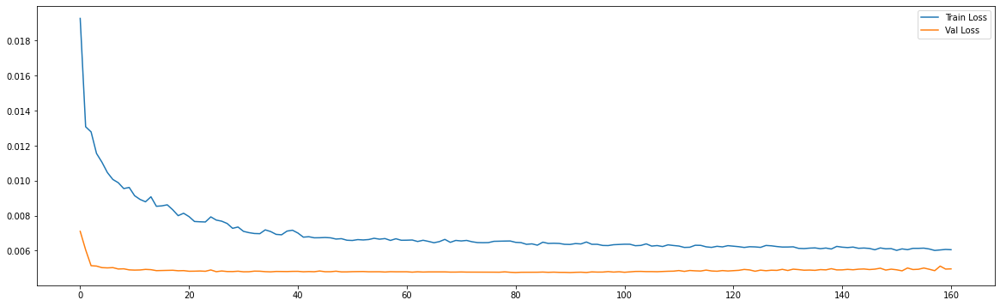

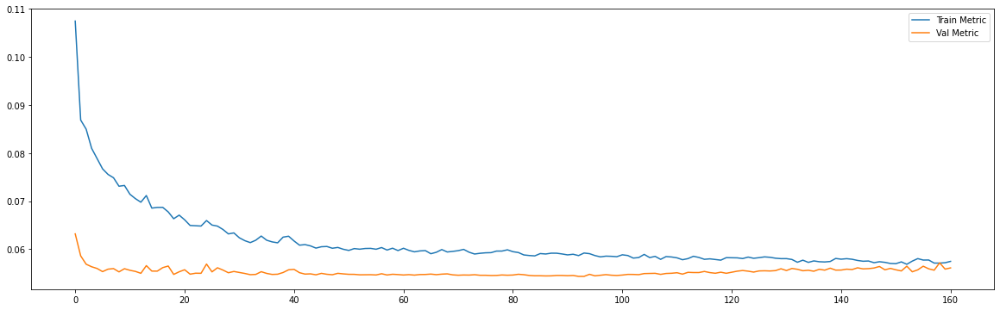

Epoch 00215: early stopping
============================model:44===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0534
loss and metric train data [0.0052232397720217705, 0.05338166281580925]
10/10 [==============================] - 0s 9ms/step - loss: 0.0051 - mae: 0.0562
loss and metric val data [0.0050600082613527775, 0.0562300980091095]
10/10 [==============================] - 0s 9ms/step - loss: 0.0064 - mae: 0.0573
loss and metric test data [0.0064202784560620785, 0.057327933609485626]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




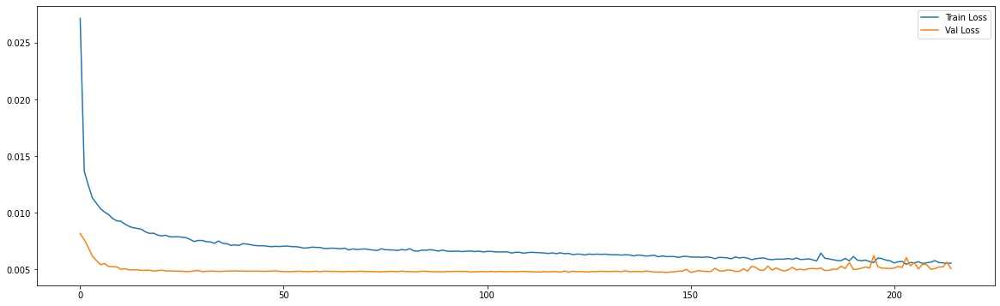

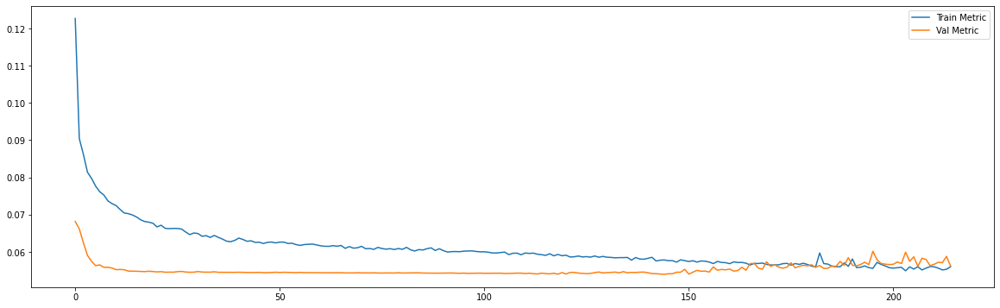

Epoch 00143: early stopping
============================model:45===========================
43/43 [==============================] - 1s 17ms/step - loss: 0.0057 - mae: 0.0556
loss and metric train data [0.005719559732824564, 0.055586762726306915]
10/10 [==============================] - 0s 17ms/step - loss: 0.0050 - mae: 0.0557
loss and metric val data [0.004995596595108509, 0.055701542645692825]
10/10 [==============================] - 0s 16ms/step - loss: 0.0061 - mae: 0.0574
loss and metric test data [0.006068018730729818, 0.05737818777561188]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




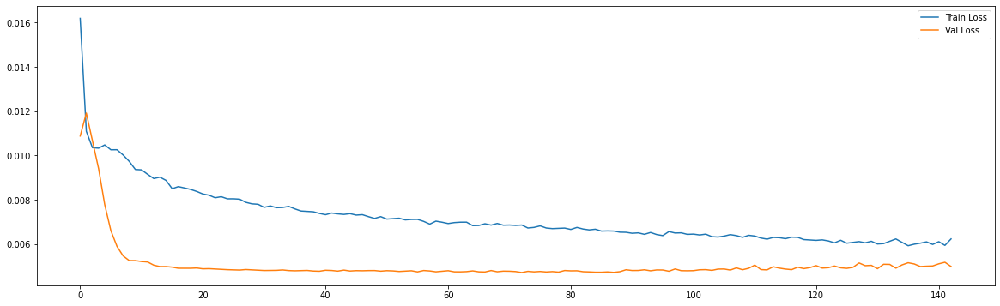

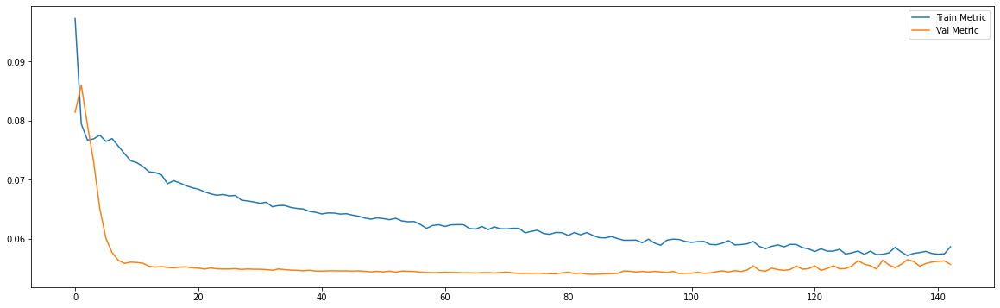

Epoch 00097: early stopping
============================model:46===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0570
loss and metric train data [0.006167173385620117, 0.056957460939884186]
10/10 [==============================] - 0s 8ms/step - loss: 0.0048 - mae: 0.0549
loss and metric val data [0.004817524924874306, 0.054922789335250854]
10/10 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0584
loss and metric test data [0.006326755043119192, 0.05843552574515343]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




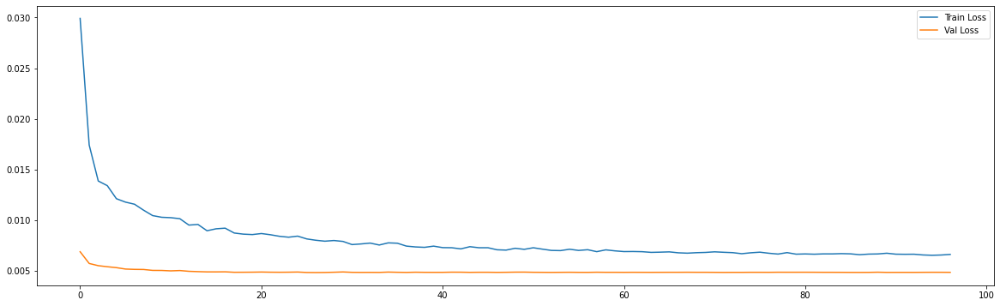

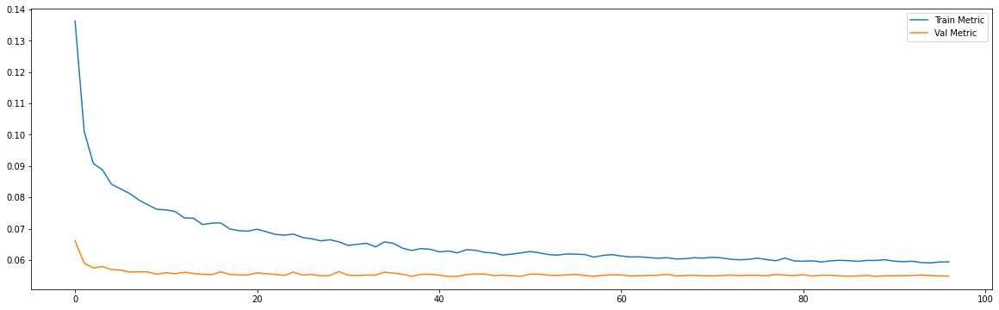

Epoch 00145: early stopping
============================model:47===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0060 - mae: 0.0565
loss and metric train data [0.005965581163764, 0.056452587246894836]
10/10 [==============================] - 0s 17ms/step - loss: 0.0050 - mae: 0.0565
loss and metric val data [0.004950712900608778, 0.056514378637075424]
10/10 [==============================] - 0s 16ms/step - loss: 0.0064 - mae: 0.0593
loss and metric test data [0.006362972781062126, 0.0592922642827034]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




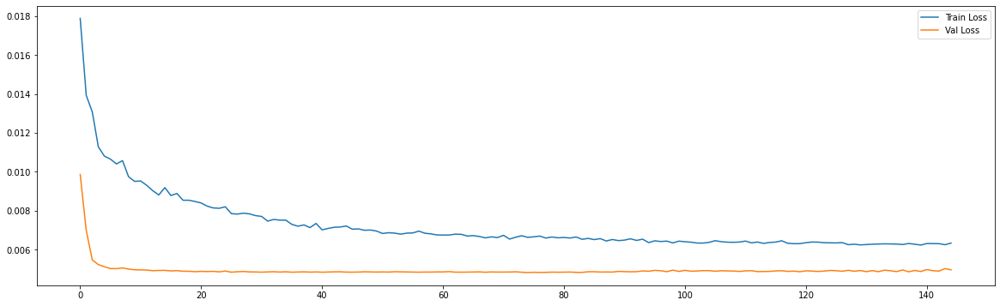

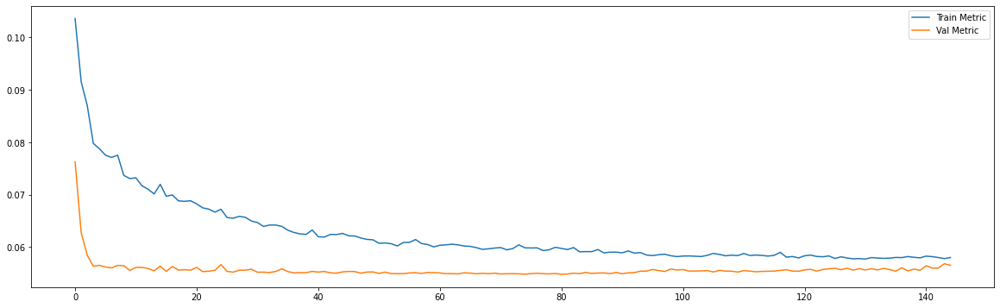

In [34]:
future_steps = 5
n_features = df_train.shape[1]

neurons_list = [30,50]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120]
batch_size_list = [32,64]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for batch_size in batch_size_list:
        for lr in lr_list:
          x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch_size, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch_size,lr,1)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=future_steps))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          # early stop
          es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = batch_size, verbose = 0, shuffle = False, callbacks = [es])

          print('============================model:{}==========================='.format(i))

            
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          i+=1


          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch_size, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch_size,lr,2)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False))
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=future_steps))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          # early stop
          es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = batch_size, verbose = 0, shuffle = False, callbacks = [es])

          print('============================model:{}==========================='.format(i))

            
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          i+=1

### Best Model Resume

`Validation metric as evaluation parameter`

Epoch 00101: early stopping

============================model:4===========================

45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0567

loss and metric train data [0.006173199974000454, 0.05671592429280281]

10/10 [==============================] - 0s 5ms/step - loss: 0.0049 - mae: 0.0545

loss and metric val data [0.0048582484014332294, 0.054481495171785355]

10/10 [==============================] - 0s 5ms/step - loss: 0.0063 - mae: 0.0577

loss and metric test data [0.006320123560726643, 0.05767262354493141]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1





In [35]:
models[4]

{'batch_size': 32,
 'dropout': 0.2,
 'learning_rate': 0.001,
 'model': <tensorflow.python.keras.engine.sequential.Sequential at 0x7f1dff4edef0>,
 'neurons': 30,
 'resumo': "'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1",
 'time_steps': 60}

Saving the Model

In [36]:
models[4]['model'].save("/content/drive/My Drive/ML Projects/Pharma Sales/LSTM_multiFeature_weekdayMonth_cyclical.h5")

Ploting the model prediction

In [37]:
future_steps = 5
n_features = df_train.shape[1]
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = 60,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

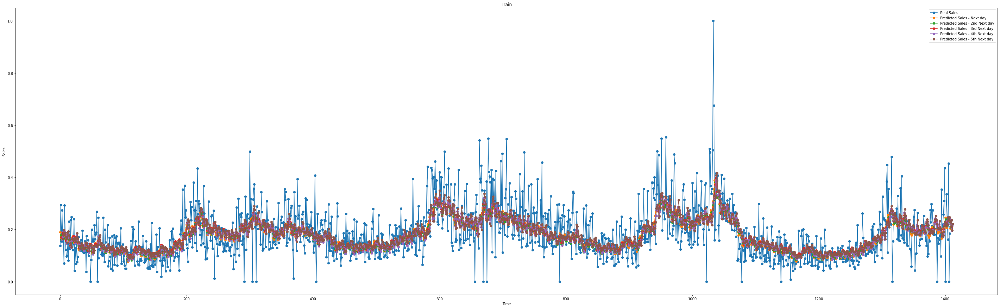

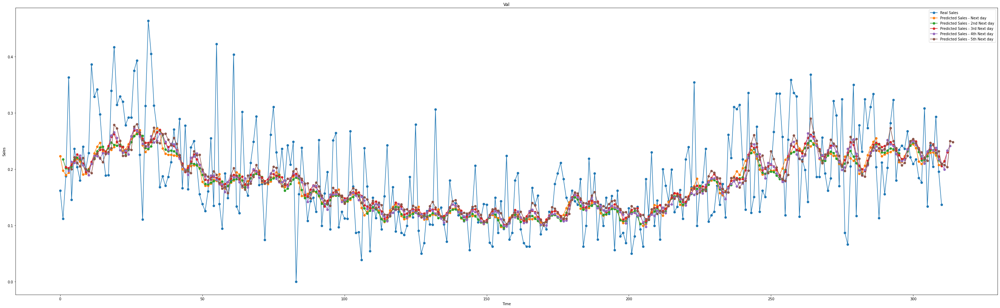

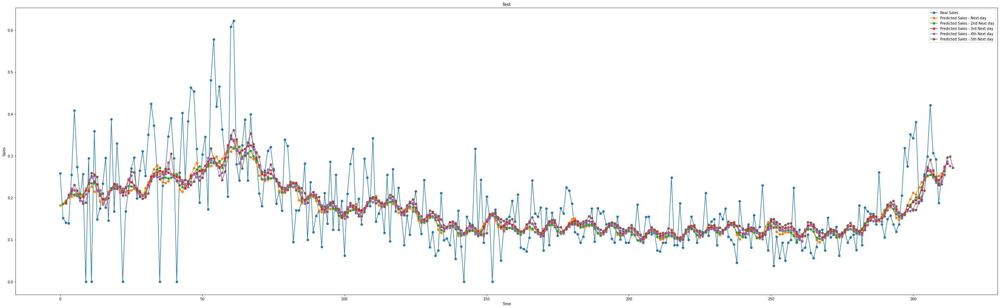

In [38]:
y_train_predict = models[4]['model'].predict(x_train)
y_val_predict = models[4]['model'].predict(x_val)
y_test_predict = models[4]['model'].predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

## LSTM

With the most relevant features

Making a filter based on the average importance.

In [39]:
df_daily.corr().iloc[:-1,-1][df_daily.corr().iloc[:-1,-1].abs() > df_daily.corr().iloc[:-1,-1].abs().mean()]

month_cos           0.421372
lag1                0.440795
lag2                0.396495
lag3                0.369587
lag4                0.376088
lag5                0.399644
lag6                0.438007
lag7                0.473197
rolling_mean_2      0.848795
rolling_mean_3      0.779523
rolling_mean_4      0.736699
rolling_mean_5      0.712445
rolling_mean_6      0.701197
rolling_mean_7      0.700098
rolling_mean_30     0.587698
rolling_mean_60     0.475406
rolling_mean_120    0.340235
Name: N02BE, dtype: float64

In [42]:
df_daily_aux = df_daily[['lag1','rolling_mean_2','rolling_mean_3','N02BE']]
df_daily_aux.fillna(0,inplace = True)
df_daily_aux

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4153: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  downcast=downcast,


,lag1,rolling_mean_2,rolling_mean_3,N02BE
0,0.00,0.000,0.000000,32.40
1,32.40,41.500,0.000000,50.60
2,50.60,56.225,48.283333,61.85
3,61.85,51.475,51.183333,41.10
4,41.10,31.400,41.550000,21.70
...,...,...,...,...
2101,40.40,31.425,31.016667,22.45
2102,22.45,23.925,29.416667,25.40
2103,25.40,30.000,27.483333,34.60
2104,34.60,42.700,36.933333,50.80


In [44]:
df_train,df_val,df_test = dataSplit(df = df_daily_aux,train_percent = 0.7,val_percent = 0.15)

df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange = (0,1))

(1474, 4)
(316, 4)
(316, 4)
[1. 1. 1. 1.]
[0. 0. 0. 0.]


[0.46335404 0.51821283 0.54192647 0.46335404]
[0.         0.07067853 0.08834426 0.        ]


[0.62173913 0.73377827 0.69222001 0.62173913]
[0.         0.05005562 0.09119407 0.        ]
-------------------------
(1474, 4)
(316, 4)
(316, 4)


Epoch 00285: early stopping
============================model:0===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0563
loss and metric train data [0.005763988941907883, 0.05628645047545433]
10/10 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0561
loss and metric val data [0.004933264572173357, 0.056063733994960785]
10/10 [==============================] - 0s 4ms/step - loss: 0.0064 - mae: 0.0592
loss and metric test data [0.006364134140312672, 0.059203021228313446]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




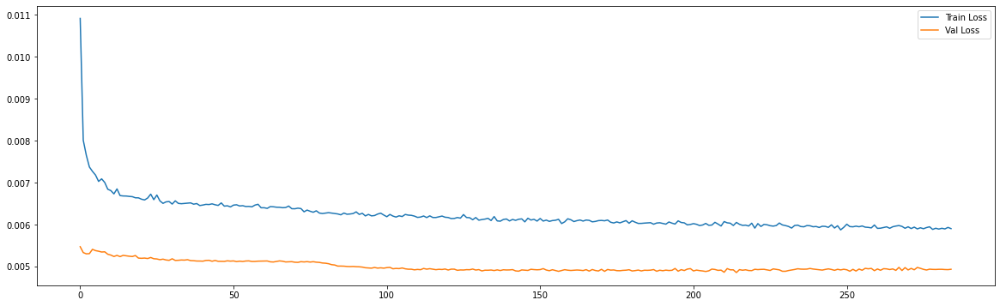

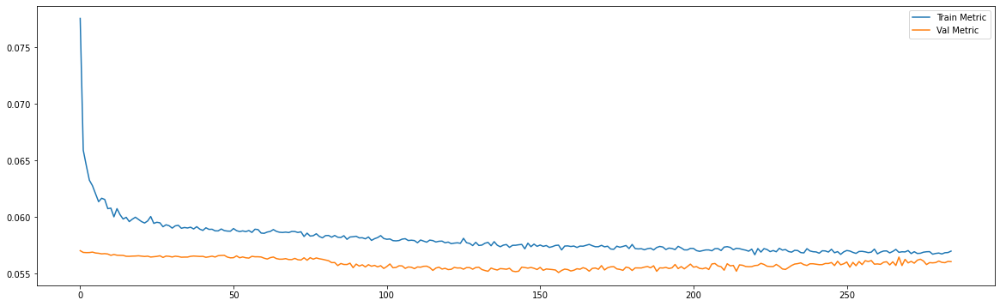

Epoch 00185: early stopping
============================model:1===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0057 - mae: 0.0560
loss and metric train data [0.0056915972381830215, 0.055980850011110306]
10/10 [==============================] - 0s 6ms/step - loss: 0.0050 - mae: 0.0558
loss and metric val data [0.005010639317333698, 0.055834319442510605]
10/10 [==============================] - 0s 5ms/step - loss: 0.0065 - mae: 0.0584
loss and metric test data [0.006543180905282497, 0.05837477371096611]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




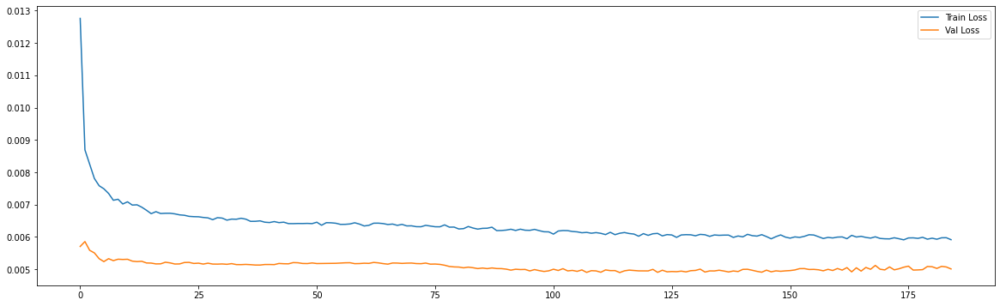

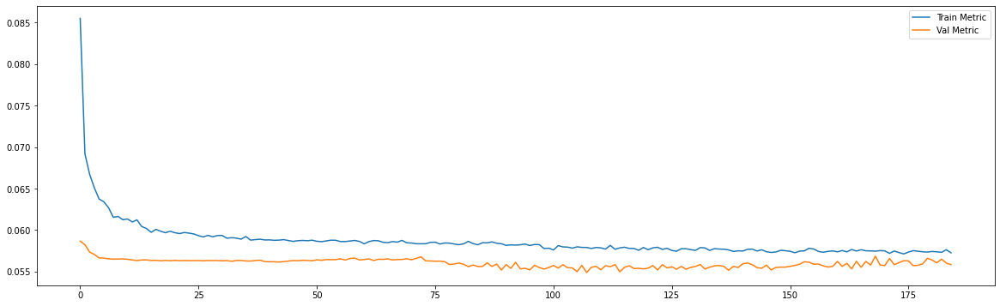

Epoch 00116: early stopping
============================model:2===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0586
loss and metric train data [0.006338563747704029, 0.05858398228883743]
10/10 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0579
loss and metric val data [0.005173063836991787, 0.05792904645204544]
10/10 [==============================] - 0s 3ms/step - loss: 0.0066 - mae: 0.0604
loss and metric test data [0.006592524237930775, 0.060389626771211624]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




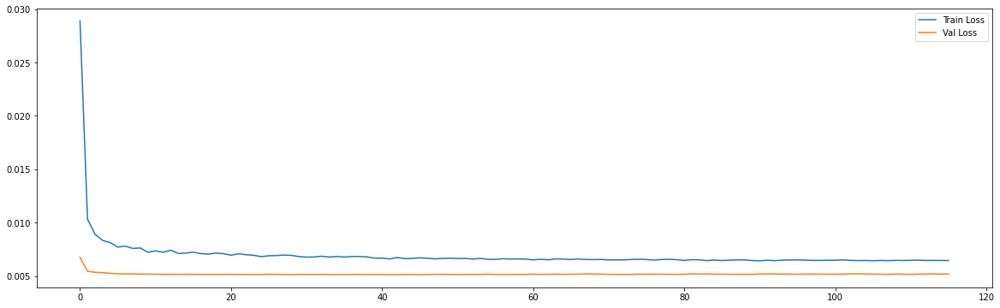

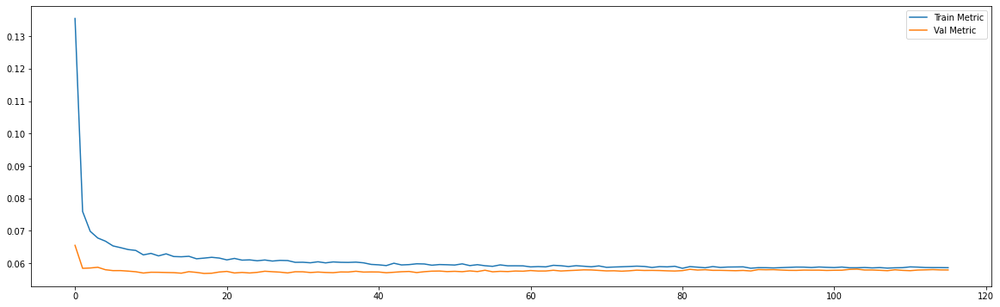

Epoch 00103: early stopping
============================model:3===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0584
loss and metric train data [0.0062843989580869675, 0.05837742239236832]
10/10 [==============================] - 0s 6ms/step - loss: 0.0052 - mae: 0.0581
loss and metric val data [0.005227234214544296, 0.058082666248083115]
10/10 [==============================] - 0s 6ms/step - loss: 0.0066 - mae: 0.0608
loss and metric test data [0.006645937915891409, 0.06081211194396019]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




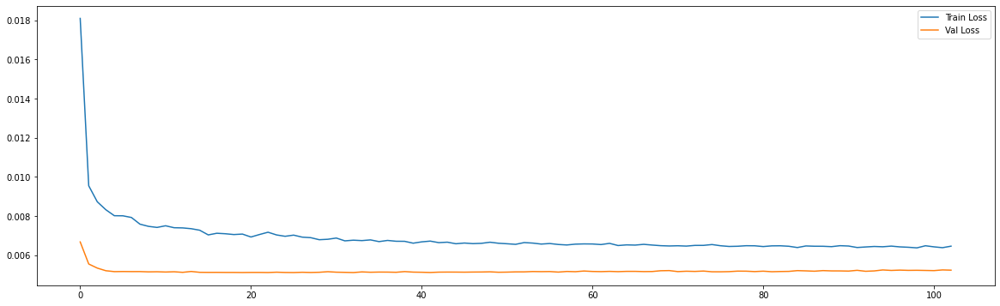

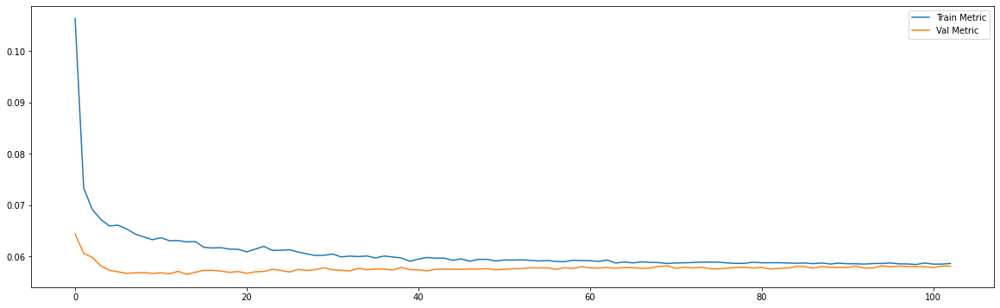

Epoch 00097: early stopping
============================model:4===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0569
loss and metric train data [0.0062004500068724155, 0.05689413473010063]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0565
loss and metric val data [0.005206814035773277, 0.056505173444747925]
10/10 [==============================] - 0s 5ms/step - loss: 0.0067 - mae: 0.0602
loss and metric test data [0.006724590435624123, 0.06024552136659622]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




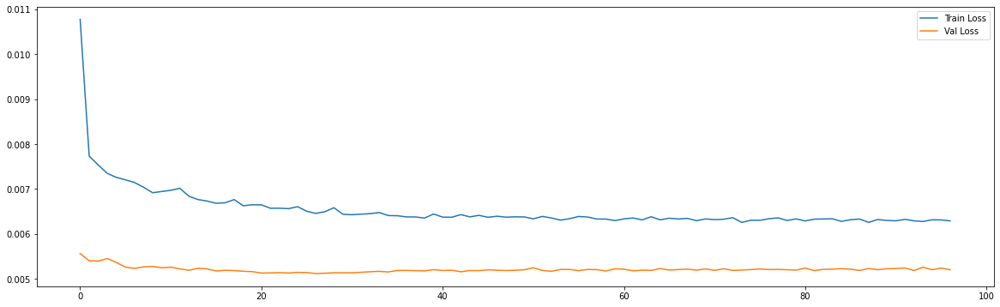

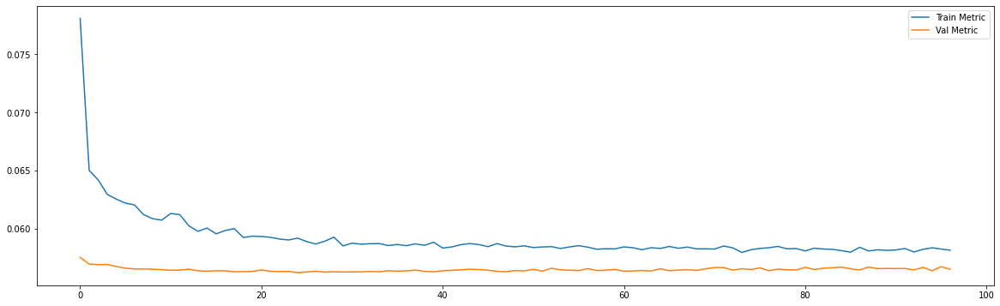

Epoch 00195: early stopping
============================model:5===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0055 - mae: 0.0553
loss and metric train data [0.005502040963619947, 0.05533459782600403]
10/10 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0575
loss and metric val data [0.005434357561171055, 0.05750062316656113]
10/10 [==============================] - 0s 8ms/step - loss: 0.0084 - mae: 0.0639
loss and metric test data [0.008437258191406727, 0.06388187408447266]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




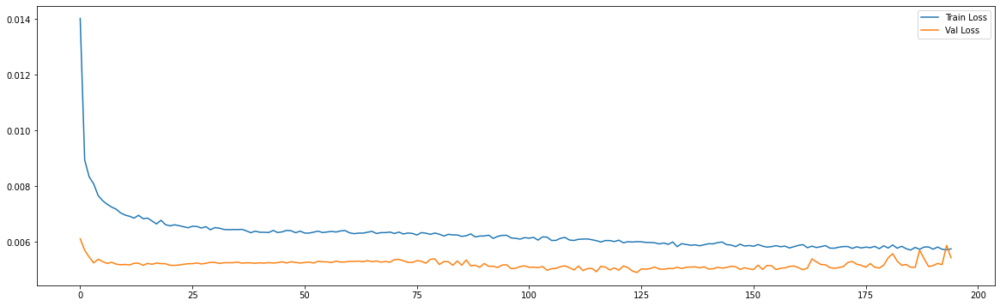

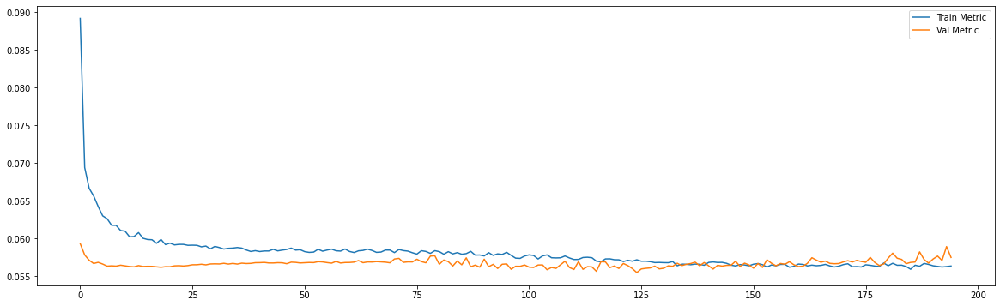

Epoch 00129: early stopping
============================model:6===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0061 - mae: 0.0573
loss and metric train data [0.006106571760028601, 0.0572524331510067]
10/10 [==============================] - 0s 5ms/step - loss: 0.0053 - mae: 0.0578
loss and metric val data [0.005262583494186401, 0.05782399699091911]
10/10 [==============================] - 0s 5ms/step - loss: 0.0066 - mae: 0.0608
loss and metric test data [0.00664116395637393, 0.06079165264964104]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




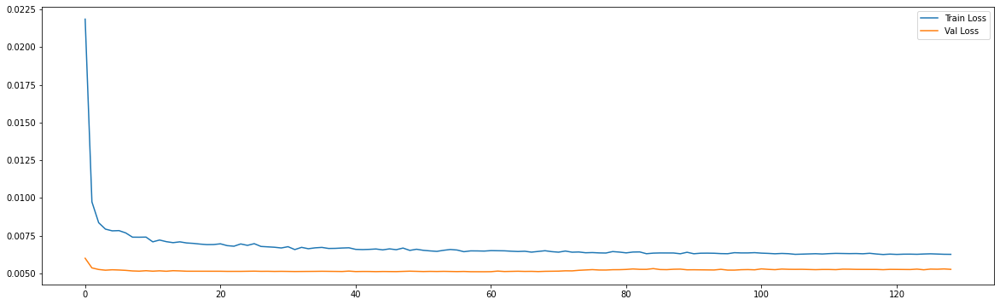

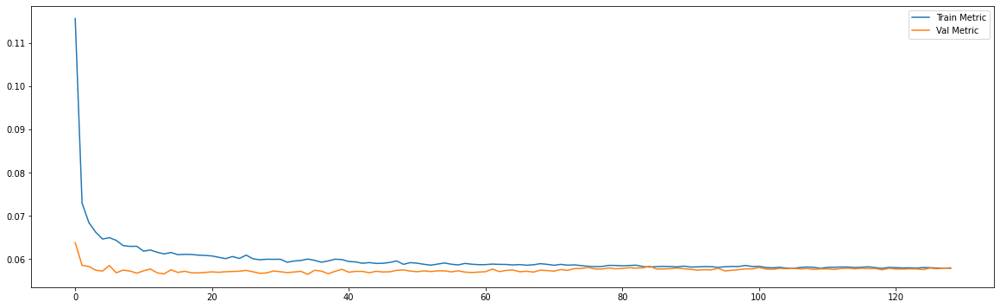

Epoch 00102: early stopping
============================model:7===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0576
loss and metric train data [0.006160305812954903, 0.05759015679359436]
10/10 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0584
loss and metric val data [0.005376061424612999, 0.05839817598462105]
10/10 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0614
loss and metric test data [0.006804058328270912, 0.061438966542482376]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




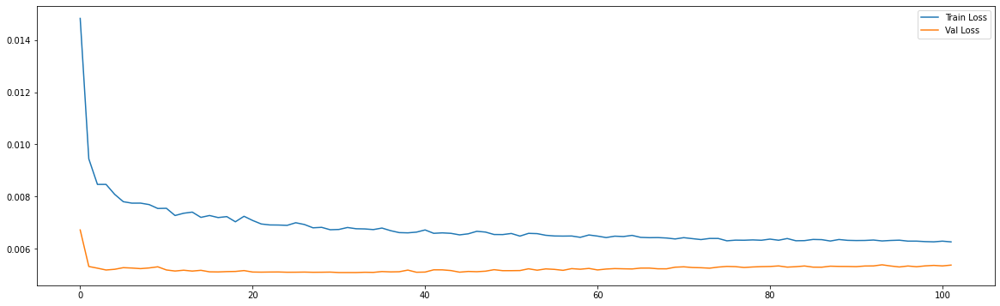

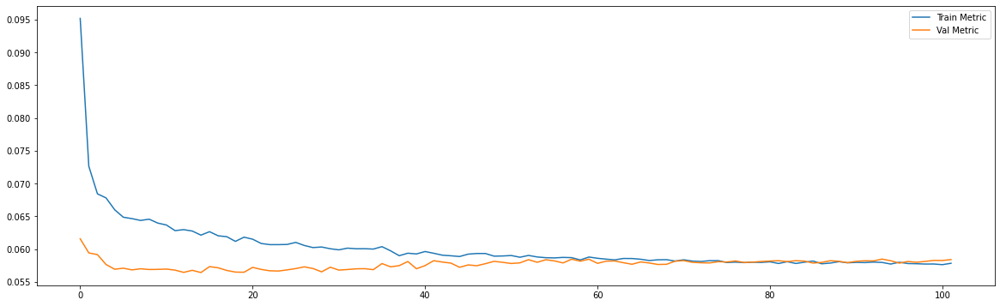

Epoch 00104: early stopping
============================model:8===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0064 - mae: 0.0574
loss and metric train data [0.006375457160174847, 0.0573800653219223]
10/10 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0583
loss and metric val data [0.005539011675864458, 0.058266956359148026]
10/10 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0609
loss and metric test data [0.007016689516603947, 0.06089688092470169]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




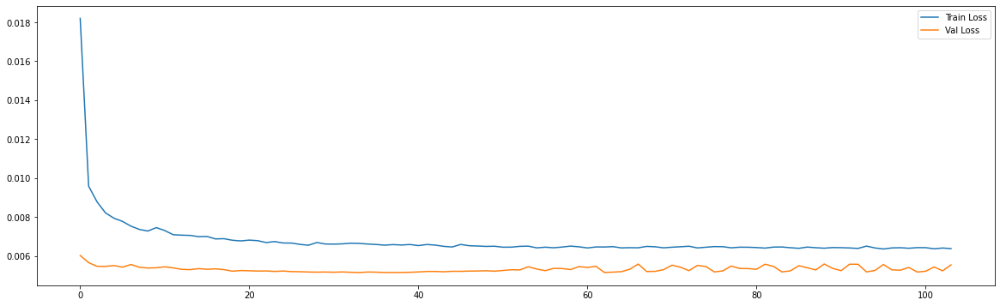

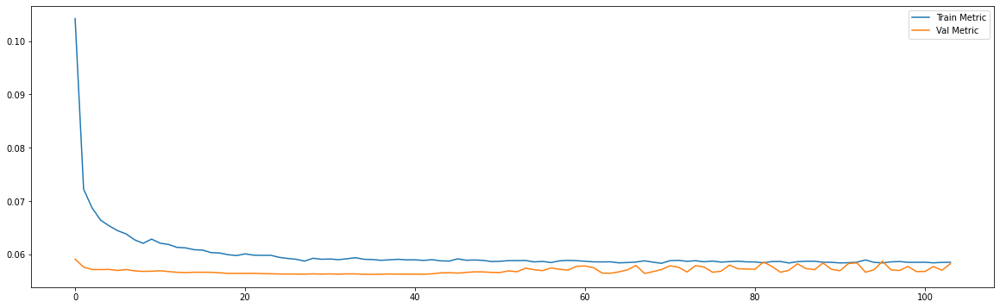

Epoch 00085: early stopping
============================model:9===========================
43/43 [==============================] - 1s 16ms/step - loss: 0.0063 - mae: 0.0568
loss and metric train data [0.006314772646874189, 0.05682587996125221]
10/10 [==============================] - 0s 15ms/step - loss: 0.0055 - mae: 0.0581
loss and metric val data [0.005539719481021166, 0.0581350177526474]
10/10 [==============================] - 0s 15ms/step - loss: 0.0070 - mae: 0.0610
loss and metric test data [0.006997948046773672, 0.0609947144985199]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




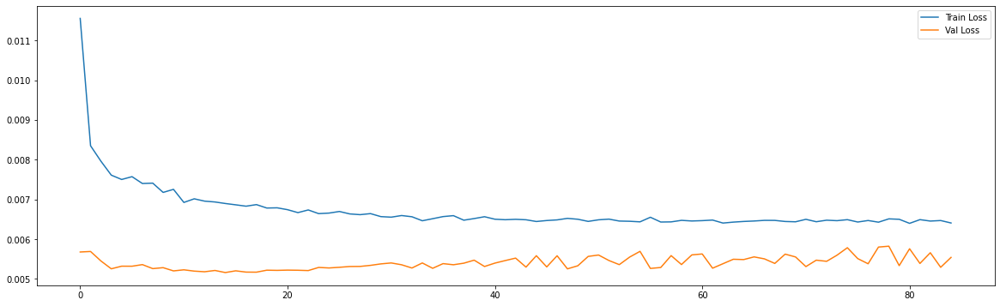

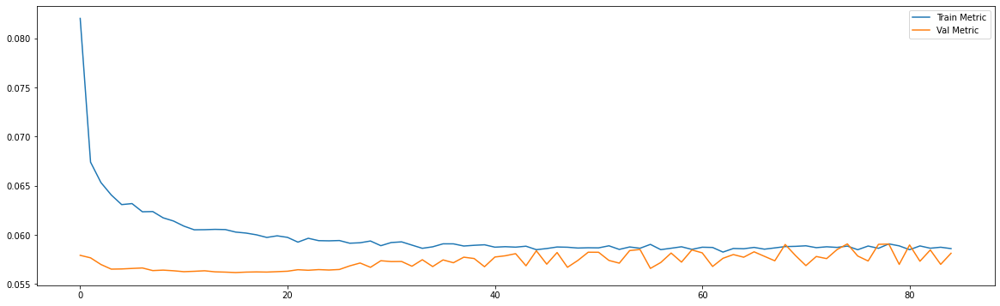

Epoch 00129: early stopping
============================model:10===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0062 - mae: 0.0576
loss and metric train data [0.006195699796080589, 0.05755528062582016]
10/10 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0590
loss and metric val data [0.0054488275200128555, 0.05897765979170799]
10/10 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0616
loss and metric test data [0.00683764461427927, 0.06155175343155861]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




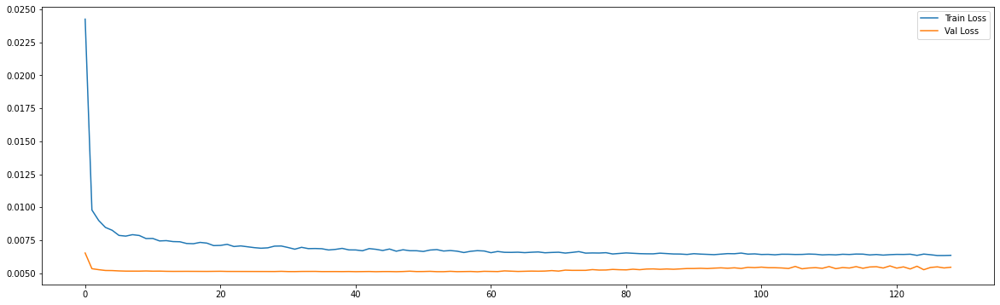

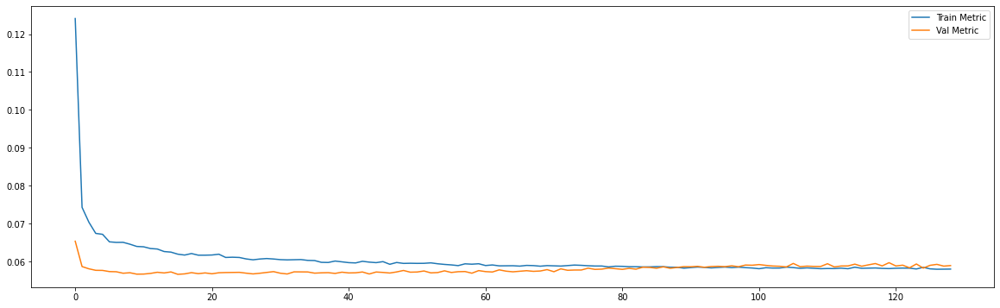

Epoch 00101: early stopping
============================model:11===========================
43/43 [==============================] - 1s 17ms/step - loss: 0.0062 - mae: 0.0578
loss and metric train data [0.006243884563446045, 0.05781491845846176]
10/10 [==============================] - 0s 16ms/step - loss: 0.0054 - mae: 0.0590
loss and metric val data [0.005439755506813526, 0.05900769308209419]
10/10 [==============================] - 0s 16ms/step - loss: 0.0067 - mae: 0.0612
loss and metric test data [0.006741382647305727, 0.06124434620141983]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




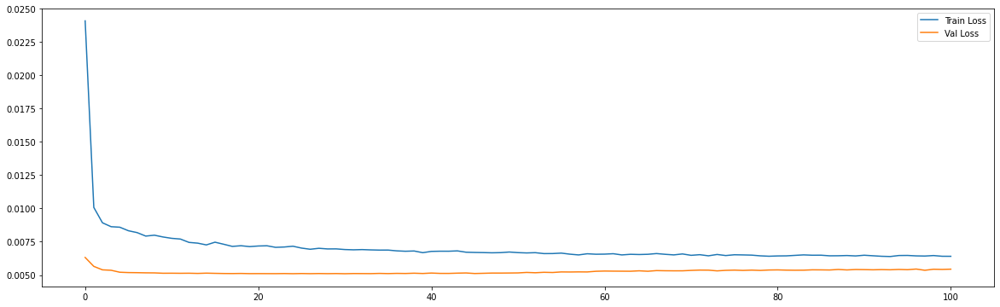

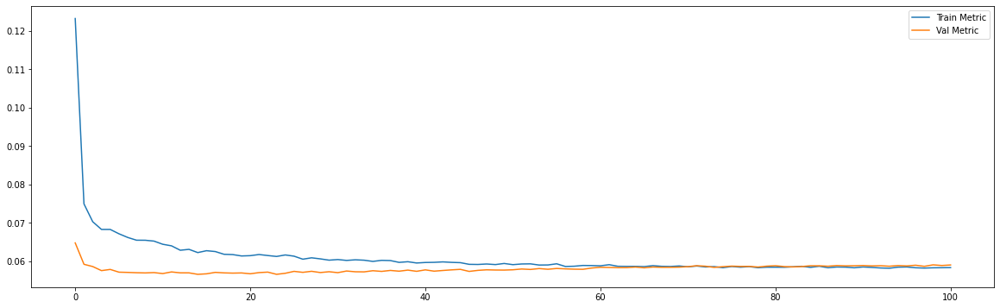

Epoch 00372: early stopping
============================model:12===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0564
loss and metric train data [0.0057644909247756, 0.05640508234500885]
10/10 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0567
loss and metric val data [0.005014635156840086, 0.056704964488744736]
10/10 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0600
loss and metric test data [0.0065770079381763935, 0.05999372527003288]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




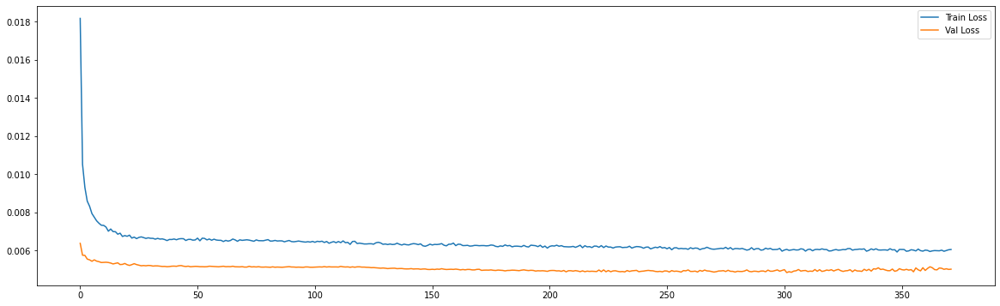

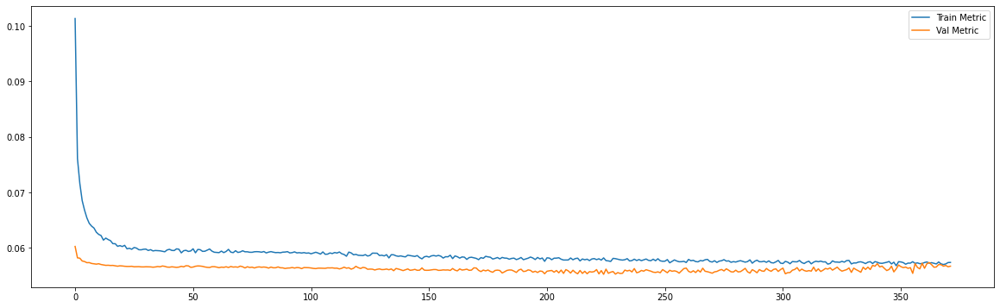

Epoch 00106: early stopping
============================model:13===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0573
loss and metric train data [0.006316274404525757, 0.05729946866631508]
10/10 [==============================] - 0s 6ms/step - loss: 0.0053 - mae: 0.0567
loss and metric val data [0.005265374667942524, 0.05668153241276741]
10/10 [==============================] - 0s 6ms/step - loss: 0.0067 - mae: 0.0599
loss and metric test data [0.006689250934869051, 0.05985189601778984]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




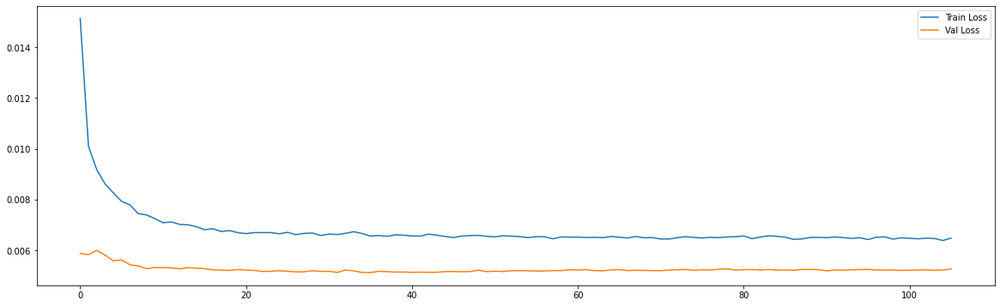

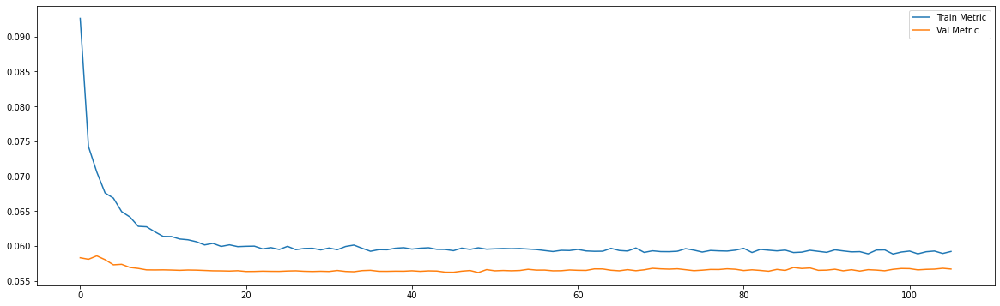

Epoch 00118: early stopping
============================model:14===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0584
loss and metric train data [0.006311939563602209, 0.05843418464064598]
10/10 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0579
loss and metric val data [0.005173929035663605, 0.057926245033741]
10/10 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0605
loss and metric test data [0.006608766969293356, 0.06053562089800835]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




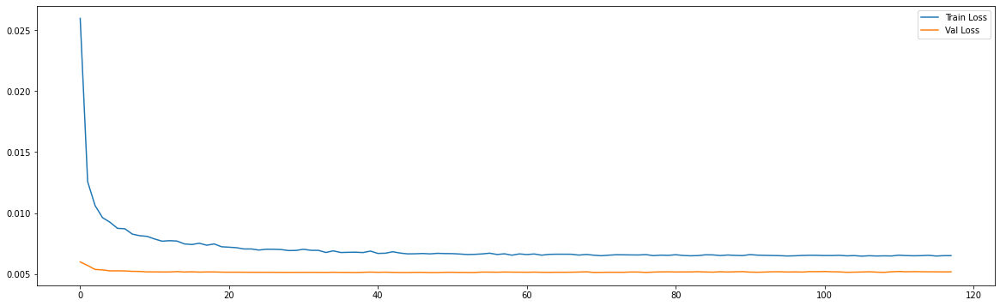

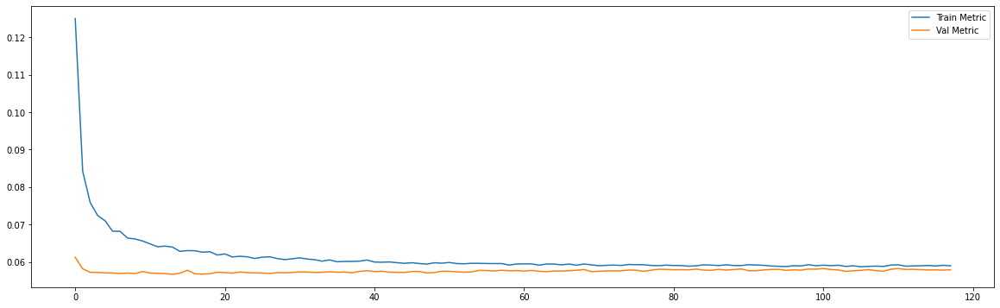

Epoch 00104: early stopping
============================model:15===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0583
loss and metric train data [0.00634845532476902, 0.058269862085580826]
10/10 [==============================] - 0s 5ms/step - loss: 0.0051 - mae: 0.0577
loss and metric val data [0.005144148599356413, 0.0576799139380455]
10/10 [==============================] - 0s 5ms/step - loss: 0.0067 - mae: 0.0604
loss and metric test data [0.006665150634944439, 0.0604267381131649]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




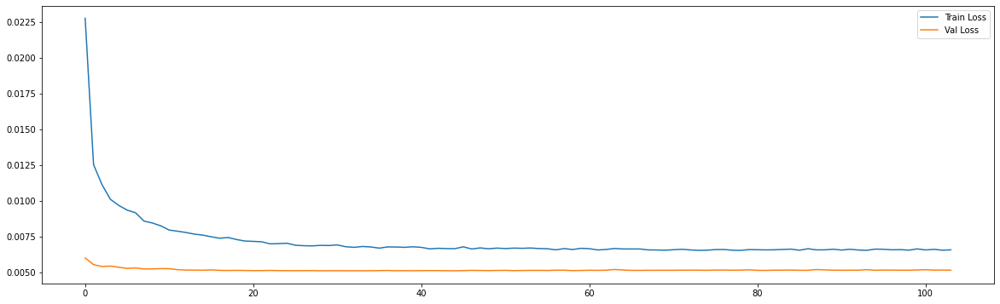

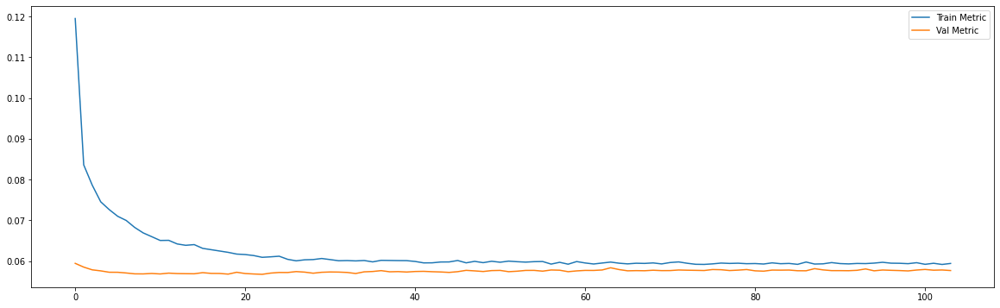

Epoch 00102: early stopping
============================model:16===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0567
loss and metric train data [0.006165419239550829, 0.05673328414559364]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0567
loss and metric val data [0.005213836207985878, 0.05666182190179825]
10/10 [==============================] - 0s 5ms/step - loss: 0.0067 - mae: 0.0602
loss and metric test data [0.006699593272060156, 0.06023505702614784]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




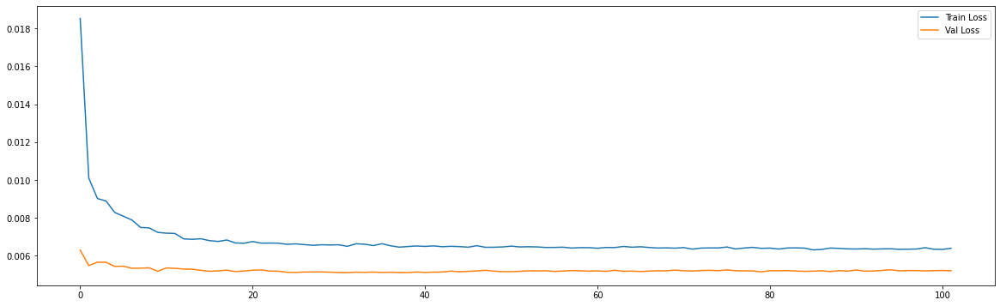

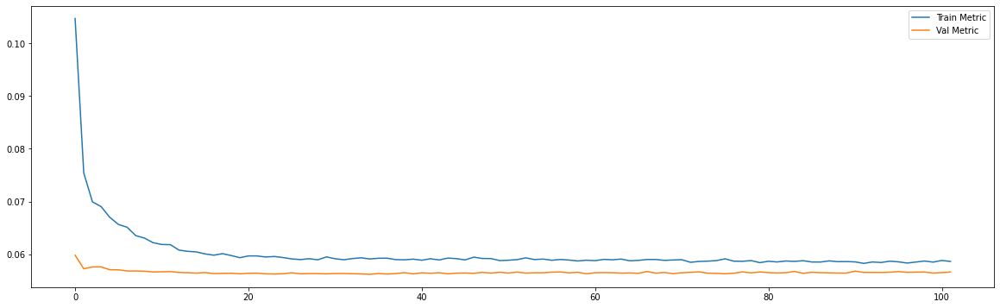

Epoch 00087: early stopping
============================model:17===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0062 - mae: 0.0570
loss and metric train data [0.006153897847980261, 0.056980326771736145]
10/10 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0572
loss and metric val data [0.005241837352514267, 0.05723591521382332]
10/10 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0608
loss and metric test data [0.006773735396564007, 0.060755666345357895]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




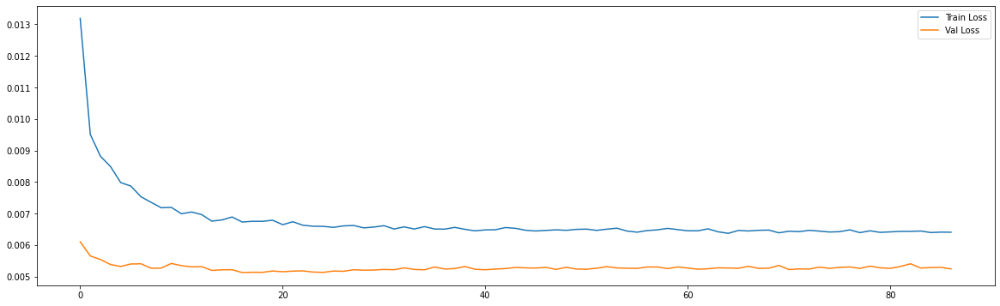

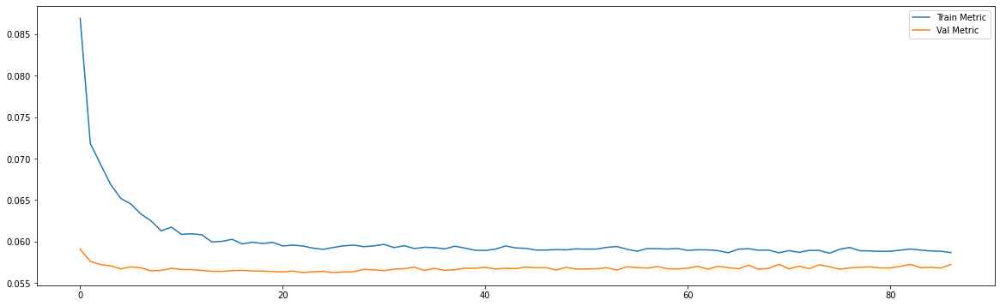

Epoch 00112: early stopping
============================model:18===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0576
loss and metric train data [0.006171669811010361, 0.05761759728193283]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0580
loss and metric val data [0.0052428231574594975, 0.058017387986183167]
10/10 [==============================] - 0s 6ms/step - loss: 0.0067 - mae: 0.0607
loss and metric test data [0.006651312578469515, 0.06074600666761398]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




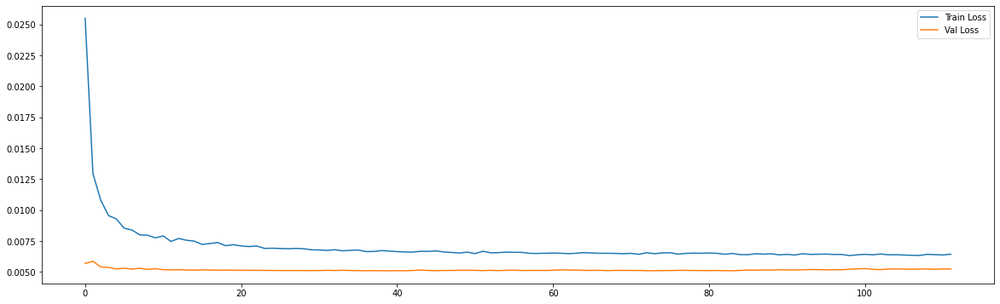

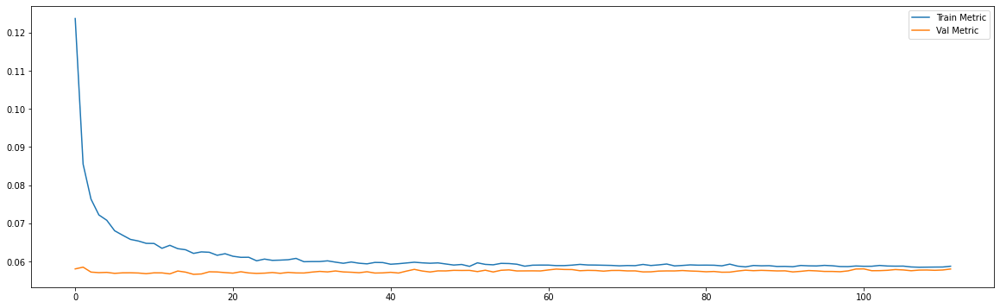

Epoch 00148: early stopping
============================model:19===========================
45/45 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0574
loss and metric train data [0.006153996102511883, 0.05741242691874504]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0581
loss and metric val data [0.005307961255311966, 0.05807395651936531]
10/10 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0611
loss and metric test data [0.0067390804179012775, 0.06108025833964348]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




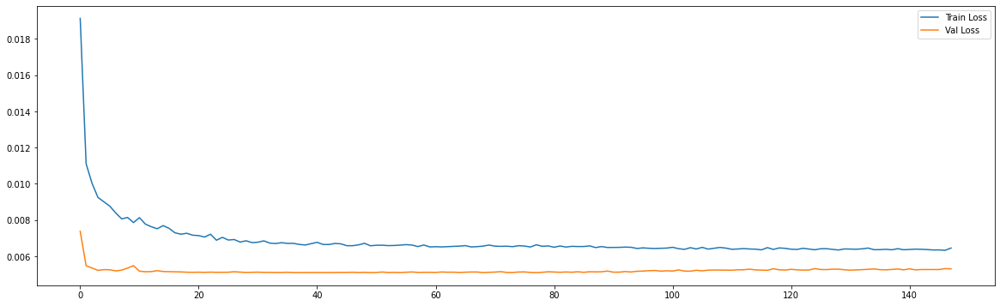

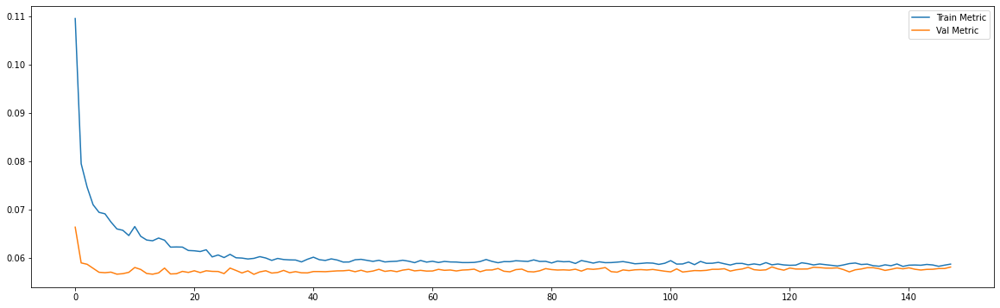

Epoch 00107: early stopping
============================model:20===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0572
loss and metric train data [0.00628776615485549, 0.057153016328811646]
10/10 [==============================] - 0s 8ms/step - loss: 0.0055 - mae: 0.0588
loss and metric val data [0.0055472357198596, 0.058799859136343]
10/10 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0615
loss and metric test data [0.0070496066473424435, 0.06151096895337105]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




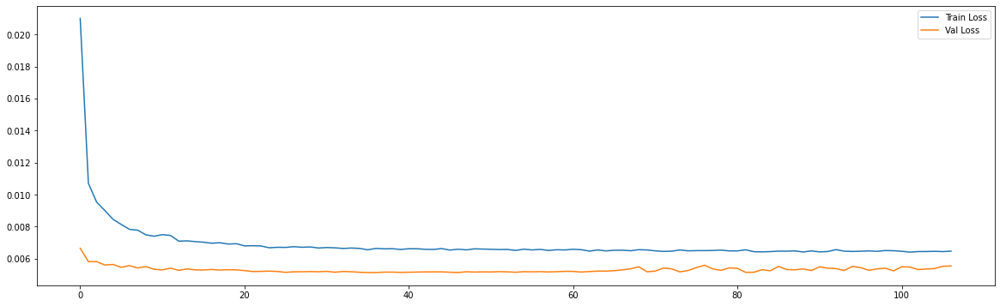

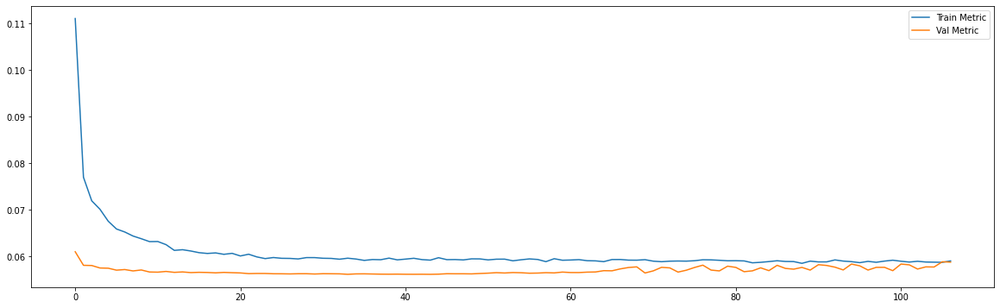

Epoch 00119: early stopping
============================model:21===========================
43/43 [==============================] - 1s 16ms/step - loss: 0.0063 - mae: 0.0569
loss and metric train data [0.006324964575469494, 0.05694684013724327]
10/10 [==============================] - 0s 16ms/step - loss: 0.0053 - mae: 0.0567
loss and metric val data [0.0052519249729812145, 0.05670018121600151]
10/10 [==============================] - 0s 15ms/step - loss: 0.0068 - mae: 0.0601
loss and metric test data [0.0067654079757630825, 0.06014426425099373]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




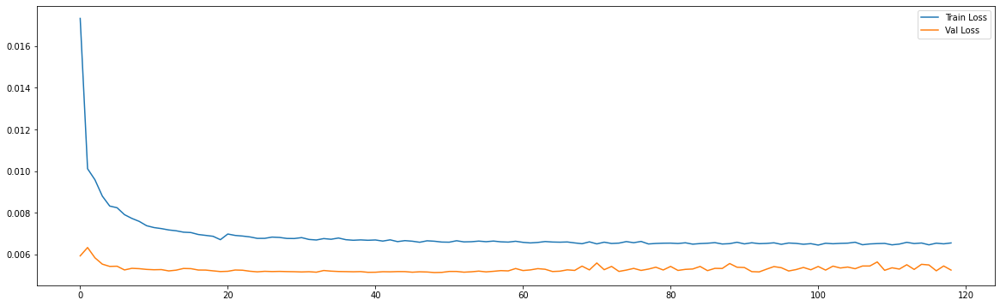

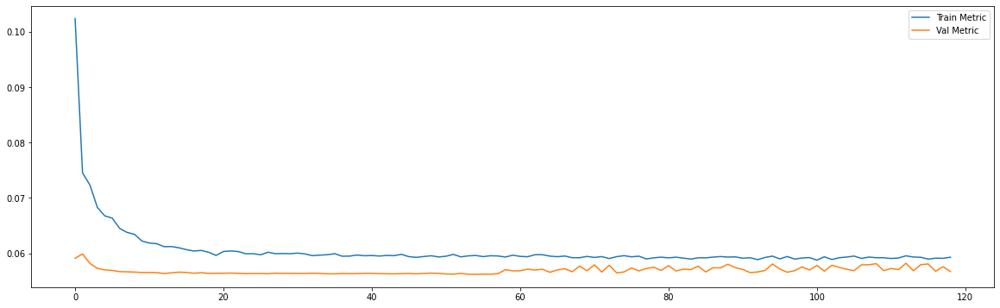

Epoch 00113: early stopping
============================model:22===========================
43/43 [==============================] - 0s 8ms/step - loss: 0.0063 - mae: 0.0578
loss and metric train data [0.006295285653322935, 0.05781124159693718]
10/10 [==============================] - 0s 8ms/step - loss: 0.0052 - mae: 0.0578
loss and metric val data [0.0052085560746490955, 0.057799436151981354]
10/10 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0607
loss and metric test data [0.006663433741778135, 0.060731157660484314]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




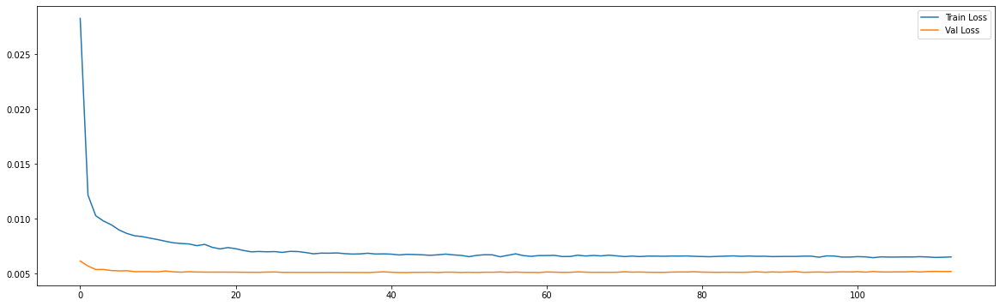

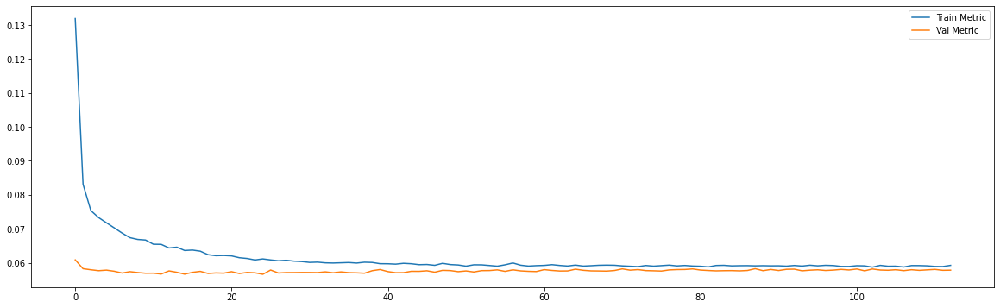

Epoch 00102: early stopping
============================model:23===========================
43/43 [==============================] - 1s 17ms/step - loss: 0.0063 - mae: 0.0578
loss and metric train data [0.006273666396737099, 0.05775568634271622]
10/10 [==============================] - 0s 15ms/step - loss: 0.0053 - mae: 0.0583
loss and metric val data [0.005292171146720648, 0.05833715945482254]
10/10 [==============================] - 0s 15ms/step - loss: 0.0067 - mae: 0.0607
loss and metric test data [0.006684547755867243, 0.0607016384601593]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




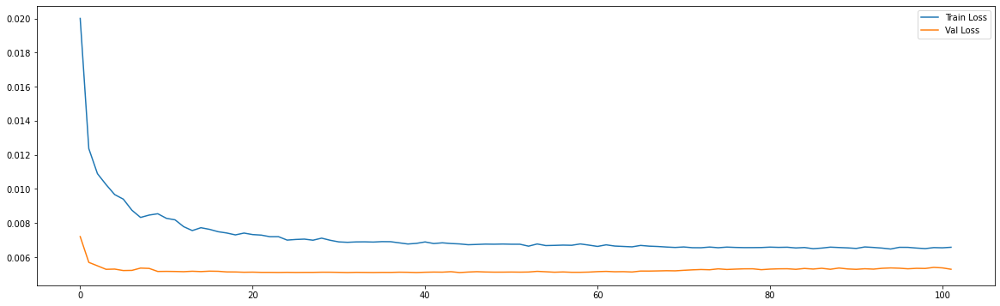

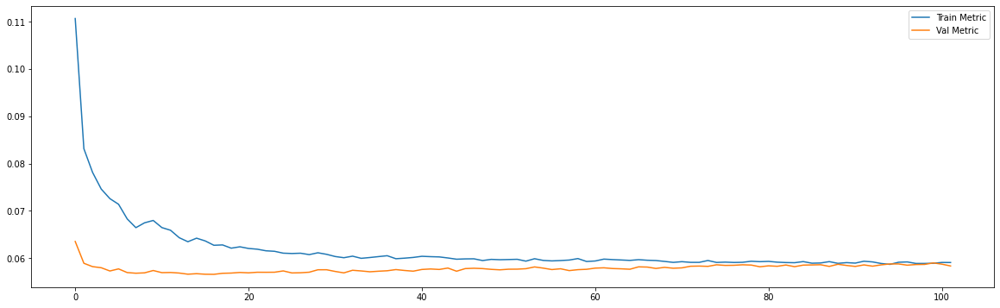

Epoch 00405: early stopping
============================model:24===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0536
loss and metric train data [0.0050454819574952126, 0.053593769669532776]
10/10 [==============================] - 0s 4ms/step - loss: 0.0055 - mae: 0.0572
loss and metric val data [0.0054938895627856255, 0.05715040862560272]
10/10 [==============================] - 0s 4ms/step - loss: 0.0080 - mae: 0.0626
loss and metric test data [0.007967079058289528, 0.0626077950000763]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




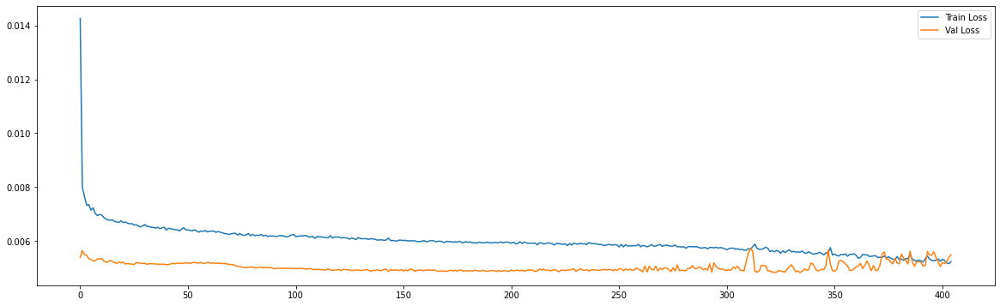

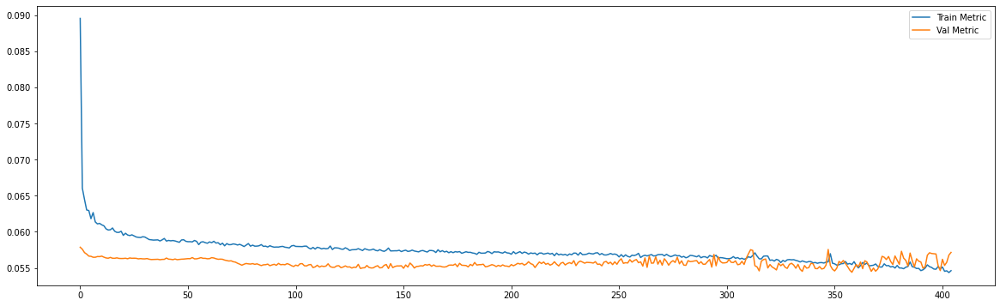

Epoch 00184: early stopping
============================model:25===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0057 - mae: 0.0560
loss and metric train data [0.005704294424504042, 0.05603380873799324]
10/10 [==============================] - 0s 6ms/step - loss: 0.0052 - mae: 0.0565
loss and metric val data [0.0052007813937962055, 0.05651889741420746]
10/10 [==============================] - 0s 6ms/step - loss: 0.0067 - mae: 0.0587
loss and metric test data [0.006701831240206957, 0.058724965900182724]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




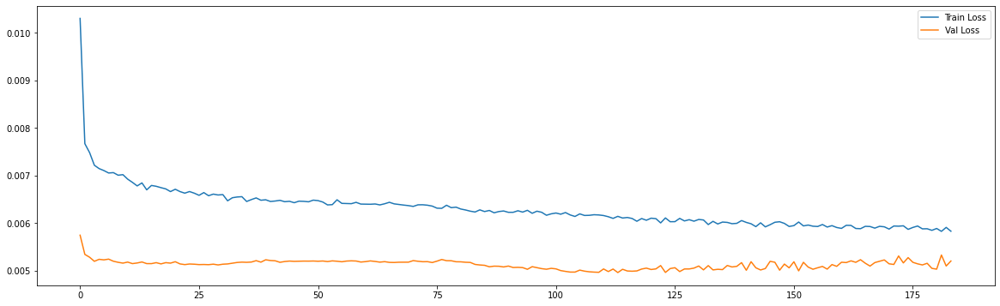

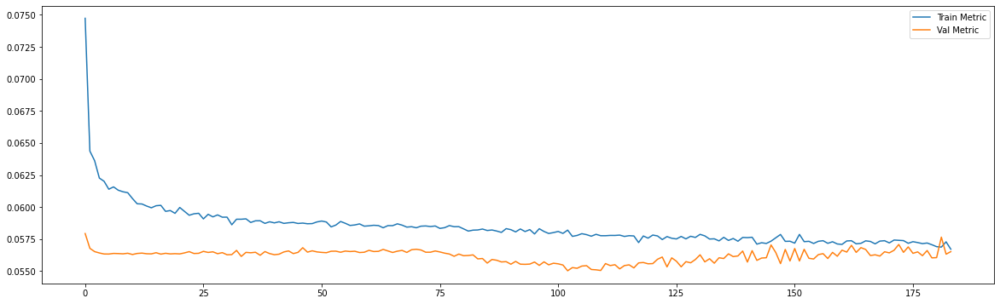

Epoch 00113: early stopping
============================model:26===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0582
loss and metric train data [0.006225496996194124, 0.05823284760117531]
10/10 [==============================] - 0s 4ms/step - loss: 0.0053 - mae: 0.0582
loss and metric val data [0.005263031460344791, 0.05818388611078262]
10/10 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0609
loss and metric test data [0.0066062635742127895, 0.06092485040426254]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




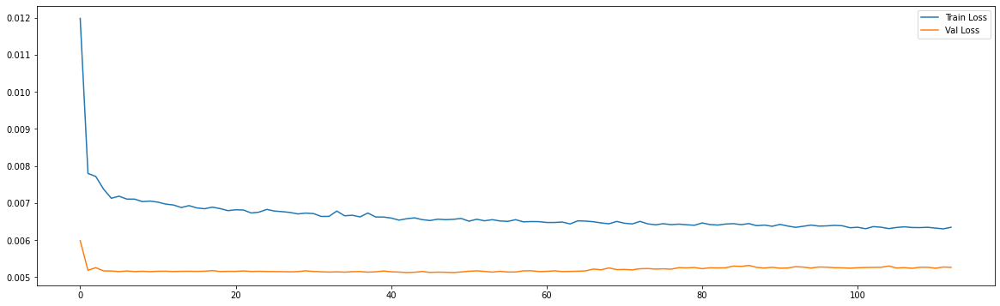

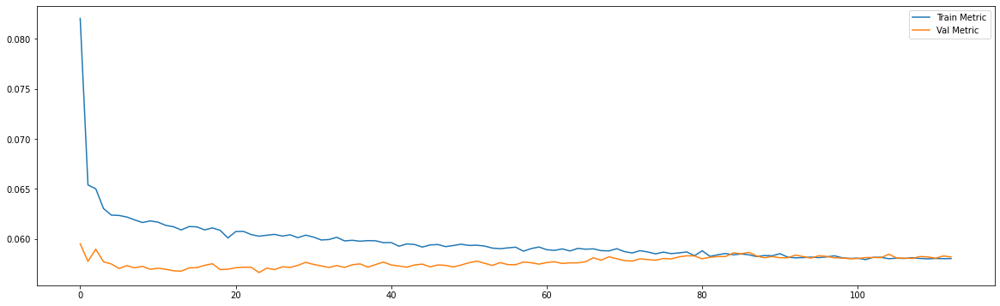

Epoch 00101: early stopping
============================model:27===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0581
loss and metric train data [0.006238255649805069, 0.058080002665519714]
10/10 [==============================] - 0s 7ms/step - loss: 0.0053 - mae: 0.0579
loss and metric val data [0.005253133829683065, 0.05789589509367943]
10/10 [==============================] - 0s 6ms/step - loss: 0.0066 - mae: 0.0609
loss and metric test data [0.006634112913161516, 0.06090550124645233]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




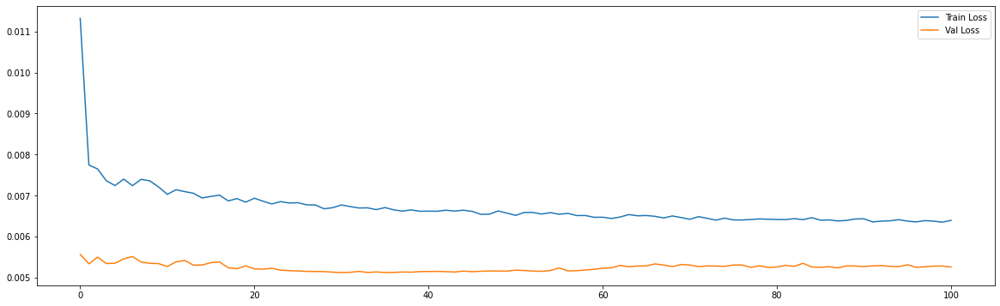

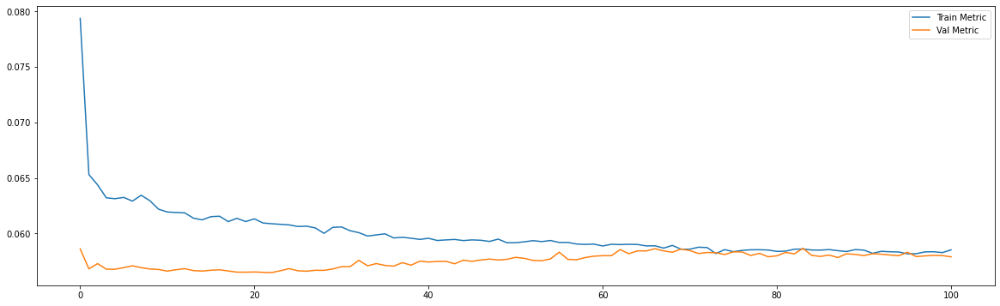

Epoch 00219: early stopping
============================model:28===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0055 - mae: 0.0552
loss and metric train data [0.005537734366953373, 0.05520647391676903]
10/10 [==============================] - 0s 5ms/step - loss: 0.0051 - mae: 0.0561
loss and metric val data [0.005147733259946108, 0.056093815714120865]
10/10 [==============================] - 0s 5ms/step - loss: 0.0077 - mae: 0.0629
loss and metric test data [0.0076916334219276905, 0.0629400983452797]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




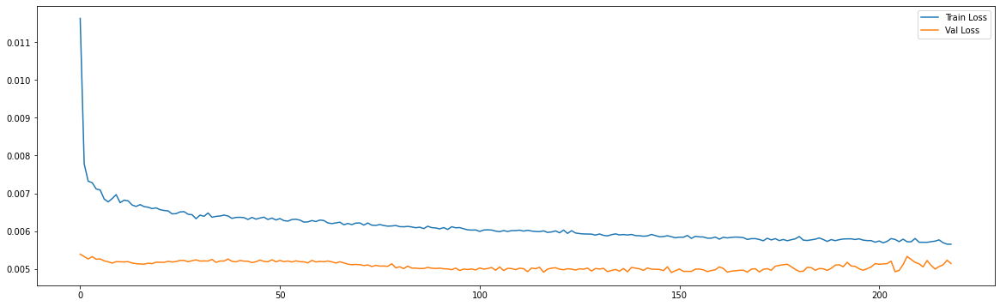

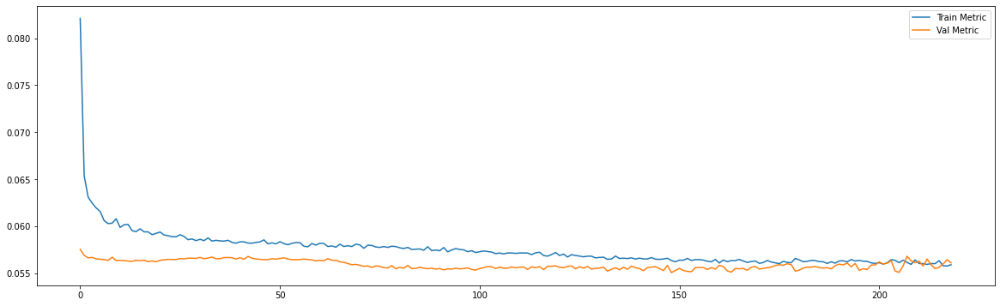

Epoch 00195: early stopping
============================model:29===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0056 - mae: 0.0560
loss and metric train data [0.005644059274345636, 0.05596036836504936]
10/10 [==============================] - 0s 10ms/step - loss: 0.0058 - mae: 0.0594
loss and metric val data [0.005789341405034065, 0.059418871998786926]
10/10 [==============================] - 0s 9ms/step - loss: 0.0106 - mae: 0.0672
loss and metric test data [0.010647901333868504, 0.06720408797264099]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




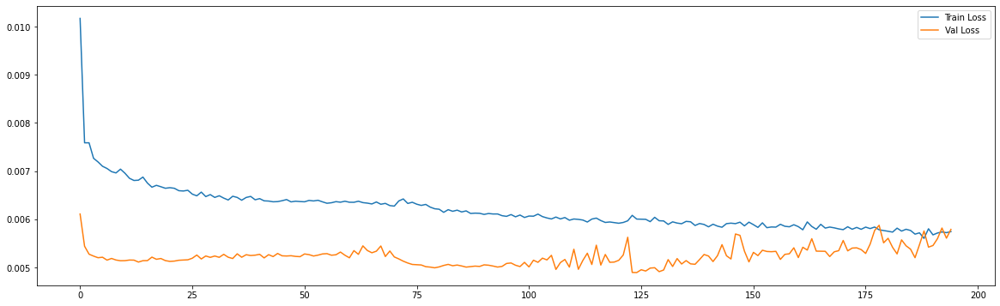

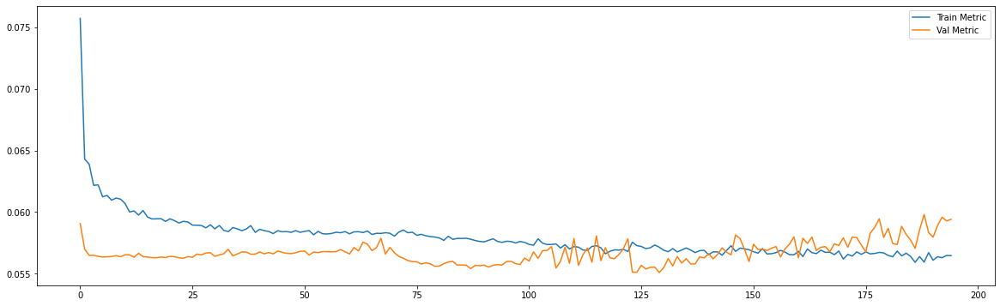

Epoch 00104: early stopping
============================model:30===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0061 - mae: 0.0570
loss and metric train data [0.006076039746403694, 0.057022418826818466]
10/10 [==============================] - 0s 7ms/step - loss: 0.0053 - mae: 0.0575
loss and metric val data [0.005250030197203159, 0.0575149804353714]
10/10 [==============================] - 0s 6ms/step - loss: 0.0067 - mae: 0.0609
loss and metric test data [0.006672909017652273, 0.06089705601334572]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




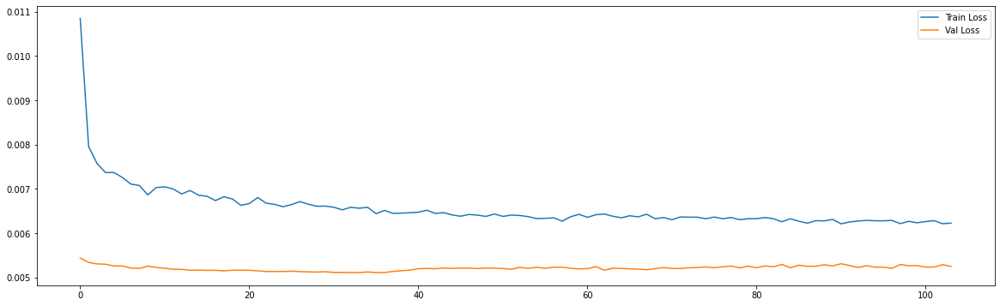

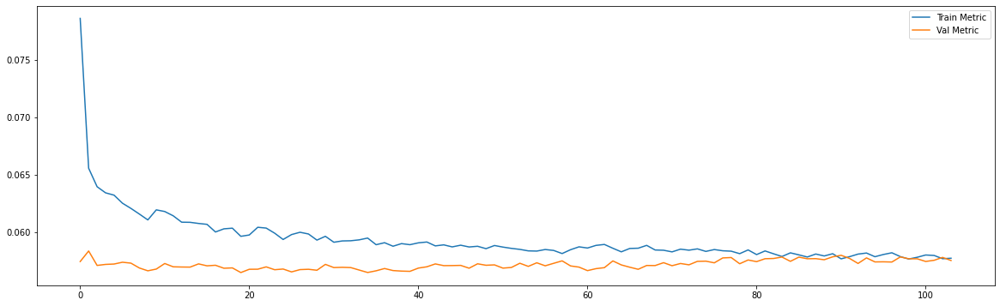

Epoch 00107: early stopping
============================model:31===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0062 - mae: 0.0575
loss and metric train data [0.006153849419206381, 0.05753720551729202]
10/10 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0576
loss and metric val data [0.0051930746994912624, 0.05756629630923271]
10/10 [==============================] - 0s 10ms/step - loss: 0.0066 - mae: 0.0607
loss and metric test data [0.006591924000531435, 0.0607195608317852]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




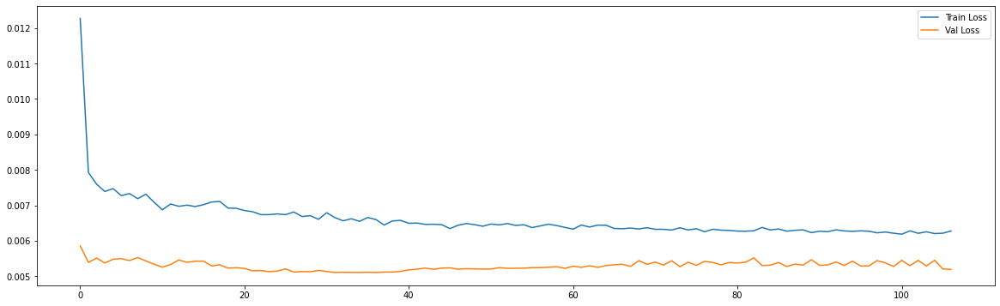

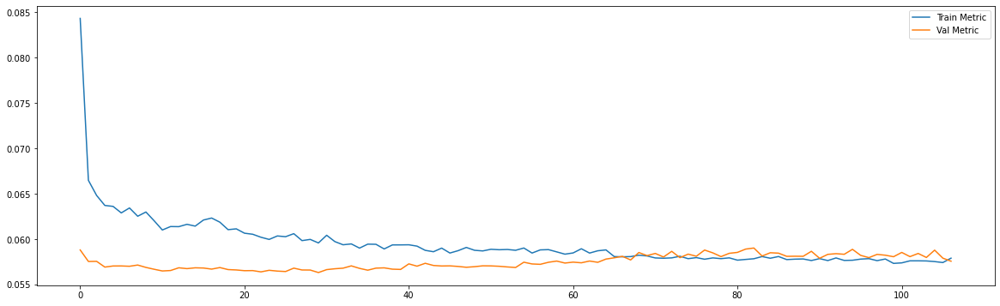

Epoch 00330: early stopping
============================model:32===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0056 - mae: 0.0550
loss and metric train data [0.005616128444671631, 0.05497225746512413]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0581
loss and metric val data [0.005319444928318262, 0.05811022222042084]
10/10 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0619
loss and metric test data [0.006828976795077324, 0.06193961948156357]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




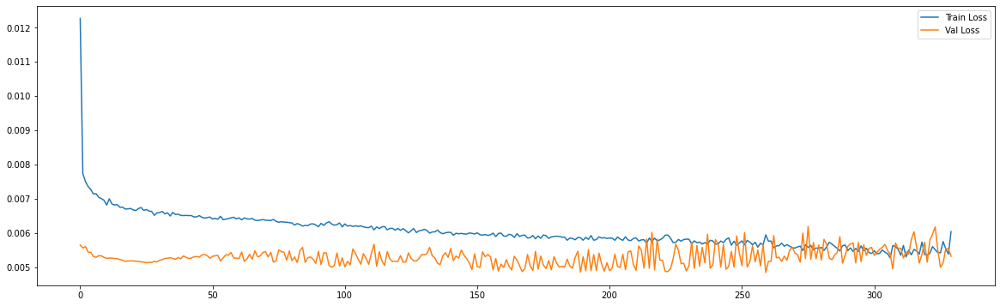

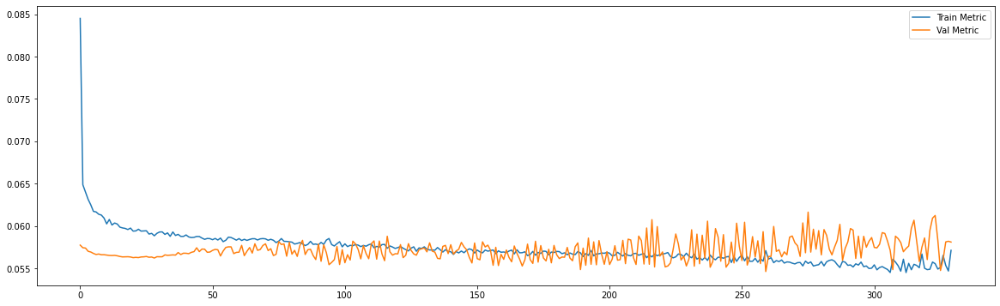

Epoch 00167: early stopping
============================model:33===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0056 - mae: 0.0555
loss and metric train data [0.005648561287671328, 0.05553628131747246]
10/10 [==============================] - 0s 17ms/step - loss: 0.0058 - mae: 0.0588
loss and metric val data [0.005751216318458319, 0.05879322439432144]
10/10 [==============================] - 0s 16ms/step - loss: 0.0077 - mae: 0.0649
loss and metric test data [0.00770679023116827, 0.06490221619606018]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




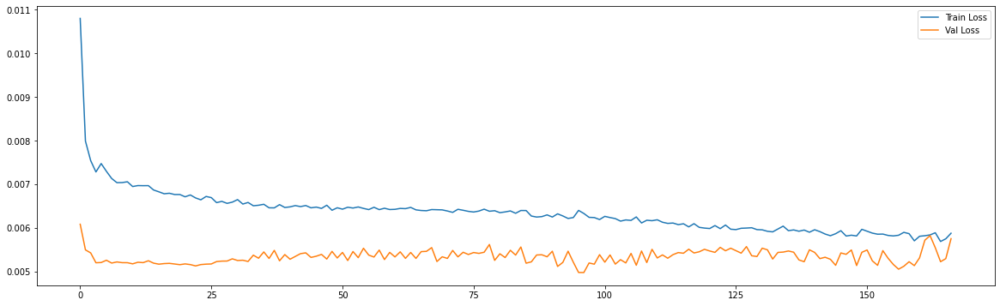

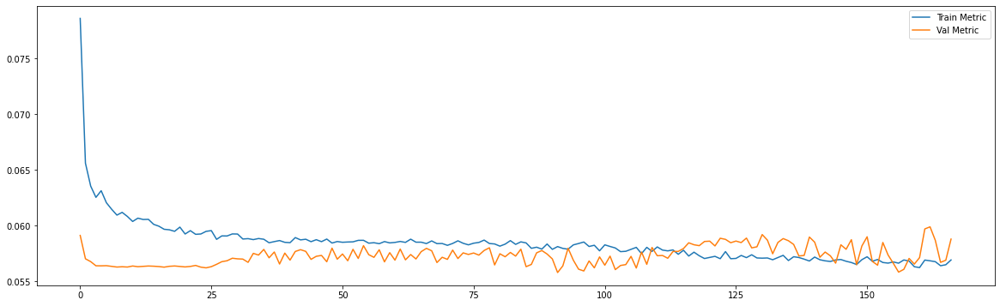

Epoch 00129: early stopping
============================model:34===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0061 - mae: 0.0574
loss and metric train data [0.006115321069955826, 0.0574280209839344]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0584
loss and metric val data [0.005327950231730938, 0.05844266340136528]
10/10 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0616
loss and metric test data [0.006698603741824627, 0.061578426510095596]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




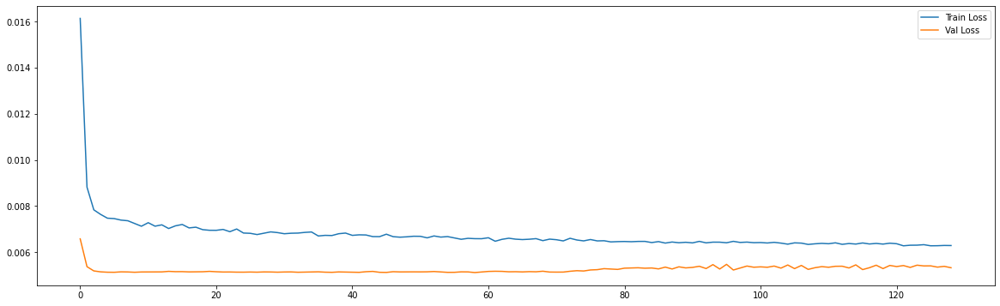

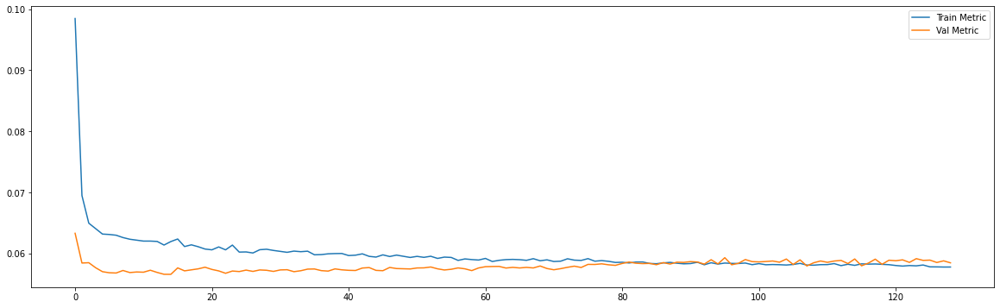

Epoch 00104: early stopping
============================model:35===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0062 - mae: 0.0575
loss and metric train data [0.006166687235236168, 0.05754915624856949]
10/10 [==============================] - 0s 16ms/step - loss: 0.0054 - mae: 0.0587
loss and metric val data [0.005419318098574877, 0.05871804803609848]
10/10 [==============================] - 0s 17ms/step - loss: 0.0068 - mae: 0.0623
loss and metric test data [0.006842461414635181, 0.06228594854474068]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




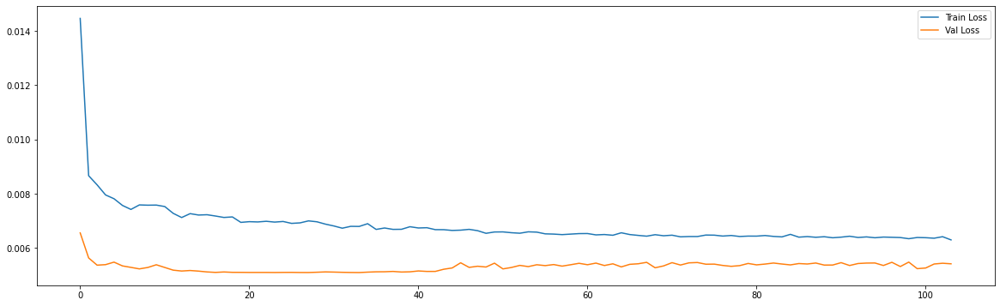

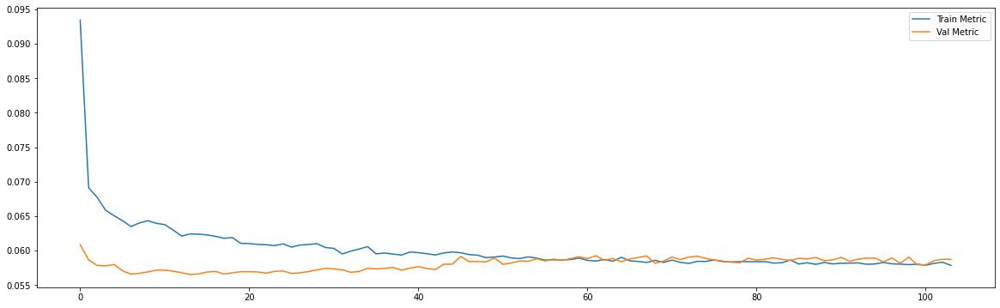

Epoch 00244: early stopping
============================model:36===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0561
loss and metric train data [0.0057654185220599174, 0.056129295378923416]
10/10 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0557
loss and metric val data [0.004914096090942621, 0.055701468139886856]
10/10 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0585
loss and metric test data [0.006212454754859209, 0.058523233979940414]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




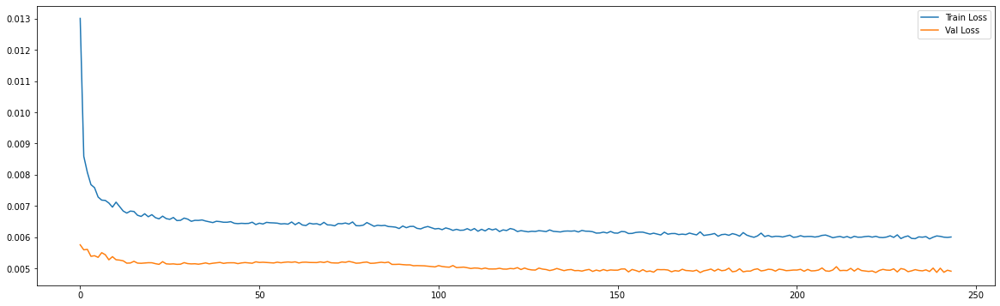

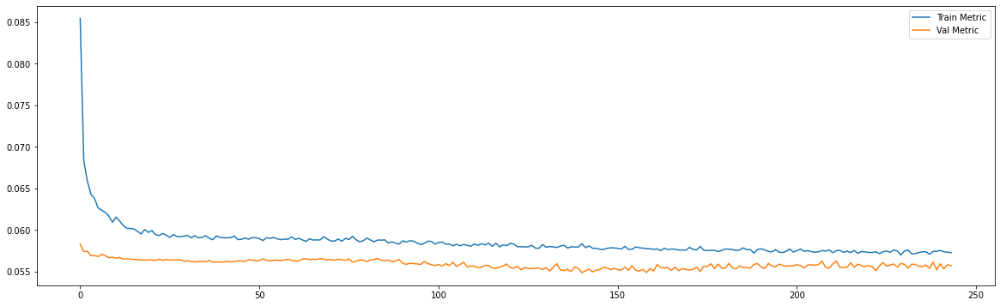

Epoch 00338: early stopping
============================model:37===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0056 - mae: 0.0549
loss and metric train data [0.005609562620520592, 0.05490262433886528]
10/10 [==============================] - 0s 6ms/step - loss: 0.0050 - mae: 0.0548
loss and metric val data [0.004966873675584793, 0.054787565022706985]
10/10 [==============================] - 0s 6ms/step - loss: 0.0065 - mae: 0.0586
loss and metric test data [0.00652315141633153, 0.05860403552651405]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




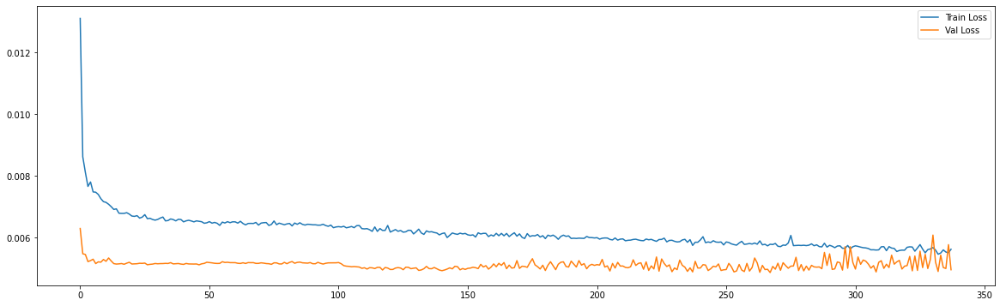

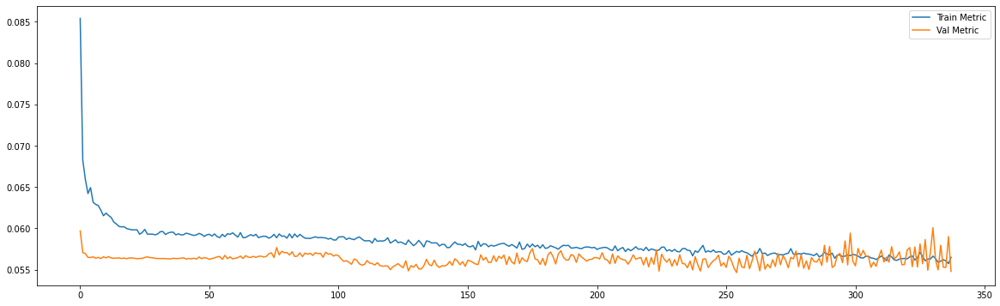

Epoch 00144: early stopping
============================model:38===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0061 - mae: 0.0580
loss and metric train data [0.006134199444204569, 0.05796268954873085]
10/10 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0578
loss and metric val data [0.005155100952833891, 0.057785581797361374]
10/10 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0610
loss and metric test data [0.006581368390470743, 0.060976121574640274]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




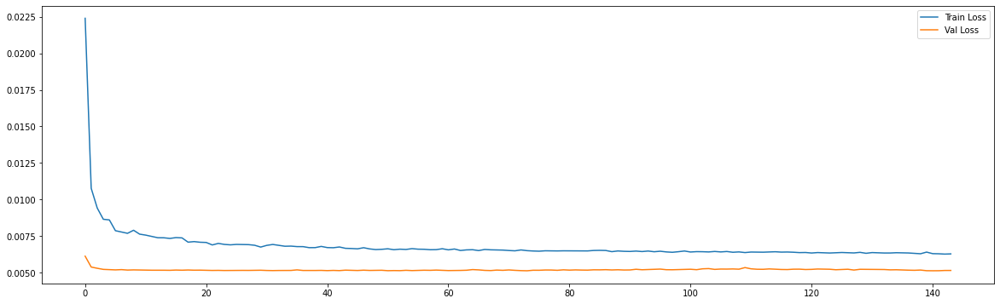

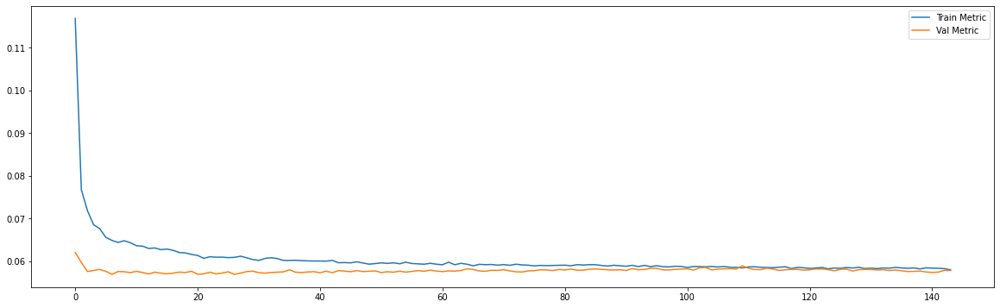

Epoch 00099: early stopping
============================model:39===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0581
loss and metric train data [0.0062684062868356705, 0.05808885768055916]
10/10 [==============================] - 0s 6ms/step - loss: 0.0052 - mae: 0.0578
loss and metric val data [0.005242988001555204, 0.05781039223074913]
10/10 [==============================] - 0s 6ms/step - loss: 0.0066 - mae: 0.0607
loss and metric test data [0.0066267019137740135, 0.060678426176309586]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




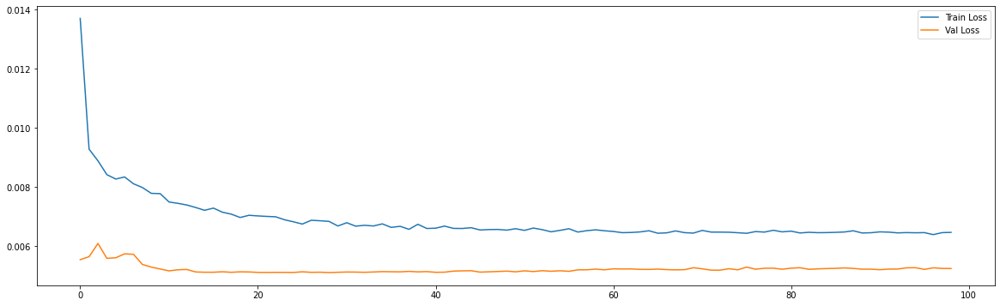

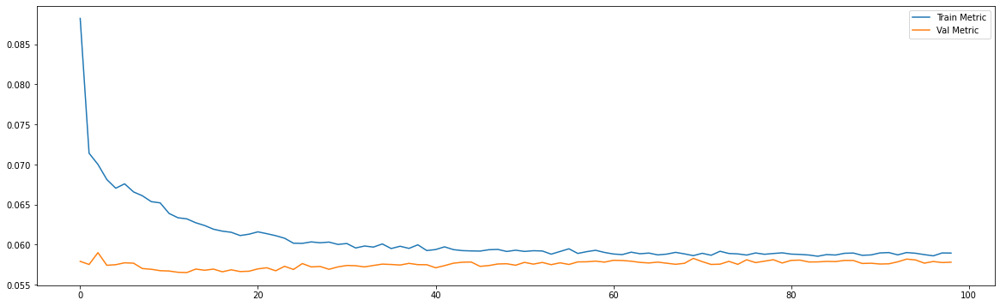

Epoch 00093: early stopping
============================model:40===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0567
loss and metric train data [0.00615199888125062, 0.05671936646103859]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0565
loss and metric val data [0.005215736106038094, 0.056493524461984634]
10/10 [==============================] - 0s 6ms/step - loss: 0.0068 - mae: 0.0611
loss and metric test data [0.006811820436269045, 0.06106868013739586]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




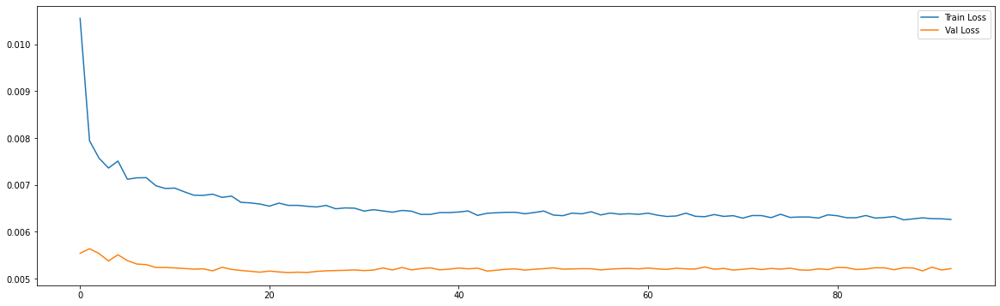

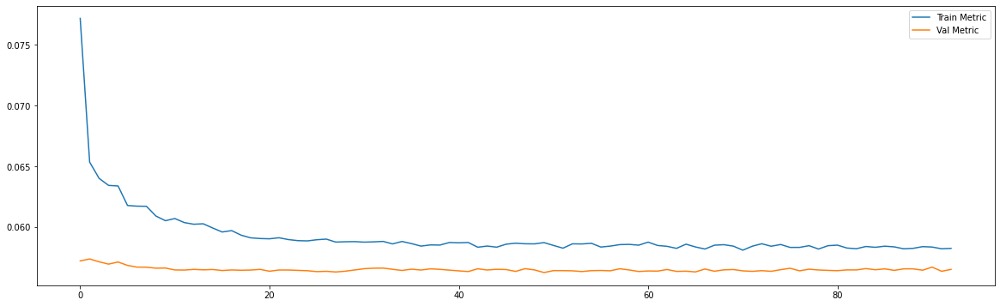

Epoch 00099: early stopping
============================model:41===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0061 - mae: 0.0570
loss and metric train data [0.006128726527094841, 0.057008981704711914]
10/10 [==============================] - 0s 9ms/step - loss: 0.0054 - mae: 0.0575
loss and metric val data [0.005369673017412424, 0.05752239003777504]
10/10 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0611
loss and metric test data [0.0066980780102312565, 0.061136167496442795]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




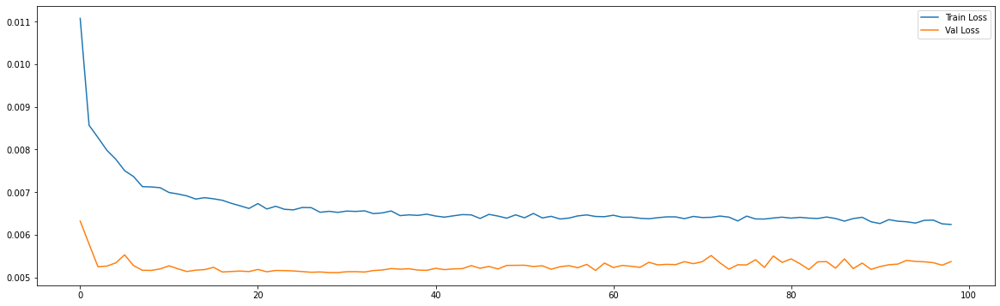

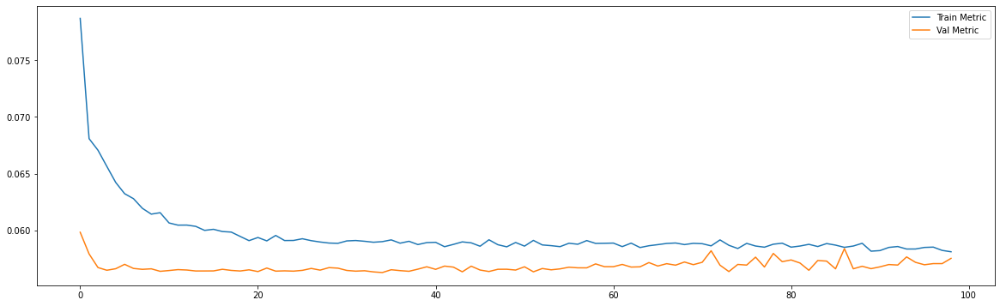

Epoch 00121: early stopping
============================model:42===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0061 - mae: 0.0573
loss and metric train data [0.006122304126620293, 0.0573427639901638]
10/10 [==============================] - 0s 6ms/step - loss: 0.0053 - mae: 0.0579
loss and metric val data [0.005274519324302673, 0.05787796527147293]
10/10 [==============================] - 0s 5ms/step - loss: 0.0067 - mae: 0.0610
loss and metric test data [0.006689830683171749, 0.061016958206892014]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




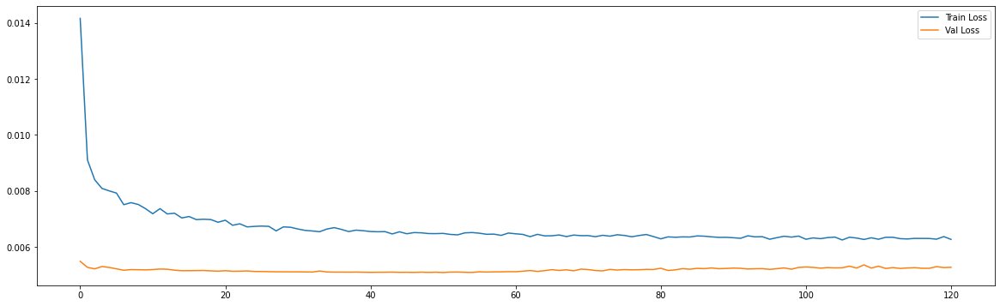

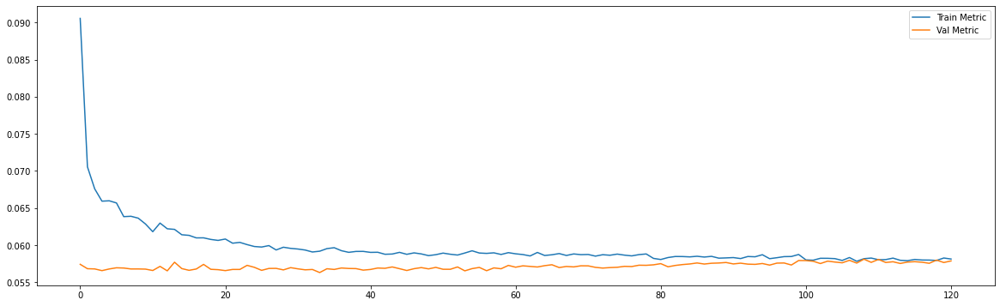

Epoch 00110: early stopping
============================model:43===========================
45/45 [==============================] - 0s 10ms/step - loss: 0.0061 - mae: 0.0575
loss and metric train data [0.006146641913801432, 0.05747593194246292]
10/10 [==============================] - 0s 9ms/step - loss: 0.0053 - mae: 0.0580
loss and metric val data [0.0052735465578734875, 0.05800792947411537]
10/10 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0612
loss and metric test data [0.0067403861321508884, 0.06117390841245651]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




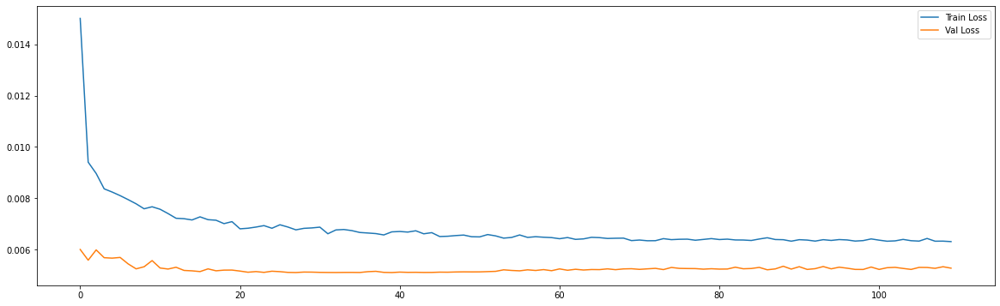

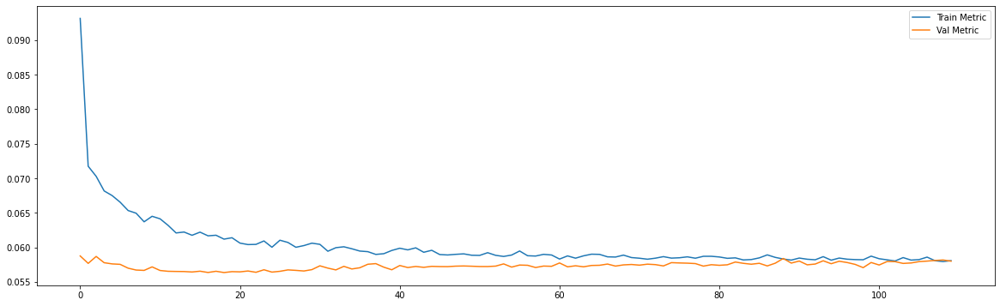

Epoch 00100: early stopping
============================model:44===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0565
loss and metric train data [0.006159059703350067, 0.056463442742824554]
10/10 [==============================] - 0s 9ms/step - loss: 0.0052 - mae: 0.0562
loss and metric val data [0.005154321901500225, 0.056215208023786545]
10/10 [==============================] - 0s 9ms/step - loss: 0.0067 - mae: 0.0605
loss and metric test data [0.006725329905748367, 0.06048845872282982]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




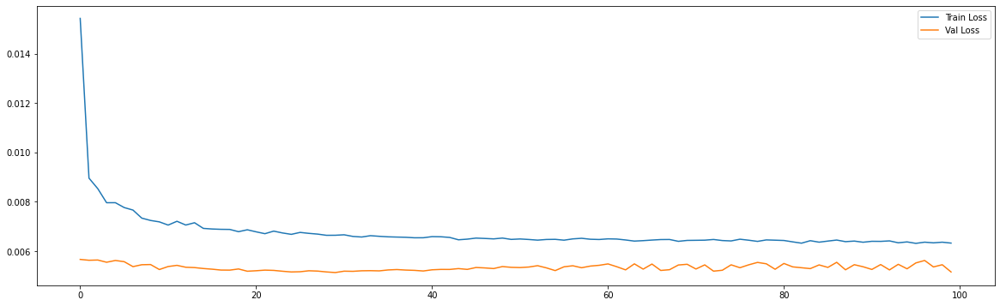

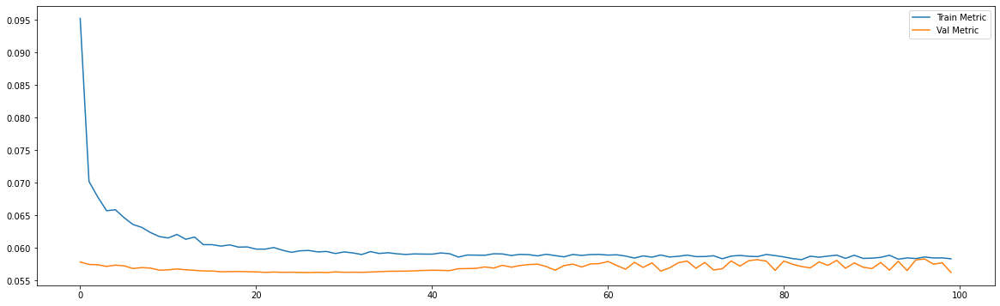

Epoch 00090: early stopping
============================model:45===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0063 - mae: 0.0569
loss and metric train data [0.006304164882749319, 0.05694340914487839]
10/10 [==============================] - 0s 16ms/step - loss: 0.0054 - mae: 0.0576
loss and metric val data [0.005427387543022633, 0.05757404863834381]
10/10 [==============================] - 0s 17ms/step - loss: 0.0069 - mae: 0.0609
loss and metric test data [0.006887415889650583, 0.0608648918569088]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




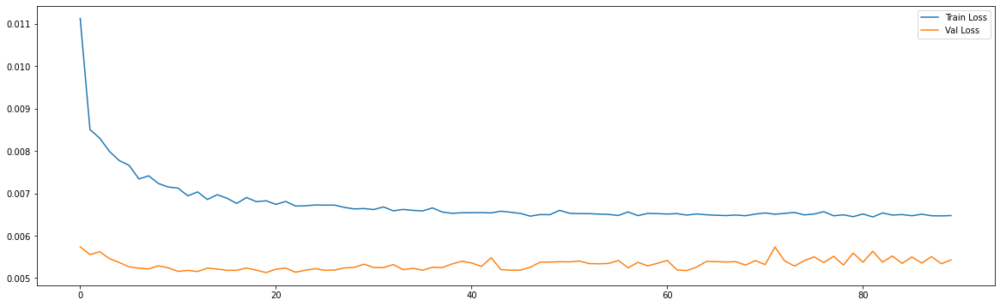

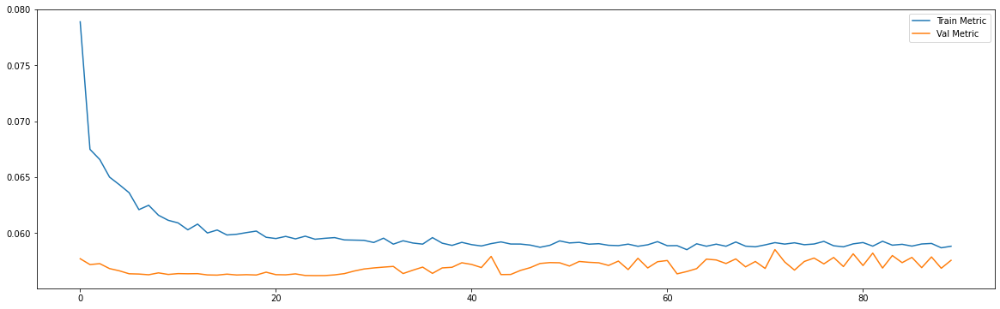

Epoch 00125: early stopping
============================model:46===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0062 - mae: 0.0579
loss and metric train data [0.00624520517885685, 0.05793461948633194]
10/10 [==============================] - 0s 8ms/step - loss: 0.0054 - mae: 0.0589
loss and metric val data [0.00541342981159687, 0.058895859867334366]
10/10 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0611
loss and metric test data [0.006698551122099161, 0.0611250214278698]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




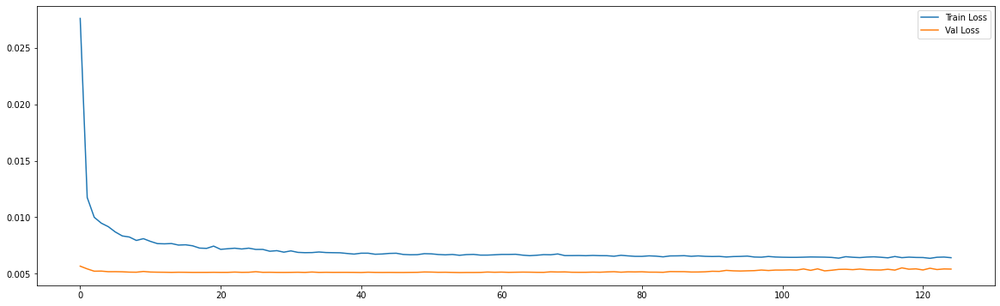

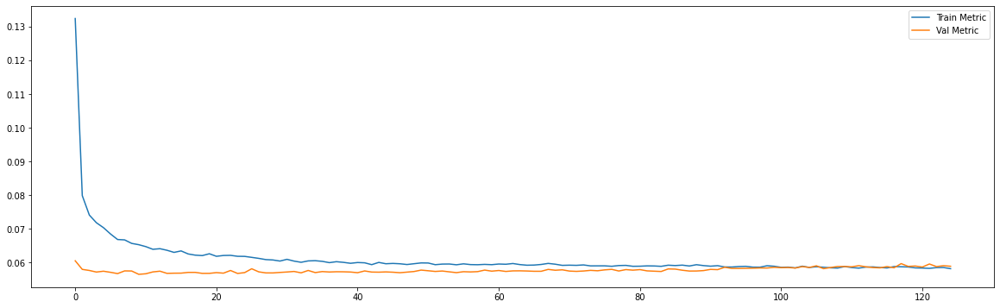

Epoch 00095: early stopping
============================model:47===========================
43/43 [==============================] - 1s 18ms/step - loss: 0.0063 - mae: 0.0580
loss and metric train data [0.006273740436881781, 0.05796418711543083]
10/10 [==============================] - 0s 16ms/step - loss: 0.0053 - mae: 0.0585
loss and metric val data [0.005340289324522018, 0.0584736131131649]
10/10 [==============================] - 0s 17ms/step - loss: 0.0067 - mae: 0.0612
loss and metric test data [0.006742838304489851, 0.06119615212082863]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




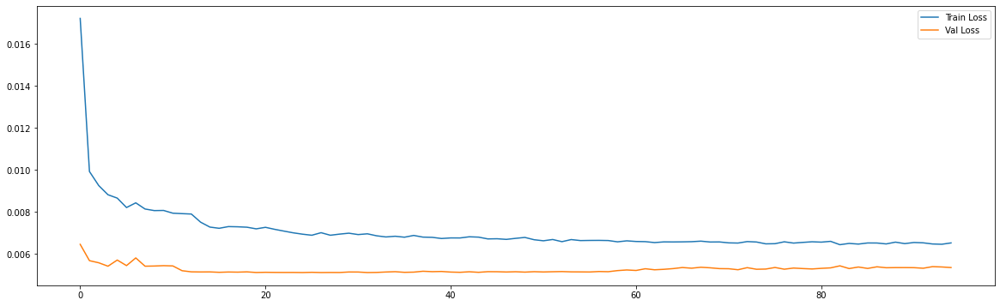

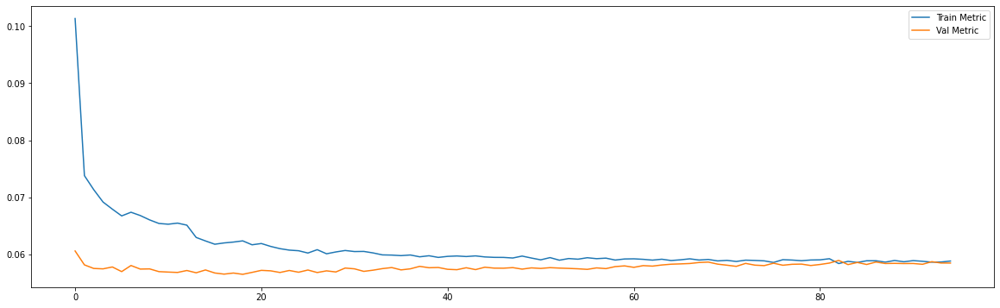

In [45]:
future_steps = 5
n_features = df_train.shape[1]

neurons_list = [30,50]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120]
batch_size_list = [32,64]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for batch_size in batch_size_list:
        for lr in lr_list:
          x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch_size, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch_size,lr,1)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=future_steps))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          # early stop
          es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = batch_size, verbose = 0, shuffle = False, callbacks = [es])

          print('============================model:{}==========================='.format(i))

            
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          i+=1


          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch_size, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch_size,lr,2)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False))
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=future_steps))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          # early stop
          es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = batch_size, verbose = 0, shuffle = False, callbacks = [es])

          print('============================model:{}==========================='.format(i))

            
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          i+=1

### Best Model Resume

`Validation metric as evaluation parameter`


Epoch 00338: early stopping

============================model:37===========================

45/45 [==============================] - 0s 6ms/step - loss: 0.0056 - mae: 0.0549

loss and metric train data [0.005609562620520592, 0.05490262433886528]

10/10 [==============================] - 0s 6ms/step - loss: 0.0050 - mae: 0.0548

loss and metric val data [0.004966873675584793, 0.054787565022706985]

10/10 [==============================] - 0s 6ms/step - loss: 0.0065 - mae: 0.0586

loss and metric test data [0.00652315141633153, 0.05860403552651405]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2

In [46]:
models[37]

{'batch_size': 32,
 'dropout': 0.4,
 'learning_rate': 0.001,
 'model': <tensorflow.python.keras.engine.sequential.Sequential at 0x7f1e40967198>,
 'neurons': 50,
 'resumo': "'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2",
 'time_steps': 30}

Saving the Model

In [47]:
models[37]['model'].save("/content/drive/My Drive/ML Projects/Pharma Sales/LSTM_multiFeature_mostRelevantFeatures.h5")

Ploting the model prediction

In [48]:
future_steps = 5
n_features = df_train.shape[1]
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = 30,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

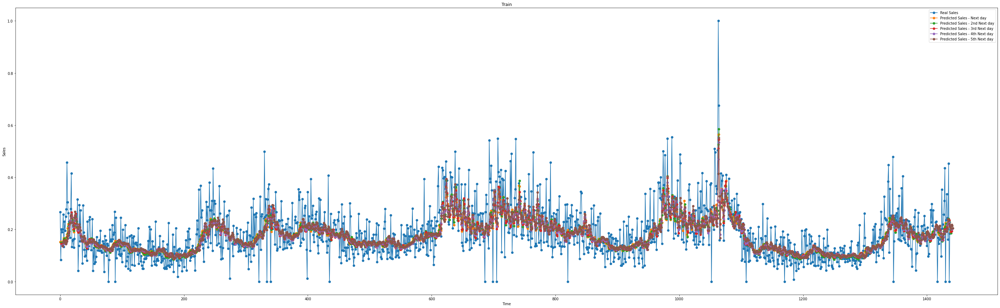

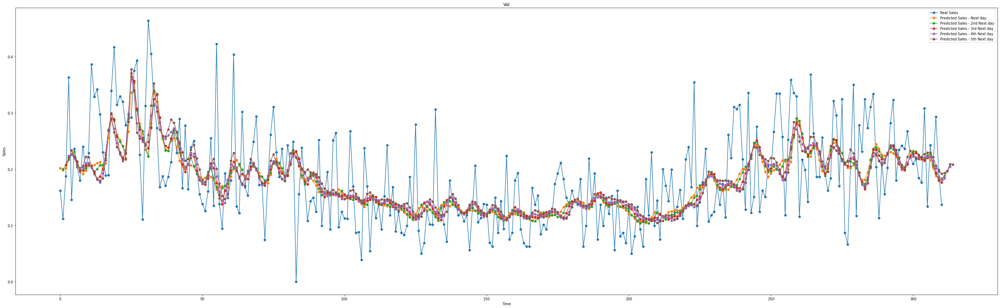

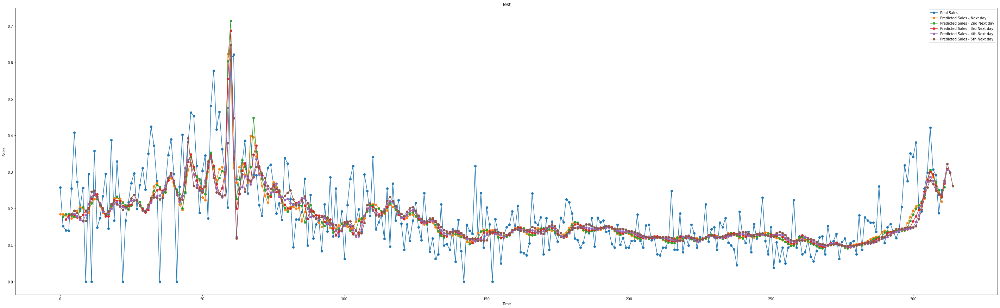

In [49]:
y_train_predict = models[37]['model'].predict(x_train)
y_val_predict = models[37]['model'].predict(x_val)
y_test_predict = models[37]['model'].predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

## LSTM

Weekday, motn as cyclic + most relevant features

In [18]:
df_daily = df_daily[['weekday','month','lag1','rolling_mean_2','rolling_mean_3','N02BE']]
df_daily.fillna(0,inplace = True)
df_daily

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4153: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  downcast=downcast,


,weekday,month,lag1,rolling_mean_2,rolling_mean_3,N02BE
0,4,1,0.00,0.000,0.000000,32.40
1,5,1,32.40,41.500,0.000000,50.60
2,6,1,50.60,56.225,48.283333,61.85
3,7,1,61.85,51.475,51.183333,41.10
4,1,1,41.10,31.400,41.550000,21.70
...,...,...,...,...,...,...
2101,5,10,40.40,31.425,31.016667,22.45
2102,6,10,22.45,23.925,29.416667,25.40
2103,7,10,25.40,30.000,27.483333,34.60
2104,1,10,34.60,42.700,36.933333,50.80


In [19]:
df_train,df_val,df_test = dataSplit(df = df_daily,train_percent = 0.7,val_percent = 0.15)

df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange = (0,1))

(1474, 6)
(316, 6)
(316, 6)
[1. 1. 1. 1. 1. 1.]
[0. 0. 0. 0. 0. 0.]


[1.         0.90909091 0.46335404 0.51821283 0.54192647 0.46335404]
[0.         0.         0.         0.07067853 0.08834426 0.        ]


[1.         1.         0.62173913 0.73377827 0.69222001 0.62173913]
[0.         0.         0.         0.05005562 0.09119407 0.        ]
-------------------------
(1474, 6)
(316, 6)
(316, 6)


Epoch 00212: early stopping
============================model:0===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0571
loss and metric train data [0.005984968971461058, 0.057075135409832]
10/10 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0548
loss and metric val data [0.004899426829069853, 0.05483999475836754]
10/10 [==============================] - 0s 2ms/step - loss: 0.0058 - mae: 0.0570
loss and metric test data [0.005794363562017679, 0.05704186111688614]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




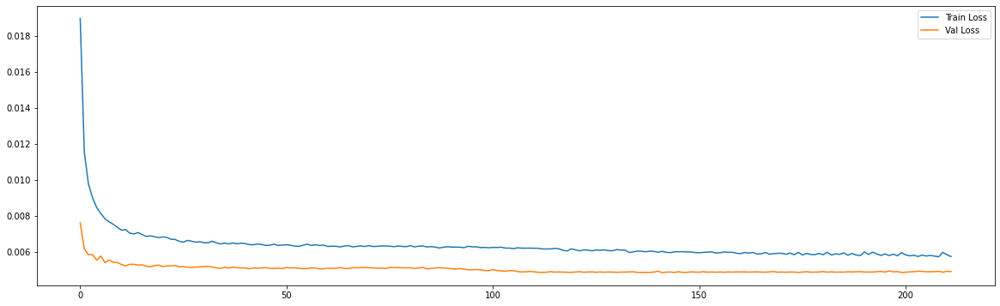

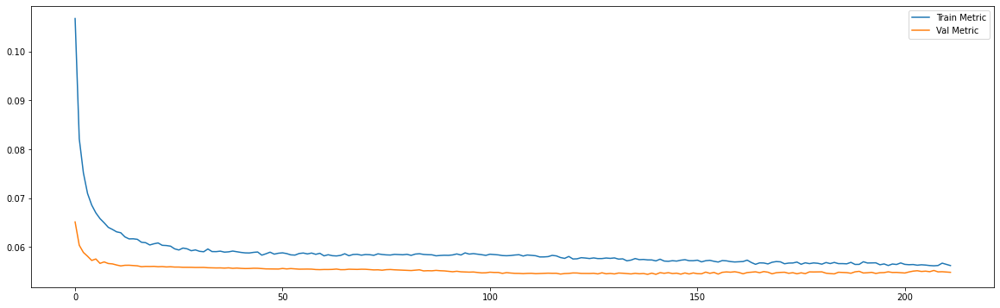

Epoch 00238: early stopping
============================model:1===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0527
loss and metric train data [0.004940756130963564, 0.052726712077856064]
10/10 [==============================] - 0s 3ms/step - loss: 0.0052 - mae: 0.0560
loss and metric val data [0.005186604335904121, 0.05599507689476013]
10/10 [==============================] - 0s 3ms/step - loss: 0.0059 - mae: 0.0569
loss and metric test data [0.005914464592933655, 0.05686182156205177]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




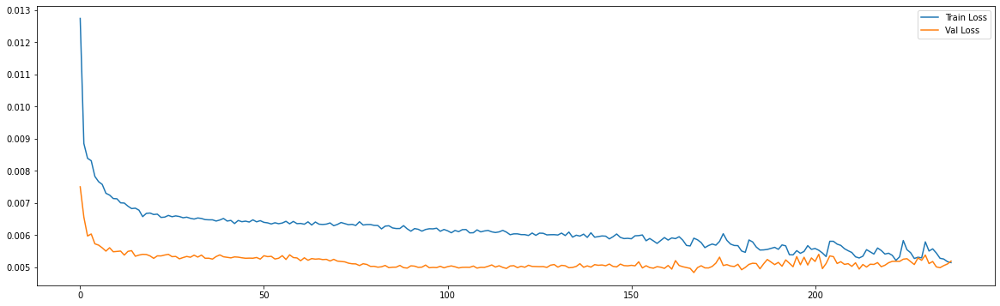

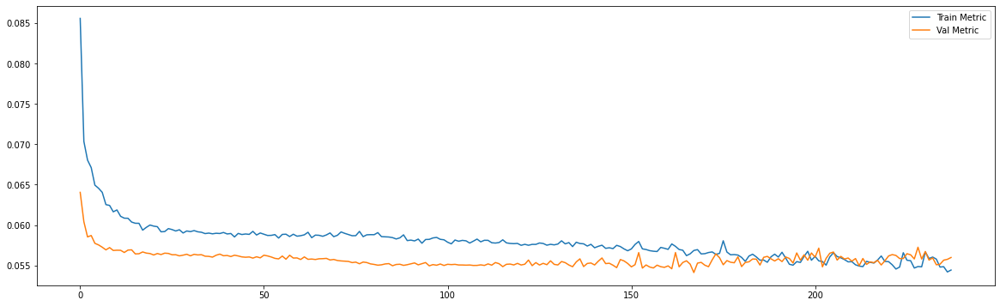

Epoch 00270: early stopping
============================model:2===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0057 - mae: 0.0561
loss and metric train data [0.0057241423055529594, 0.05611603707075119]
10/10 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0555
loss and metric val data [0.004913500044494867, 0.055549148470163345]
10/10 [==============================] - 0s 2ms/step - loss: 0.0060 - mae: 0.0584
loss and metric test data [0.0059942081570625305, 0.058379966765642166]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




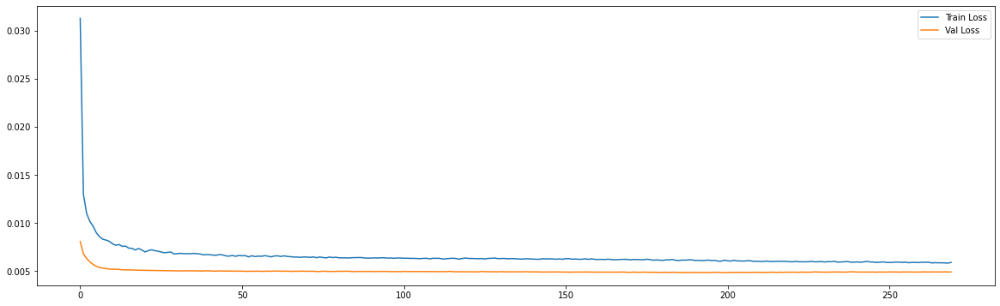

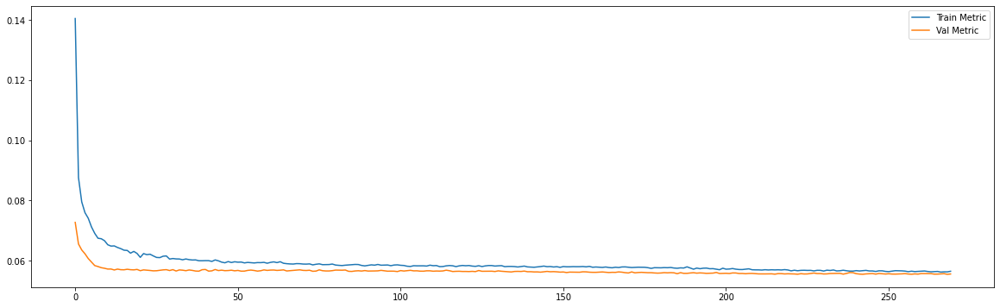

Epoch 00222: early stopping
============================model:3===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0563
loss and metric train data [0.005664057098329067, 0.05633682385087013]
10/10 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0562
loss and metric val data [0.0049826824106276035, 0.0561881922185421]
10/10 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0583
loss and metric test data [0.005975291598588228, 0.05828499421477318]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




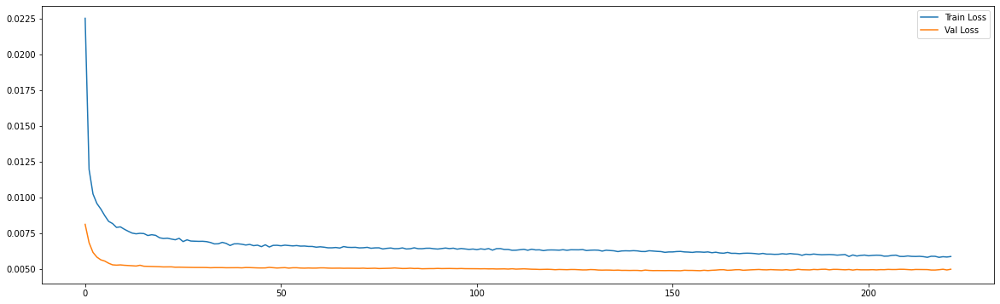

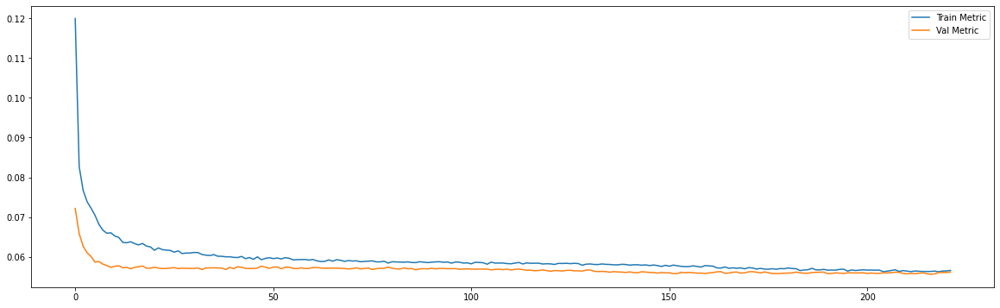

Epoch 00120: early stopping
============================model:4===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0056 - mae: 0.0546
loss and metric train data [0.005630427971482277, 0.054639872163534164]
10/10 [==============================] - 0s 2ms/step - loss: 0.0051 - mae: 0.0557
loss and metric val data [0.005110334604978561, 0.05570999160408974]
10/10 [==============================] - 0s 3ms/step - loss: 0.0061 - mae: 0.0574
loss and metric test data [0.006128562148660421, 0.05735759064555168]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




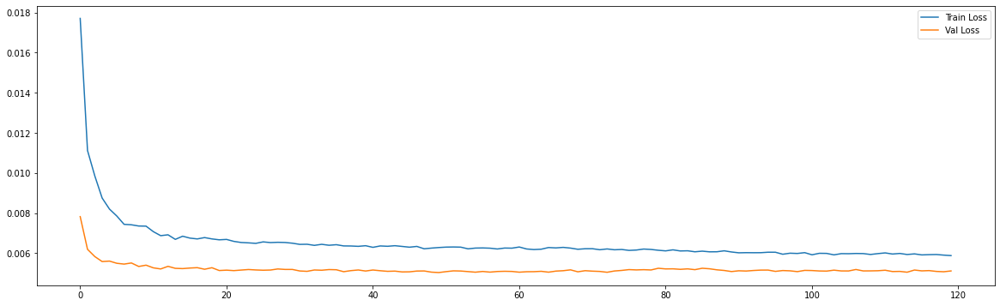

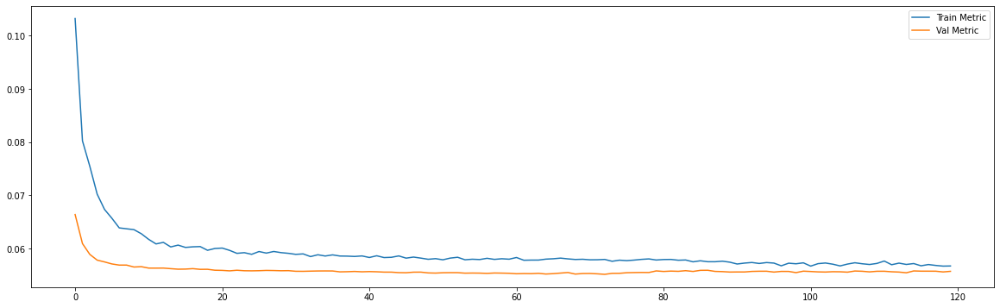

Epoch 00271: early stopping
============================model:5===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0046 - mae: 0.0518
loss and metric train data [0.004645321052521467, 0.05179049074649811]
10/10 [==============================] - 0s 3ms/step - loss: 0.0054 - mae: 0.0572
loss and metric val data [0.005432347767055035, 0.05718058720231056]
10/10 [==============================] - 0s 4ms/step - loss: 0.0068 - mae: 0.0603
loss and metric test data [0.00677387835457921, 0.060289427638053894]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




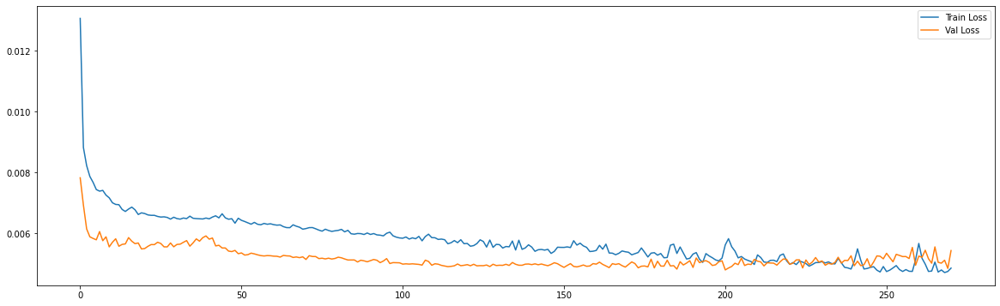

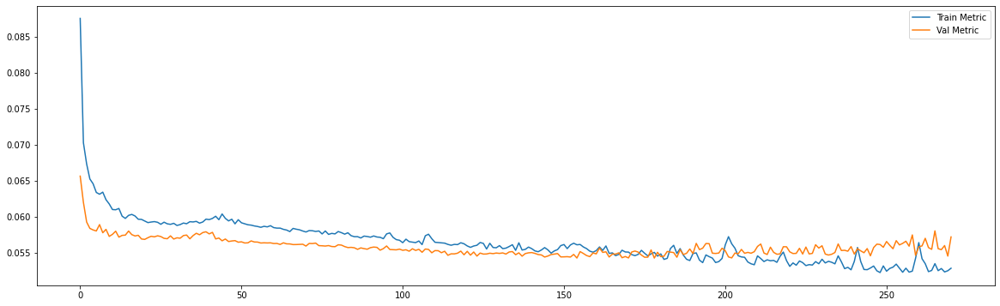

Epoch 00225: early stopping
============================model:6===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0055 - mae: 0.0546
loss and metric train data [0.005507329944521189, 0.0545538105070591]
10/10 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0558
loss and metric val data [0.00496876472607255, 0.05575922876596451]
10/10 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0580
loss and metric test data [0.006045553367584944, 0.05803995579481125]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




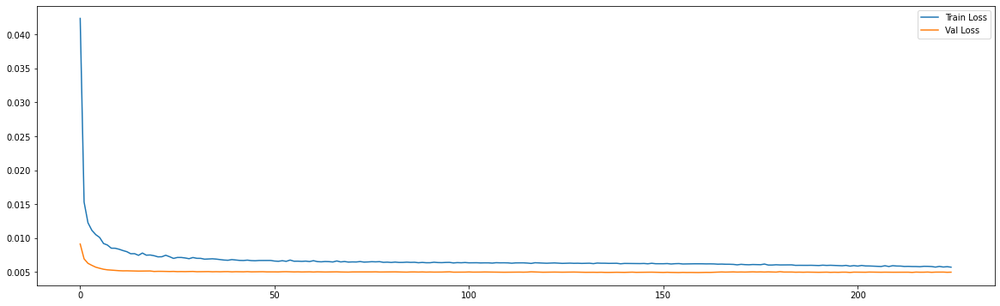

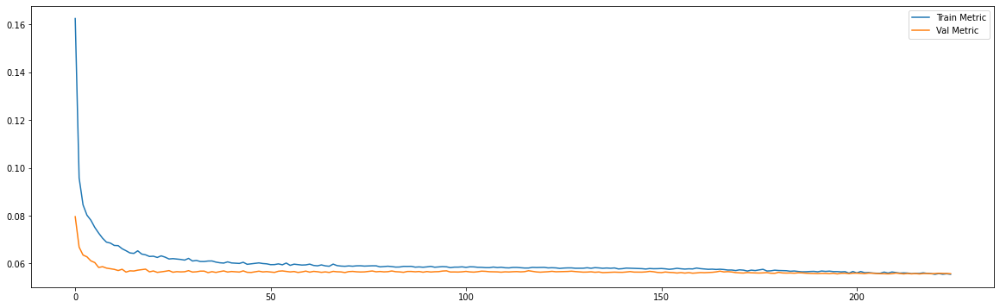

Epoch 00398: early stopping
============================model:7===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0045 - mae: 0.0505
loss and metric train data [0.004495462402701378, 0.05047646537423134]
10/10 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0559
loss and metric val data [0.005160939879715443, 0.05591117590665817]
10/10 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0586
loss and metric test data [0.006238242611289024, 0.05855591595172882]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




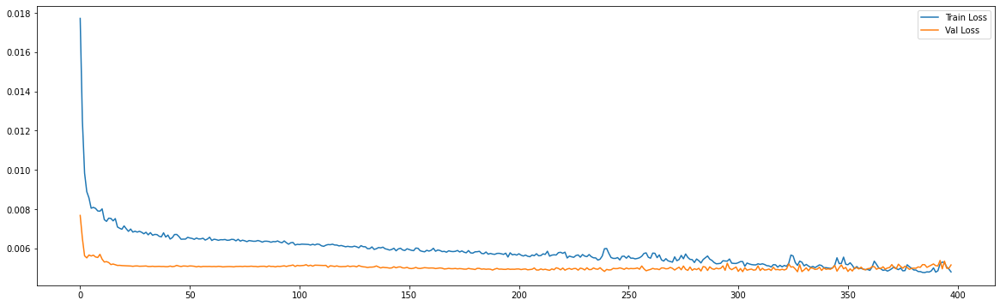

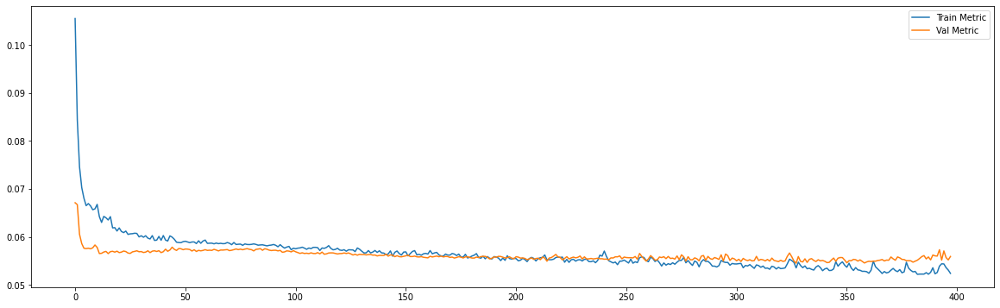

Epoch 00267: early stopping
============================model:8===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0542
loss and metric train data [0.005112047307193279, 0.05416921526193619]
10/10 [==============================] - 0s 3ms/step - loss: 0.0053 - mae: 0.0577
loss and metric val data [0.005305551923811436, 0.05769747495651245]
10/10 [==============================] - 0s 3ms/step - loss: 0.0062 - mae: 0.0590
loss and metric test data [0.006200403906404972, 0.05901527404785156]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




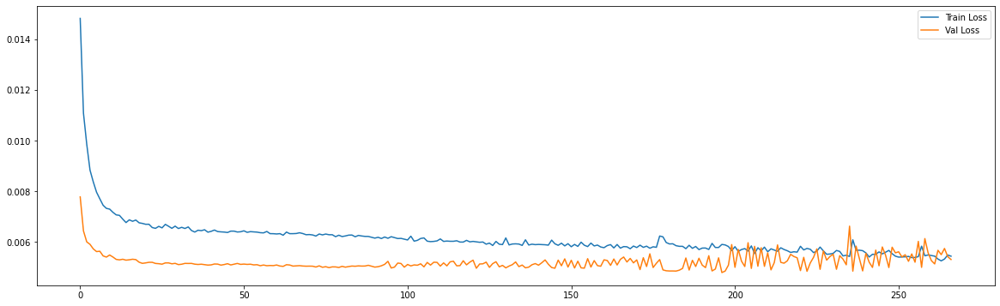

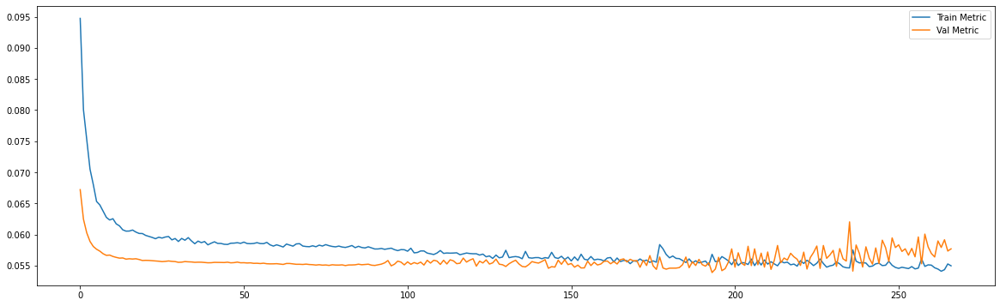

Epoch 00211: early stopping
============================model:9===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0540
loss and metric train data [0.005193433724343777, 0.05397284775972366]
10/10 [==============================] - 0s 6ms/step - loss: 0.0052 - mae: 0.0564
loss and metric val data [0.005227436311542988, 0.05641934275627136]
10/10 [==============================] - 0s 5ms/step - loss: 0.0066 - mae: 0.0595
loss and metric test data [0.00659379456192255, 0.05951150506734848]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




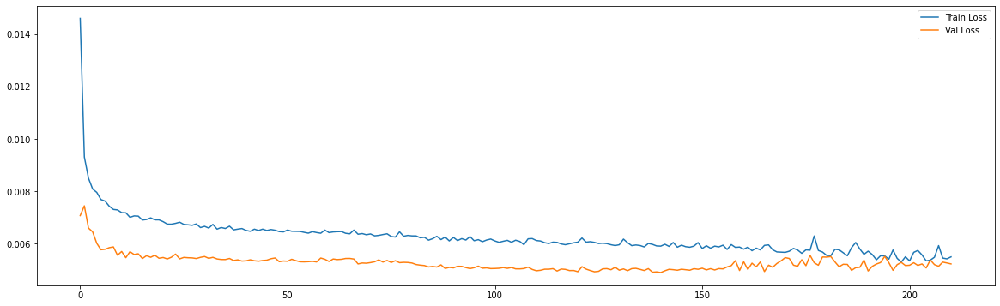

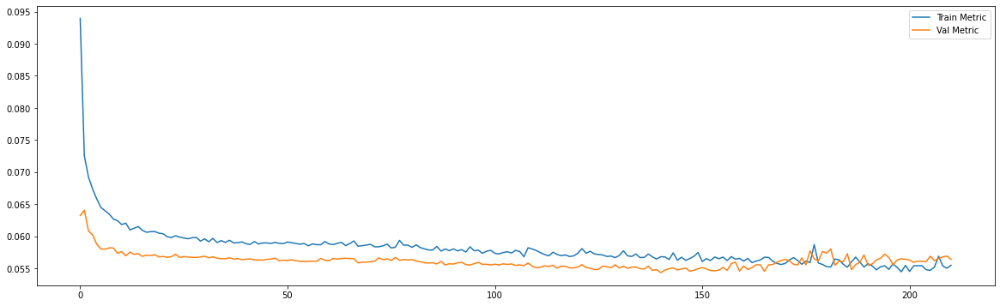

Epoch 00204: early stopping
============================model:10===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0554
loss and metric train data [0.005681274924427271, 0.05536489933729172]
10/10 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0564
loss and metric val data [0.005084481090307236, 0.056362610310316086]
10/10 [==============================] - 0s 3ms/step - loss: 0.0064 - mae: 0.0600
loss and metric test data [0.0064447782933712006, 0.0600050650537014]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




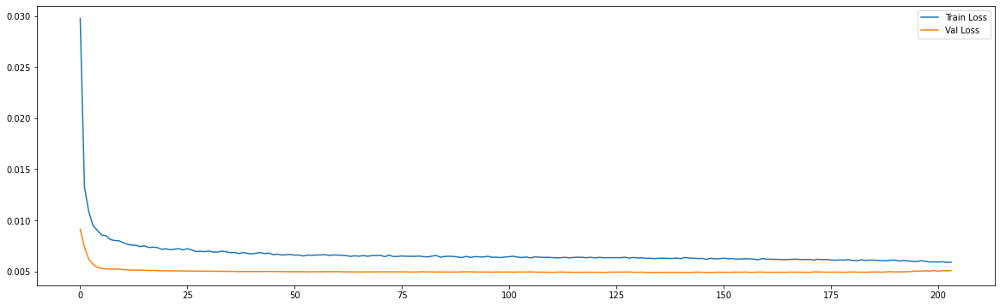

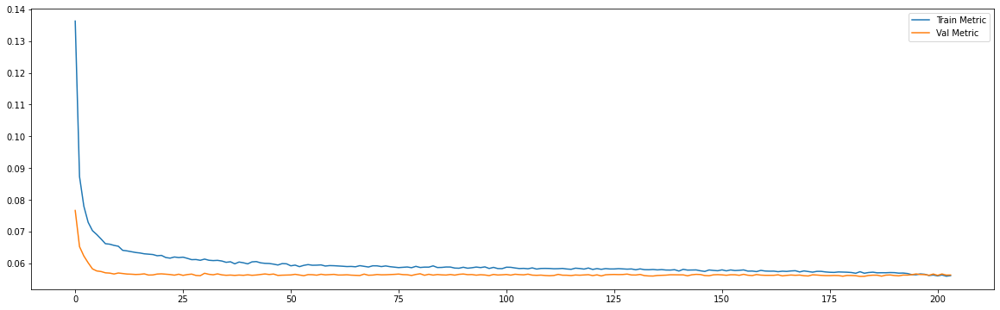

Epoch 00239: early stopping
============================model:11===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0542
loss and metric train data [0.005211884155869484, 0.054232463240623474]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0564
loss and metric val data [0.005201312713325024, 0.05637877807021141]
10/10 [==============================] - 0s 5ms/step - loss: 0.0061 - mae: 0.0591
loss and metric test data [0.00610974570736289, 0.059084706008434296]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




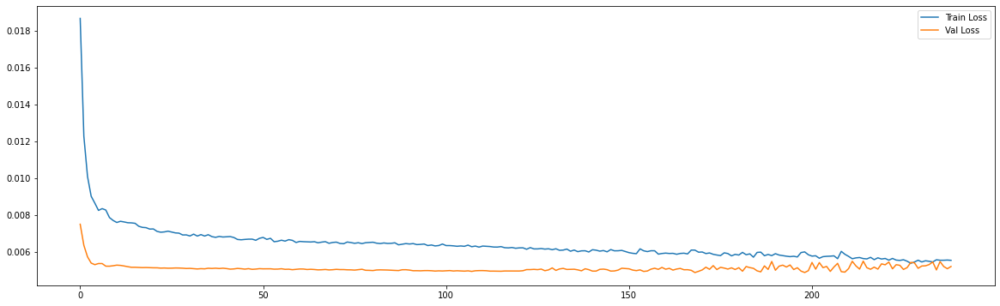

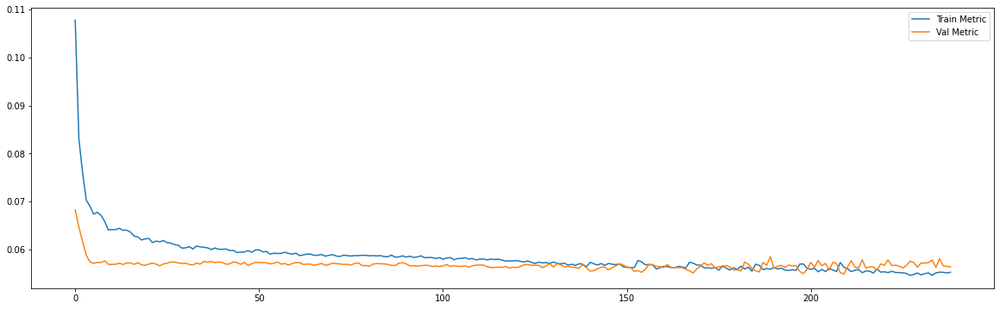

Epoch 00205: early stopping
============================model:12===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0561
loss and metric train data [0.005743738729506731, 0.05608309060335159]
10/10 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0549
loss and metric val data [0.004906407557427883, 0.05492406710982323]
10/10 [==============================] - 0s 2ms/step - loss: 0.0060 - mae: 0.0577
loss and metric test data [0.006009384989738464, 0.05770627036690712]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




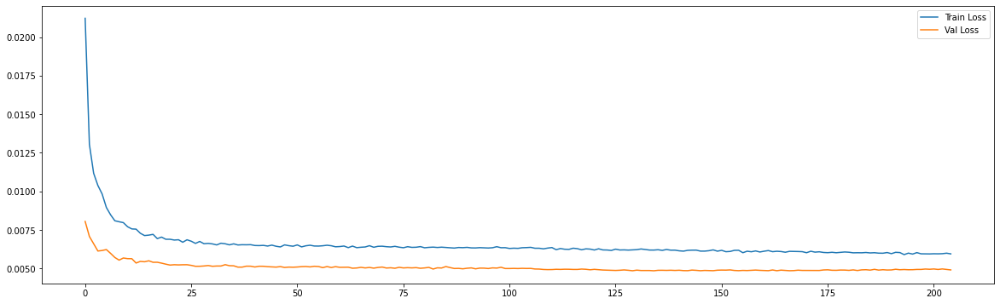

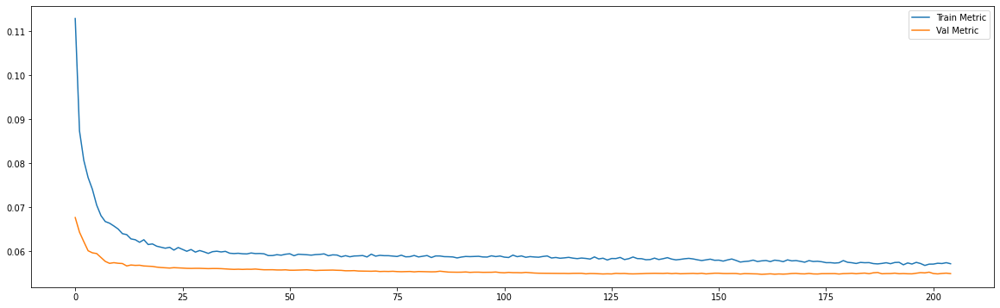

Epoch 00183: early stopping
============================model:13===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0556
loss and metric train data [0.005697271786630154, 0.05562204495072365]
10/10 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0559
loss and metric val data [0.005118461325764656, 0.05590318515896797]
10/10 [==============================] - 0s 3ms/step - loss: 0.0061 - mae: 0.0576
loss and metric test data [0.006092362571507692, 0.0576087161898613]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




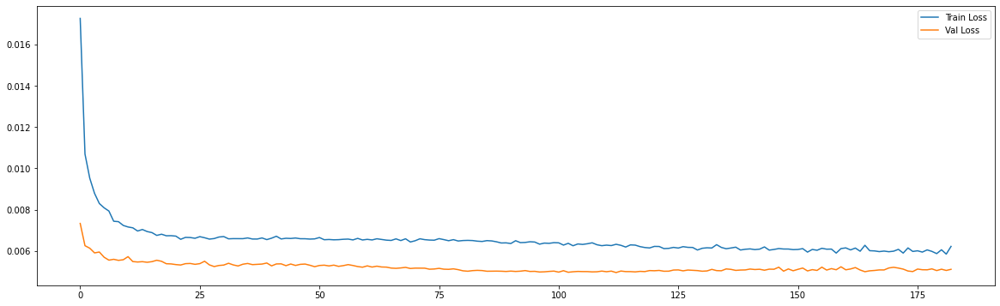

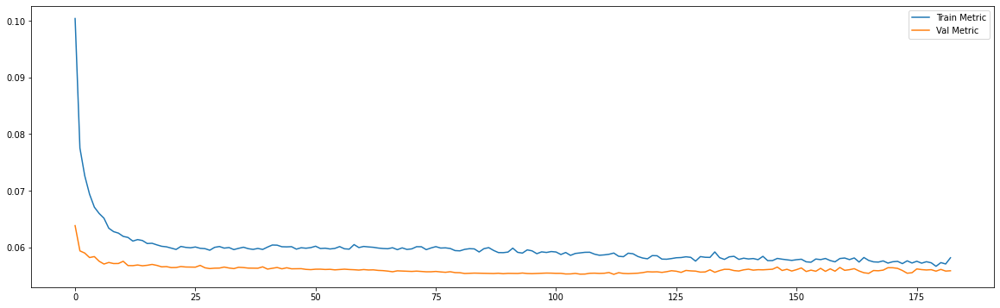

Epoch 00203: early stopping
============================model:14===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0059 - mae: 0.0570
loss and metric train data [0.005891679786145687, 0.05697481334209442]
10/10 [==============================] - 0s 2ms/step - loss: 0.0050 - mae: 0.0565
loss and metric val data [0.004972589202225208, 0.0564623661339283]
10/10 [==============================] - 0s 3ms/step - loss: 0.0061 - mae: 0.0592
loss and metric test data [0.006141395773738623, 0.059208087623119354]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




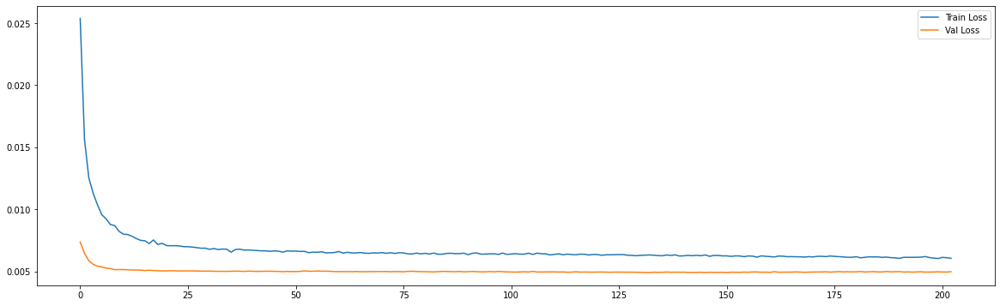

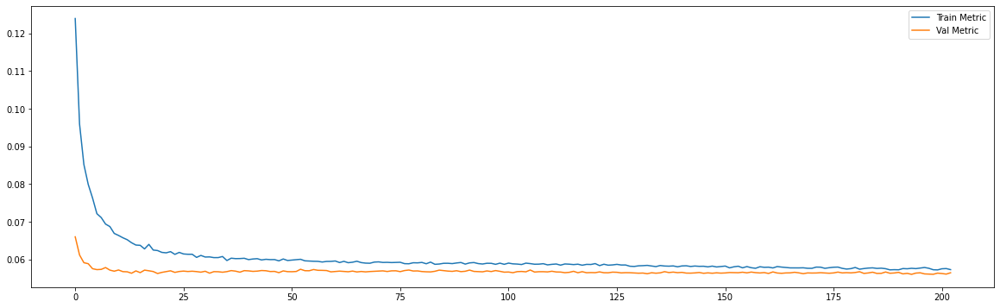

Epoch 00263: early stopping
============================model:15===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0561
loss and metric train data [0.005747406743466854, 0.05611448734998703]
10/10 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0557
loss and metric val data [0.004934653174132109, 0.05572790652513504]
10/10 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0582
loss and metric test data [0.006009087432175875, 0.05820903554558754]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




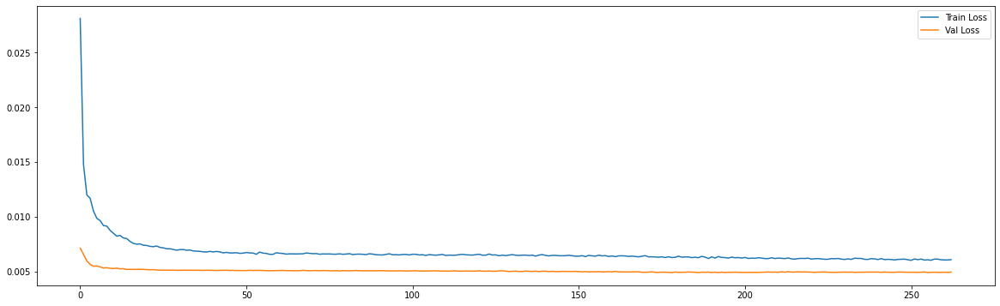

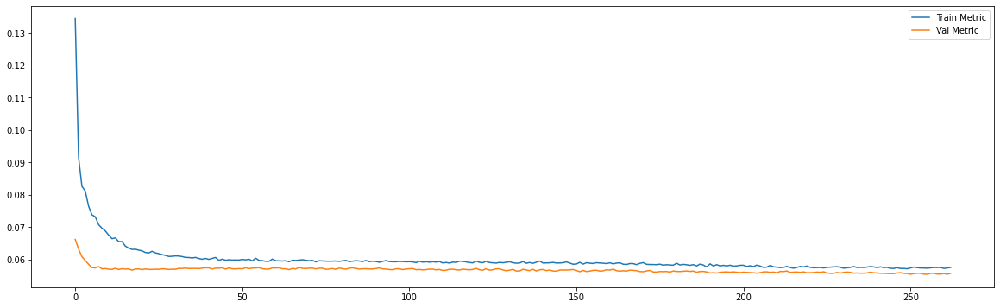

Epoch 00121: early stopping
============================model:16===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0059 - mae: 0.0555
loss and metric train data [0.005930616520345211, 0.05553049221634865]
10/10 [==============================] - 0s 3ms/step - loss: 0.0053 - mae: 0.0562
loss and metric val data [0.005252188537269831, 0.05623839423060417]
10/10 [==============================] - 0s 3ms/step - loss: 0.0065 - mae: 0.0582
loss and metric test data [0.006506850942969322, 0.05822840332984924]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




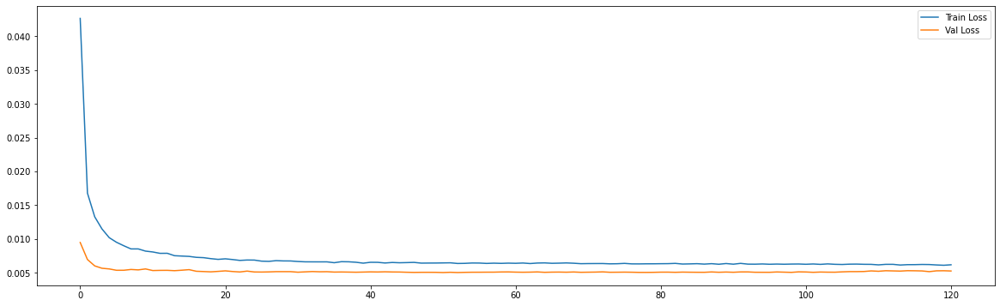

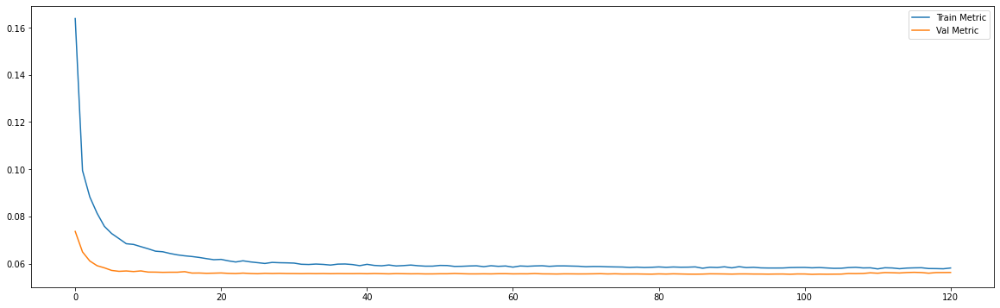

Epoch 00239: early stopping
============================model:17===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0052 - mae: 0.0539
loss and metric train data [0.005176278296858072, 0.053930219262838364]
10/10 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0550
loss and metric val data [0.004977251403033733, 0.05498280003666878]
10/10 [==============================] - 0s 5ms/step - loss: 0.0059 - mae: 0.0567
loss and metric test data [0.005903206765651703, 0.056720249354839325]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




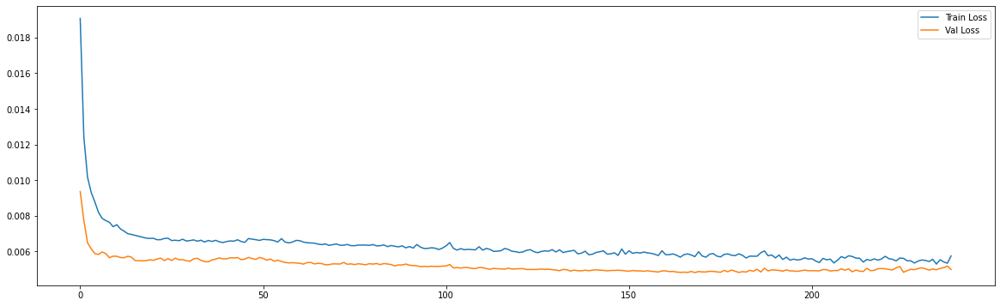

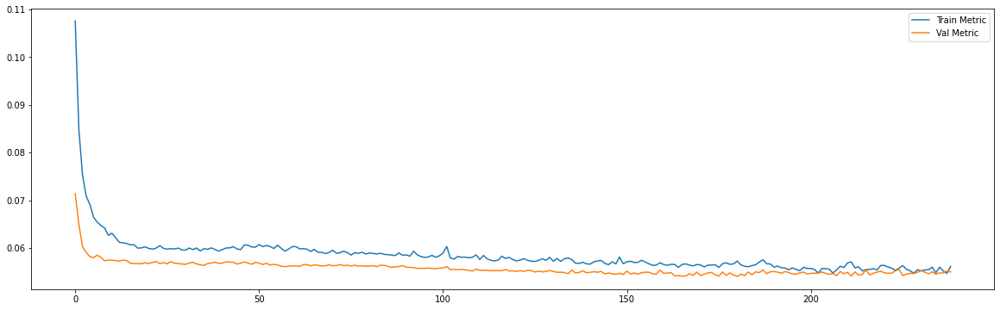

============================model:18===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0526
loss and metric train data [0.00494787422940135, 0.05262923240661621]
10/10 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0545
loss and metric val data [0.004812784492969513, 0.05451282858848572]
10/10 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0575
loss and metric test data [0.005989494733512402, 0.057508476078510284]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




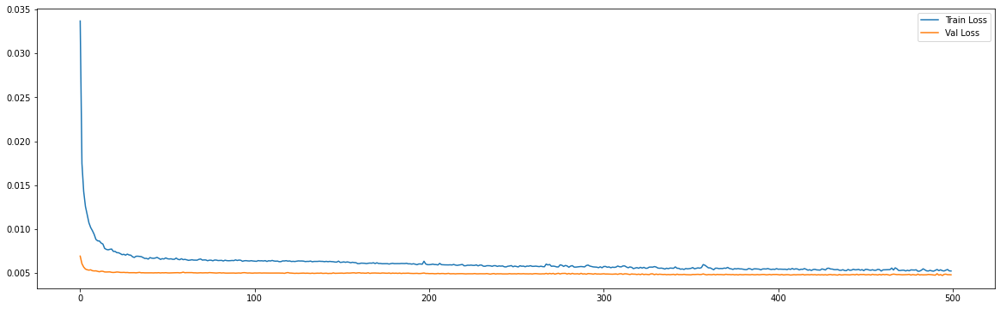

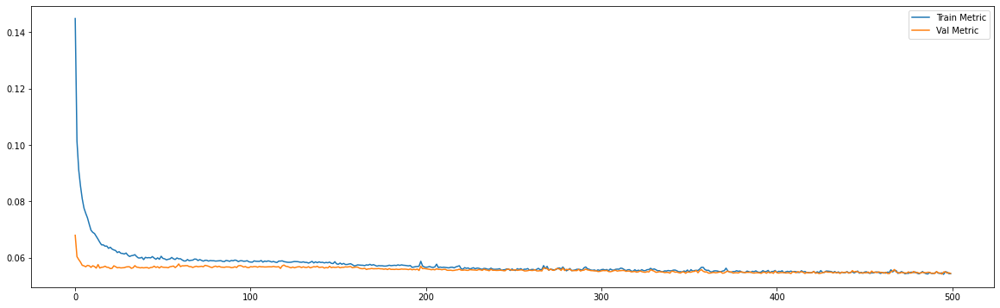

Epoch 00424: early stopping
============================model:19===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0521
loss and metric train data [0.004854306578636169, 0.05214681476354599]
10/10 [==============================] - 0s 4ms/step - loss: 0.0051 - mae: 0.0550
loss and metric val data [0.005062677897512913, 0.05502902716398239]
10/10 [==============================] - 0s 4ms/step - loss: 0.0060 - mae: 0.0567
loss and metric test data [0.005986756179481745, 0.05670579895377159]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




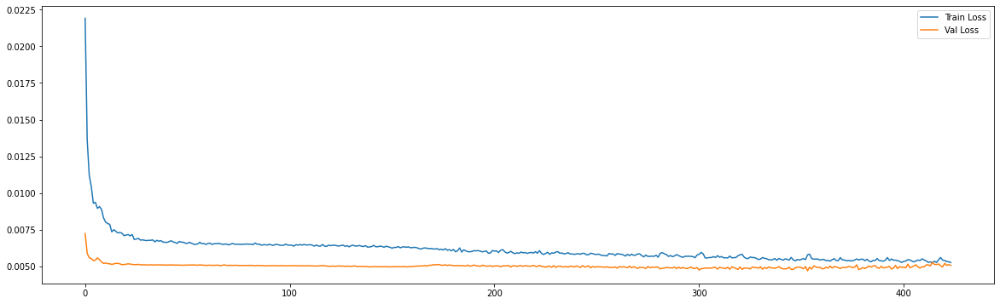

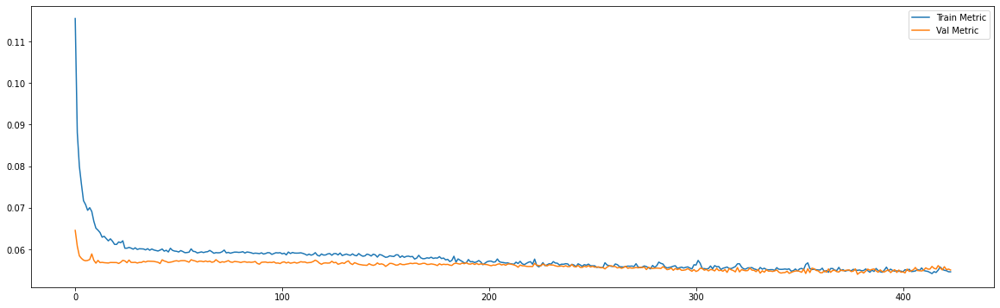

Epoch 00183: early stopping
============================model:20===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0556
loss and metric train data [0.005724581889808178, 0.05557830631732941]
10/10 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0553
loss and metric val data [0.004943684674799442, 0.055302880704402924]
10/10 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0592
loss and metric test data [0.006219223607331514, 0.059246595948934555]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




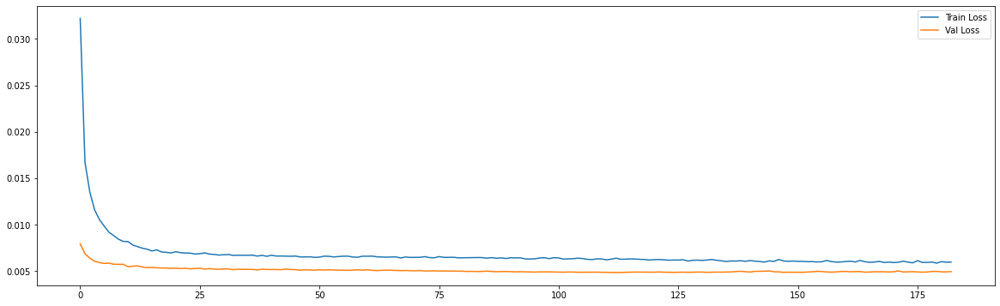

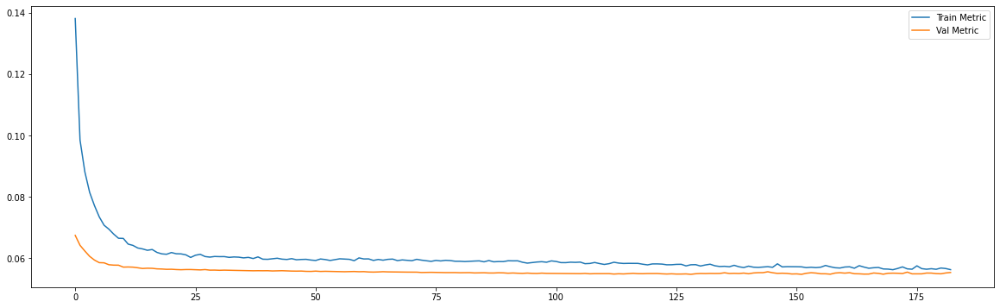

Epoch 00210: early stopping
============================model:21===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0543
loss and metric train data [0.0051683164201676846, 0.0542820580303669]
10/10 [==============================] - 0s 5ms/step - loss: 0.0052 - mae: 0.0578
loss and metric val data [0.005175104830414057, 0.057792406529188156]
10/10 [==============================] - 0s 5ms/step - loss: 0.0061 - mae: 0.0588
loss and metric test data [0.006082259118556976, 0.058810923248529434]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




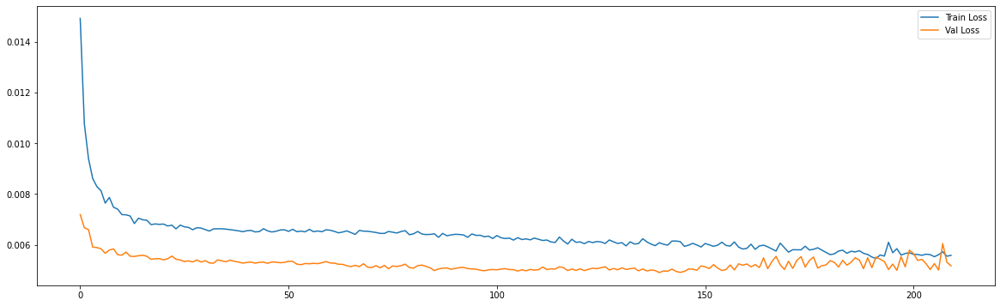

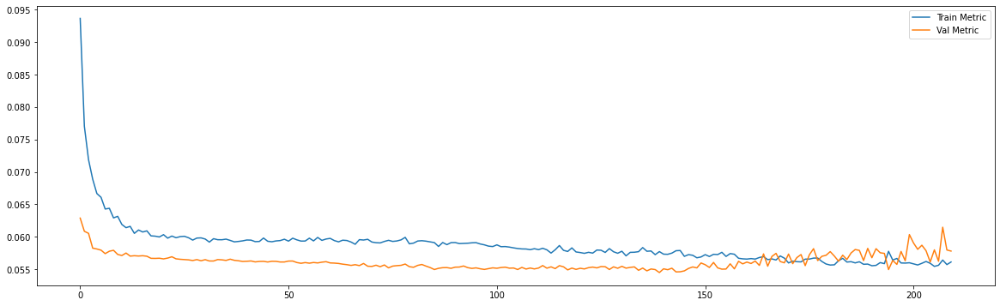

Epoch 00315: early stopping
============================model:22===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0054 - mae: 0.0549
loss and metric train data [0.005406911019235849, 0.05493481457233429]
10/10 [==============================] - 0s 3ms/step - loss: 0.0052 - mae: 0.0570
loss and metric val data [0.005236195400357246, 0.05695173889398575]
10/10 [==============================] - 0s 3ms/step - loss: 0.0062 - mae: 0.0596
loss and metric test data [0.006171470507979393, 0.059637926518917084]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




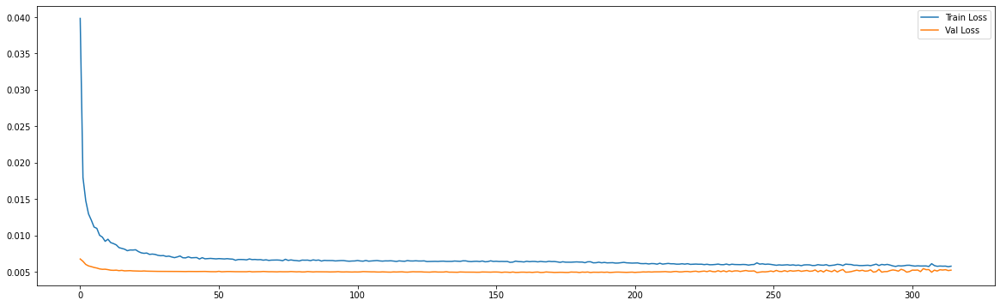

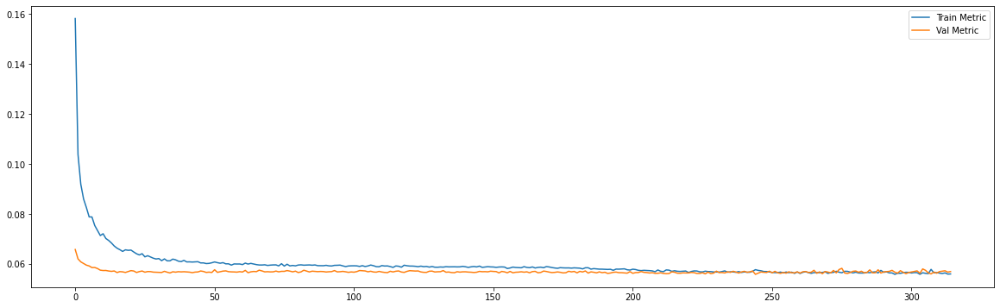

Epoch 00398: early stopping
============================model:23===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0050 - mae: 0.0531
loss and metric train data [0.004985225386917591, 0.05308614298701286]
10/10 [==============================] - 0s 5ms/step - loss: 0.0053 - mae: 0.0577
loss and metric val data [0.005330722779035568, 0.05774271860718727]
10/10 [==============================] - 0s 5ms/step - loss: 0.0064 - mae: 0.0591
loss and metric test data [0.006383413914591074, 0.059086840599775314]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




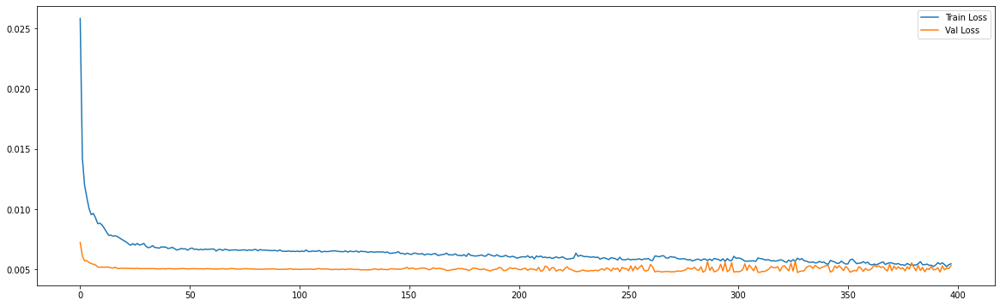

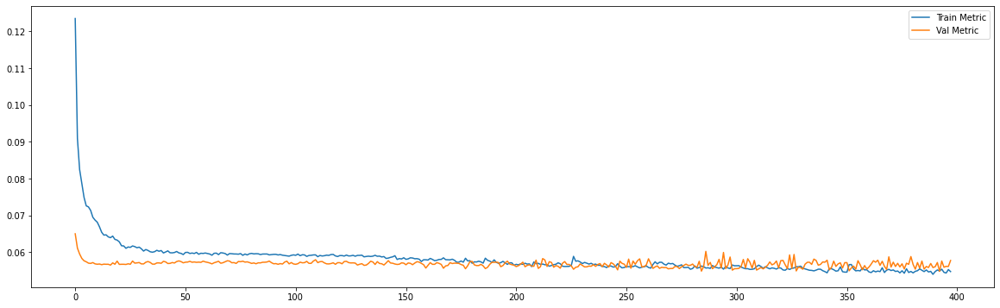

Epoch 00199: early stopping
============================model:24===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0053 - mae: 0.0542
loss and metric train data [0.005263224709779024, 0.05418737977743149]
10/10 [==============================] - 0s 2ms/step - loss: 0.0051 - mae: 0.0559
loss and metric val data [0.005056046415120363, 0.05592283606529236]
10/10 [==============================] - 0s 2ms/step - loss: 0.0067 - mae: 0.0598
loss and metric test data [0.006660045124590397, 0.059759471565485]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




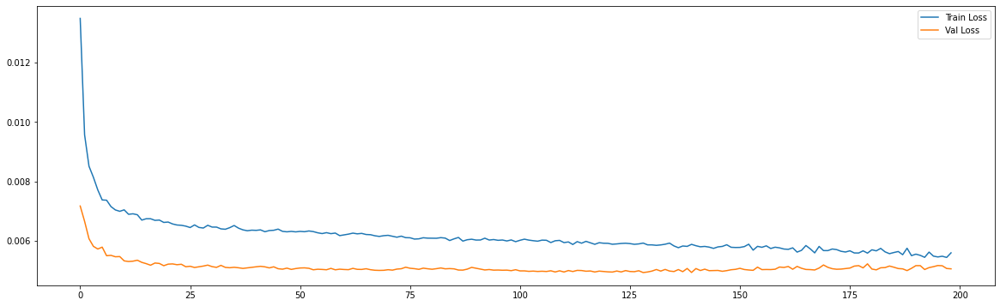

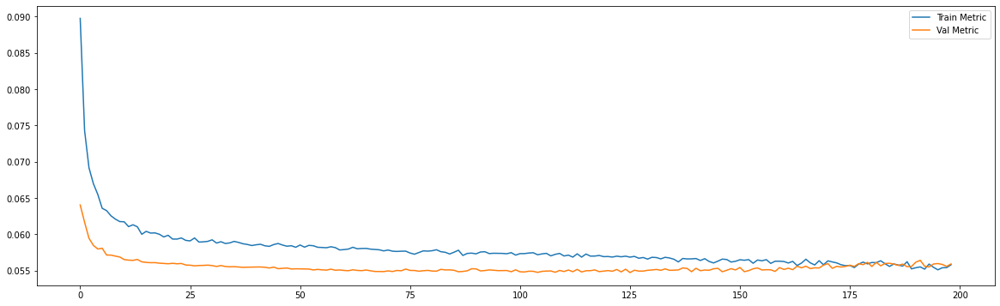

Epoch 00205: early stopping
============================model:25===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0526
loss and metric train data [0.004815723747014999, 0.05257387086749077]
10/10 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0547
loss and metric val data [0.004995896015316248, 0.054717835038900375]
10/10 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0578
loss and metric test data [0.005981043912470341, 0.0577685609459877]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




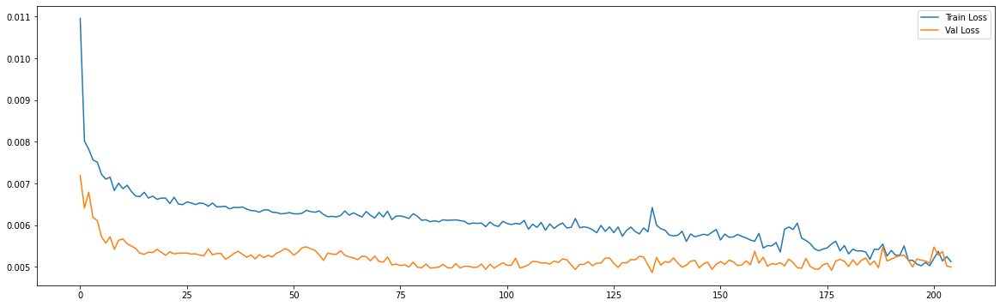

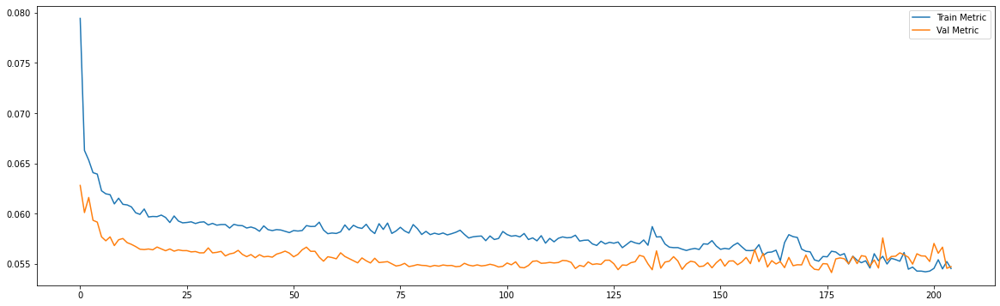

Epoch 00154: early stopping
============================model:26===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0560
loss and metric train data [0.0057206349447369576, 0.05604688450694084]
10/10 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0558
loss and metric val data [0.004941513761878014, 0.055821385234594345]
10/10 [==============================] - 0s 2ms/step - loss: 0.0060 - mae: 0.0586
loss and metric test data [0.005972151644527912, 0.05855753645300865]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




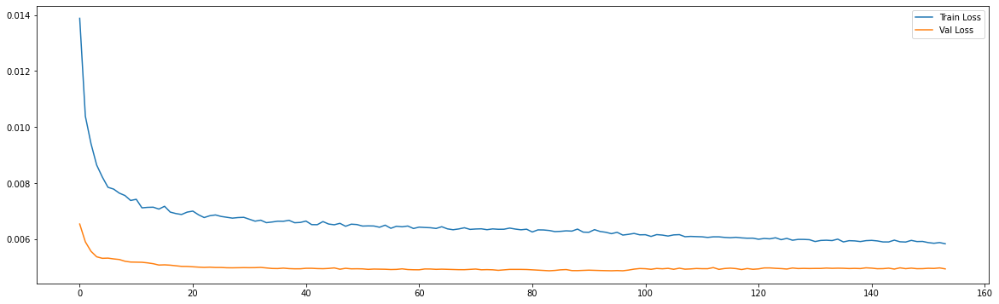

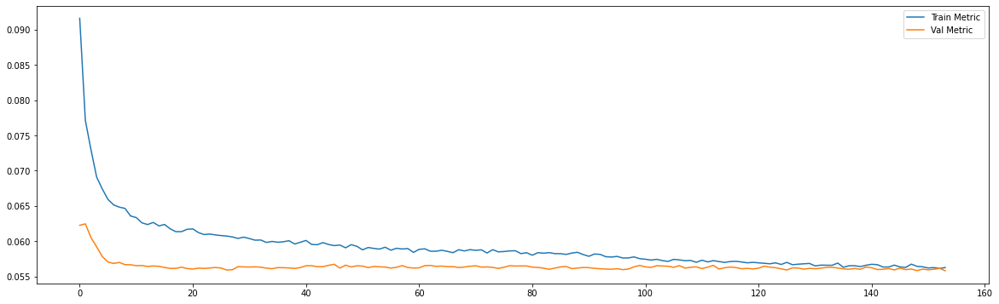

Epoch 00153: early stopping
============================model:27===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0562
loss and metric train data [0.005712388549000025, 0.05619259178638458]
10/10 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0555
loss and metric val data [0.004963716957718134, 0.055502619594335556]
10/10 [==============================] - 0s 3ms/step - loss: 0.0059 - mae: 0.0573
loss and metric test data [0.0058698514476418495, 0.05732109025120735]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




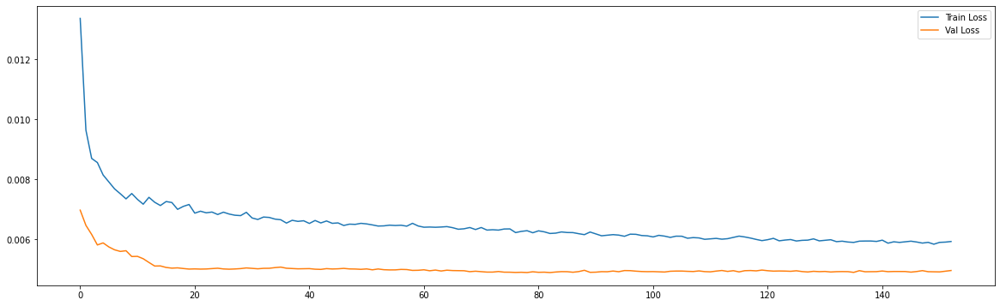

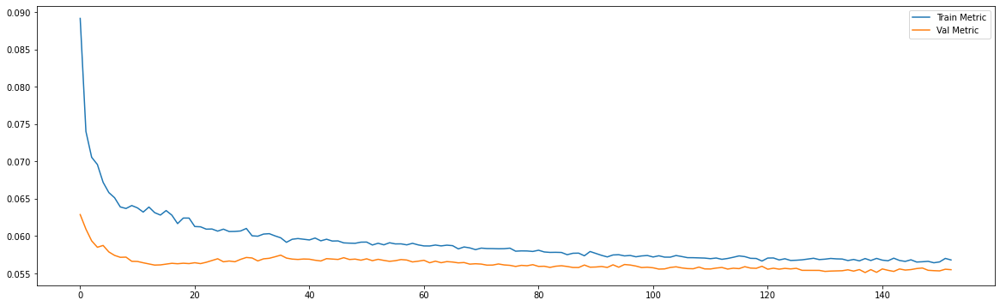

Epoch 00314: early stopping
============================model:28===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0042 - mae: 0.0492
loss and metric train data [0.004195542074739933, 0.049186382442712784]
10/10 [==============================] - 0s 3ms/step - loss: 0.0053 - mae: 0.0558
loss and metric val data [0.005255617666989565, 0.055819712579250336]
10/10 [==============================] - 0s 2ms/step - loss: 0.0058 - mae: 0.0555
loss and metric test data [0.005774562247097492, 0.05548427626490593]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




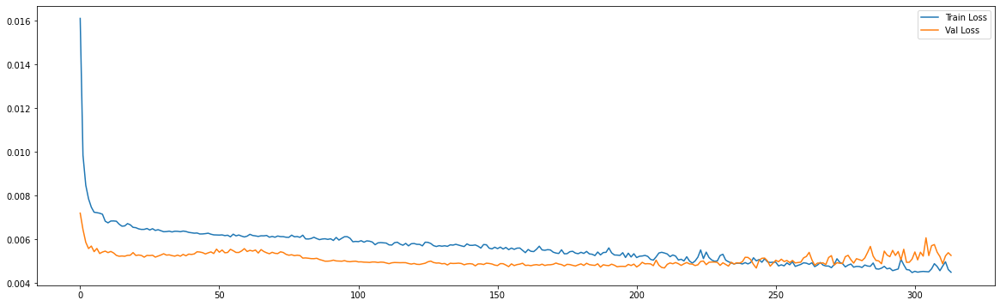

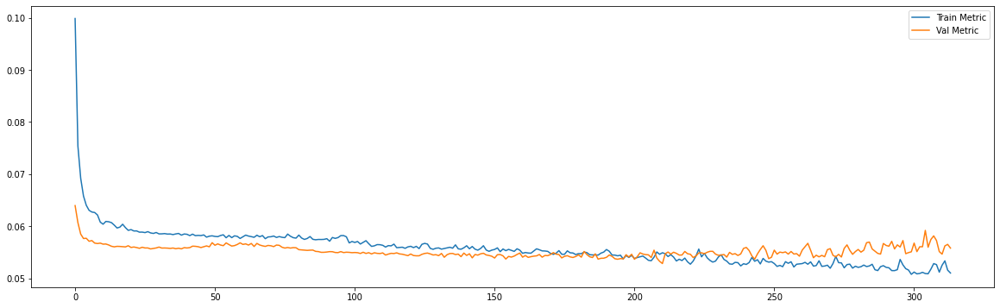

Epoch 00275: early stopping
============================model:29===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0043 - mae: 0.0500
loss and metric train data [0.004272839520126581, 0.04995381459593773]
10/10 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0589
loss and metric val data [0.005841096397489309, 0.05888347700238228]
10/10 [==============================] - 0s 5ms/step - loss: 0.0068 - mae: 0.0592
loss and metric test data [0.006796853616833687, 0.05918542668223381]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




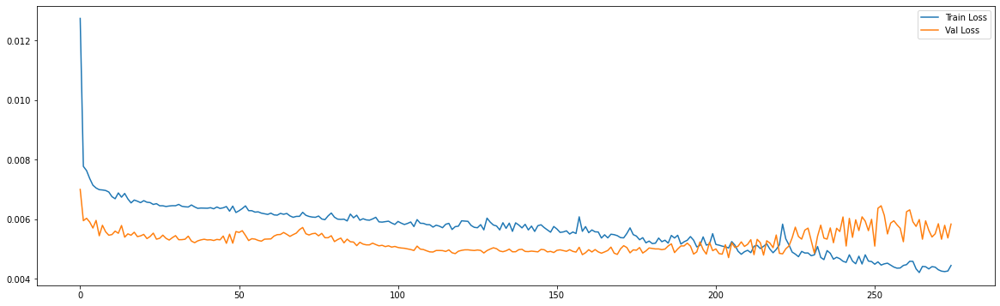

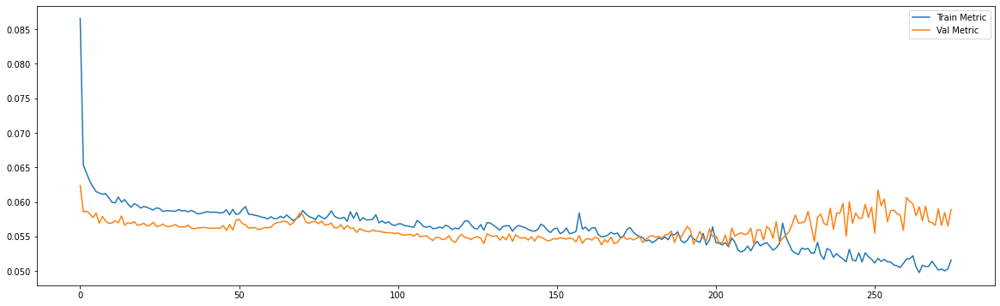

Epoch 00167: early stopping
============================model:30===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0554
loss and metric train data [0.005679091438651085, 0.05535615235567093]
10/10 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0562
loss and metric val data [0.00497090071439743, 0.056206271052360535]
10/10 [==============================] - 0s 3ms/step - loss: 0.0061 - mae: 0.0586
loss and metric test data [0.0061440374702215195, 0.05858302861452103]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




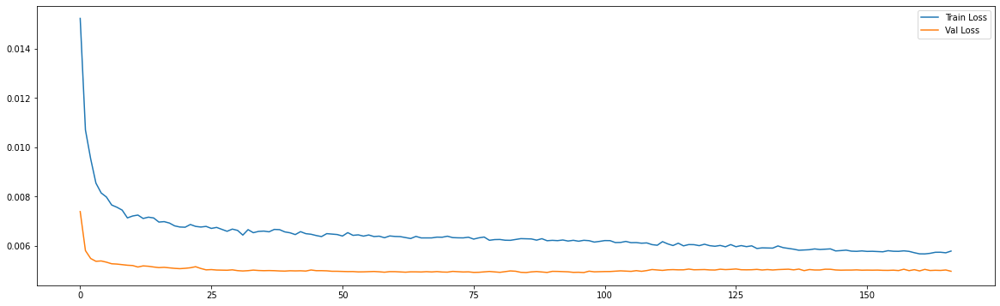

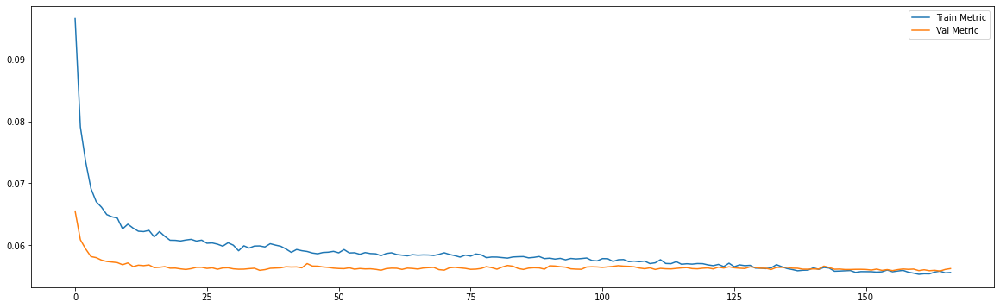

Epoch 00304: early stopping
============================model:31===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0044 - mae: 0.0508
loss and metric train data [0.004406818654388189, 0.05077853053808212]
10/10 [==============================] - 0s 4ms/step - loss: 0.0056 - mae: 0.0569
loss and metric val data [0.005551958456635475, 0.05685868114233017]
10/10 [==============================] - 0s 4ms/step - loss: 0.0061 - mae: 0.0585
loss and metric test data [0.006116734351962805, 0.05847541615366936]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




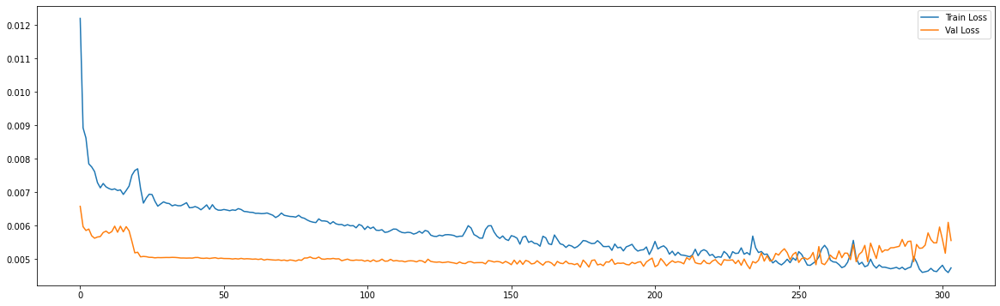

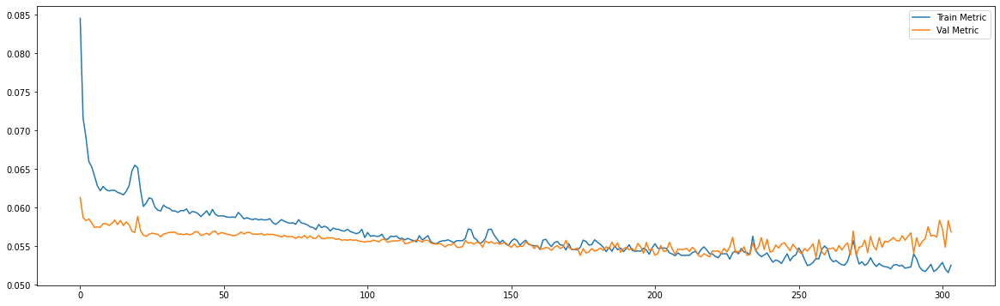

Epoch 00305: early stopping
============================model:32===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0047 - mae: 0.0521
loss and metric train data [0.004736571107059717, 0.05212392285466194]
10/10 [==============================] - 0s 3ms/step - loss: 0.0053 - mae: 0.0582
loss and metric val data [0.005322952754795551, 0.05822315439581871]
10/10 [==============================] - 0s 3ms/step - loss: 0.0075 - mae: 0.0625
loss and metric test data [0.007480106316506863, 0.0625118836760521]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




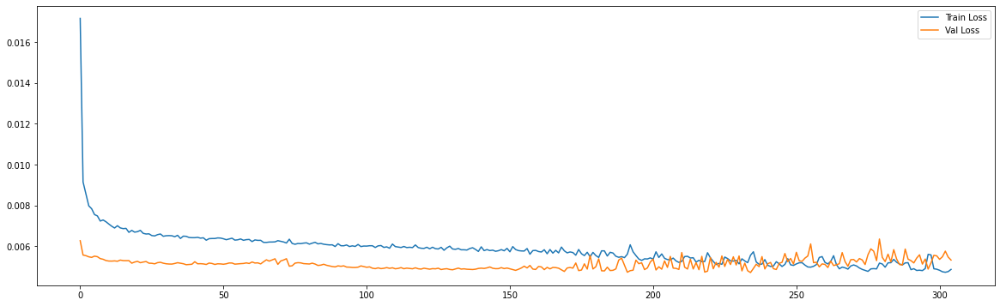

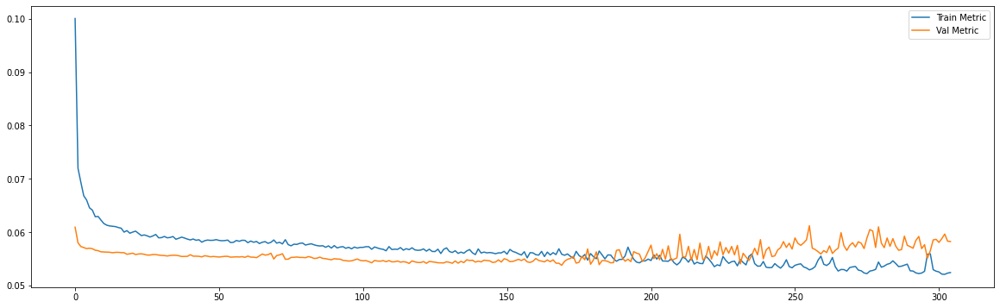

Epoch 00259: early stopping
============================model:33===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0042 - mae: 0.0497
loss and metric train data [0.004227394703775644, 0.049743421375751495]
10/10 [==============================] - 0s 5ms/step - loss: 0.0056 - mae: 0.0582
loss and metric val data [0.00556866405531764, 0.0581759549677372]
10/10 [==============================] - 0s 5ms/step - loss: 0.0067 - mae: 0.0598
loss and metric test data [0.006731868255883455, 0.059752628207206726]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




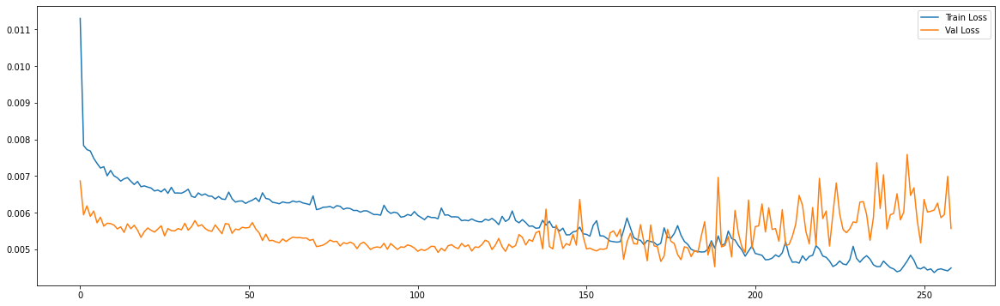

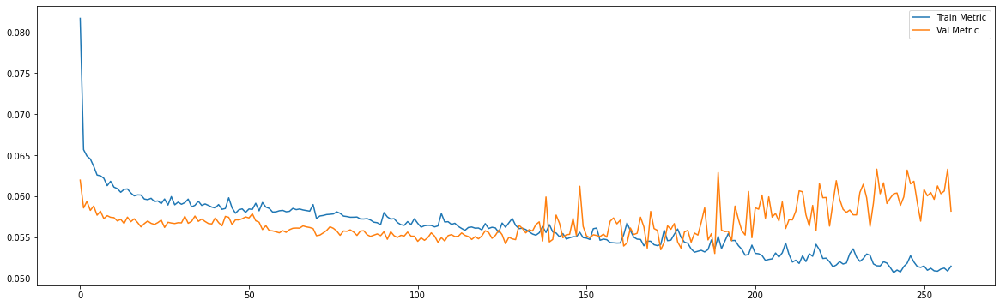

Epoch 00403: early stopping
============================model:34===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0536
loss and metric train data [0.005026457365602255, 0.0535910502076149]
10/10 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0545
loss and metric val data [0.004999227821826935, 0.05452723428606987]
10/10 [==============================] - 0s 4ms/step - loss: 0.0065 - mae: 0.0584
loss and metric test data [0.006529917474836111, 0.058430999517440796]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




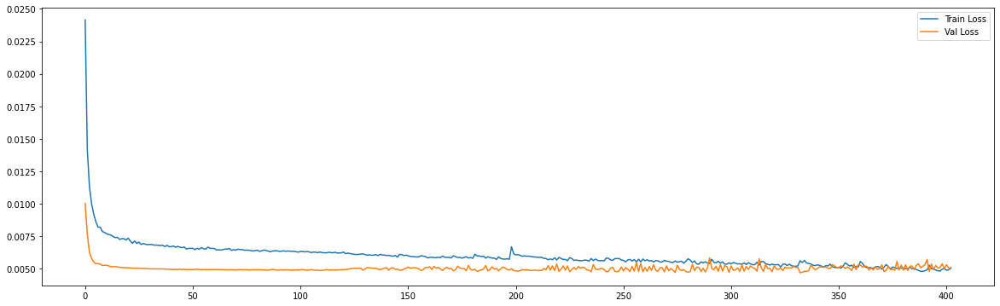

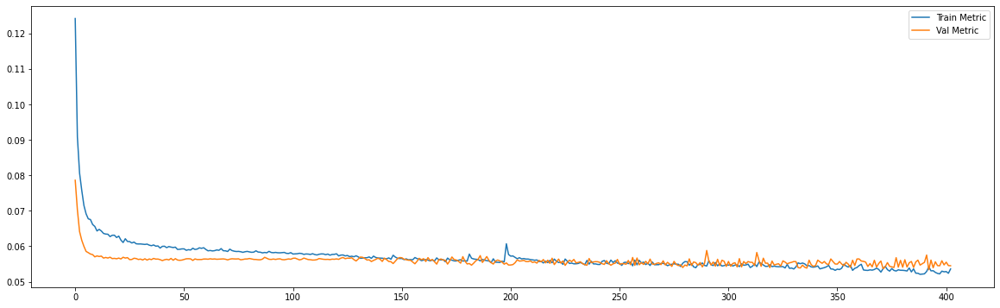

Epoch 00284: early stopping
============================model:35===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0521
loss and metric train data [0.004790931940078735, 0.05208422988653183]
10/10 [==============================] - 0s 5ms/step - loss: 0.0050 - mae: 0.0560
loss and metric val data [0.005042406730353832, 0.05603907257318497]
10/10 [==============================] - 0s 5ms/step - loss: 0.0068 - mae: 0.0601
loss and metric test data [0.006758673116564751, 0.060144320130348206]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




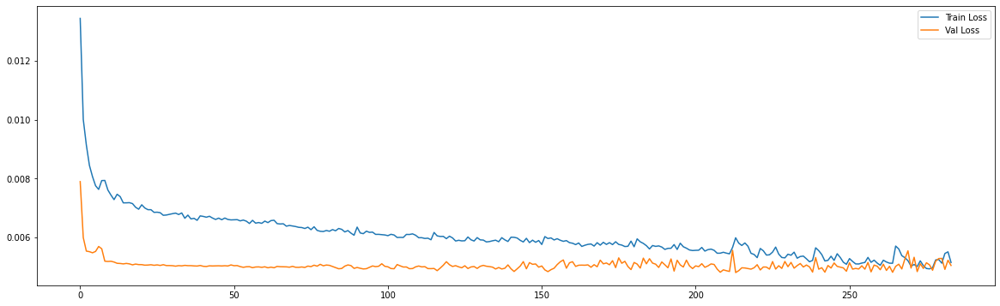

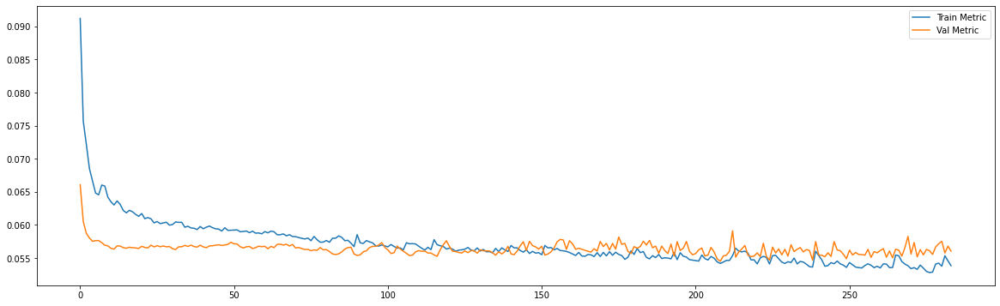

Epoch 00168: early stopping
============================model:36===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0062 - mae: 0.0574
loss and metric train data [0.006160824093967676, 0.05738005042076111]
10/10 [==============================] - 0s 2ms/step - loss: 0.0052 - mae: 0.0565
loss and metric val data [0.005210769362747669, 0.05647076666355133]
10/10 [==============================] - 0s 2ms/step - loss: 0.0071 - mae: 0.0608
loss and metric test data [0.00706870062276721, 0.06084113568067551]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




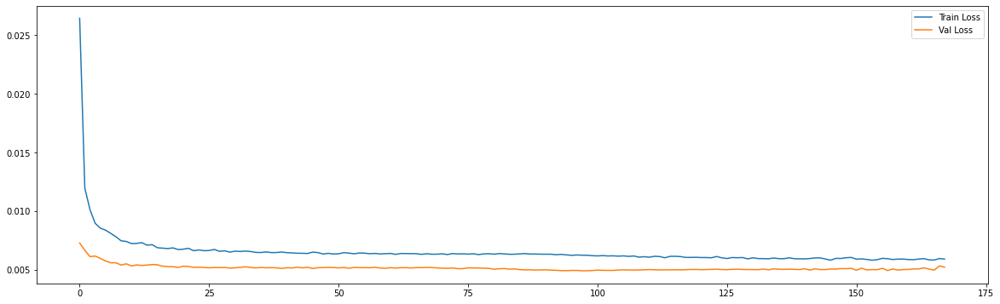

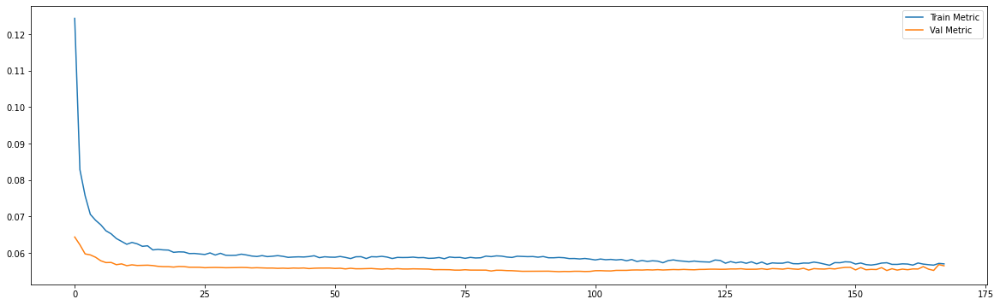

Epoch 00229: early stopping
============================model:37===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0054 - mae: 0.0550
loss and metric train data [0.005449905525892973, 0.05496091768145561]
10/10 [==============================] - 0s 3ms/step - loss: 0.0052 - mae: 0.0556
loss and metric val data [0.005219100974500179, 0.05559467896819115]
10/10 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0553
loss and metric test data [0.005969767924398184, 0.05533791333436966]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




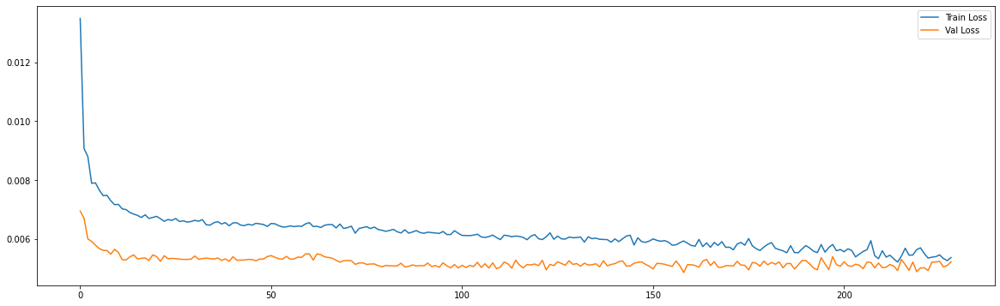

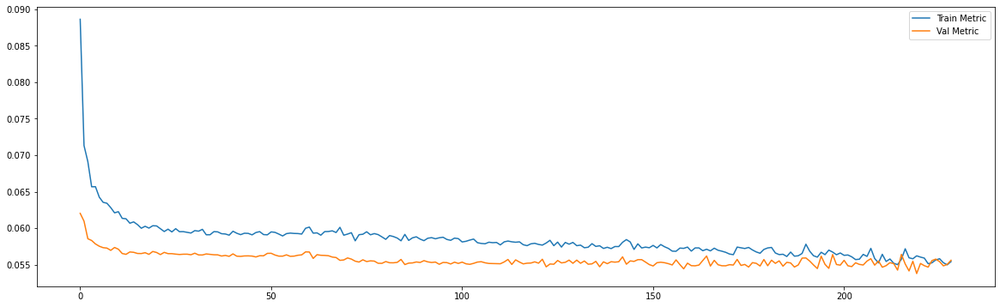

Epoch 00205: early stopping
============================model:38===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0561
loss and metric train data [0.005743470974266529, 0.05614122748374939]
10/10 [==============================] - 0s 2ms/step - loss: 0.0050 - mae: 0.0564
loss and metric val data [0.005015361122786999, 0.05642947927117348]
10/10 [==============================] - 0s 2ms/step - loss: 0.0062 - mae: 0.0592
loss and metric test data [0.006150299683213234, 0.05919503793120384]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




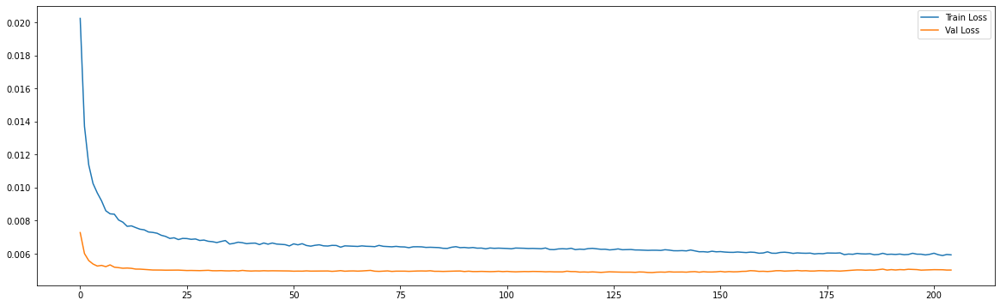

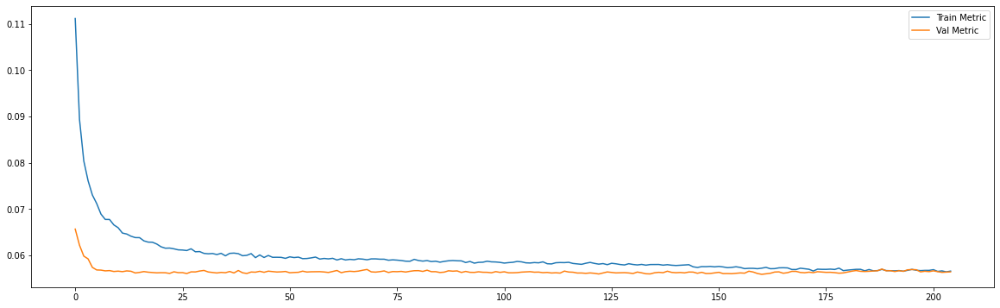

Epoch 00177: early stopping
============================model:39===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0558
loss and metric train data [0.005721131339669228, 0.05578010529279709]
10/10 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0559
loss and metric val data [0.004958953708410263, 0.05586082115769386]
10/10 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0584
loss and metric test data [0.0060349199920892715, 0.058430470526218414]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




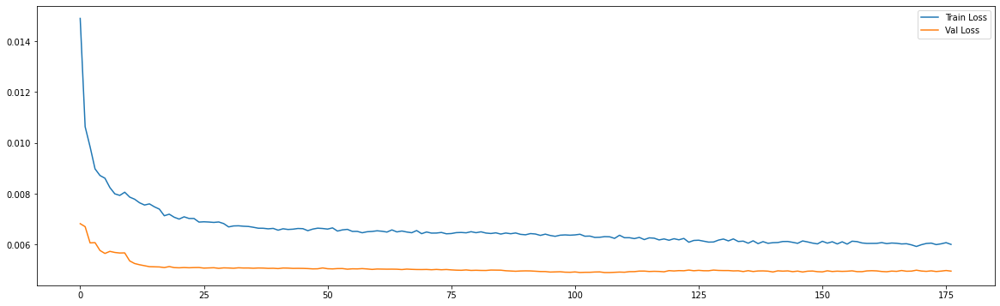

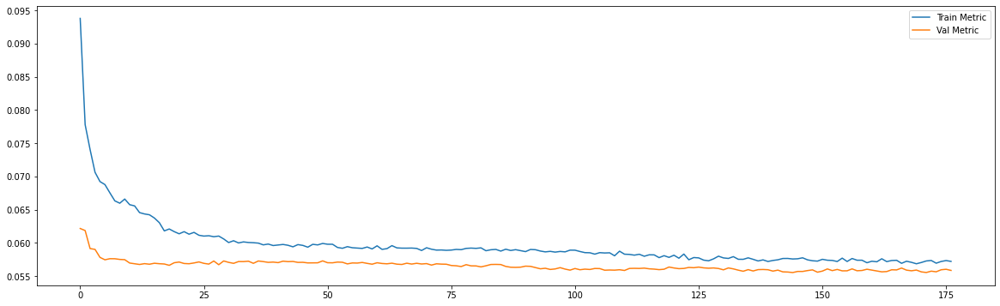

Epoch 00096: early stopping
============================model:40===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0551
loss and metric train data [0.005814487114548683, 0.0550571046769619]
10/10 [==============================] - 0s 3ms/step - loss: 0.0053 - mae: 0.0560
loss and metric val data [0.0052651152946054935, 0.05600706487894058]
10/10 [==============================] - 0s 3ms/step - loss: 0.0063 - mae: 0.0573
loss and metric test data [0.006298203952610493, 0.05725991725921631]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




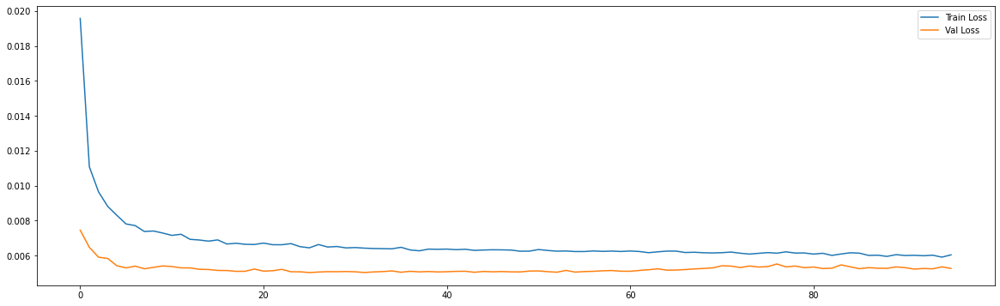

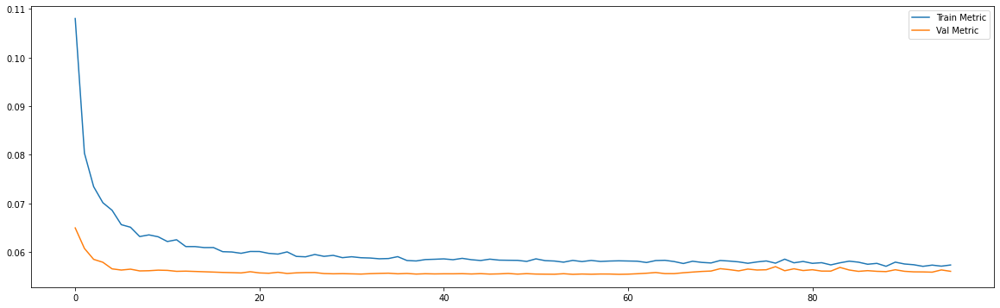

Epoch 00229: early stopping
============================model:41===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0047 - mae: 0.0520
loss and metric train data [0.004698014352470636, 0.052047085016965866]
10/10 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0540
loss and metric val data [0.004931788891553879, 0.053963132202625275]
10/10 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0595
loss and metric test data [0.006345810834318399, 0.05946456640958786]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




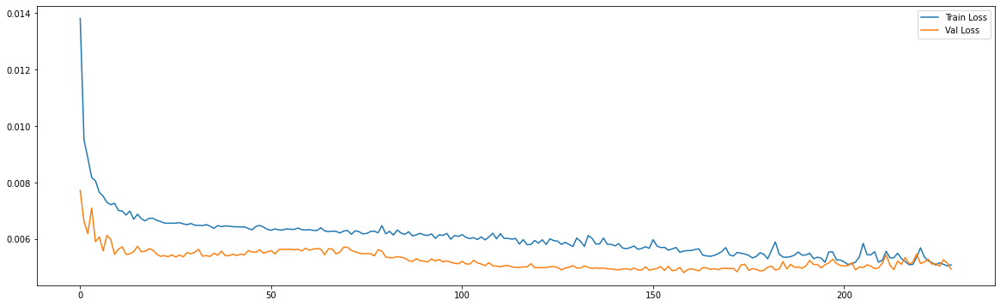

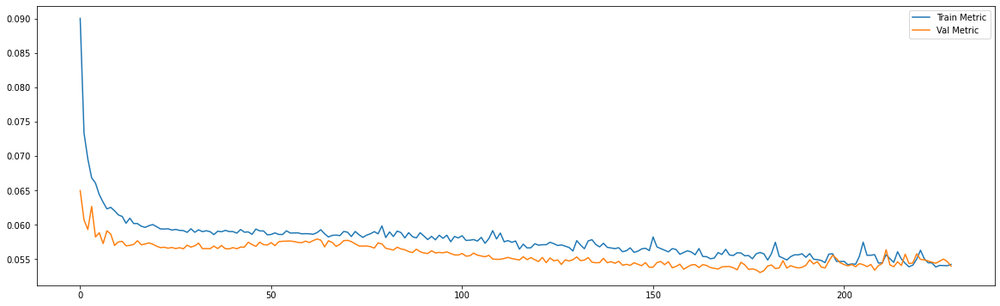

Epoch 00185: early stopping
============================model:42===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0055 - mae: 0.0548
loss and metric train data [0.005526593886315823, 0.05476676672697067]
10/10 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0559
loss and metric val data [0.004983213264495134, 0.0559086799621582]
10/10 [==============================] - 0s 3ms/step - loss: 0.0061 - mae: 0.0584
loss and metric test data [0.006057952530682087, 0.05844976007938385]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




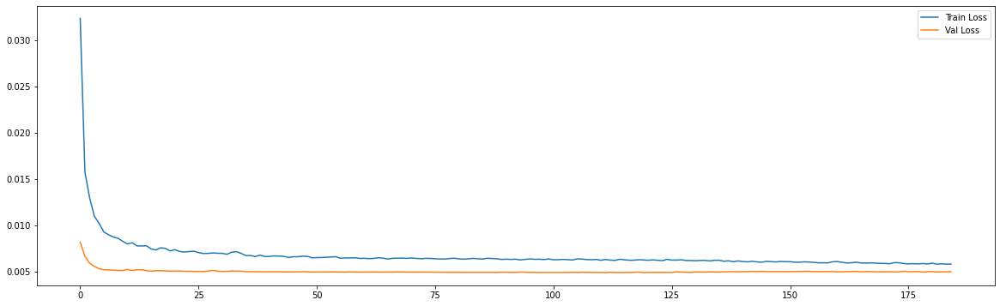

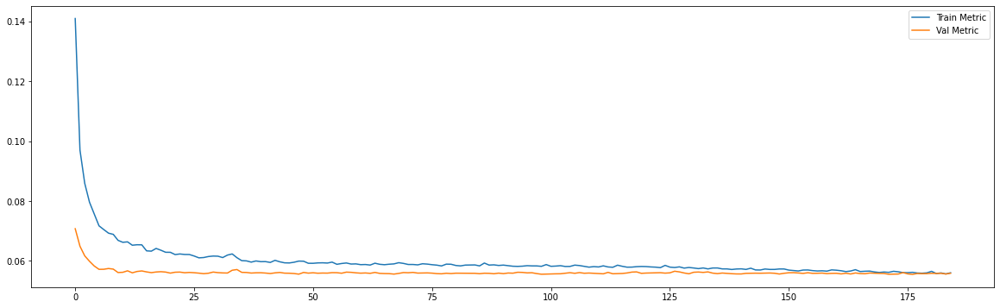

Epoch 00329: early stopping
============================model:43===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0046 - mae: 0.0516
loss and metric train data [0.004615222569555044, 0.051638562232255936]
10/10 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0551
loss and metric val data [0.005098985508084297, 0.05506595969200134]
10/10 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0585
loss and metric test data [0.0062468647956848145, 0.05846981704235077]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




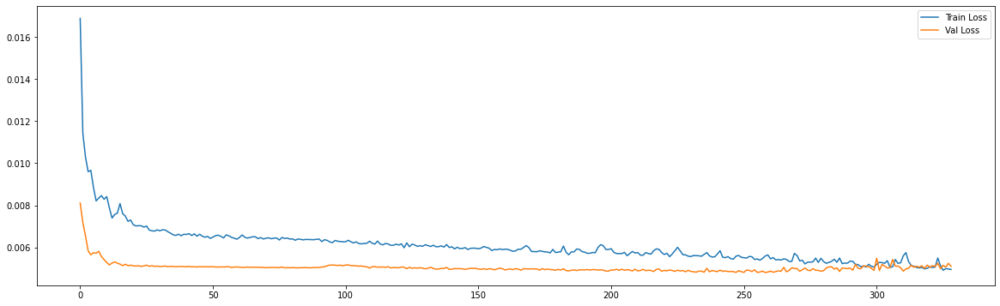

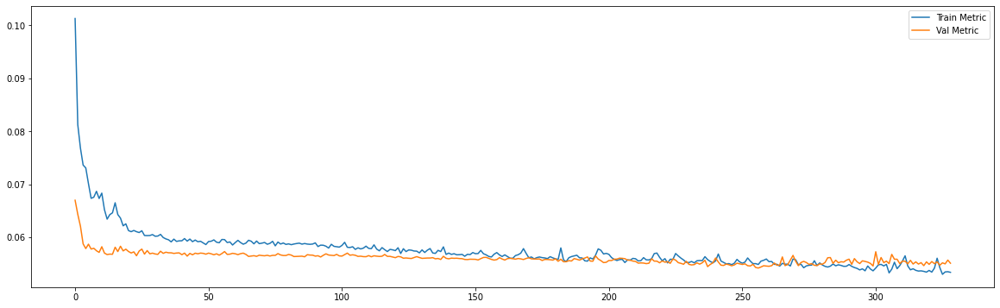

Epoch 00350: early stopping
============================model:44===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0531
loss and metric train data [0.004977930337190628, 0.05311879143118858]
10/10 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0550
loss and metric val data [0.004812633153051138, 0.055015191435813904]
10/10 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0581
loss and metric test data [0.005790659226477146, 0.058083925396203995]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




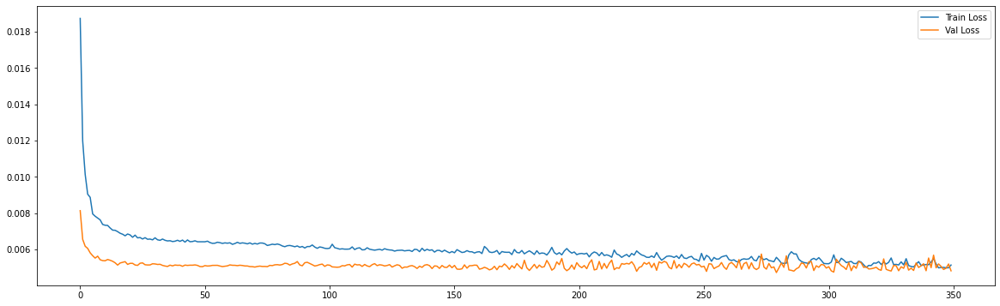

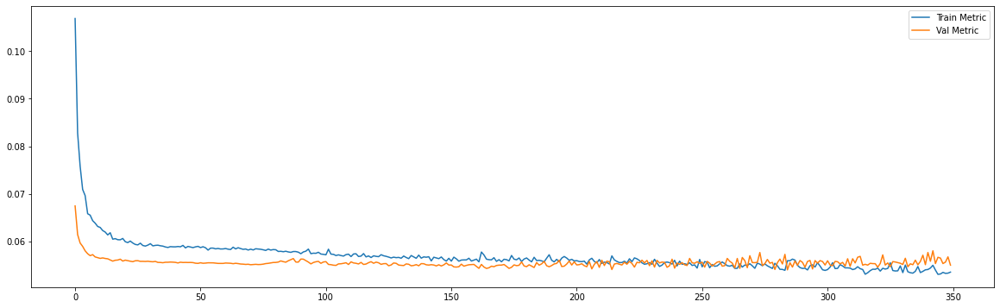

Epoch 00269: early stopping
============================model:45===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0519
loss and metric train data [0.004763052333146334, 0.05188997834920883]
10/10 [==============================] - 0s 5ms/step - loss: 0.0049 - mae: 0.0548
loss and metric val data [0.004881676752120256, 0.054822131991386414]
10/10 [==============================] - 0s 5ms/step - loss: 0.0061 - mae: 0.0578
loss and metric test data [0.006052784156054258, 0.057757265865802765]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2




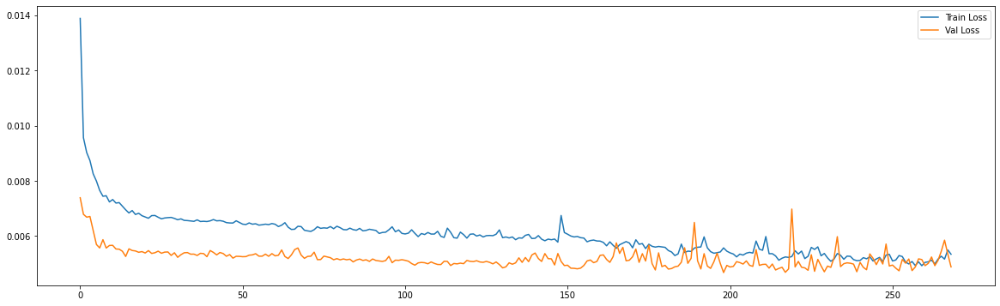

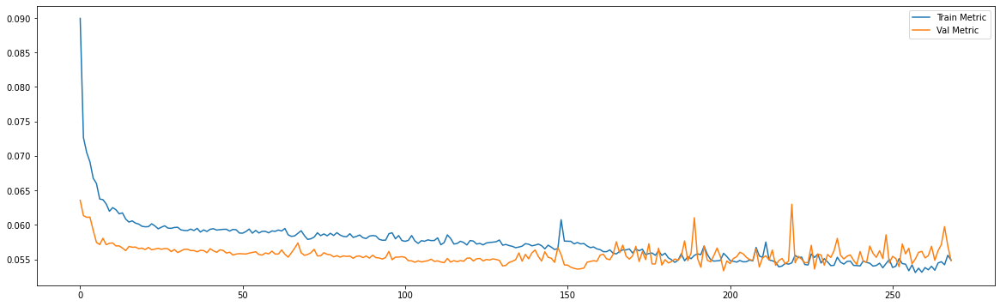

Epoch 00391: early stopping
============================model:46===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0527
loss and metric train data [0.004918576683849096, 0.05267687514424324]
10/10 [==============================] - 0s 3ms/step - loss: 0.0052 - mae: 0.0563
loss and metric val data [0.0051928372122347355, 0.056312862783670425]
10/10 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0567
loss and metric test data [0.0058074225671589375, 0.056737493723630905]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':1




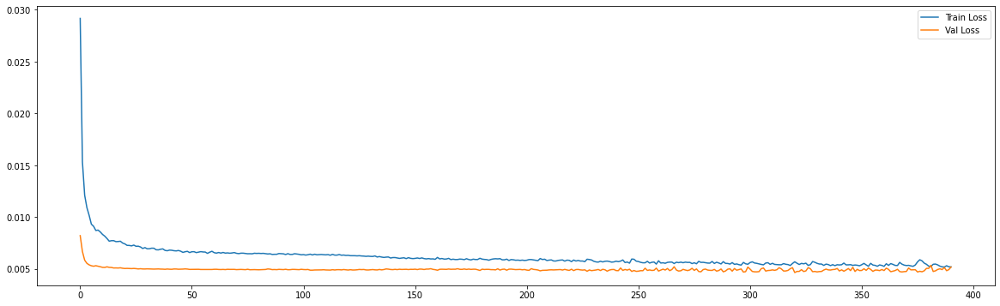

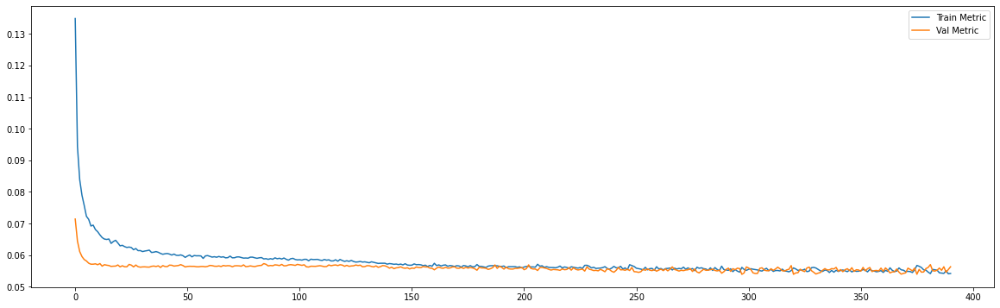

Epoch 00239: early stopping
============================model:47===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0055 - mae: 0.0555
loss and metric train data [0.005538358353078365, 0.05550088733434677]
10/10 [==============================] - 0s 5ms/step - loss: 0.0049 - mae: 0.0552
loss and metric val data [0.004916355013847351, 0.0551808662712574]
10/10 [==============================] - 0s 5ms/step - loss: 0.0064 - mae: 0.0599
loss and metric test data [0.006449037231504917, 0.05992775410413742]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':64, 'learning_rate':0.001, 'hidden_layers':2




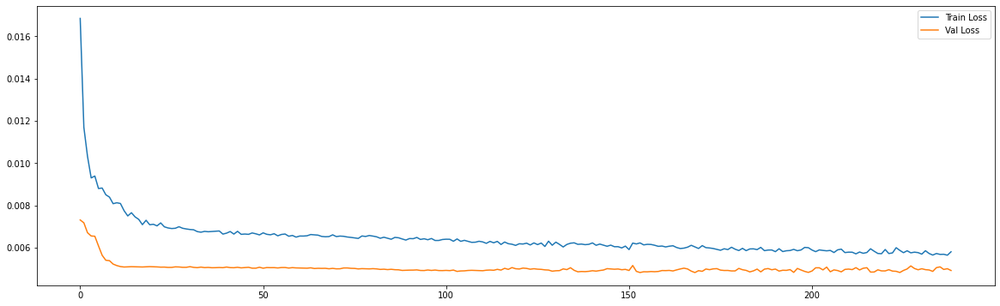

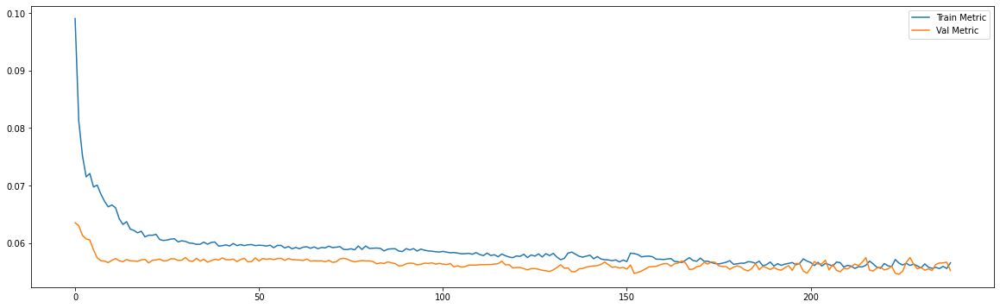

In [20]:
future_steps = 5
n_features = df_train.shape[1]

neurons_list = [30,50]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120]
batch_size_list = [32,64]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for batch_size in batch_size_list:
        for lr in lr_list:
          x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch_size, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch_size,lr,1)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=future_steps))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          # early stop
          es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = batch_size, verbose = 0, shuffle = False, callbacks = [es])

          print('============================model:{}==========================='.format(i))

            
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          i+=1


          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch_size, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch_size,lr,2)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False))
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=future_steps))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          # early stop
          es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = batch_size, verbose = 0, shuffle = False, callbacks = [es])

          print('============================model:{}==========================='.format(i))

            
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          i+=1

### Best Model Resume 

`Validation metric as evaluation parameter`

Epoch 00229: early stopping

============================model:41===========================

45/45 [==============================] - 0s 4ms/step - loss: 0.0047 - mae: 0.0520

loss and metric train data [0.004698014352470636, 0.052047085016965866]
10/10 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0540

loss and metric val data [0.004931788891553879, 0.053963132202625275]
10/10 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0595

loss and metric test data [0.006345810834318399, 0.05946456640958786]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2

In [21]:
models[41]

{'batch_size': 32,
 'dropout': 0.4,
 'learning_rate': 0.001,
 'model': <tensorflow.python.keras.engine.sequential.Sequential at 0x7f722d54b160>,
 'neurons': 50,
 'resumo': "'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':2",
 'time_steps': 60}

Saving Model

In [24]:
models[41]['model'].save("/content/drive/My Drive/ML Projects/Pharma Sales/LSTM_multiFeature_mostRelevantFeatures_weekdayMonth.h5")

Ploting predictions

In [25]:
future_steps = 5
n_features = df_train.shape[1]
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = 60,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

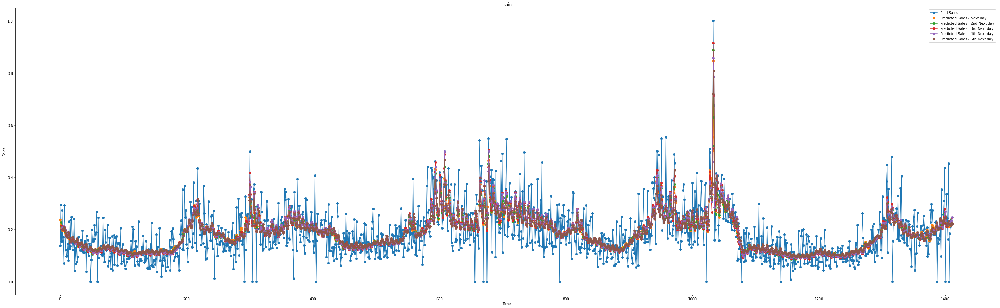

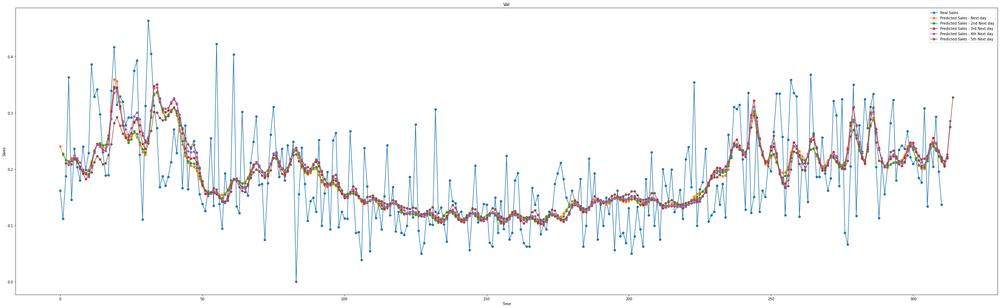

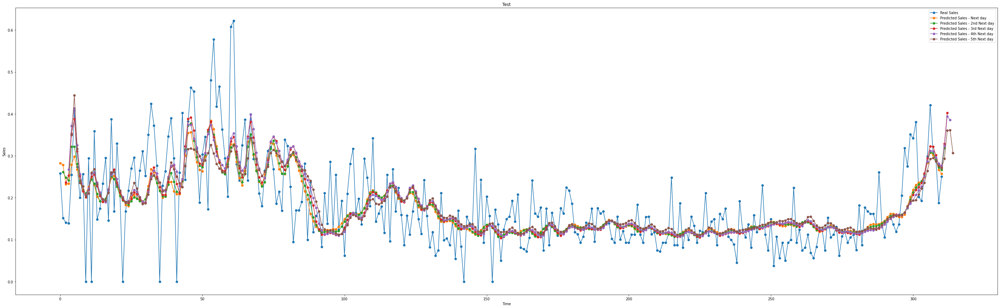

In [26]:
y_train_predict = models[41]['model'].predict(x_train)
y_val_predict = models[41]['model'].predict(x_val)
y_test_predict = models[41]['model'].predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

# Outliers Treatment

## Cape

In [ ]:
df_daily = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesdaily.csv')
df_daily = df_daily['N02BE']

In [ ]:
df_train,df_val,df_test = dataSplit(df = df_daily,train_percent = 0.7,val_percent = 0.15)

(1474,)
(316,)
(316,)


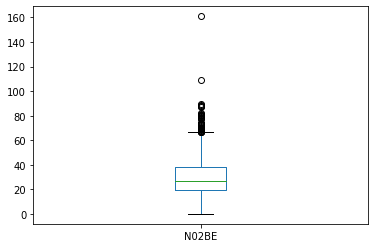

In [ ]:
df_train.plot.box()

In [ ]:
print(df_train[df_train>df_train.quantile(0.8)].shape)
print(df_train[df_train>df_train.quantile(0.9)].shape)
print(df_train[df_train>df_train.quantile(0.95)].shape)

(295,)
(148,)
(74,)


In [ ]:
df_train[df_train>df_train.quantile(0.9)] = df_train.quantile(0.9)

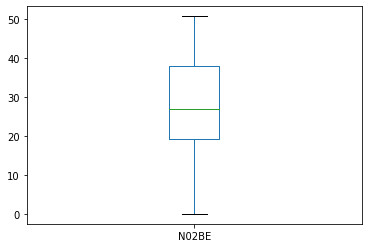

In [ ]:
df_train.plot.box()

In [ ]:
df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange=(0,1))

[1.]
[0.]


[1.46937168]
[0.]


[1.97163679]
[0.]
-------------------------
(1474, 1)
(316, 1)
(316, 1)


Epoch 00306: early stopping
============================model:0===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0379 - mae: 0.1535
loss and metric train data [0.03788328543305397, 0.15347695350646973]
9/9 [==============================] - 0s 2ms/step - loss: 0.0578 - mae: 0.1860
loss and metric val data [0.057784173637628555, 0.1859932839870453]
9/9 [==============================] - 0s 2ms/step - loss: 0.0680 - mae: 0.1915
loss and metric test data [0.06799209117889404, 0.1914597600698471]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




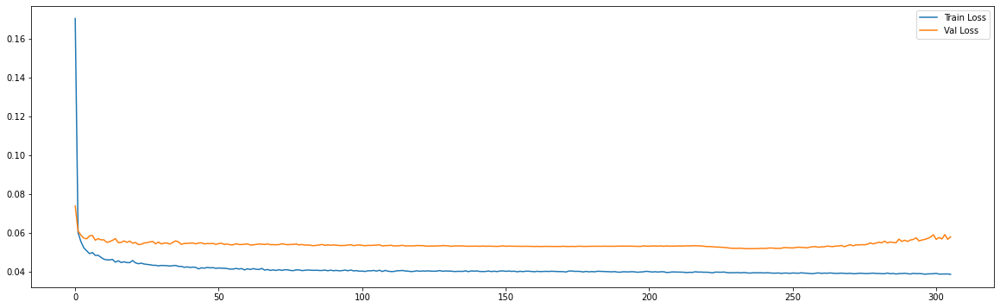

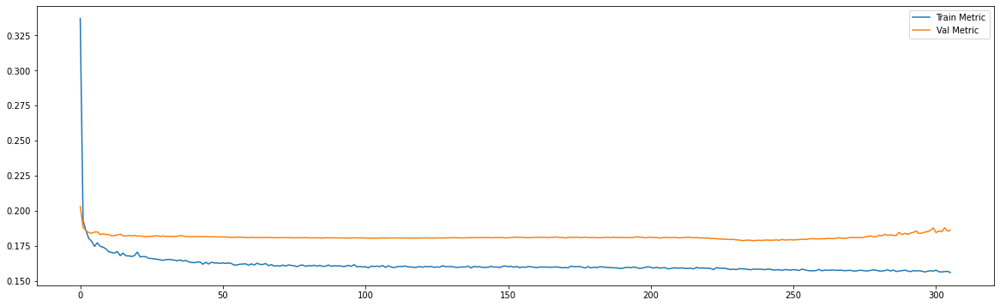

Epoch 00118: early stopping
============================model:1===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0395 - mae: 0.1577
loss and metric train data [0.0395025834441185, 0.15771529078483582]
9/9 [==============================] - 0s 3ms/step - loss: 0.0538 - mae: 0.1802
loss and metric val data [0.053842756897211075, 0.18015466630458832]
9/9 [==============================] - 0s 3ms/step - loss: 0.0645 - mae: 0.1846
loss and metric test data [0.06445708125829697, 0.1846163123846054]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




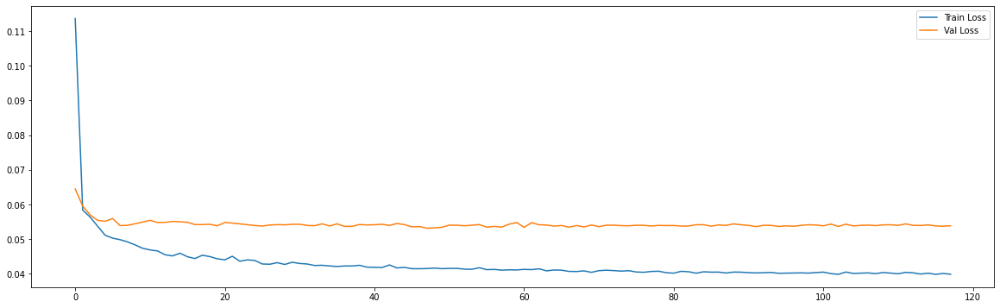

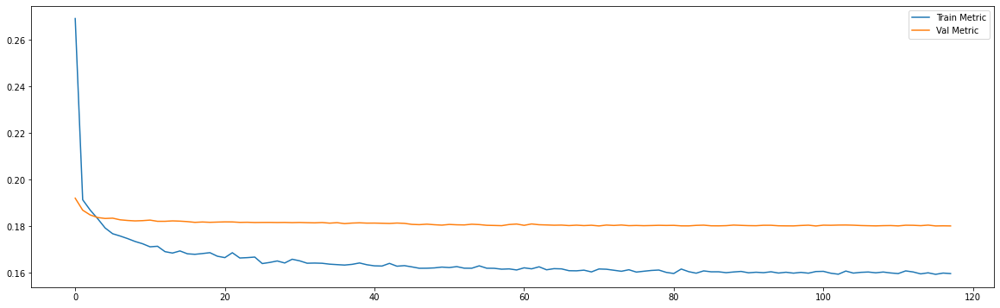

Epoch 00099: early stopping
============================model:2===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0387 - mae: 0.1564
loss and metric train data [0.038670048117637634, 0.1564003974199295]
8/8 [==============================] - 0s 3ms/step - loss: 0.0508 - mae: 0.1754
loss and metric val data [0.050840284675359726, 0.17539510130882263]
8/8 [==============================] - 0s 3ms/step - loss: 0.0693 - mae: 0.1973
loss and metric test data [0.06933861970901489, 0.19730426371097565]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




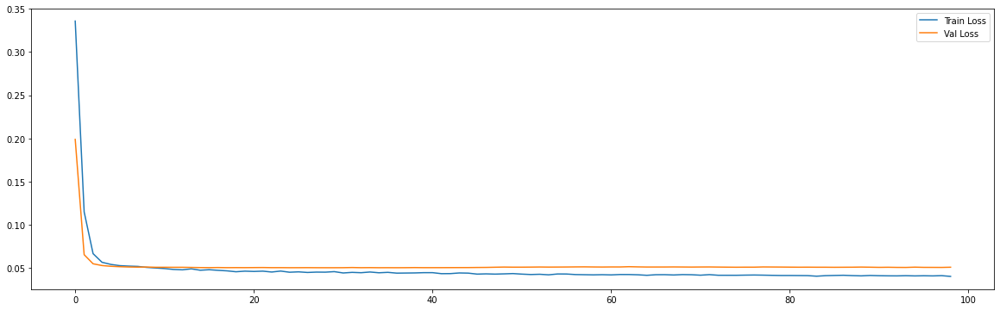

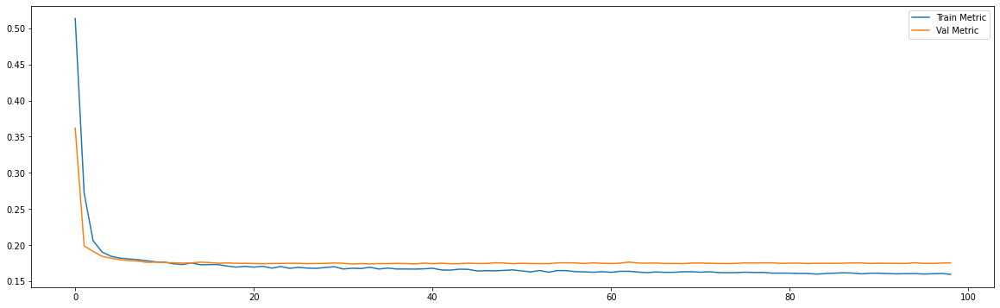

Epoch 00097: early stopping
============================model:3===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0387 - mae: 0.1565
loss and metric train data [0.03867467865347862, 0.15653975307941437]
8/8 [==============================] - 0s 4ms/step - loss: 0.0504 - mae: 0.1750
loss and metric val data [0.05036439746618271, 0.17499902844429016]
8/8 [==============================] - 0s 3ms/step - loss: 0.0700 - mae: 0.1965
loss and metric test data [0.07000041007995605, 0.19654959440231323]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




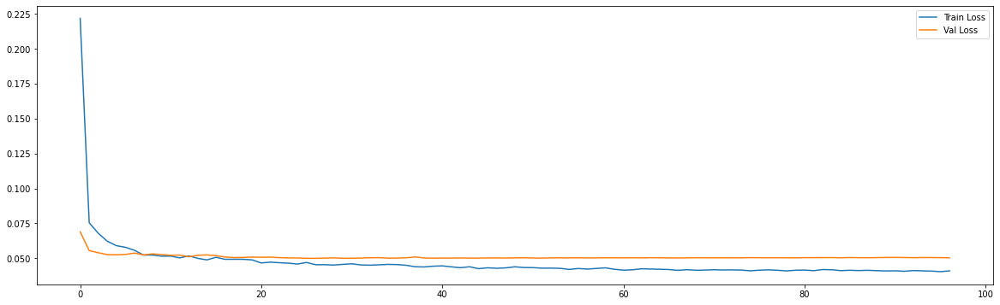

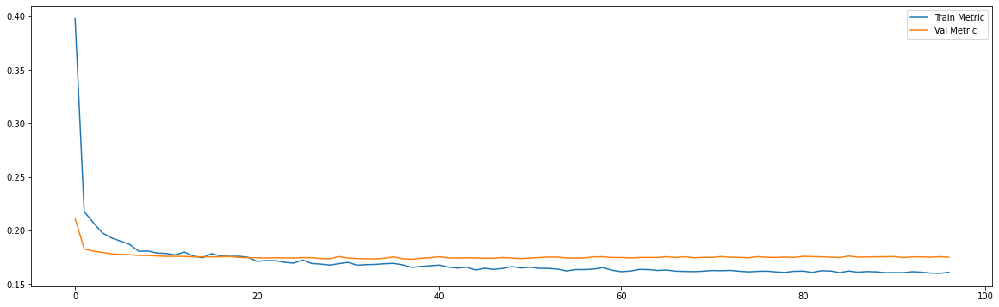

Epoch 00107: early stopping
============================model:4===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0381 - mae: 0.1554
loss and metric train data [0.03810728341341019, 0.15539950132369995]
7/7 [==============================] - 0s 3ms/step - loss: 0.0496 - mae: 0.1693
loss and metric val data [0.04960364103317261, 0.16931703686714172]
7/7 [==============================] - 0s 3ms/step - loss: 0.0846 - mae: 0.2226
loss and metric test data [0.08462685346603394, 0.2226041704416275]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




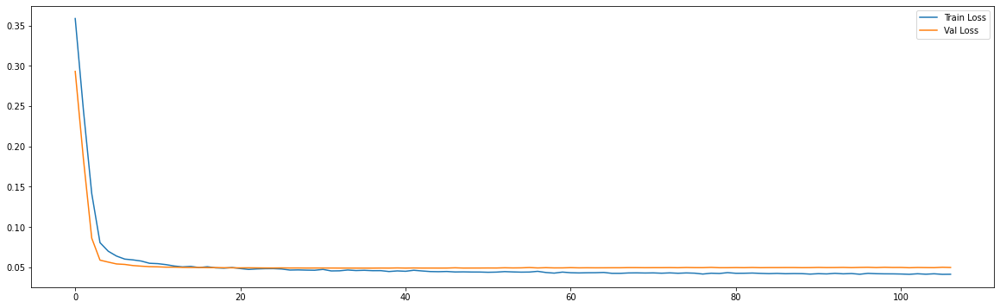

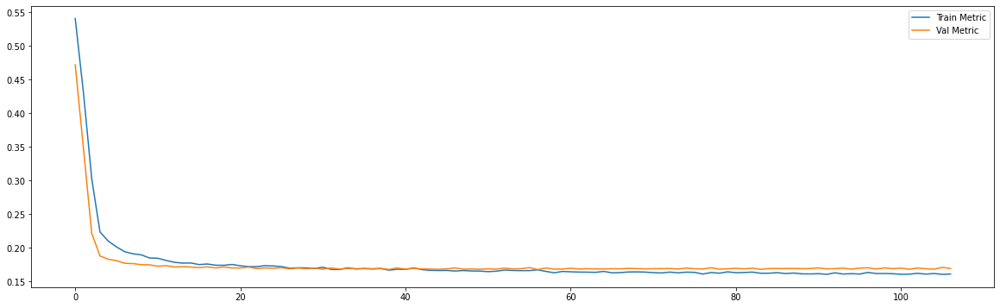

Epoch 00151: early stopping
============================model:5===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0379 - mae: 0.1549
loss and metric train data [0.03788496181368828, 0.1549227386713028]
7/7 [==============================] - 0s 4ms/step - loss: 0.0487 - mae: 0.1678
loss and metric val data [0.048650506883859634, 0.16784845292568207]
7/7 [==============================] - 0s 4ms/step - loss: 0.0828 - mae: 0.2178
loss and metric test data [0.08278118818998337, 0.21781869232654572]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




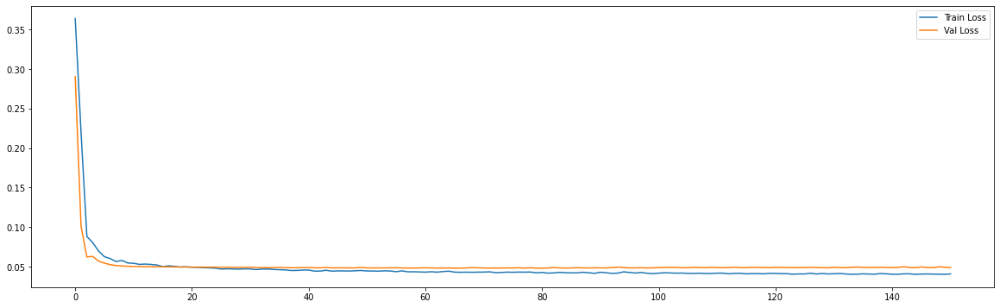

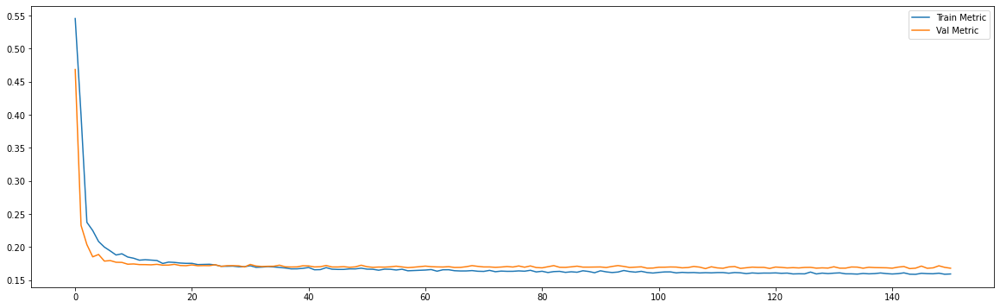

Epoch 00161: early stopping
============================model:6===========================
32/32 [==============================] - 0s 4ms/step - loss: 0.0424 - mae: 0.1654
loss and metric train data [0.04240971431136131, 0.16540823876857758]
3/3 [==============================] - 0s 4ms/step - loss: 0.0734 - mae: 0.2069
loss and metric val data [0.0733768418431282, 0.2069348841905594]
3/3 [==============================] - 0s 4ms/step - loss: 0.1492 - mae: 0.3050
loss and metric test data [0.14917288720607758, 0.3049939274787903]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




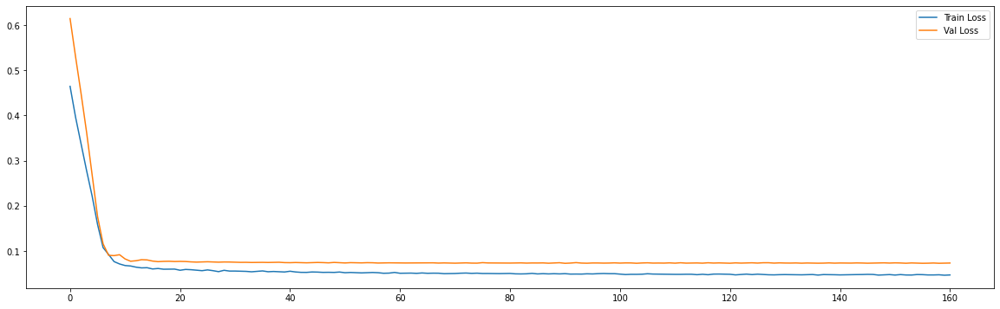

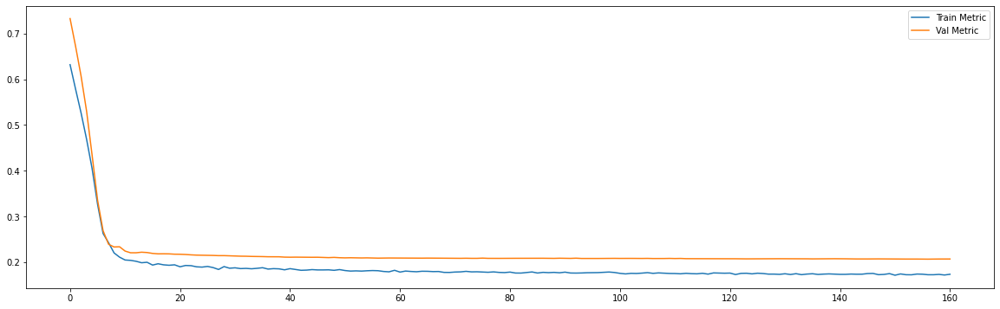

Epoch 00245: early stopping
============================model:7===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0422 - mae: 0.1652
loss and metric train data [0.04223699867725372, 0.16523480415344238]
3/3 [==============================] - 0s 5ms/step - loss: 0.0708 - mae: 0.2043
loss and metric val data [0.07082534581422806, 0.20429269969463348]
3/3 [==============================] - 0s 6ms/step - loss: 0.1454 - mae: 0.2985
loss and metric test data [0.1454087793827057, 0.2985333204269409]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




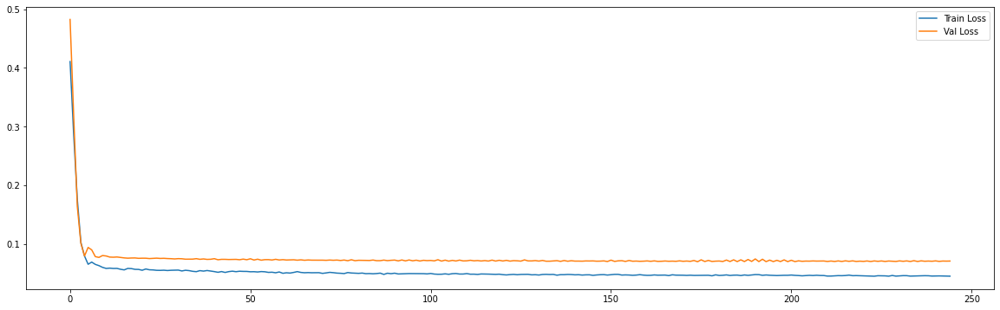

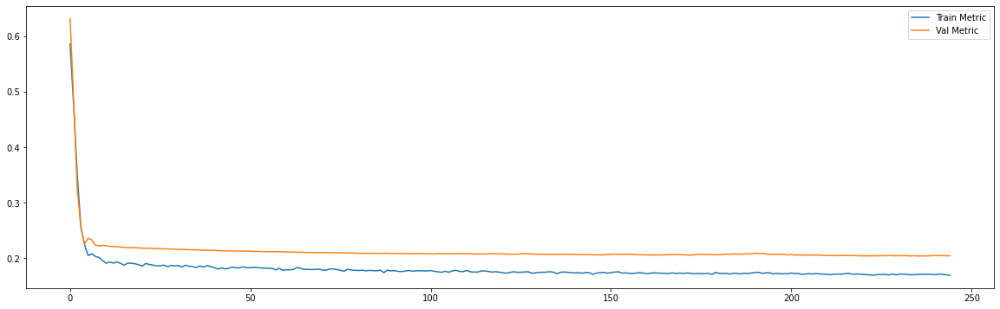

Epoch 00187: early stopping
============================model:8===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0390 - mae: 0.1565
loss and metric train data [0.03896505758166313, 0.15653465688228607]
9/9 [==============================] - 0s 2ms/step - loss: 0.0533 - mae: 0.1811
loss and metric val data [0.05328233912587166, 0.18112000823020935]
9/9 [==============================] - 0s 2ms/step - loss: 0.0635 - mae: 0.1858
loss and metric test data [0.06353916227817535, 0.1857791244983673]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




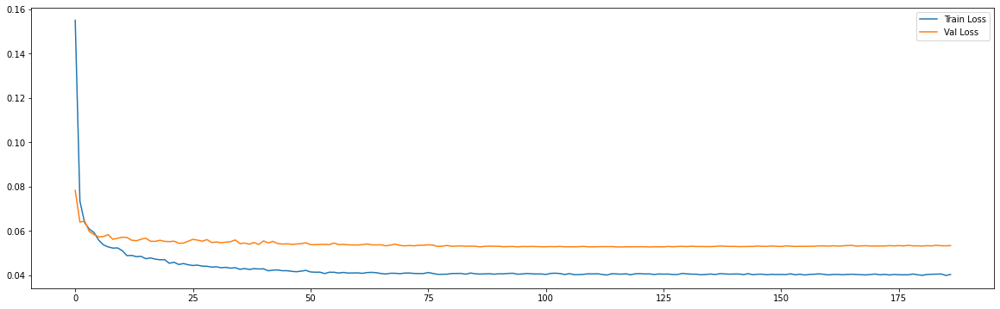

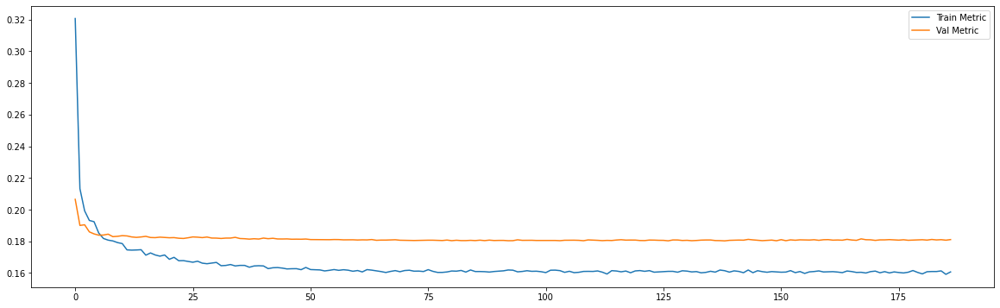

Epoch 00136: early stopping
============================model:9===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0391 - mae: 0.1567
loss and metric train data [0.03914828971028328, 0.15668021142482758]
9/9 [==============================] - 0s 3ms/step - loss: 0.0534 - mae: 0.1804
loss and metric val data [0.05341525003314018, 0.1803833246231079]
9/9 [==============================] - 0s 3ms/step - loss: 0.0643 - mae: 0.1858
loss and metric test data [0.06433320045471191, 0.18580496311187744]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




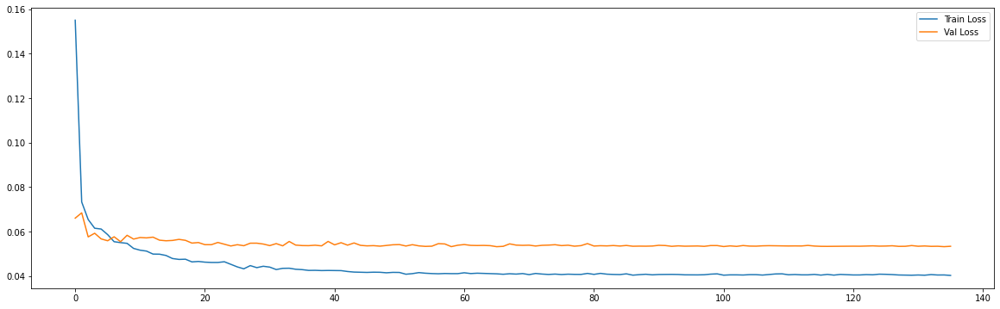

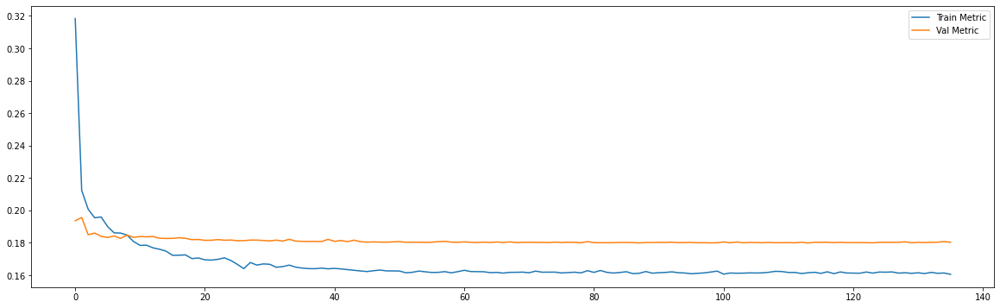

Epoch 00097: early stopping
============================model:10===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0387 - mae: 0.1569
loss and metric train data [0.03872781619429588, 0.15691465139389038]
8/8 [==============================] - 0s 3ms/step - loss: 0.0506 - mae: 0.1747
loss and metric val data [0.0506279319524765, 0.17471370100975037]
8/8 [==============================] - 0s 2ms/step - loss: 0.0695 - mae: 0.1960
loss and metric test data [0.06949987262487411, 0.19604073464870453]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




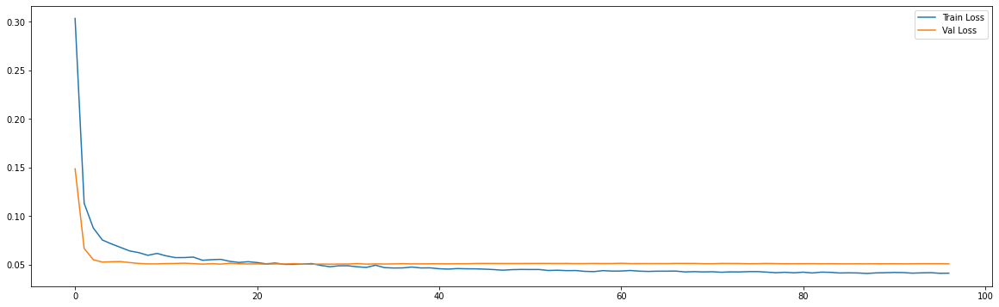

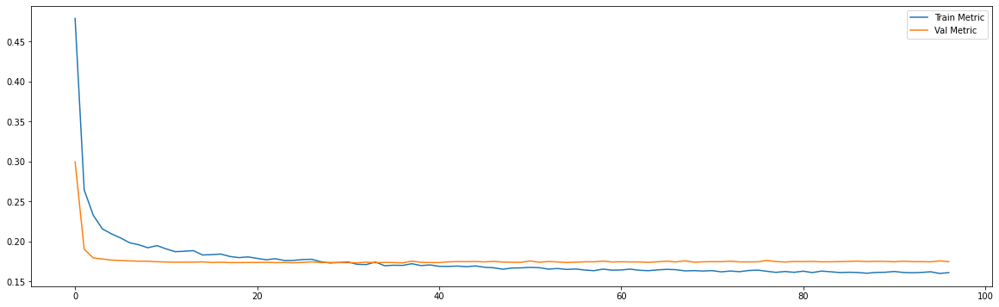

Epoch 00124: early stopping
============================model:11===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0385 - mae: 0.1564
loss and metric train data [0.03853069990873337, 0.1563969850540161]
8/8 [==============================] - 0s 4ms/step - loss: 0.0503 - mae: 0.1750
loss and metric val data [0.050306014716625214, 0.17496861517429352]
8/8 [==============================] - 0s 3ms/step - loss: 0.0696 - mae: 0.1975
loss and metric test data [0.06962952017784119, 0.19749480485916138]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




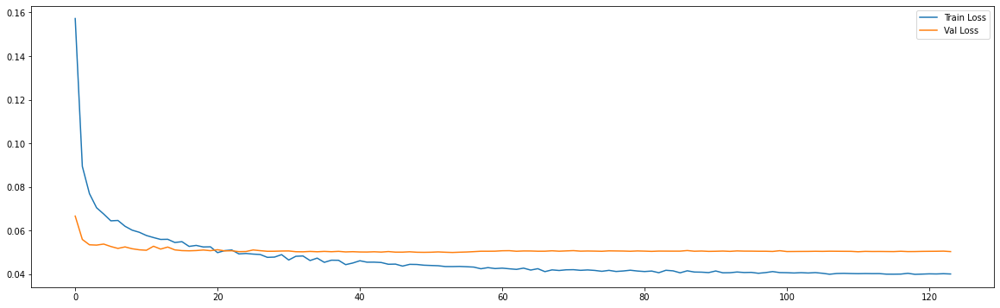

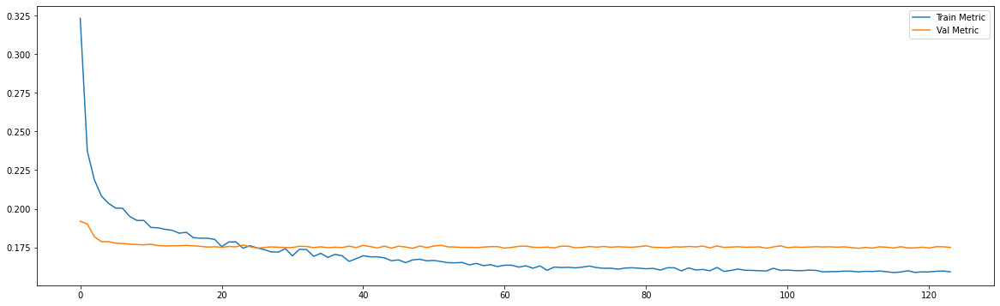

Epoch 00123: early stopping
============================model:12===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0381 - mae: 0.1560
loss and metric train data [0.03809461370110512, 0.1559859663248062]
7/7 [==============================] - 0s 3ms/step - loss: 0.0492 - mae: 0.1691
loss and metric val data [0.049177806824445724, 0.16912059485912323]
7/7 [==============================] - 0s 3ms/step - loss: 0.0837 - mae: 0.2198
loss and metric test data [0.08365192264318466, 0.21978405117988586]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




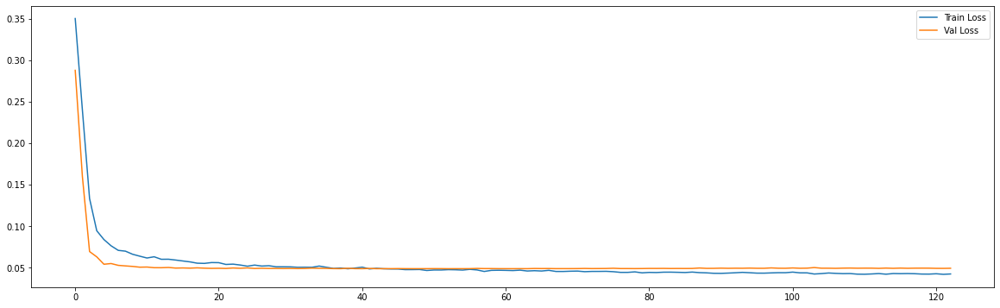

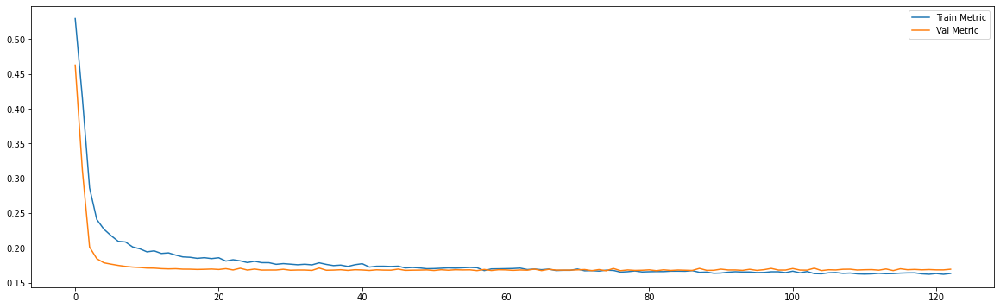

Epoch 00160: early stopping
============================model:13===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0381 - mae: 0.1566
loss and metric train data [0.038105111569166183, 0.15663567185401917]
7/7 [==============================] - 0s 5ms/step - loss: 0.0489 - mae: 0.1697
loss and metric val data [0.04892038181424141, 0.16971834003925323]
7/7 [==============================] - 0s 5ms/step - loss: 0.0829 - mae: 0.2175
loss and metric test data [0.0828845426440239, 0.2174636721611023]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




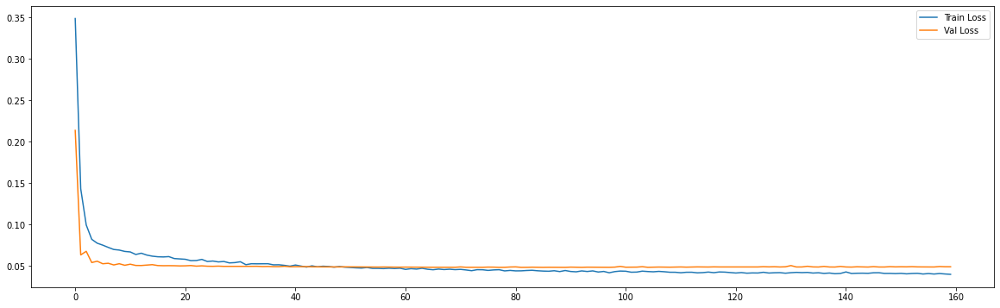

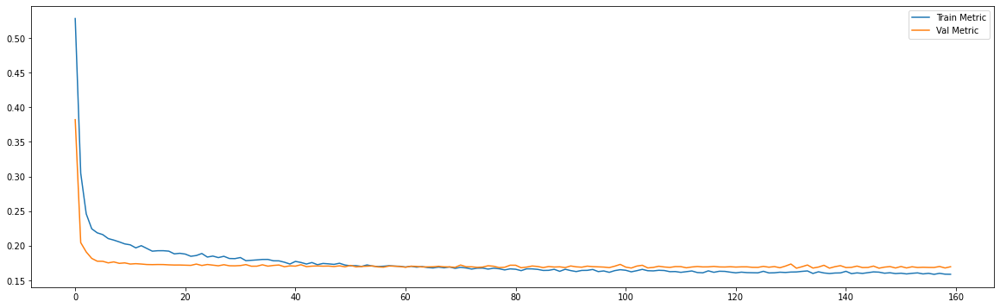

============================model:14===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0416 - mae: 0.1645
loss and metric train data [0.0415678396821022, 0.16451942920684814]
3/3 [==============================] - 0s 6ms/step - loss: 0.0697 - mae: 0.2049
loss and metric val data [0.06969072669744492, 0.20494085550308228]
3/3 [==============================] - 0s 4ms/step - loss: 0.1504 - mae: 0.3023
loss and metric test data [0.1503576785326004, 0.30228811502456665]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




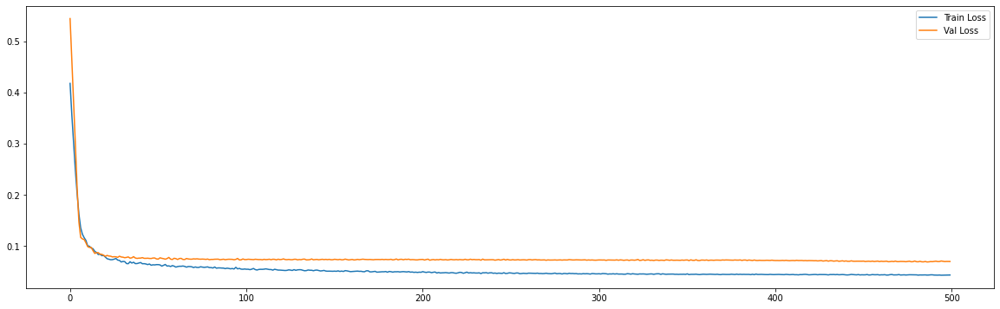

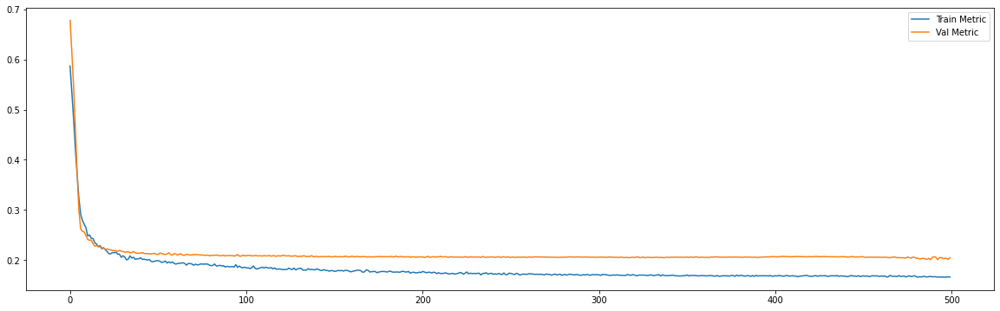

Epoch 00160: early stopping
============================model:15===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0422 - mae: 0.1654
loss and metric train data [0.04217010363936424, 0.1654321849346161]
3/3 [==============================] - 0s 6ms/step - loss: 0.0712 - mae: 0.2045
loss and metric val data [0.07123098522424698, 0.20447243750095367]
3/3 [==============================] - 0s 6ms/step - loss: 0.1445 - mae: 0.2977
loss and metric test data [0.1444757729768753, 0.29766544699668884]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




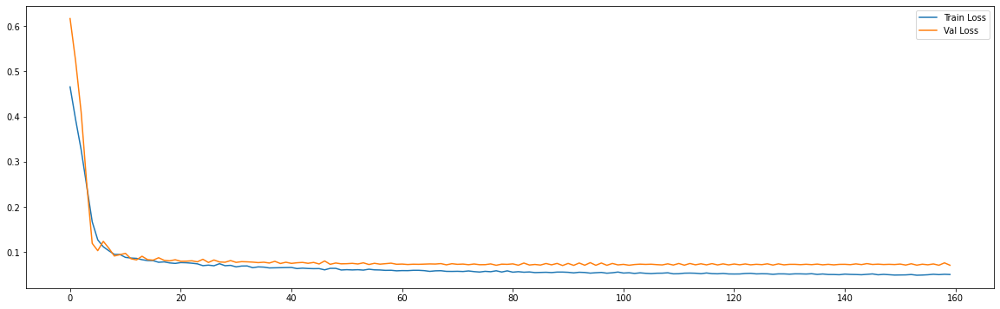

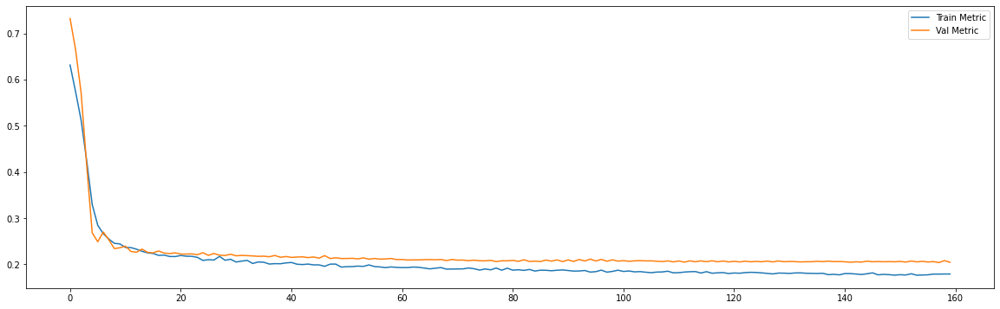

Epoch 00141: early stopping
============================model:16===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0394 - mae: 0.1578
loss and metric train data [0.039388854056596756, 0.15776009857654572]
9/9 [==============================] - 0s 2ms/step - loss: 0.0536 - mae: 0.1807
loss and metric val data [0.053636595606803894, 0.18072253465652466]
9/9 [==============================] - 0s 3ms/step - loss: 0.0643 - mae: 0.1850
loss and metric test data [0.06430526822805405, 0.18499673902988434]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




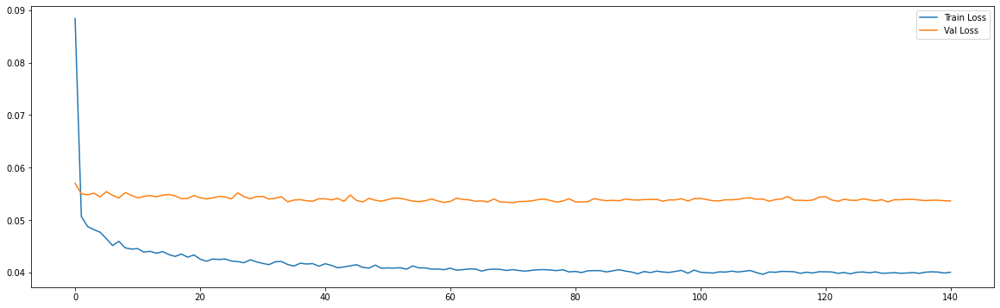

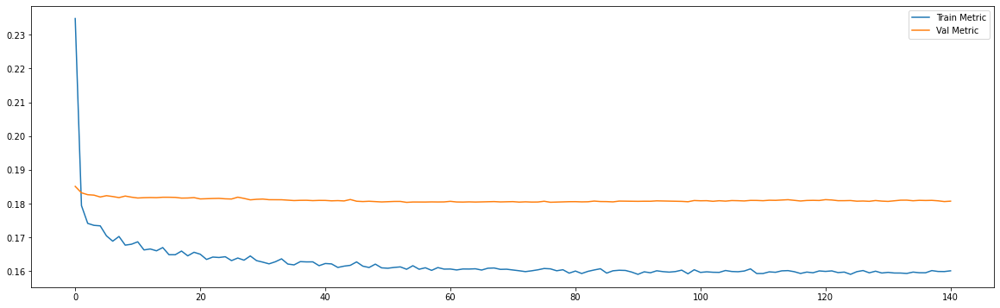

Epoch 00117: early stopping
============================model:17===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0393 - mae: 0.1574
loss and metric train data [0.039252061396837234, 0.15736563503742218]
9/9 [==============================] - 0s 3ms/step - loss: 0.0536 - mae: 0.1805
loss and metric val data [0.053574249148368835, 0.18054114282131195]
9/9 [==============================] - 0s 3ms/step - loss: 0.0638 - mae: 0.1842
loss and metric test data [0.06375394761562347, 0.18424811959266663]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




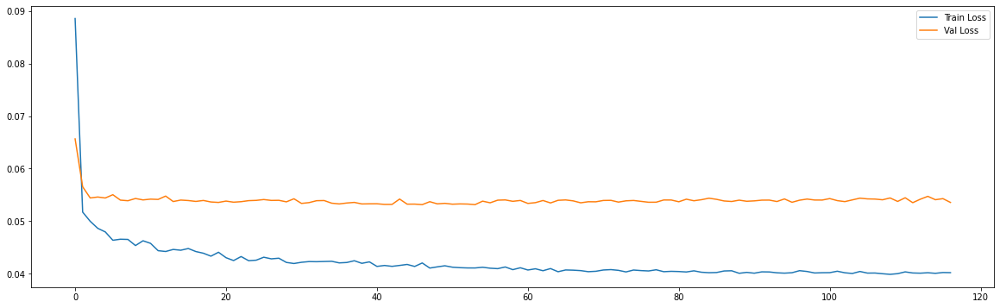

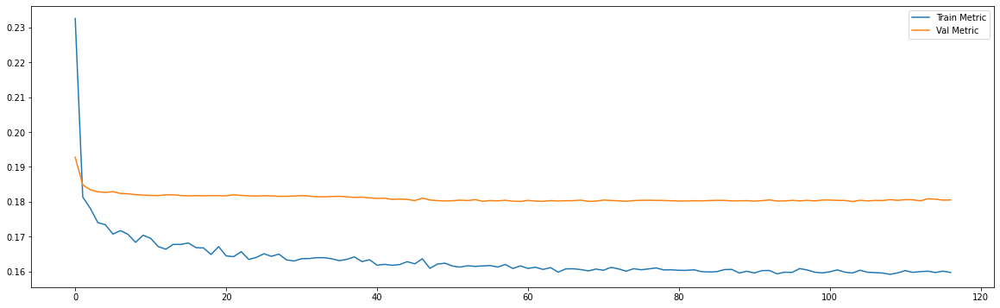

Epoch 00097: early stopping
============================model:18===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0387 - mae: 0.1563
loss and metric train data [0.03870435059070587, 0.15631769597530365]
8/8 [==============================] - 0s 2ms/step - loss: 0.0506 - mae: 0.1737
loss and metric val data [0.05061161518096924, 0.1736794412136078]
8/8 [==============================] - 0s 2ms/step - loss: 0.0700 - mae: 0.1970
loss and metric test data [0.07004458457231522, 0.1970488727092743]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




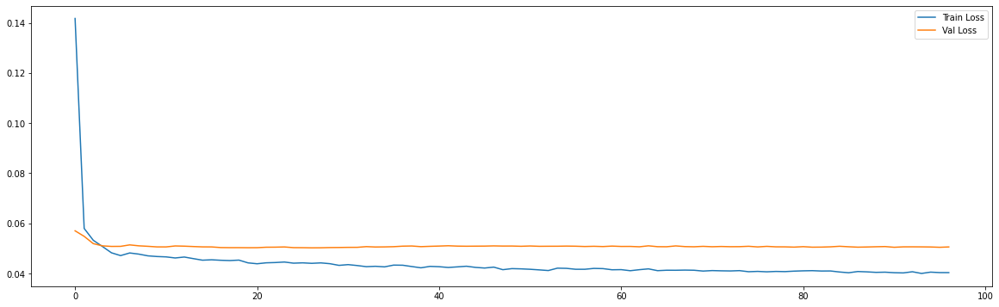

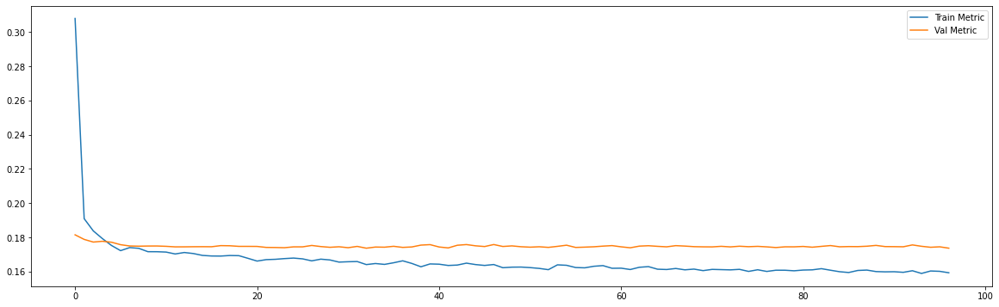

Epoch 00221: early stopping
============================model:19===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0378 - mae: 0.1536
loss and metric train data [0.037819068878889084, 0.15362156927585602]
8/8 [==============================] - 0s 4ms/step - loss: 0.0513 - mae: 0.1749
loss and metric val data [0.05133654177188873, 0.17489740252494812]
8/8 [==============================] - 0s 3ms/step - loss: 0.0677 - mae: 0.1933
loss and metric test data [0.06768126785755157, 0.19325390458106995]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




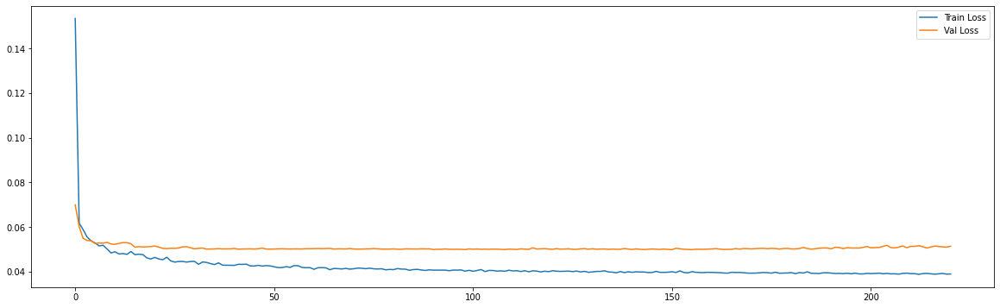

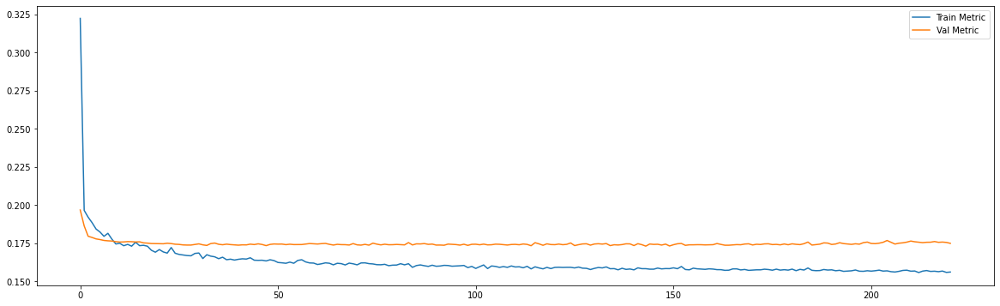

Epoch 00108: early stopping
============================model:20===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0382 - mae: 0.1557
loss and metric train data [0.03822903335094452, 0.15567754209041595]
7/7 [==============================] - 0s 3ms/step - loss: 0.0497 - mae: 0.1704
loss and metric val data [0.04970811679959297, 0.1704326570034027]
7/7 [==============================] - 0s 3ms/step - loss: 0.0842 - mae: 0.2222
loss and metric test data [0.08417947590351105, 0.2222101241350174]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




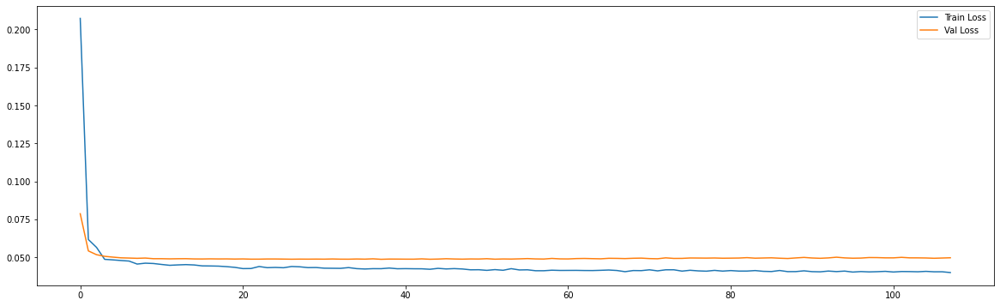

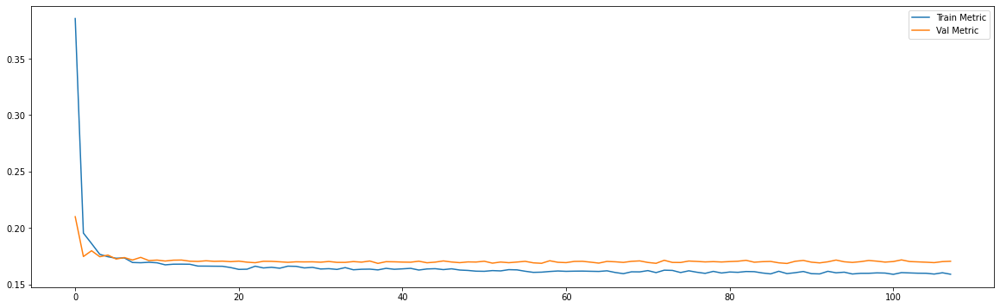

Epoch 00108: early stopping
============================model:21===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0381 - mae: 0.1553
loss and metric train data [0.03805190324783325, 0.15534591674804688]
7/7 [==============================] - 0s 4ms/step - loss: 0.0492 - mae: 0.1701
loss and metric val data [0.049227241426706314, 0.1700834035873413]
7/7 [==============================] - 0s 4ms/step - loss: 0.0824 - mae: 0.2186
loss and metric test data [0.08239554613828659, 0.21862348914146423]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




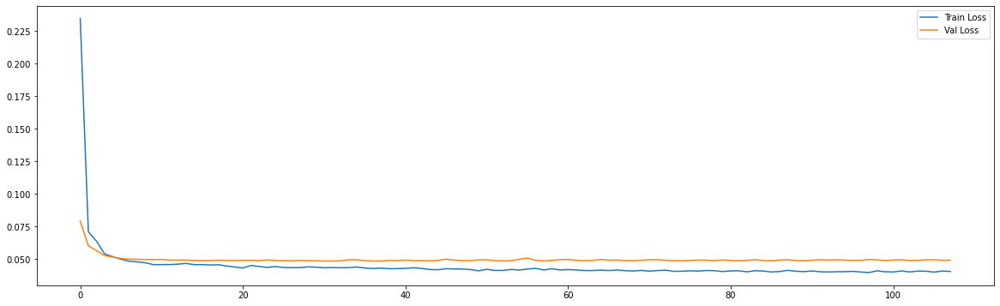

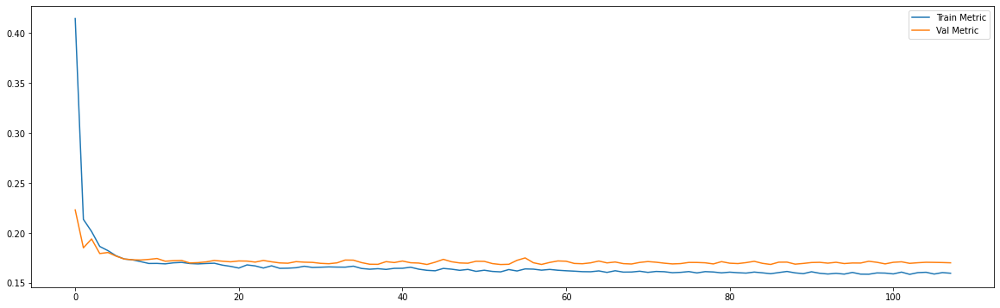

Epoch 00128: early stopping
============================model:22===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0425 - mae: 0.1659
loss and metric train data [0.04250812903046608, 0.16587364673614502]
3/3 [==============================] - 0s 4ms/step - loss: 0.0726 - mae: 0.2071
loss and metric val data [0.07263810187578201, 0.20705685019493103]
3/3 [==============================] - 0s 3ms/step - loss: 0.1505 - mae: 0.3086
loss and metric test data [0.15050622820854187, 0.3086162209510803]


'neurons': 50, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




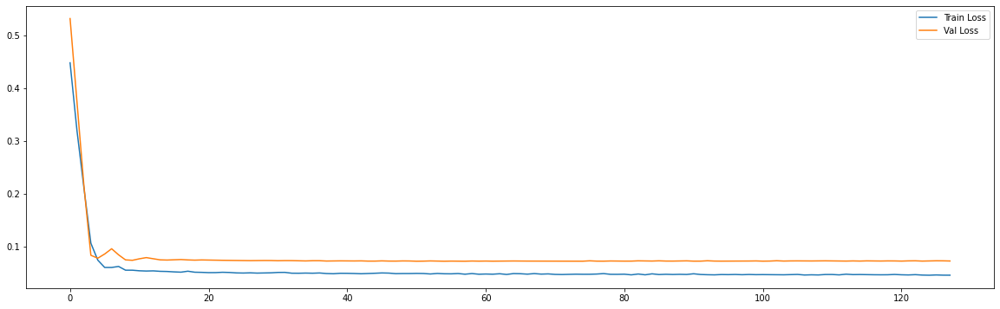

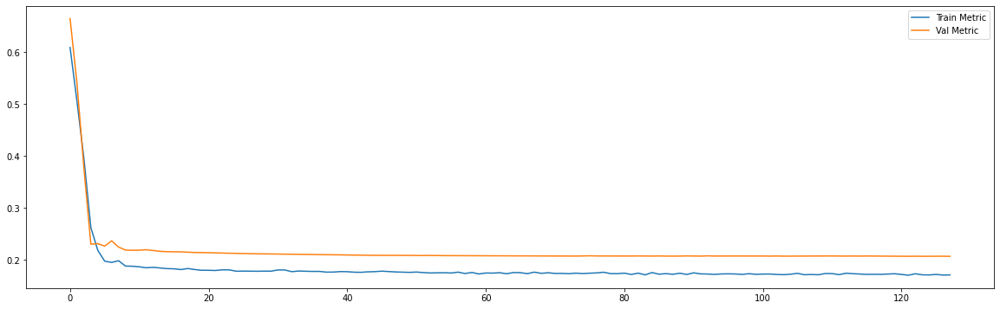

Epoch 00319: early stopping
============================model:23===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0423 - mae: 0.1660
loss and metric train data [0.04227106645703316, 0.1659863293170929]
3/3 [==============================] - 0s 6ms/step - loss: 0.0695 - mae: 0.2043
loss and metric val data [0.06946241110563278, 0.20434802770614624]
3/3 [==============================] - 0s 7ms/step - loss: 0.1462 - mae: 0.2990
loss and metric test data [0.1462412029504776, 0.2990129292011261]


'neurons': 50, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




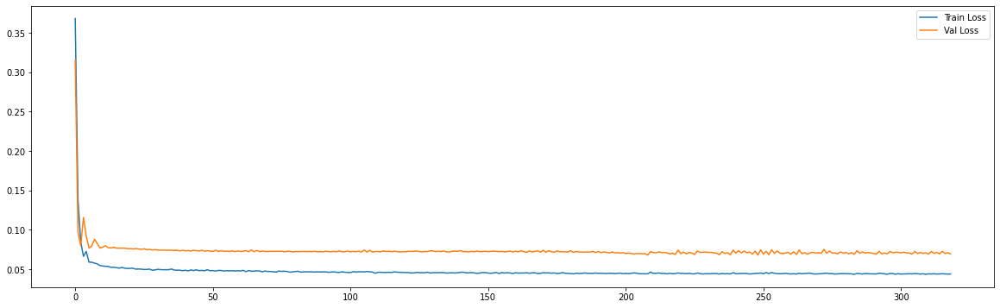

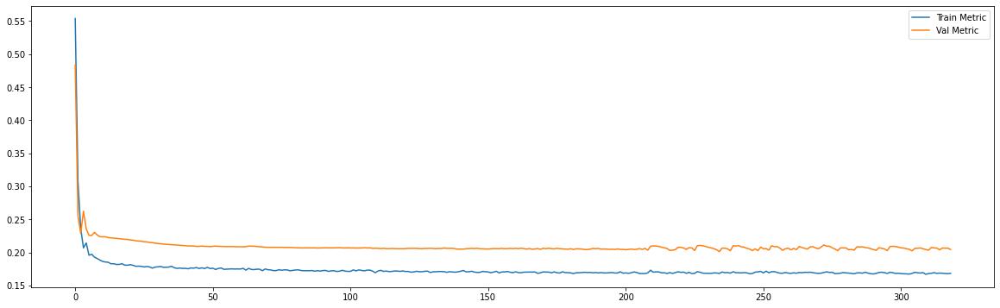

Epoch 00286: early stopping
============================model:24===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0393 - mae: 0.1559
loss and metric train data [0.03931539133191109, 0.15587449073791504]
9/9 [==============================] - 0s 2ms/step - loss: 0.0692 - mae: 0.2001
loss and metric val data [0.06919980049133301, 0.20010574162006378]
9/9 [==============================] - 0s 2ms/step - loss: 0.0914 - mae: 0.2128
loss and metric test data [0.09136005491018295, 0.21280677616596222]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




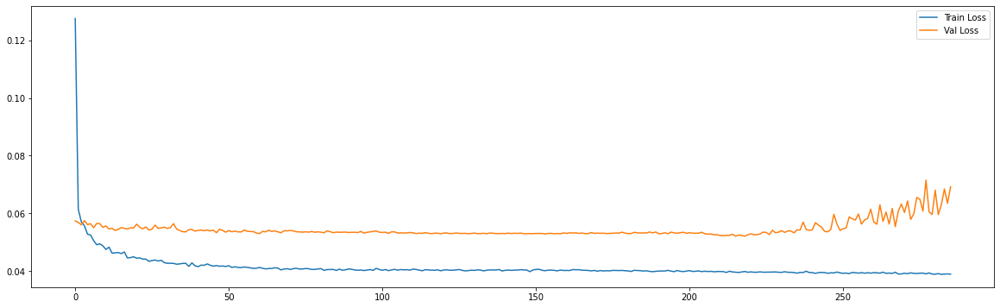

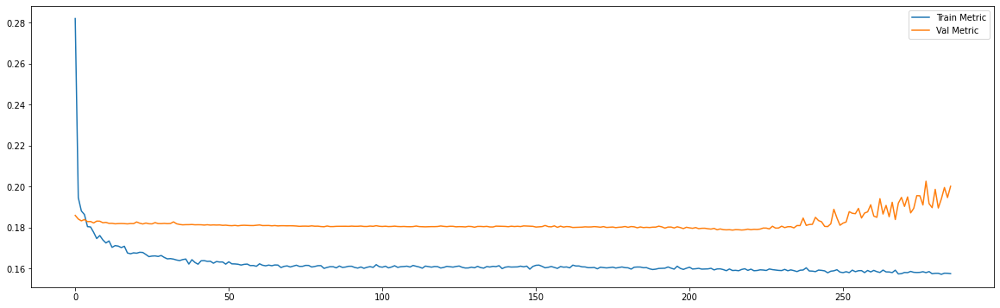

Epoch 00120: early stopping
============================model:25===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0395 - mae: 0.1573
loss and metric train data [0.039533842355012894, 0.1573019176721573]
9/9 [==============================] - 0s 3ms/step - loss: 0.0539 - mae: 0.1799
loss and metric val data [0.0539102703332901, 0.17994627356529236]
9/9 [==============================] - 0s 3ms/step - loss: 0.0642 - mae: 0.1847
loss and metric test data [0.06423686444759369, 0.18470527231693268]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




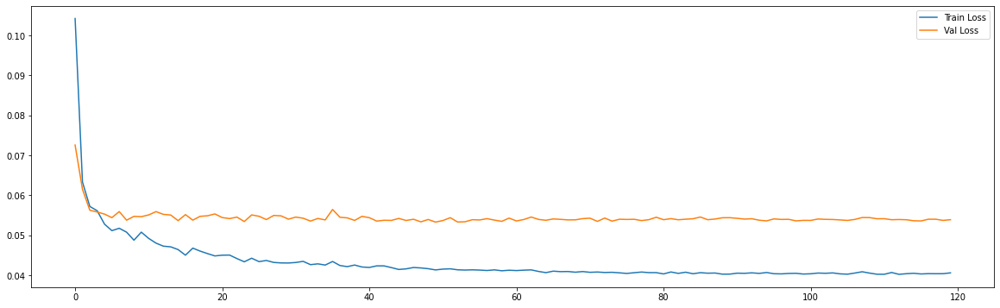

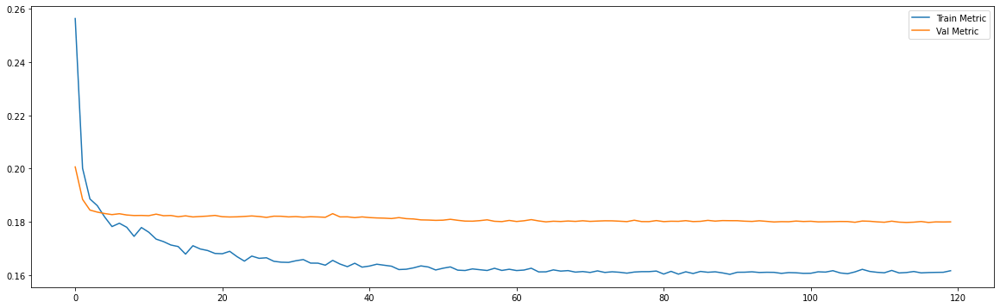

Epoch 00093: early stopping
============================model:26===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0387 - mae: 0.1568
loss and metric train data [0.038721054792404175, 0.15680661797523499]
8/8 [==============================] - 0s 3ms/step - loss: 0.0507 - mae: 0.1747
loss and metric val data [0.050685375928878784, 0.17472393810749054]
8/8 [==============================] - 0s 2ms/step - loss: 0.0698 - mae: 0.1973
loss and metric test data [0.06979111582040787, 0.1972787082195282]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




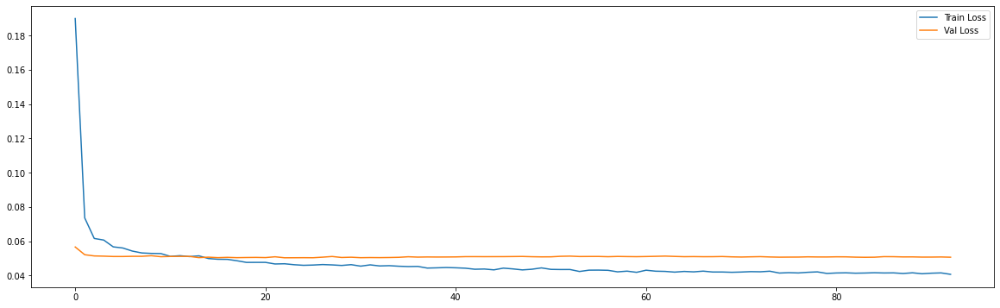

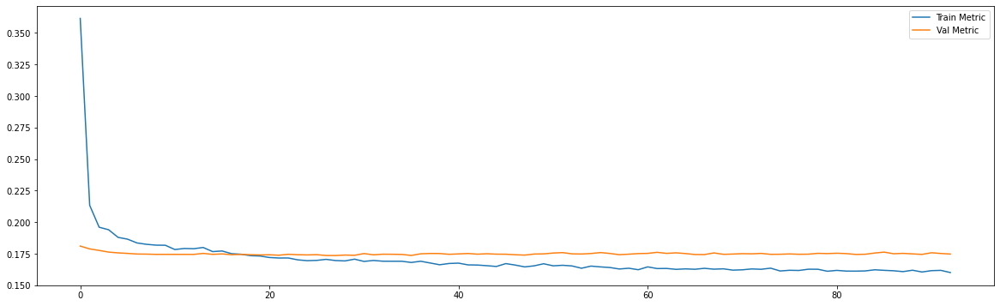

Epoch 00198: early stopping
============================model:27===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0383 - mae: 0.1555
loss and metric train data [0.03833119198679924, 0.15552832186222076]
8/8 [==============================] - 0s 4ms/step - loss: 0.0502 - mae: 0.1744
loss and metric val data [0.05015300214290619, 0.17436976730823517]
8/8 [==============================] - 0s 3ms/step - loss: 0.0691 - mae: 0.1952
loss and metric test data [0.06909392774105072, 0.19517193734645844]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




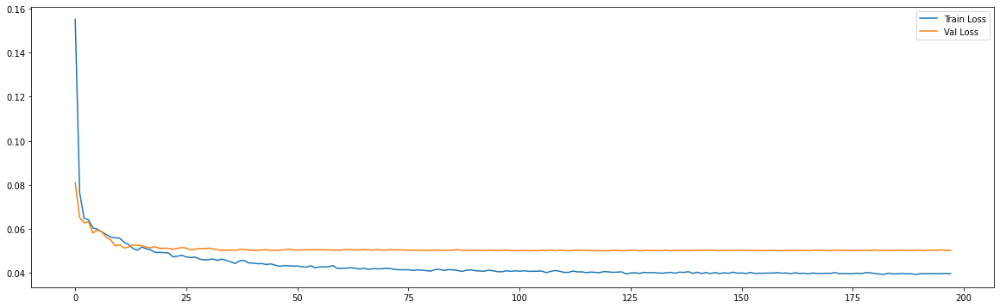

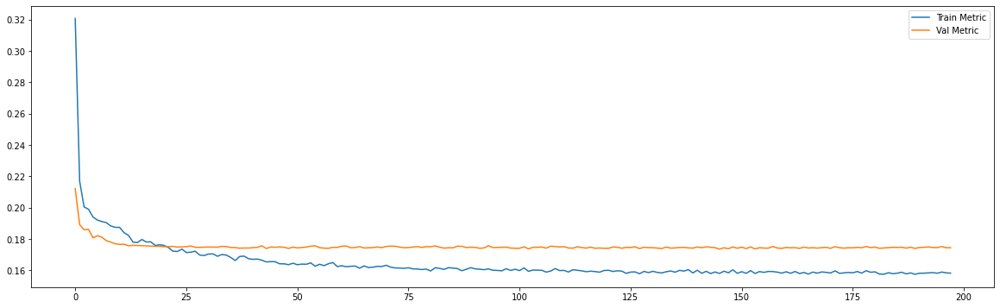

Epoch 00095: early stopping
============================model:28===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0382 - mae: 0.1559
loss and metric train data [0.03819235786795616, 0.1558542400598526]
7/7 [==============================] - 0s 3ms/step - loss: 0.0495 - mae: 0.1698
loss and metric val data [0.04950380325317383, 0.16983367502689362]
7/7 [==============================] - 0s 3ms/step - loss: 0.0849 - mae: 0.2228
loss and metric test data [0.08488155156373978, 0.2227998524904251]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




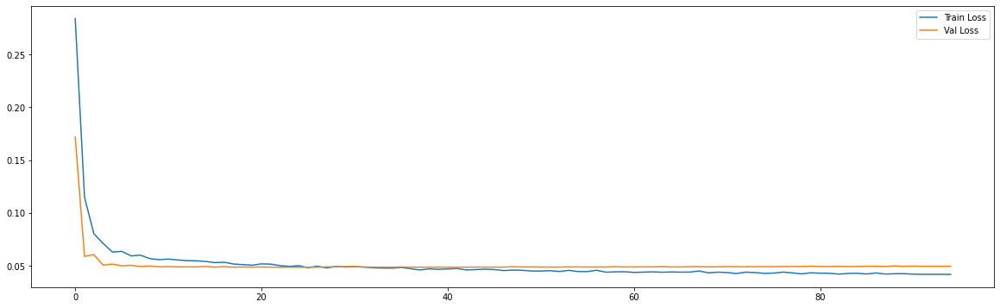

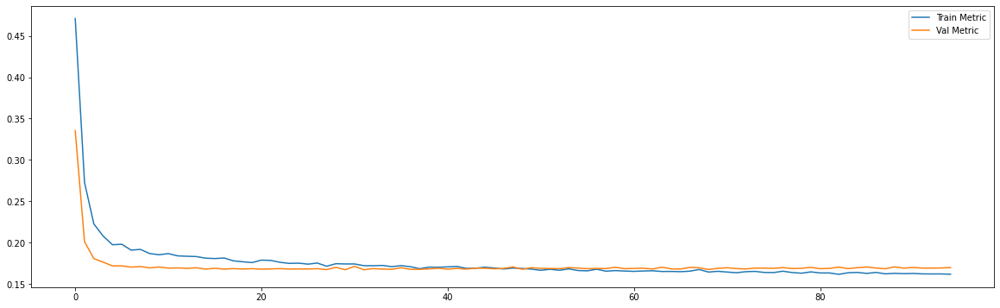

Epoch 00123: early stopping
============================model:29===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0383 - mae: 0.1557
loss and metric train data [0.038263238966464996, 0.15568305552005768]
7/7 [==============================] - 0s 4ms/step - loss: 0.0503 - mae: 0.1724
loss and metric val data [0.05029623955488205, 0.17238444089889526]
7/7 [==============================] - 0s 4ms/step - loss: 0.0831 - mae: 0.2201
loss and metric test data [0.08310117572546005, 0.22007451951503754]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




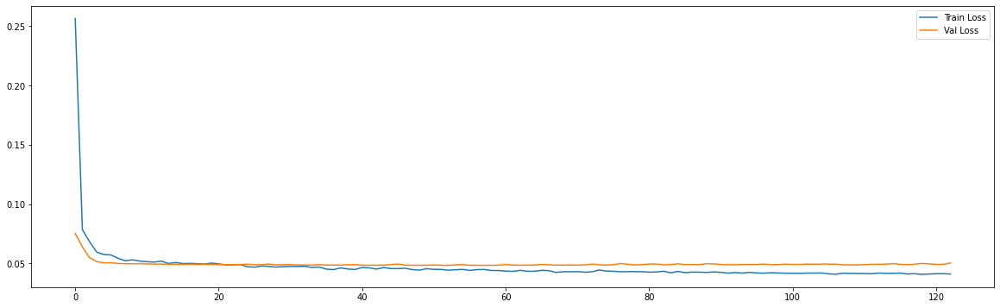

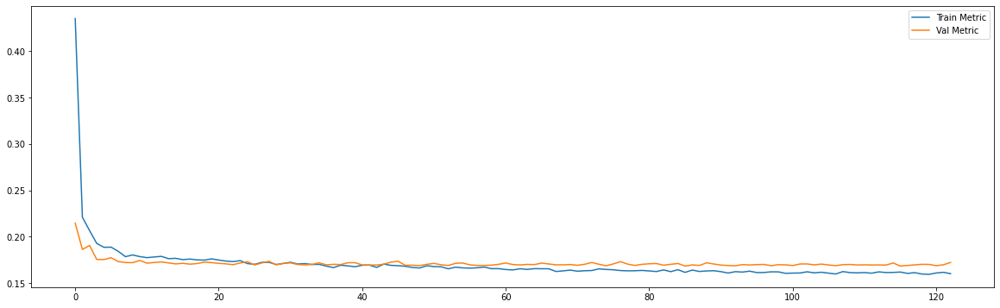

Epoch 00143: early stopping
============================model:30===========================
32/32 [==============================] - 0s 4ms/step - loss: 0.0424 - mae: 0.1654
loss and metric train data [0.04235037416219711, 0.16542640328407288]
3/3 [==============================] - 0s 4ms/step - loss: 0.0730 - mae: 0.2070
loss and metric val data [0.07303720712661743, 0.20701134204864502]
3/3 [==============================] - 0s 7ms/step - loss: 0.1497 - mae: 0.3064
loss and metric test data [0.149653822183609, 0.30641061067581177]


'neurons': 50, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




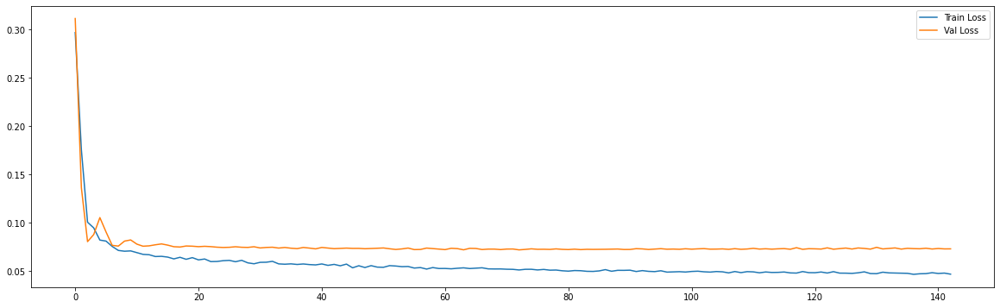

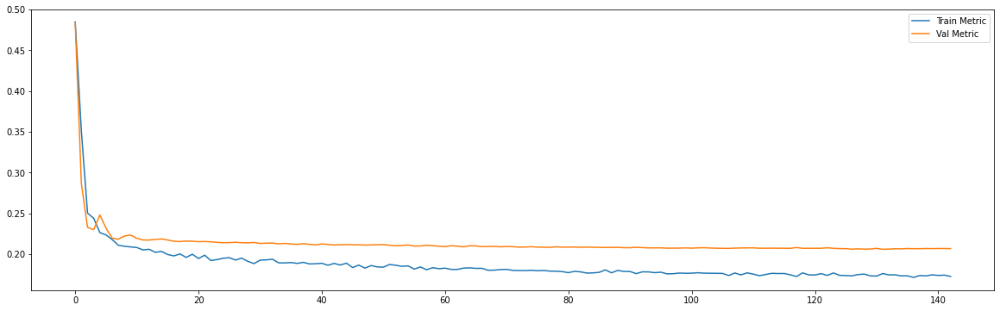

Epoch 00170: early stopping
============================model:31===========================
32/32 [==============================] - 0s 7ms/step - loss: 0.0423 - mae: 0.1657
loss and metric train data [0.04232461750507355, 0.1656680554151535]
3/3 [==============================] - 0s 6ms/step - loss: 0.0729 - mae: 0.2069
loss and metric val data [0.07288535684347153, 0.20690688490867615]
3/3 [==============================] - 0s 5ms/step - loss: 0.1495 - mae: 0.3019
loss and metric test data [0.1494823545217514, 0.3019479215145111]


'neurons': 50, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




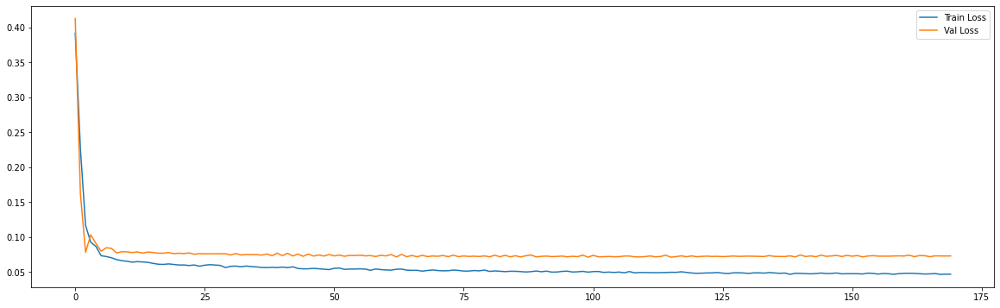

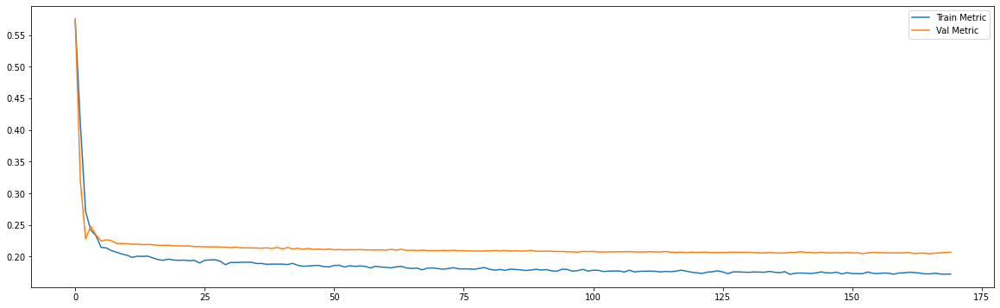

In [ ]:
future_steps = 5
n_features = 1

neurons_list = [30,50]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120,240]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for lr in lr_list:
        x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps, 'learning_rate':lr}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,lr,1)

        # The LSTM architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the LSTM
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1


        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,2)

        # The LSTM architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(LSTM(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(LSTM(units=neurons, return_sequences=False))
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the LSTM
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

         # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1

## Excluding Outliers 

In [ ]:
df_daily = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesdaily.csv')
df_daily = df_daily['N02BE']

In [ ]:
df_train,df_val,df_test = dataSplit(df = df_daily,train_percent = 0.7,val_percent = 0.15)

(1474,)
(316,)
(316,)


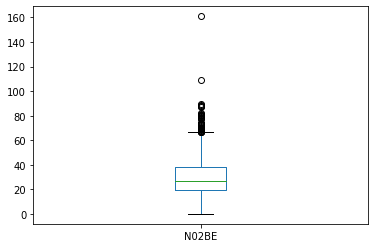

In [ ]:
df_train.plot.box()

In [ ]:
print(df_train[df_train>df_train.quantile(0.8)].shape)
print(df_train[df_train>df_train.quantile(0.9)].shape)
print(df_train[df_train>df_train.quantile(0.95)].shape)

(295,)
(148,)
(74,)


In [ ]:
df_train = df_train[df_train<df_train.quantile(0.9)].reset_index(drop = True)

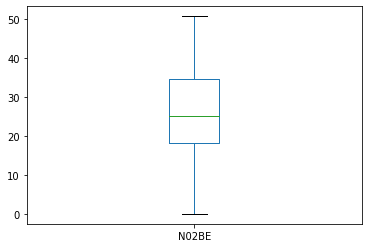

In [ ]:
df_train.plot.box()

In [ ]:
df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange=(0,1))

[1.]
[0.]


[1.47140039]
[0.]


[1.97435897]
[0.]
-------------------------
(1326, 1)
(316, 1)
(316, 1)


Epoch 00232: early stopping
============================model:0===========================
40/40 [==============================] - 0s 2ms/step - loss: 0.0335 - mae: 0.1464
loss and metric train data [0.03350768983364105, 0.1463918834924698]
9/9 [==============================] - 0s 2ms/step - loss: 0.0545 - mae: 0.1848
loss and metric val data [0.05453041195869446, 0.18479062616825104]
9/9 [==============================] - 0s 2ms/step - loss: 0.0711 - mae: 0.1915
loss and metric test data [0.07112518697977066, 0.19153891503810883]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




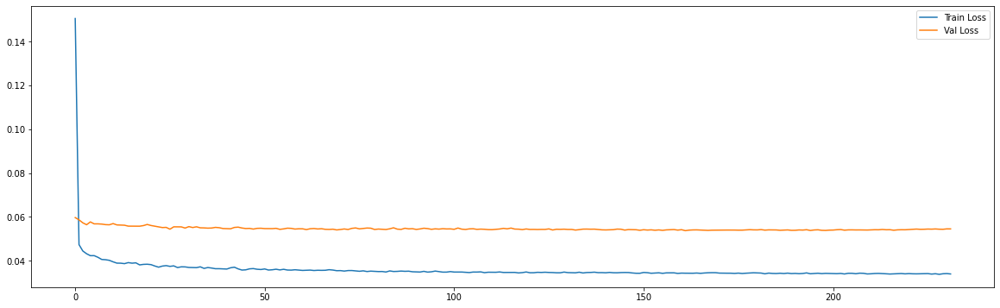

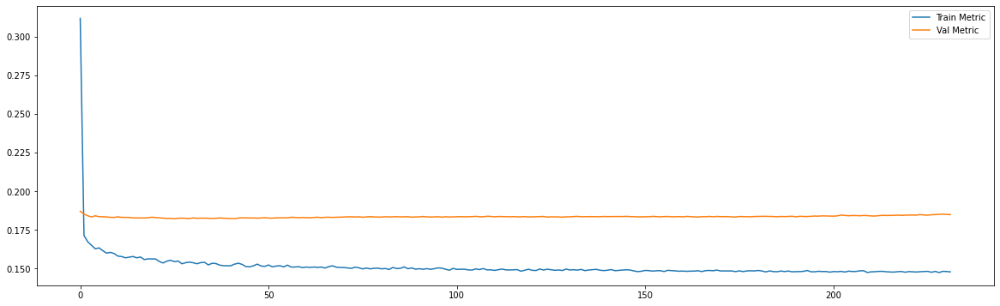

Epoch 00165: early stopping
============================model:1===========================
40/40 [==============================] - 0s 3ms/step - loss: 0.0334 - mae: 0.1460
loss and metric train data [0.03340531513094902, 0.14597788453102112]
9/9 [==============================] - 0s 3ms/step - loss: 0.0570 - mae: 0.1871
loss and metric val data [0.056966595351696014, 0.18709659576416016]
9/9 [==============================] - 0s 3ms/step - loss: 0.0804 - mae: 0.1995
loss and metric test data [0.0803736075758934, 0.19954624772071838]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




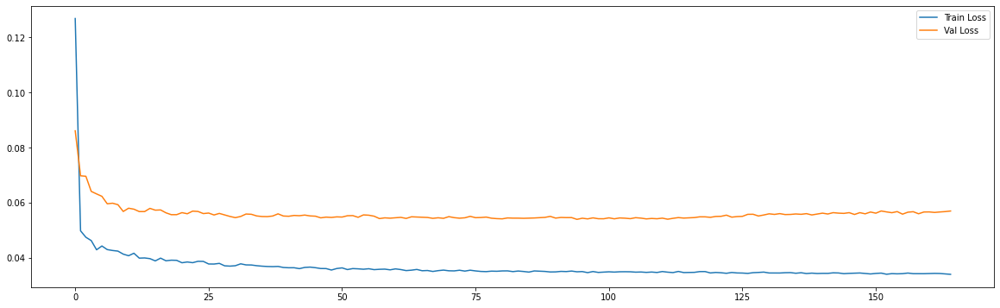

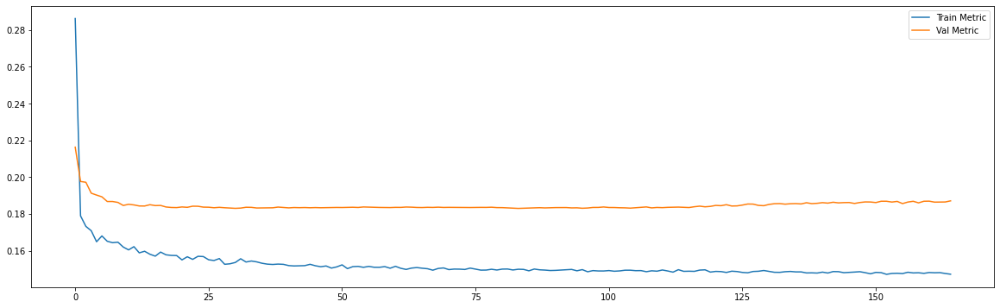

Epoch 00139: early stopping
============================model:2===========================
38/38 [==============================] - 0s 3ms/step - loss: 0.0335 - mae: 0.1463
loss and metric train data [0.033470746129751205, 0.14626801013946533]
8/8 [==============================] - 0s 3ms/step - loss: 0.0510 - mae: 0.1768
loss and metric val data [0.05102367699146271, 0.17680624127388]
8/8 [==============================] - 0s 2ms/step - loss: 0.0733 - mae: 0.1990
loss and metric test data [0.07328750193119049, 0.19899021089076996]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




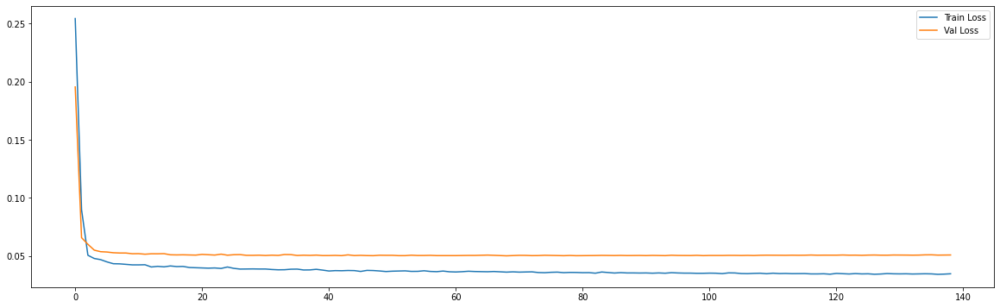

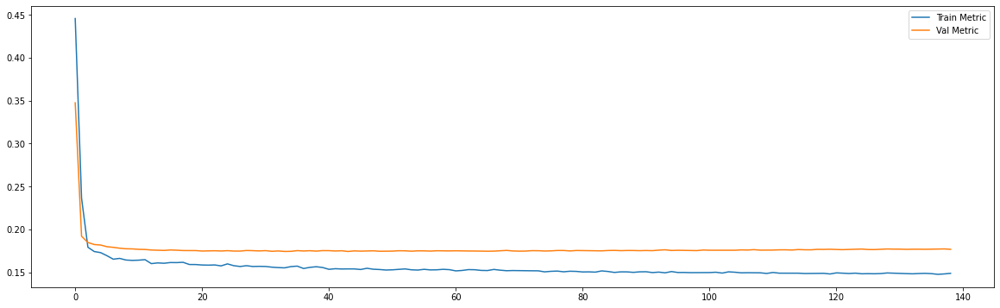

Epoch 00226: early stopping
============================model:3===========================
38/38 [==============================] - 0s 4ms/step - loss: 0.0324 - mae: 0.1437
loss and metric train data [0.032409053295850754, 0.14367622137069702]
8/8 [==============================] - 0s 3ms/step - loss: 0.0532 - mae: 0.1808
loss and metric val data [0.05324743688106537, 0.18080046772956848]
8/8 [==============================] - 0s 3ms/step - loss: 0.0814 - mae: 0.2069
loss and metric test data [0.0814366489648819, 0.20693637430667877]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




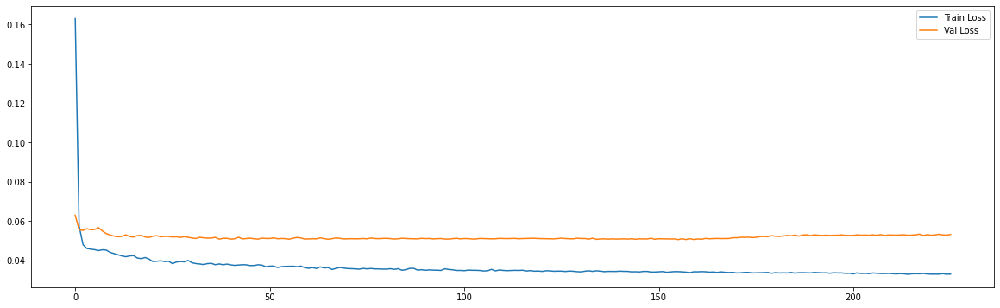

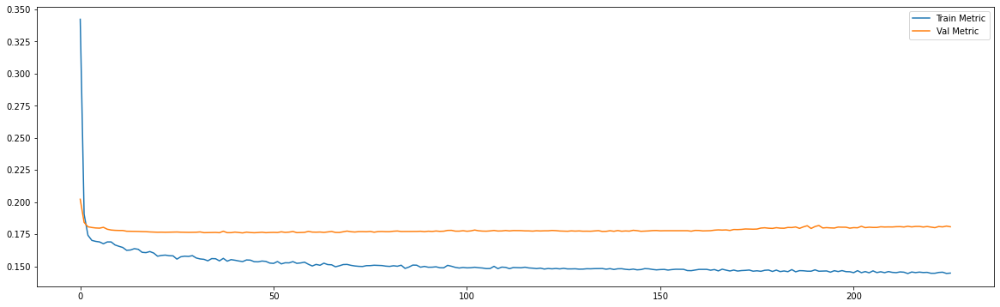

Epoch 00123: early stopping
============================model:4===========================
34/34 [==============================] - 0s 3ms/step - loss: 0.0333 - mae: 0.1449
loss and metric train data [0.03328113257884979, 0.14493349194526672]
7/7 [==============================] - 0s 3ms/step - loss: 0.0494 - mae: 0.1709
loss and metric val data [0.04942477121949196, 0.17088021337985992]
7/7 [==============================] - 0s 3ms/step - loss: 0.0880 - mae: 0.2231
loss and metric test data [0.08803597092628479, 0.22305990755558014]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




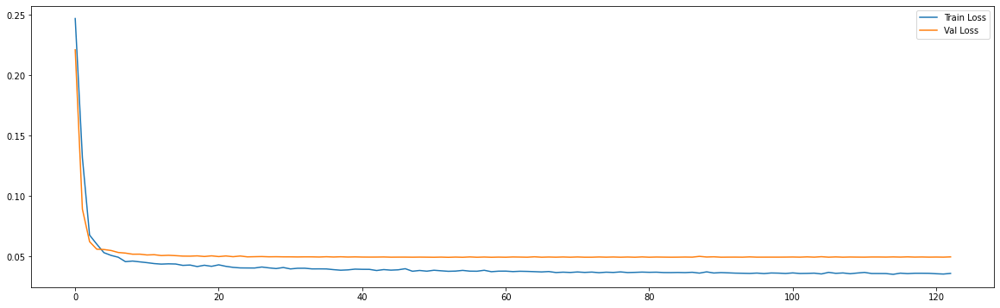

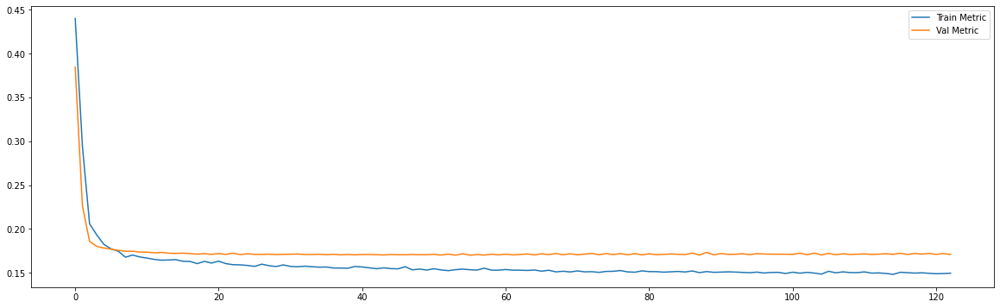

Epoch 00201: early stopping
============================model:5===========================
34/34 [==============================] - 0s 5ms/step - loss: 0.0332 - mae: 0.1447
loss and metric train data [0.03317549079656601, 0.14466716349124908]
7/7 [==============================] - 0s 4ms/step - loss: 0.0496 - mae: 0.1719
loss and metric val data [0.049575913697481155, 0.17190948128700256]
7/7 [==============================] - 0s 4ms/step - loss: 0.0892 - mae: 0.2232
loss and metric test data [0.08923615515232086, 0.2232305109500885]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




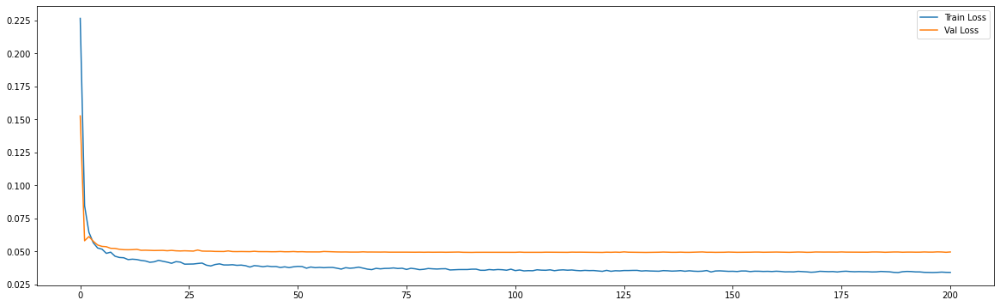

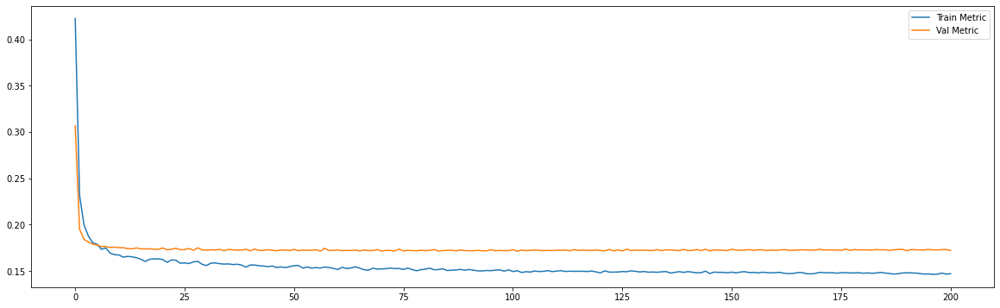

Epoch 00309: early stopping
============================model:6===========================
27/27 [==============================] - 0s 5ms/step - loss: 0.0368 - mae: 0.1542
loss and metric train data [0.03680327907204628, 0.15420641005039215]
3/3 [==============================] - 0s 3ms/step - loss: 0.0742 - mae: 0.2136
loss and metric val data [0.0741632878780365, 0.21362578868865967]
3/3 [==============================] - 0s 4ms/step - loss: 0.1578 - mae: 0.3092
loss and metric test data [0.15778015553951263, 0.3091769218444824]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




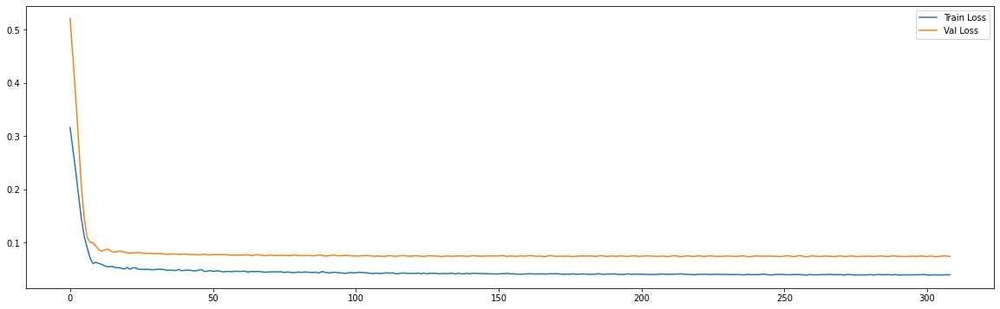

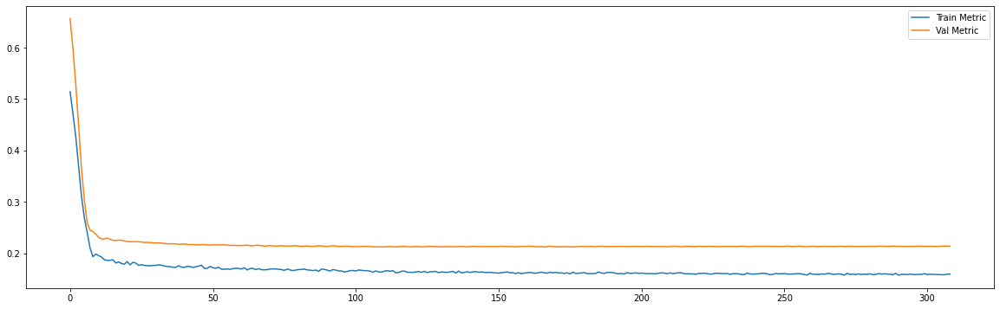

Epoch 00251: early stopping
============================model:7===========================
27/27 [==============================] - 0s 8ms/step - loss: 0.0367 - mae: 0.1539
loss and metric train data [0.036692723631858826, 0.15393583476543427]
3/3 [==============================] - 0s 5ms/step - loss: 0.0736 - mae: 0.2135
loss and metric val data [0.07360410690307617, 0.21348491311073303]
3/3 [==============================] - 0s 5ms/step - loss: 0.1619 - mae: 0.3104
loss and metric test data [0.1618868112564087, 0.31043633818626404]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




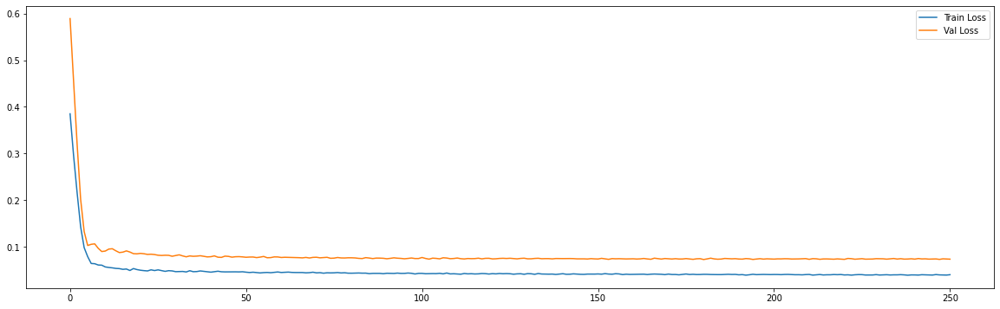

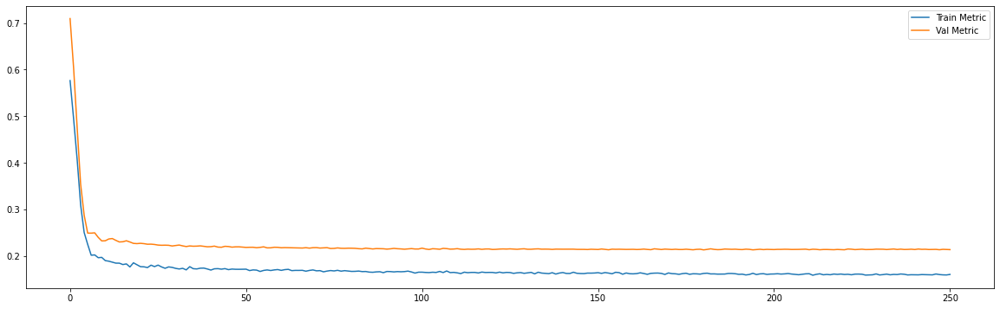

Epoch 00248: early stopping
============================model:8===========================
40/40 [==============================] - 0s 2ms/step - loss: 0.0335 - mae: 0.1461
loss and metric train data [0.03347517177462578, 0.14614032208919525]
9/9 [==============================] - 0s 2ms/step - loss: 0.0553 - mae: 0.1852
loss and metric val data [0.05527695640921593, 0.18519890308380127]
9/9 [==============================] - 0s 2ms/step - loss: 0.0736 - mae: 0.1937
loss and metric test data [0.07355839759111404, 0.19367721676826477]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




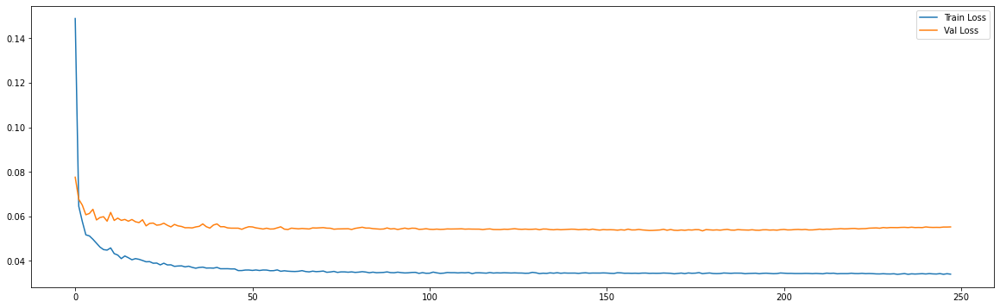

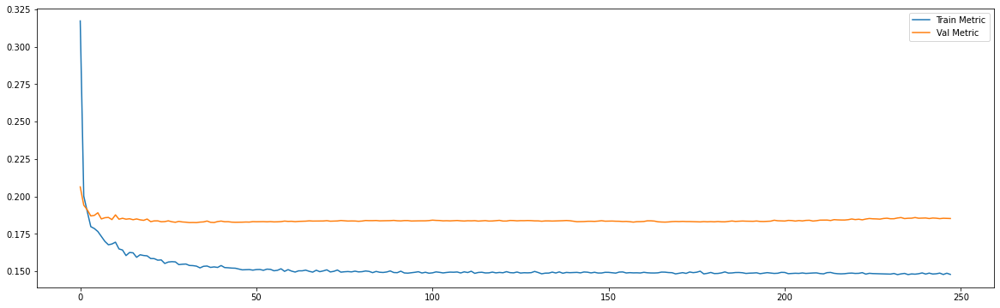

Epoch 00158: early stopping
============================model:9===========================
40/40 [==============================] - 0s 3ms/step - loss: 0.0335 - mae: 0.1459
loss and metric train data [0.03349706530570984, 0.14585500955581665]
9/9 [==============================] - 0s 3ms/step - loss: 0.0560 - mae: 0.1852
loss and metric val data [0.05596376955509186, 0.1852022111415863]
9/9 [==============================] - 0s 3ms/step - loss: 0.0782 - mae: 0.1971
loss and metric test data [0.0782284289598465, 0.19714966416358948]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




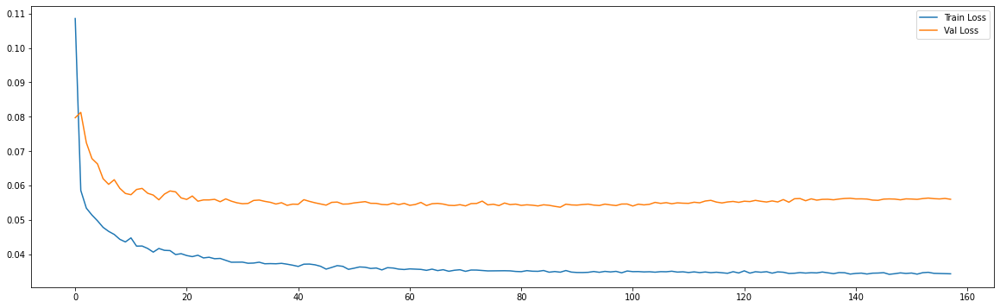

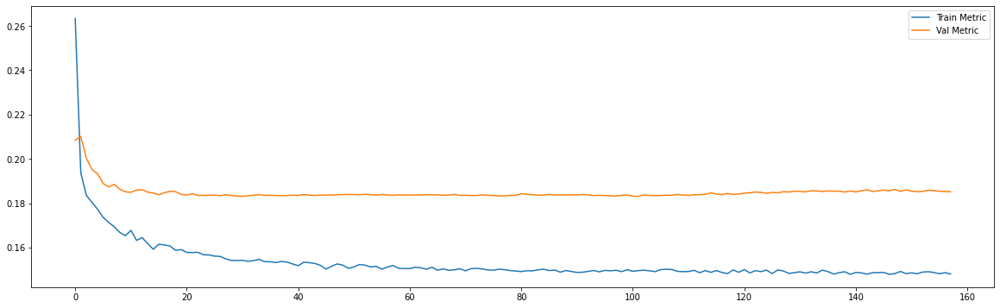

Epoch 00104: early stopping
============================model:10===========================
38/38 [==============================] - 0s 3ms/step - loss: 0.0336 - mae: 0.1465
loss and metric train data [0.03355508670210838, 0.1464628130197525]
8/8 [==============================] - 0s 2ms/step - loss: 0.0512 - mae: 0.1763
loss and metric val data [0.051188208162784576, 0.1762527972459793]
8/8 [==============================] - 0s 2ms/step - loss: 0.0735 - mae: 0.1983
loss and metric test data [0.07345130294561386, 0.19833537936210632]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




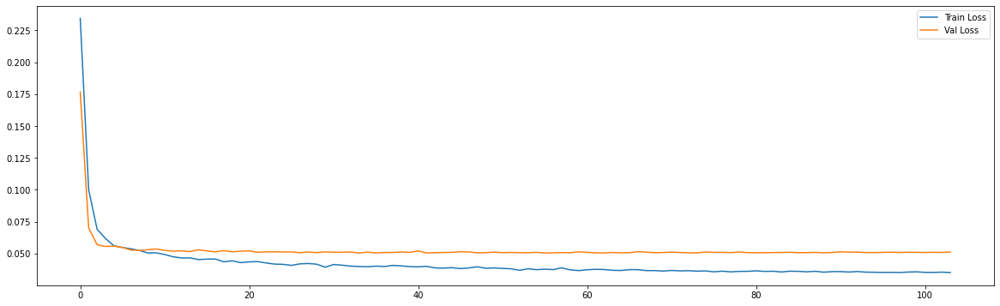

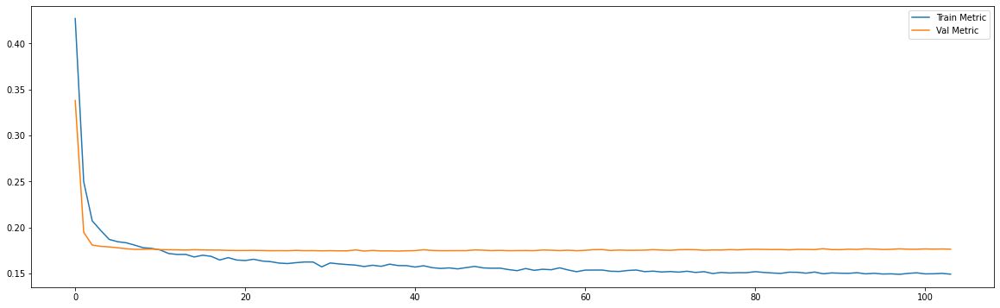

Epoch 00144: early stopping
============================model:11===========================
38/38 [==============================] - 0s 4ms/step - loss: 0.0334 - mae: 0.1464
loss and metric train data [0.033410124480724335, 0.14639343321323395]
8/8 [==============================] - 0s 3ms/step - loss: 0.0510 - mae: 0.1776
loss and metric val data [0.051030758768320084, 0.17764586210250854]
8/8 [==============================] - 0s 3ms/step - loss: 0.0740 - mae: 0.2000
loss and metric test data [0.07401645928621292, 0.19997678697109222]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




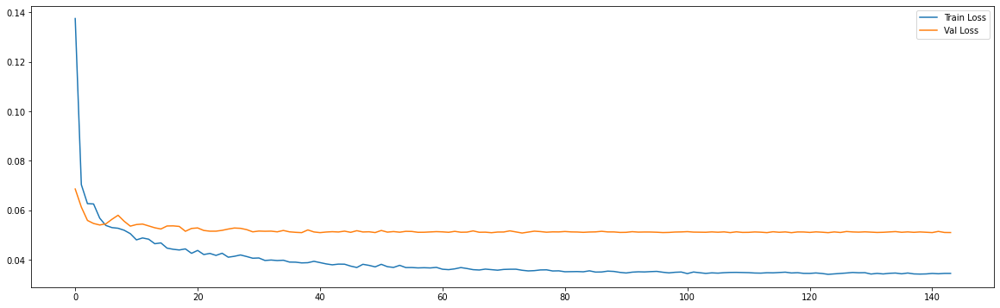

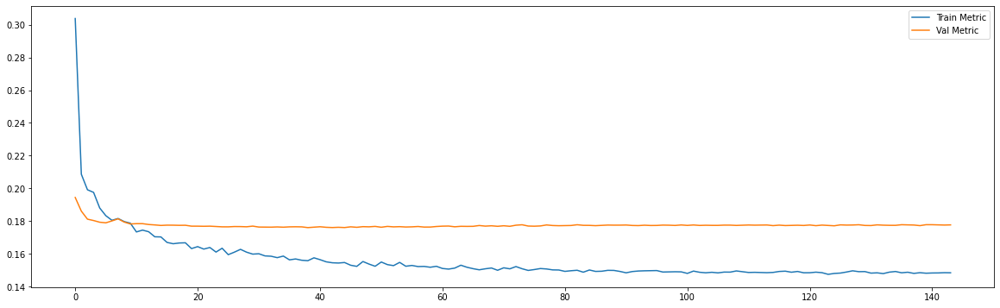

Epoch 00170: early stopping
============================model:12===========================
34/34 [==============================] - 0s 4ms/step - loss: 0.0332 - mae: 0.1451
loss and metric train data [0.033185310661792755, 0.14509707689285278]
7/7 [==============================] - 0s 4ms/step - loss: 0.0496 - mae: 0.1724
loss and metric val data [0.04961252585053444, 0.17235729098320007]
7/7 [==============================] - 0s 3ms/step - loss: 0.0884 - mae: 0.2229
loss and metric test data [0.0883805900812149, 0.22290077805519104]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




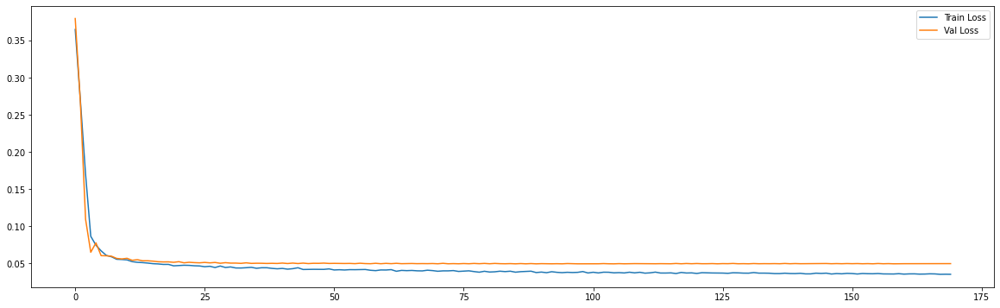

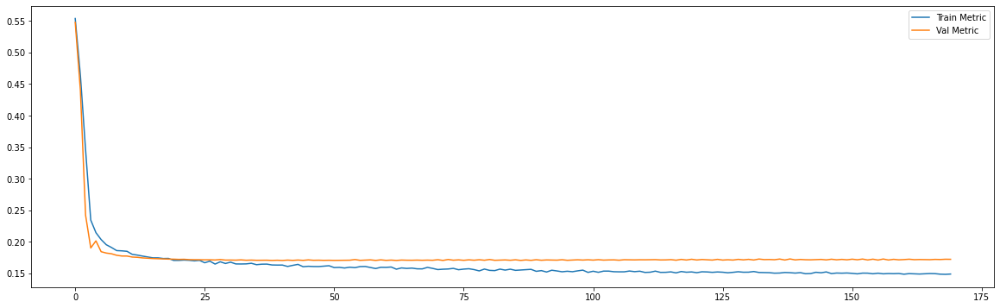

Epoch 00155: early stopping
============================model:13===========================
34/34 [==============================] - 0s 5ms/step - loss: 0.0332 - mae: 0.1449
loss and metric train data [0.03320644795894623, 0.1449136734008789]
7/7 [==============================] - 0s 5ms/step - loss: 0.0498 - mae: 0.1724
loss and metric val data [0.049761734902858734, 0.17240296304225922]
7/7 [==============================] - 0s 5ms/step - loss: 0.0896 - mae: 0.2238
loss and metric test data [0.08963997662067413, 0.22376777231693268]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




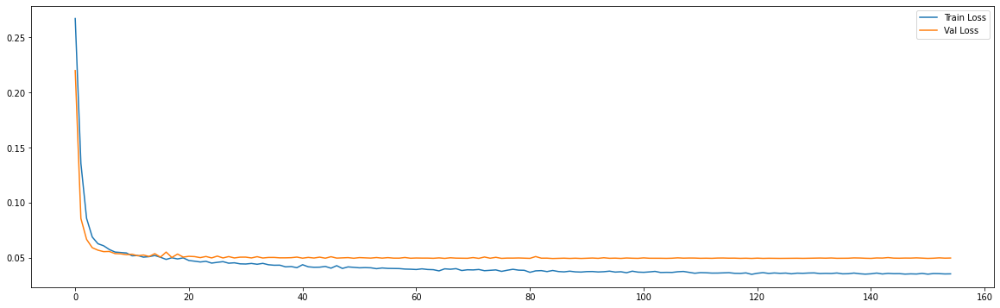

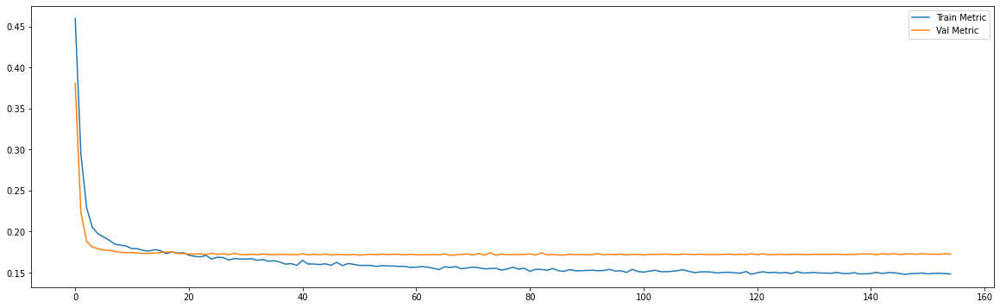

Epoch 00296: early stopping
============================model:14===========================
27/27 [==============================] - 0s 5ms/step - loss: 0.0369 - mae: 0.1543
loss and metric train data [0.03689850866794586, 0.154348224401474]
3/3 [==============================] - 0s 4ms/step - loss: 0.0754 - mae: 0.2148
loss and metric val data [0.0754331722855568, 0.21484661102294922]
3/3 [==============================] - 0s 4ms/step - loss: 0.1612 - mae: 0.3113
loss and metric test data [0.16119328141212463, 0.3112736642360687]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




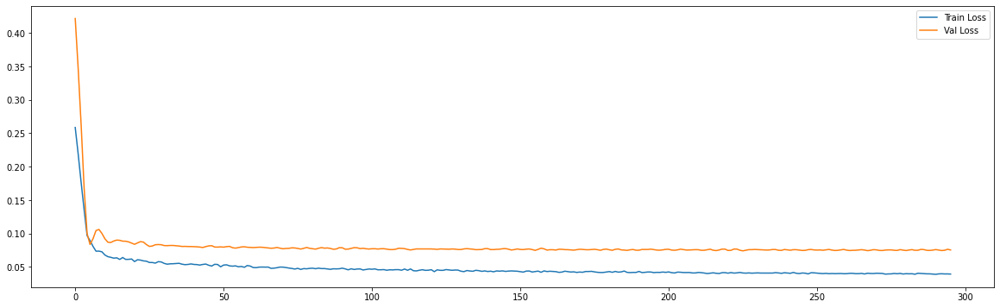

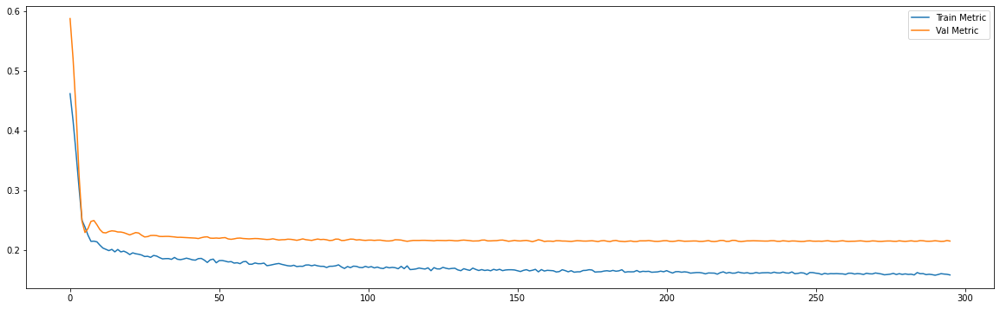

Epoch 00244: early stopping
============================model:15===========================
27/27 [==============================] - 0s 8ms/step - loss: 0.0364 - mae: 0.1536
loss and metric train data [0.036431171000003815, 0.15358170866966248]
3/3 [==============================] - 0s 6ms/step - loss: 0.0768 - mae: 0.2150
loss and metric val data [0.07676786929368973, 0.21495211124420166]
3/3 [==============================] - 0s 6ms/step - loss: 0.1865 - mae: 0.3348
loss and metric test data [0.18652120232582092, 0.3348425626754761]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




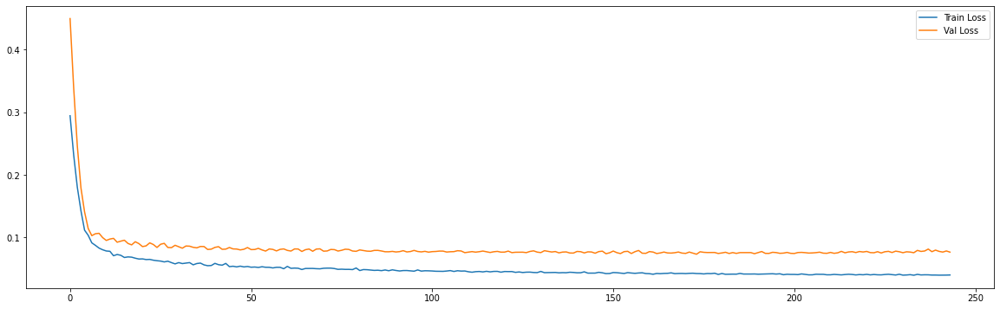

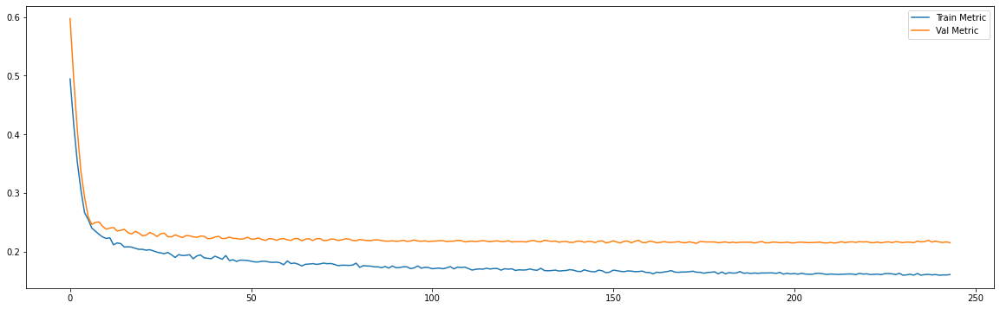

Epoch 00136: early stopping
============================model:16===========================
40/40 [==============================] - 0s 2ms/step - loss: 0.0339 - mae: 0.1469
loss and metric train data [0.033898886293172836, 0.14690199494361877]
9/9 [==============================] - 0s 2ms/step - loss: 0.0546 - mae: 0.1832
loss and metric val data [0.05461797118186951, 0.1831827014684677]
9/9 [==============================] - 0s 2ms/step - loss: 0.0687 - mae: 0.1888
loss and metric test data [0.0687393918633461, 0.18879909813404083]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




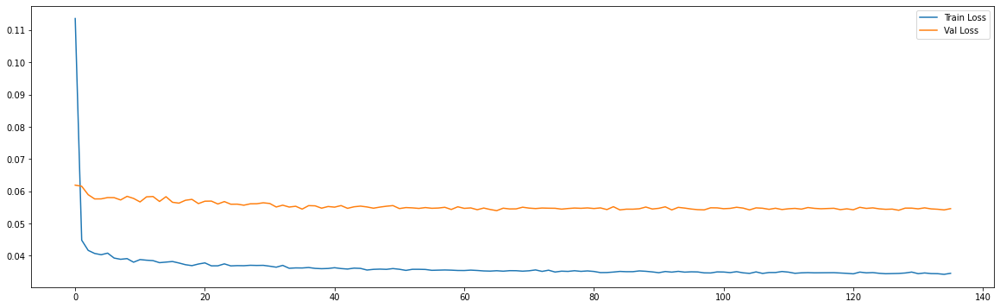

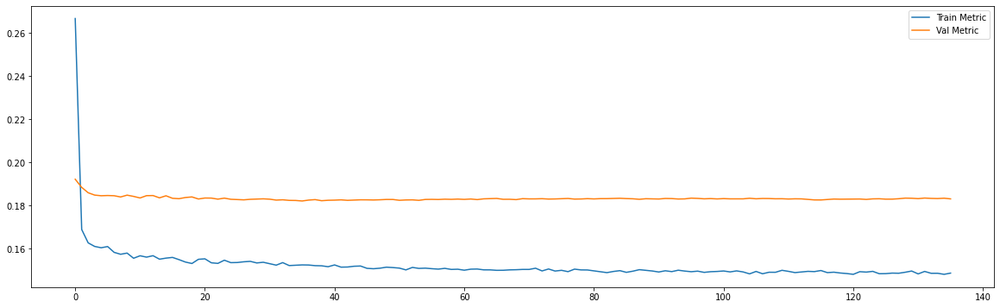

Epoch 00139: early stopping
============================model:17===========================
40/40 [==============================] - 0s 3ms/step - loss: 0.0334 - mae: 0.1456
loss and metric train data [0.033432286232709885, 0.14563734829425812]
9/9 [==============================] - 0s 3ms/step - loss: 0.0566 - mae: 0.1860
loss and metric val data [0.056576915085315704, 0.18600358068943024]
9/9 [==============================] - 0s 3ms/step - loss: 0.0806 - mae: 0.1997
loss and metric test data [0.08055240660905838, 0.1997094452381134]


'neurons': 50, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




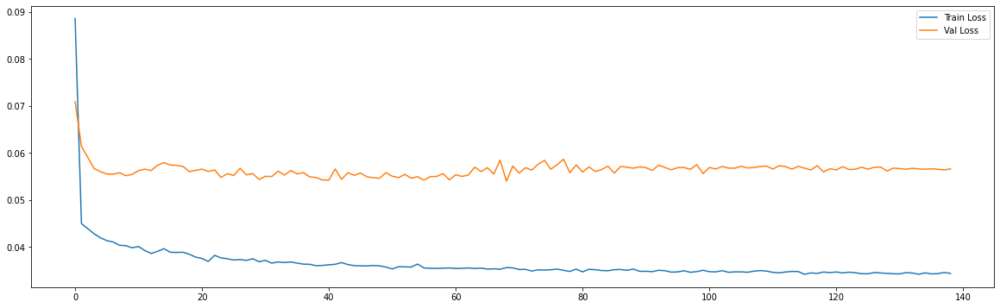

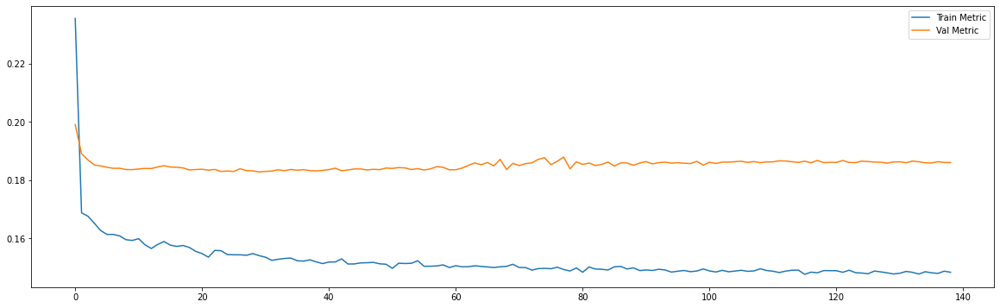

Epoch 00107: early stopping
============================model:18===========================
38/38 [==============================] - 0s 2ms/step - loss: 0.0335 - mae: 0.1463
loss and metric train data [0.03346475586295128, 0.14630639553070068]
8/8 [==============================] - 0s 2ms/step - loss: 0.0510 - mae: 0.1773
loss and metric val data [0.05095434561371803, 0.17733043432235718]
8/8 [==============================] - 0s 2ms/step - loss: 0.0731 - mae: 0.1997
loss and metric test data [0.07312094420194626, 0.19970117509365082]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




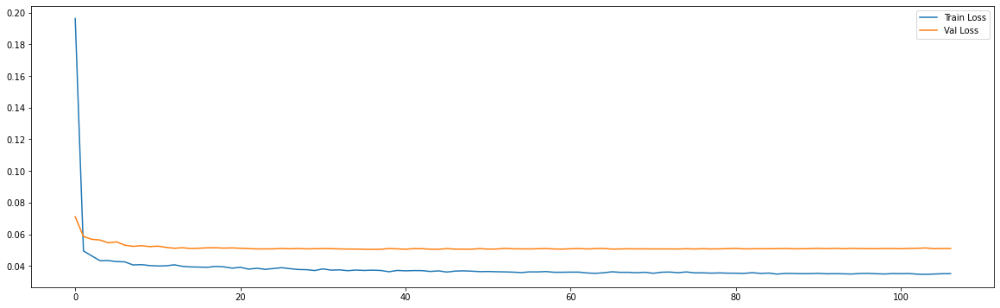

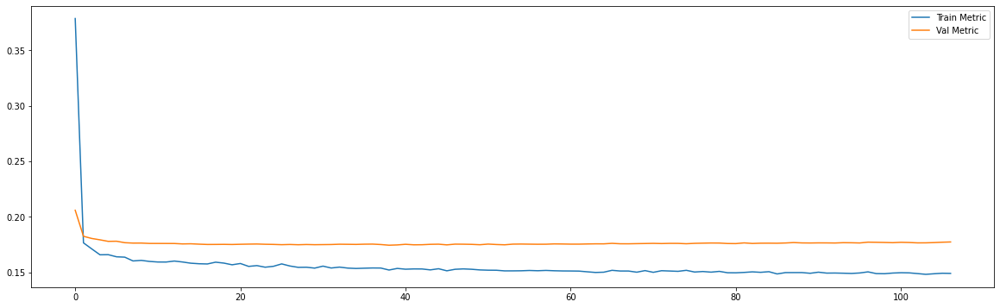

Epoch 00178: early stopping
============================model:19===========================
38/38 [==============================] - 0s 4ms/step - loss: 0.0323 - mae: 0.1428
loss and metric train data [0.03231868892908096, 0.14279243350028992]
8/8 [==============================] - 0s 3ms/step - loss: 0.0541 - mae: 0.1804
loss and metric val data [0.05407685041427612, 0.18040619790554047]
8/8 [==============================] - 0s 3ms/step - loss: 0.0896 - mae: 0.2132
loss and metric test data [0.08959874510765076, 0.2131601870059967]


'neurons': 50, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




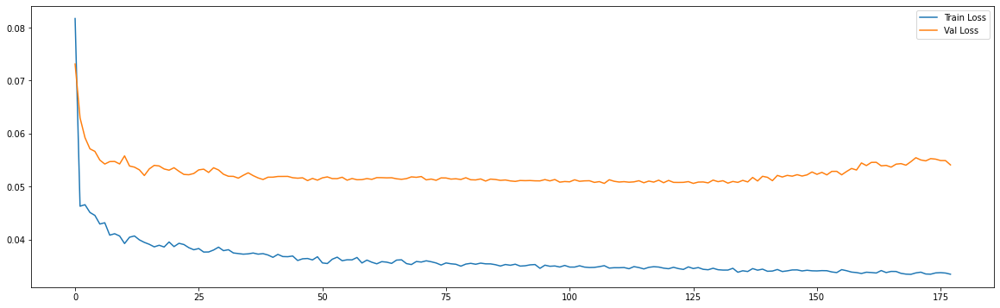

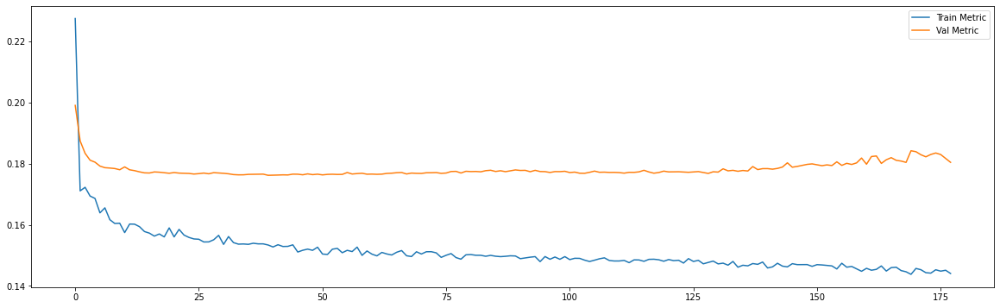

Epoch 00096: early stopping
============================model:20===========================
34/34 [==============================] - 0s 4ms/step - loss: 0.0333 - mae: 0.1450
loss and metric train data [0.03325193002820015, 0.1449822336435318]
7/7 [==============================] - 0s 3ms/step - loss: 0.0492 - mae: 0.1718
loss and metric val data [0.04919079691171646, 0.17181149125099182]
7/7 [==============================] - 0s 3ms/step - loss: 0.0863 - mae: 0.2239
loss and metric test data [0.08632364869117737, 0.22385655343532562]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




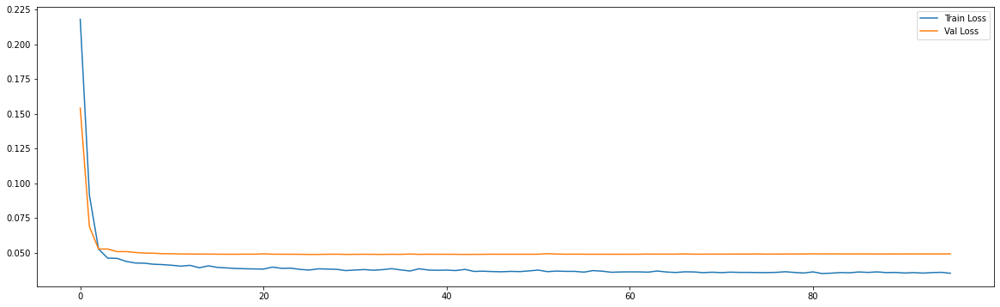

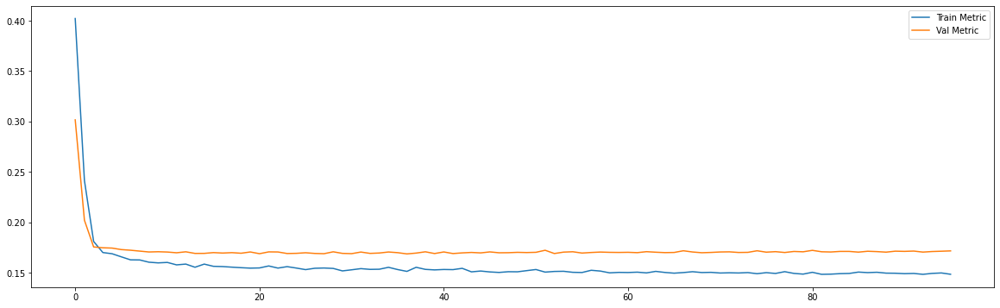

Epoch 00154: early stopping
============================model:21===========================
34/34 [==============================] - 0s 5ms/step - loss: 0.0331 - mae: 0.1453
loss and metric train data [0.033135902136564255, 0.1452949345111847]
7/7 [==============================] - 0s 4ms/step - loss: 0.0496 - mae: 0.1733
loss and metric val data [0.04963742941617966, 0.1732887178659439]
7/7 [==============================] - 0s 4ms/step - loss: 0.0896 - mae: 0.2235
loss and metric test data [0.0895979031920433, 0.22348220646381378]


'neurons': 50, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




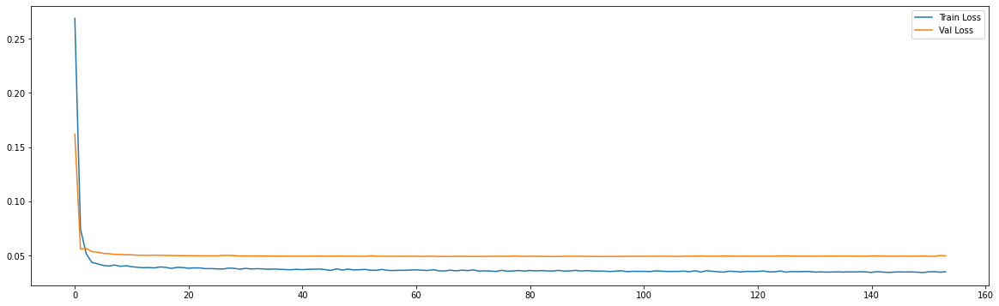

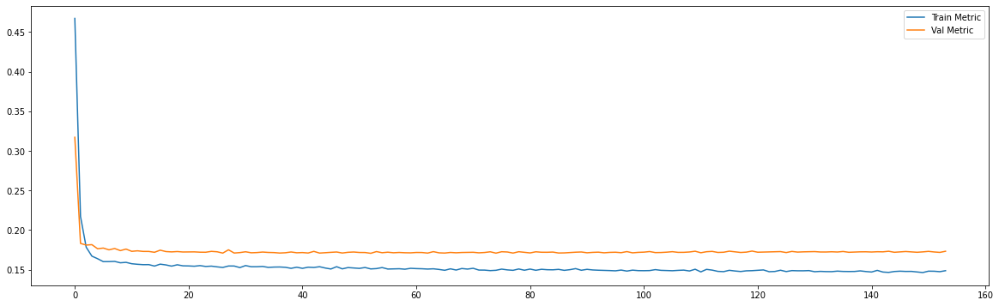

Epoch 00221: early stopping
============================model:22===========================
27/27 [==============================] - 0s 5ms/step - loss: 0.0368 - mae: 0.1543
loss and metric train data [0.03684746101498604, 0.1542634516954422]
3/3 [==============================] - 0s 4ms/step - loss: 0.0739 - mae: 0.2129
loss and metric val data [0.07392694801092148, 0.21294619143009186]
3/3 [==============================] - 0s 4ms/step - loss: 0.1571 - mae: 0.3094
loss and metric test data [0.15707242488861084, 0.30937445163726807]


'neurons': 50, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




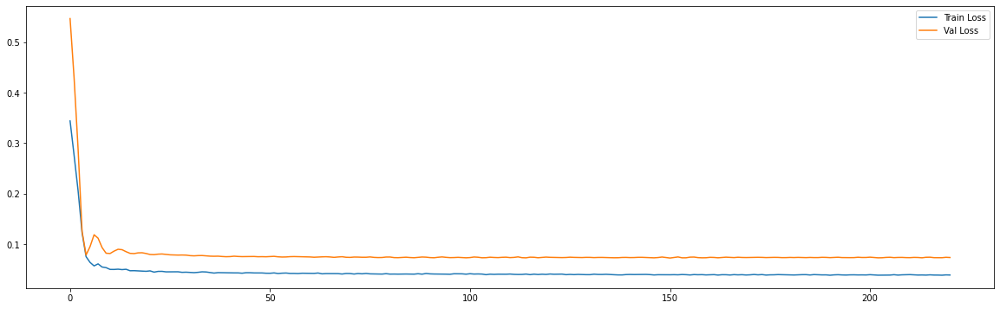

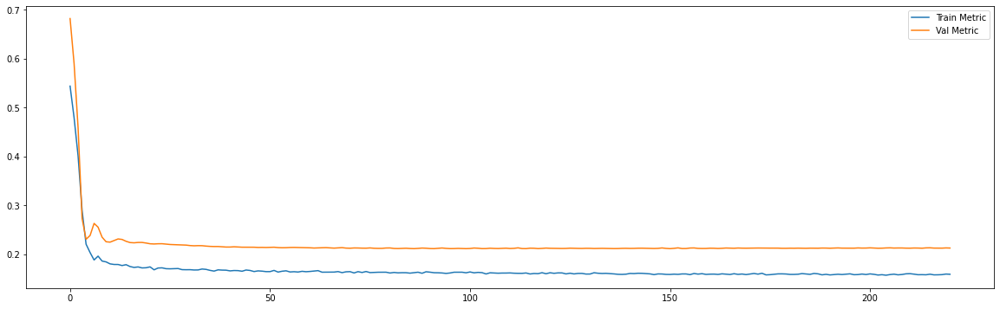

Epoch 00184: early stopping
============================model:23===========================
27/27 [==============================] - 0s 8ms/step - loss: 0.0368 - mae: 0.1541
loss and metric train data [0.036780841648578644, 0.15414436161518097]
3/3 [==============================] - 0s 6ms/step - loss: 0.0736 - mae: 0.2138
loss and metric val data [0.07363583892583847, 0.21379928290843964]
3/3 [==============================] - 0s 7ms/step - loss: 0.1582 - mae: 0.3087
loss and metric test data [0.15821634232997894, 0.3086605966091156]


'neurons': 50, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




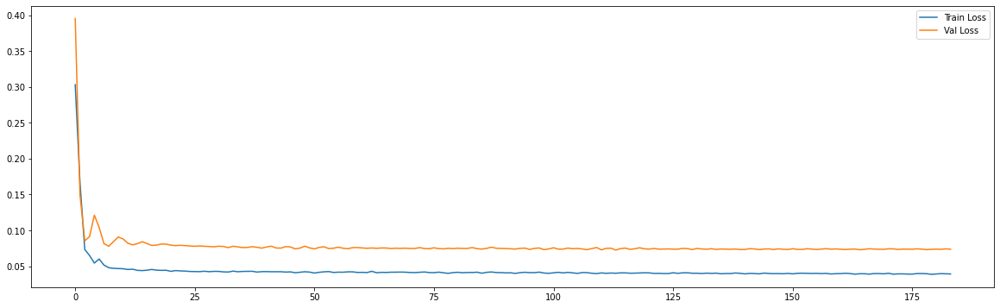

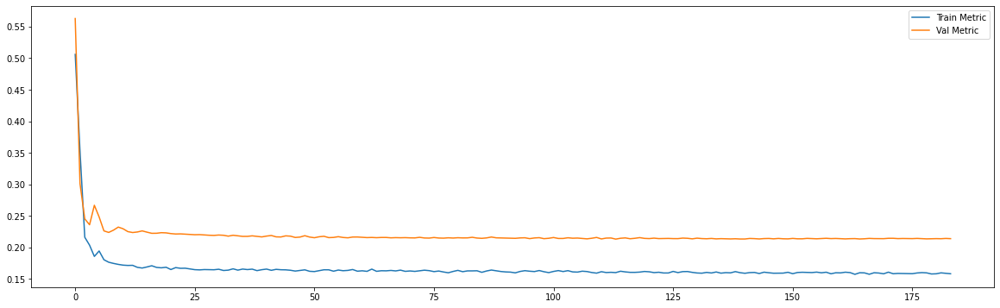

Epoch 00236: early stopping
============================model:24===========================
40/40 [==============================] - 0s 2ms/step - loss: 0.0334 - mae: 0.1461
loss and metric train data [0.033429622650146484, 0.14605306088924408]
9/9 [==============================] - 0s 2ms/step - loss: 0.0553 - mae: 0.1855
loss and metric val data [0.055291615426540375, 0.18551798164844513]
9/9 [==============================] - 0s 2ms/step - loss: 0.0752 - mae: 0.1953
loss and metric test data [0.07524700462818146, 0.1952676773071289]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




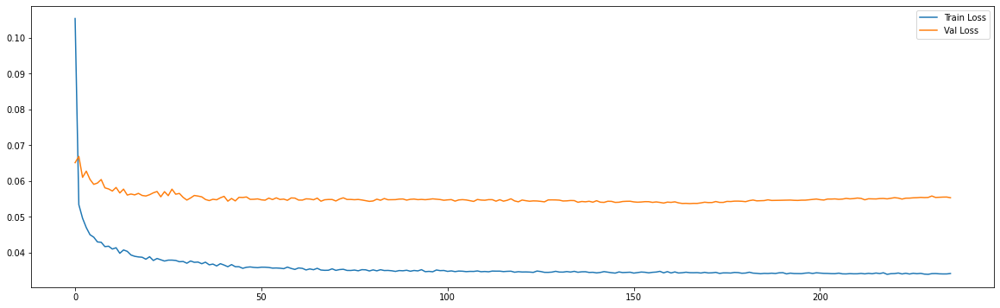

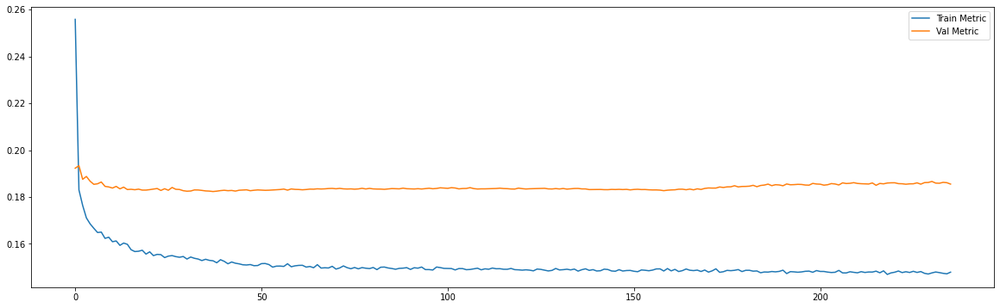

Epoch 00172: early stopping
============================model:25===========================
40/40 [==============================] - 0s 3ms/step - loss: 0.0334 - mae: 0.1459
loss and metric train data [0.03340471163392067, 0.14590096473693848]
9/9 [==============================] - 0s 3ms/step - loss: 0.0558 - mae: 0.1855
loss and metric val data [0.055842071771621704, 0.18548597395420074]
9/9 [==============================] - 0s 3ms/step - loss: 0.0781 - mae: 0.1976
loss and metric test data [0.07811249792575836, 0.19755655527114868]


'neurons': 50, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




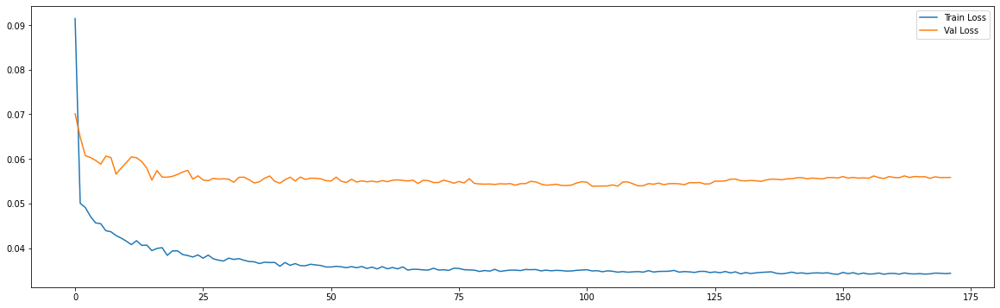

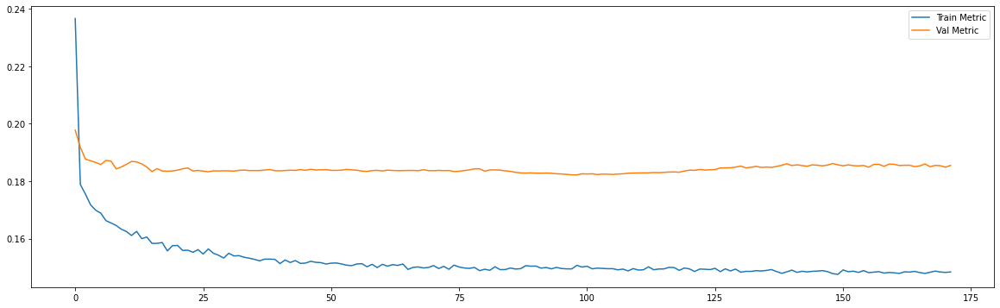

Epoch 00120: early stopping
============================model:26===========================
38/38 [==============================] - 0s 3ms/step - loss: 0.0334 - mae: 0.1464
loss and metric train data [0.03339185565710068, 0.1463906168937683]
8/8 [==============================] - 0s 2ms/step - loss: 0.0512 - mae: 0.1771
loss and metric val data [0.05124372988939285, 0.17713966965675354]
8/8 [==============================] - 0s 2ms/step - loss: 0.0737 - mae: 0.1997
loss and metric test data [0.07370789349079132, 0.19966605305671692]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




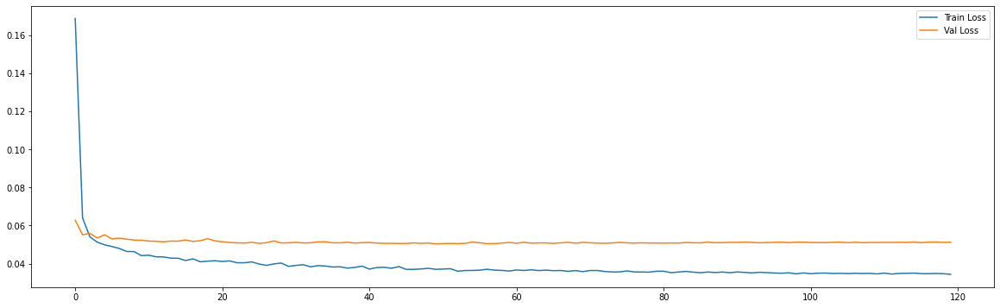

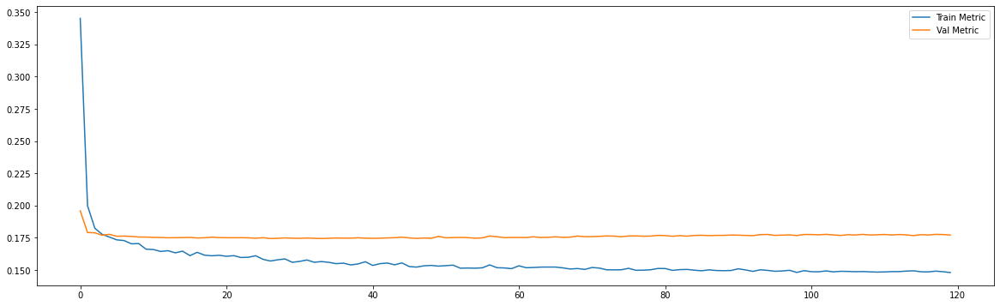

Epoch 00225: early stopping
============================model:27===========================
38/38 [==============================] - 0s 4ms/step - loss: 0.0324 - mae: 0.1436
loss and metric train data [0.032430265098810196, 0.14358557760715485]
8/8 [==============================] - 0s 4ms/step - loss: 0.0542 - mae: 0.1809
loss and metric val data [0.0542309433221817, 0.180878147482872]
8/8 [==============================] - 0s 3ms/step - loss: 0.0821 - mae: 0.2072
loss and metric test data [0.08205849677324295, 0.20720821619033813]


'neurons': 50, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




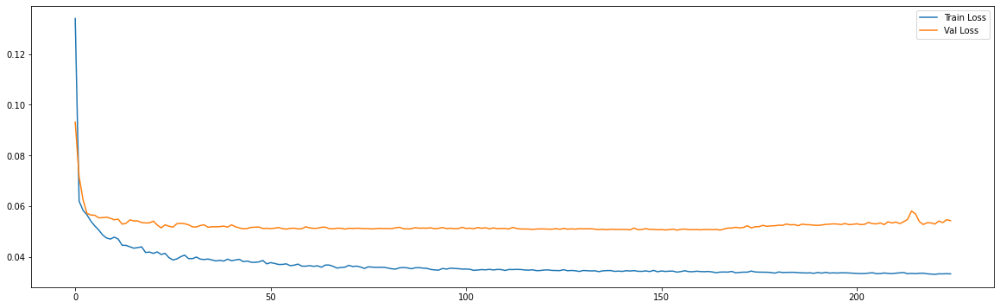

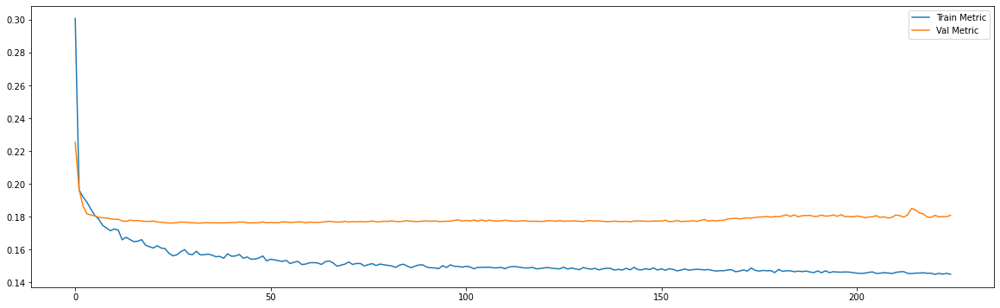

Epoch 00106: early stopping
============================model:28===========================
34/34 [==============================] - 0s 3ms/step - loss: 0.0332 - mae: 0.1451
loss and metric train data [0.03323623538017273, 0.14511393010616302]
7/7 [==============================] - 0s 3ms/step - loss: 0.0493 - mae: 0.1720
loss and metric val data [0.049295440316200256, 0.17204773426055908]
7/7 [==============================] - 0s 3ms/step - loss: 0.0861 - mae: 0.2234
loss and metric test data [0.08614496141672134, 0.22342512011528015]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




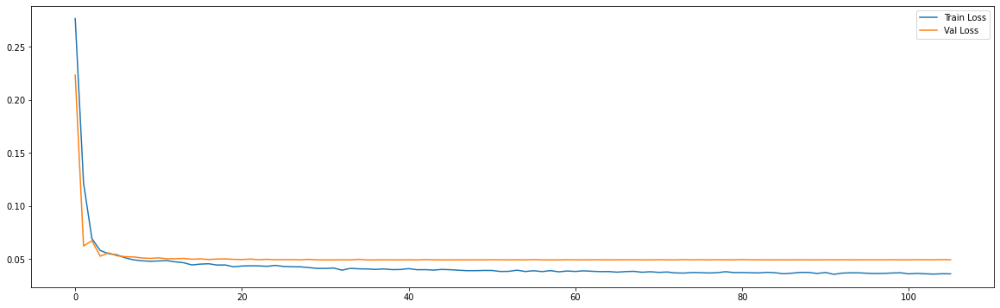

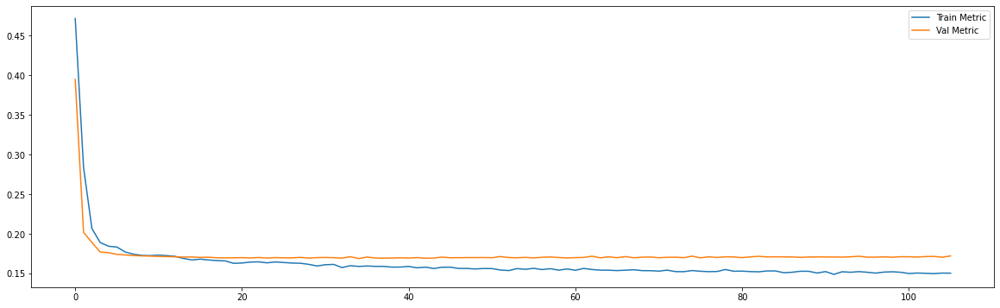

Epoch 00122: early stopping
============================model:29===========================
34/34 [==============================] - 0s 5ms/step - loss: 0.0332 - mae: 0.1449
loss and metric train data [0.033204082399606705, 0.14485223591327667]
7/7 [==============================] - 0s 4ms/step - loss: 0.0497 - mae: 0.1724
loss and metric val data [0.04968147724866867, 0.1723841279745102]
7/7 [==============================] - 0s 4ms/step - loss: 0.0890 - mae: 0.2235
loss and metric test data [0.08895803987979889, 0.2234828919172287]


'neurons': 50, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




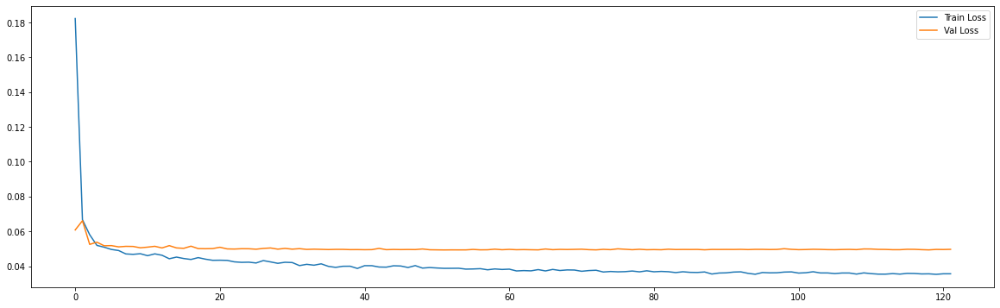

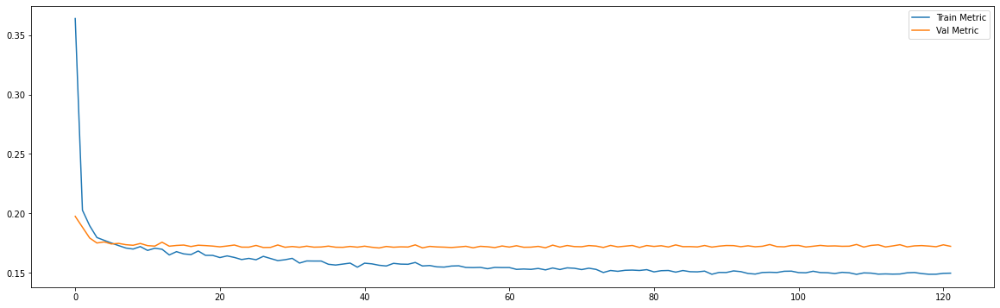

Epoch 00175: early stopping
============================model:30===========================
27/27 [==============================] - 0s 5ms/step - loss: 0.0369 - mae: 0.1543
loss and metric train data [0.0368698351085186, 0.15434108674526215]
3/3 [==============================] - 0s 6ms/step - loss: 0.0741 - mae: 0.2131
loss and metric val data [0.07406163960695267, 0.213065043091774]
3/3 [==============================] - 0s 4ms/step - loss: 0.1577 - mae: 0.3098
loss and metric test data [0.15767130255699158, 0.3097827434539795]


'neurons': 50, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




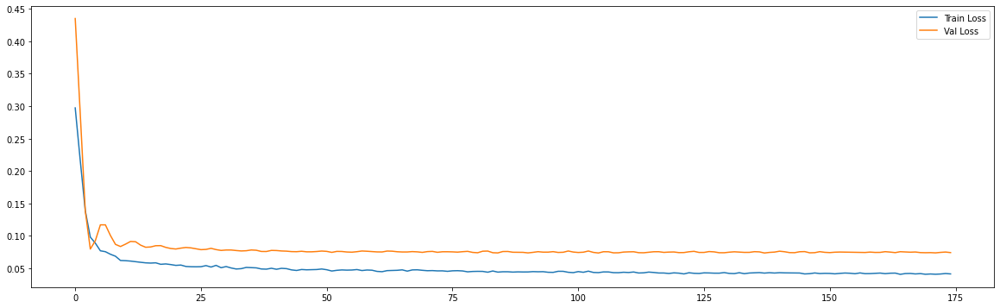

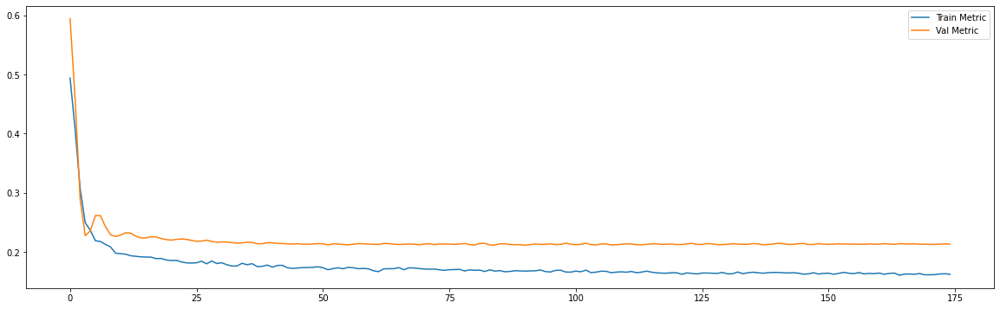

Epoch 00247: early stopping
============================model:31===========================
27/27 [==============================] - 0s 8ms/step - loss: 0.0367 - mae: 0.1541
loss and metric train data [0.036721907556056976, 0.1540602445602417]
3/3 [==============================] - 0s 6ms/step - loss: 0.0760 - mae: 0.2155
loss and metric val data [0.07599318027496338, 0.21545565128326416]
3/3 [==============================] - 0s 6ms/step - loss: 0.1711 - mae: 0.3200
loss and metric test data [0.17113173007965088, 0.3199697732925415]


'neurons': 50, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




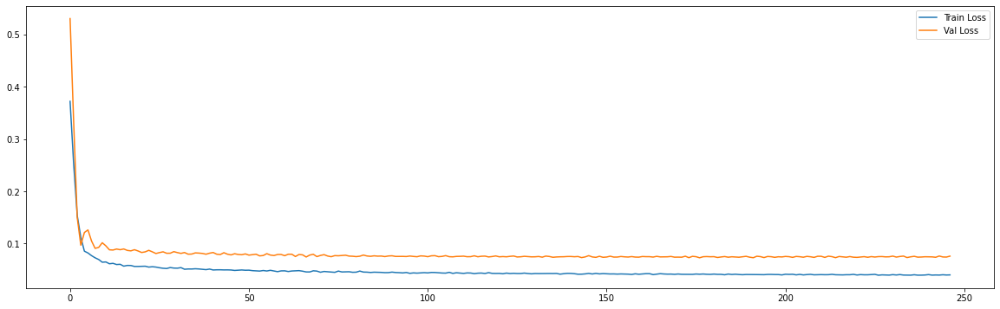

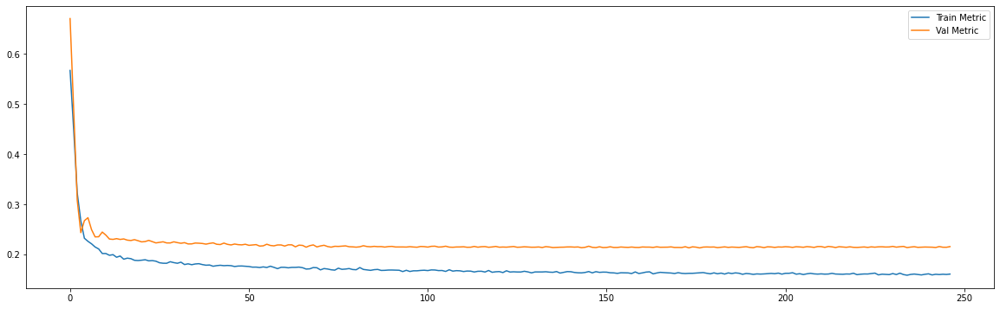

In [ ]:
future_steps = 5
n_features = 1

neurons_list = [30,50]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120,240]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for lr in lr_list:
        x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps, 'learning_rate':lr}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,lr,1)

        # The LSTM architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the LSTM
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1


        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,2)

        # The LSTM architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(LSTM(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(LSTM(units=neurons, return_sequences=False))
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the LSTM
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

         # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1